##Import required libraries

In [1]:
!pip install pytorch_forecasting
#!pip install pytorch_forecasting == 1.0.0
#!pip install pytorch_forecasting==0.10.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.4/140.4 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.9/92.9 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.6/409.6 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.8/155.8 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 806.1/806.1 kB 17.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 776.9/776.9 kB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 230.6/230.6 kB 16.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 5.7 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.5.0
    Uninstalling typing_extensions-4.5.0:
      Successfully uninstalled typing_exten

In [2]:
#!pip install transformers

In [3]:
!pip install pmdarima

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 11.8 MB/s eta 0:00:00


In [4]:
#pip install pytorch-lightning==1.8.6

In [5]:
import pandas as pd
import numpy as np

#for visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

#scaling and normalising
from sklearn.preprocessing import MinMaxScaler

from sklearn.preprocessing import LabelEncoder #for label encoding

#import library for seasonal decomposition implementation
from statsmodels.tsa.seasonal import seasonal_decompose

from scipy.stats import boxcox #for box cox transformation
from statsmodels.tsa.stattools import adfuller #for augumented dickey fuller test
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf #library imported for plotting ACG and PACF graphs

from itertools import product
import warnings

from statsmodels.tsa.arima.model import ARIMA                 #for ARIMA model implementation
from statsmodels.tsa.statespace.sarimax import SARIMAX        # for SARIMAX model implementation
import statsmodels.api as sm
import pmdarima as pm
#from pmdarima.model_selection import train_test_split
from pmdarima.arima import auto_arima                         # autoarima for fine tuning parameters

#evaluation metrics
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.metrics import r2_score
#from pytorch_forecasting.metrics import MAE,SMAPE, PoissonLoss, QuantileLoss #symmetric mean absolute percentage error, it has average of actual , forecasted values in denominator



#apply ML models and normalisation
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM,Bidirectional, Dense
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.model_selection import train_test_split
from keras.optimizers import Adam

##Connect GDrive read data

In [6]:
from google.colab import drive
drive.mount('/drive')  #connect colab to Google drive


Mounted at /drive


###Read Yahoo finance data with OHLC values

In [7]:
df_tether_y = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/usdt-usd_hourly_data.csv")
df_usdc_y = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/usdc-usd_hourly_data.csv")
df_btc_y = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/btc-usd_hourly_data.csv")
df_eth_y = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/eth-usd_hourly_data.csv")
df_bnb_y = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/bnb-usd_hourly_data.csv")

In [8]:
df_btc_y

,Datetime,Open,High,Low,Close,Adj Close,Volume
0,2021-08-07 00:00:00+00:00,42832.796875,43218.195312,42628.976562,43218.195312,43218.195312,0
1,2021-08-07 01:00:00+00:00,43269.710938,43334.480469,42881.937500,43227.308594,43227.308594,87060480
2,2021-08-07 02:00:00+00:00,43207.195312,43364.214844,43094.613281,43304.347656,43304.347656,327540736
3,2021-08-07 03:00:00+00:00,43302.187500,43767.613281,43063.460938,43767.613281,43767.613281,985309184
4,2021-08-07 04:00:00+00:00,43715.765625,43901.675781,43361.441406,43361.441406,43361.441406,665366528
...,...,...,...,...,...,...,...
17311,2023-08-05 19:00:00+00:00,29052.820312,29053.478516,29035.630859,29035.955078,29035.955078,0
17312,2023-08-05 20:00:00+00:00,29037.273438,29040.693359,29025.562500,29025.562500,29025.562500,0
17313,2023-08-05 21:00:00+00:00,29028.244141,29055.636719,29024.460938,29042.693359,29042.693359,0
17314,2023-08-05 22:00:00+00:00,29042.896484,29067.849609,29033.939453,29060.697266,29060.697266,0


###Read santiment data

In [9]:
df_btc_s = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/Santiment/Bitcoin.csv")
df_eth_s= pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/Santiment/Ethereum.csv")
df_bnb_s = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/Santiment/BNB.csv")
df_tether_s = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/Santiment/Tether.csv")
df_usdc_s = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/Santiment/USD_Coin.csv")

###Read Fear & Greed data

In [10]:
df_fear_greed_index = pd.read_csv("/drive/My Drive/Colab Notebooks/Naresh work/Alternative/fear_and_greed_index.csv")


##Data preprocessing

####Encoding value
Encoding value classification column

In [11]:
# Use LabelEncoder to encode the 'value_classification' column
label_encoder = LabelEncoder()
df_fear_greed_index['value_classification_encoded'] = label_encoder.fit_transform(df_fear_greed_index['value_classification'])


In [12]:
df_fear_greed_index.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1825 entries, 0 to 1824
Data columns (total 6 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Date                          1825 non-null   int64  
 1   value                         1825 non-null   int64  
 2   value_classification          1825 non-null   object 
 3   Unnamed: 3                    0 non-null      float64
 4   Unnamed: 4                    0 non-null      float64
 5   value_classification_encoded  1825 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 85.7+ KB


####Convert timestamp to hourly datetime
Convert timestamp to hourly datetime for fear greed index dataset

In [13]:

# Create a DataFrame
df = df_fear_greed_index


# Convert timestamp to datetime
df['Date'] = pd.to_datetime(df['Date'], unit='s')

# Set the datetime column as the index
df.set_index('Date', inplace=True)

#drop unwanted columns
df.drop(df.columns[[2, 3]], axis=1, inplace=True)


hourly_data = df.resample('H').mean()

#forward fill Nan values with previous values
hourly_data['value'] = hourly_data['value'].fillna(method='ffill')
hourly_data['value_classification_encoded'] = hourly_data['value_classification_encoded'].fillna(method='ffill')
print(hourly_data)

df_fear_greed_index = hourly_data



                     value  value_classification_encoded
Date                                                    
2018-09-11 00:00:00   18.0                           0.0
2018-09-11 01:00:00   18.0                           0.0
2018-09-11 02:00:00   18.0                           0.0
2018-09-11 03:00:00   18.0                           0.0
2018-09-11 04:00:00   18.0                           0.0
...                    ...                           ...
2023-09-08 20:00:00   46.0                           2.0
2023-09-08 21:00:00   46.0                           2.0
2023-09-08 22:00:00   46.0                           2.0
2023-09-08 23:00:00   46.0                           2.0
2023-09-09 00:00:00   41.0                           2.0

[43777 rows x 2 columns]


<ipython-input-13-e8321446e343>:15: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  hourly_data = df.resample('H').mean()


####Date time filter from 2020 to aug 2023 fear & greed dataset
Date time filter from 2020 to aug 2023 for fear & greed dataset.

In [14]:
df_fear_greed_index
# Filter the data from January 2020 to August 2023
df_fear_greed_index = df_fear_greed_index['2020-01-01':'2023-08-31']

print(df_fear_greed_index)

                     value  value_classification_encoded
Date                                                    
2020-01-01 00:00:00   37.0                           2.0
2020-01-01 01:00:00   37.0                           2.0
2020-01-01 02:00:00   37.0                           2.0
2020-01-01 03:00:00   37.0                           2.0
2020-01-01 04:00:00   37.0                           2.0
...                    ...                           ...
2023-08-31 19:00:00   52.0                           4.0
2023-08-31 20:00:00   52.0                           4.0
2023-08-31 21:00:00   52.0                           4.0
2023-08-31 22:00:00   52.0                           4.0
2023-08-31 23:00:00   52.0                           4.0

[32136 rows x 2 columns]


In [15]:
df_fear_greed_index

,value,value_classification_encoded
Date,,
2020-01-01 00:00:00,37.0,2.0
2020-01-01 01:00:00,37.0,2.0
2020-01-01 02:00:00,37.0,2.0
2020-01-01 03:00:00,37.0,2.0
2020-01-01 04:00:00,37.0,2.0
...,...,...
2023-08-31 19:00:00,52.0,4.0
2023-08-31 20:00:00,52.0,4.0
2023-08-31 21:00:00,52.0,4.0


####Datetime filter from 2020 to aug 2023 for santiment files

In [16]:

def Datetime_filter(df):

  # Convert the 'Date' column to datetime
  df['Date'] = pd.to_datetime(df['Date'])

  # Set the 'Date' column as the index
  df.set_index('Date', inplace=True)

  # Filter the data from January 1, 2020, to August 31, 2023
  df = df['2020-01-01':'2023-08-31']

  #Make datetime same formating
  # Remove values after '+'
  df.index = df.index.strftime('%Y-%m-%d %H:%M:%S')

  # Print the modified DataFrame
  print(df)
  return df

#call function for crypto datasets
df_btc_s = Datetime_filter(df_btc_s)
df_eth_s = Datetime_filter(df_eth_s)
df_bnb_s = Datetime_filter(df_bnb_s)
df_tether_s = Datetime_filter(df_tether_s)
df_usdc_s = Datetime_filter(df_usdc_s)


                            Price       Volume  Daily Active Addresses  \
Date                                                                     
2020-01-01 00:00:00   7175.561326  18567180015           640773.285714   
2020-01-01 01:00:00   7204.266293  18567180015           640773.285714   
2020-01-01 02:00:00   7233.087522  18567180015           640773.285714   
2020-01-01 03:00:00   7218.541090  18567180015           640773.285714   
2020-01-01 04:00:00   7212.448558  18567180015           640773.285714   
...                           ...          ...                     ...   
2023-08-31 19:00:00  26151.437460  12754788969           959279.000000   
2023-08-31 20:00:00  26024.819534  12754788969           959279.000000   
2023-08-31 21:00:00  25989.143737  12754788969           959279.000000   
2023-08-31 22:00:00  26020.847562  12754788969           959279.000000   
2023-08-31 23:00:00  25931.035408  12754788969           959279.000000   

                     Price MA(7)  Pri

In [17]:
df_btc_s

,Price,Volume,Daily Active Addresses,Price MA(7),Price MA(50),Price MA(30),Price MA(200),Price Z-Score,Volume.1,Marketcap,...,active social users telegram,weighted sentiment,trending words,active social users twitter,development activity,Amount of Uniq Addresses Bought More Than 100k USD of NFTs,Total NFT Trades Count,Total NFT Trades Volume In USD,Whale Transaction Count (>100k USD,Whale Transaction Count (>1m USD)
Date,,,,,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,7175.561326,18567180015,640773.285714,7200.11,7308.32,7263.19,7322.64,-0.87,18567180015,130586492605,...,NaN,-0.584907,3.0,NaN,153,NaN,57.0,8509.661531,43353,2226
2020-01-01 01:00:00,7204.266293,18567180015,640773.285714,7196.82,7304.00,7260.21,7321.27,-0.87,18567180015,130586492605,...,NaN,-0.584907,3.0,NaN,153,NaN,57.0,8509.661531,43353,2226
2020-01-01 02:00:00,7233.087522,18567180015,640773.285714,7196.90,7301.00,7257.48,7320.00,-0.86,18567180015,130586492605,...,NaN,-0.584907,3.0,NaN,153,NaN,57.0,8509.661531,43353,2226
2020-01-01 03:00:00,7218.541090,18567180015,640773.285714,7203.49,7297.69,7254.48,7318.72,-0.87,18567180015,130586492605,...,NaN,-0.584907,3.0,NaN,153,NaN,57.0,8509.661531,43353,2226
2020-01-01 04:00:00,7212.448558,18567180015,640773.285714,7205.75,7294.30,7251.13,7317.52,-0.87,18567180015,130586492605,...,NaN,-0.584907,3.0,NaN,153,NaN,57.0,8509.661531,43353,2226
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-08-31 19:00:00,26151.437460,12754788969,959279.000000,26609.40,27263.62,27085.04,26420.35,0.31,12754788969,501633551302,...,NaN,0.669691,1.0,NaN,466,0.0,215.0,50116.418423,47430,6872
2023-08-31 20:00:00,26024.819534,12754788969,959279.000000,26454.13,27224.60,27046.93,26421.27,0.30,12754788969,501633551302,...,NaN,0.669691,1.0,NaN,466,0.0,215.0,50116.418423,47430,6872
2023-08-31 21:00:00,25989.143737,12754788969,959279.000000,26286.90,27187.36,27006.38,26421.29,0.30,12754788969,501633551302,...,NaN,0.669691,1.0,NaN,466,0.0,215.0,50116.418423,47430,6872


####merging fear and greed dataset with crypto santiment dataset

Reset index of fear and greed dataset

In [18]:
df_fear_greed_index.reset_index(inplace=True)
df_fear_greed_index.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32136 entries, 0 to 32135
Data columns (total 3 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   Date                          32136 non-null  datetime64[ns]
 1   value                         32136 non-null  float64       
 2   value_classification_encoded  32136 non-null  float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 753.3 KB


In [19]:

def merge_fear_santiment(df_fear_greed_index,df2):
    df1 = df_fear_greed_index
    # Reset the index in df2
    df2.reset_index(inplace=True)

    # Convert the 'timestamp' column to datetime
    df2['Date'] = pd.to_datetime(df2['Date'])

    # Now you can merge the two DataFrames based on the 'timestamp' column
    merged_df = pd.merge(df1, df2, on='Date')
    print(merged_df)
    print(merged_df.info())

    return merged_df

df_btc_s = merge_fear_santiment(df_fear_greed_index,df_btc_s)
df_eth_s = merge_fear_santiment(df_fear_greed_index,df_eth_s)
df_bnb_s = merge_fear_santiment(df_fear_greed_index,df_bnb_s)
df_tether_s = merge_fear_santiment(df_fear_greed_index,df_tether_s)
df_usdc_s = merge_fear_santiment(df_fear_greed_index,df_usdc_s)

                     Date  value  value_classification_encoded         Price  \
0     2020-01-01 00:00:00   37.0                           2.0   7175.561326   
1     2020-01-01 01:00:00   37.0                           2.0   7204.266293   
2     2020-01-01 02:00:00   37.0                           2.0   7233.087522   
3     2020-01-01 03:00:00   37.0                           2.0   7218.541090   
4     2020-01-01 04:00:00   37.0                           2.0   7212.448558   
...                   ...    ...                           ...           ...   
32105 2023-08-31 19:00:00   52.0                           4.0  26151.437460   
32106 2023-08-31 20:00:00   52.0                           4.0  26024.819534   
32107 2023-08-31 21:00:00   52.0                           4.0  25989.143737   
32108 2023-08-31 22:00:00   52.0                           4.0  26020.847562   
32109 2023-08-31 23:00:00   52.0                           4.0  25931.035408   

            Volume  Daily Active Addres

####Datetime formating from Aug 2021 to Aug 2023 for Yahoo finance(OHLC) files

In [20]:
df_btc_y.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17316 entries, 0 to 17315
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Datetime   17316 non-null  object 
 1   Open       17316 non-null  float64
 2   High       17316 non-null  float64
 3   Low        17316 non-null  float64
 4   Close      17316 non-null  float64
 5   Adj Close  17316 non-null  float64
 6   Volume     17316 non-null  int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 947.1+ KB


In [21]:
def Datetime_filter(df):
  df= df.rename(columns={'Datetime': 'Date'})
  # Convert the 'Date' column to datetime
  df['Date'] = pd.to_datetime(df['Date'])

  # Set the 'Date' column as the index
  df.set_index('Date', inplace=True)

  # Filter the data from January 1, 2020, to August 31, 2023
  df = df['2021-08-07':'2023-08-5']

  #Make datetime same formating
  # Remove values after '+'
  df.index = df.index.strftime('%Y-%m-%d %H:%M:%S')

  # Print the modified DataFrame
  print(df)
  return df

#call function for crypto datasets
df_btc_y = Datetime_filter(df_btc_y)
df_eth_y = Datetime_filter(df_eth_y)
df_bnb_y = Datetime_filter(df_bnb_y)
df_tether_y = Datetime_filter(df_tether_y)
df_usdc_y = Datetime_filter(df_usdc_y)

                             Open          High           Low         Close  \
Date                                                                          
2021-08-07 00:00:00  42832.796875  43218.195312  42628.976562  43218.195312   
2021-08-07 01:00:00  43269.710938  43334.480469  42881.937500  43227.308594   
2021-08-07 02:00:00  43207.195312  43364.214844  43094.613281  43304.347656   
2021-08-07 03:00:00  43302.187500  43767.613281  43063.460938  43767.613281   
2021-08-07 04:00:00  43715.765625  43901.675781  43361.441406  43361.441406   
...                           ...           ...           ...           ...   
2023-08-05 19:00:00  29052.820312  29053.478516  29035.630859  29035.955078   
2023-08-05 20:00:00  29037.273438  29040.693359  29025.562500  29025.562500   
2023-08-05 21:00:00  29028.244141  29055.636719  29024.460938  29042.693359   
2023-08-05 22:00:00  29042.896484  29067.849609  29033.939453  29060.697266   
2023-08-05 23:00:00  29061.539062  29062.263672  290

####Merge Yahoo finance OHLC files with santiment files

In [22]:
def merge_yahoo_santiment(df1,df2):

    # Reset the index in df2
    df1.reset_index(inplace=True)

    # Convert the 'date' column to datetime
    df1['Date'] = pd.to_datetime(df1['Date'])

    # Now you can merge the two DataFrames based on the 'timestamp' column
    merged_df = pd.merge(df1, df2, on='Date')
    print(merged_df)
    print(merged_df.info())

    return merged_df

df_btc = merge_yahoo_santiment(df_btc_y,df_btc_s)
df_eth = merge_yahoo_santiment(df_eth_y,df_eth_s)
df_bnb = merge_yahoo_santiment(df_bnb_y,df_bnb_s)
df_tether = merge_yahoo_santiment(df_tether_y,df_tether_s)
df_usdc = merge_yahoo_santiment(df_usdc_y,df_usdc_s)

                     Date          Open          High           Low  \
0     2021-08-07 00:00:00  42832.796875  43218.195312  42628.976562   
1     2021-08-07 01:00:00  43269.710938  43334.480469  42881.937500   
2     2021-08-07 02:00:00  43207.195312  43364.214844  43094.613281   
3     2021-08-07 03:00:00  43302.187500  43767.613281  43063.460938   
4     2021-08-07 04:00:00  43715.765625  43901.675781  43361.441406   
...                   ...           ...           ...           ...   
17311 2023-08-05 19:00:00  29052.820312  29053.478516  29035.630859   
17312 2023-08-05 20:00:00  29037.273438  29040.693359  29025.562500   
17313 2023-08-05 21:00:00  29028.244141  29055.636719  29024.460938   
17314 2023-08-05 22:00:00  29042.896484  29067.849609  29033.939453   
17315 2023-08-05 23:00:00  29061.539062  29062.263672  29045.617188   

              Close     Adj Close   Volume_x  value  \
0      43218.195312  43218.195312          0   69.0   
1      43227.308594  43227.308594   8

In [23]:
# List of DataFrame names and corresponding DataFrames
dataframes = [
    ('Bitcoin', df_btc),
    ('Ethereum', df_eth),
    ('BNB', df_bnb),
    ('Tether', df_tether),
    ('USD_coin', df_usdc)
]

# Describe and get info for each DataFrame
for name, df in dataframes:
    print(f"DataFrame: {name}")
    print("Description:")
    print(df.describe())
    print("\nInfo:")
    print(df.info())
    print("=" * 50)  # Separator between DataFrames

DataFrame: Bitcoin
Description:
               Open          High           Low         Close     Adj Close  \
count  17316.000000  17316.000000  17316.000000  17316.000000  17316.000000   
mean   32414.299587  32520.413745  32304.875189  32413.844623  32413.844623   
std    12880.295895  12940.096764  12818.113019  12880.573088  12880.573088   
min    15647.335938  15745.420898  15599.046875  15652.829102  15652.829102   
25%    21380.409180  21449.998535  21314.873535  21383.226074  21383.226074   
50%    29003.517578  29084.921875  28928.632812  29006.505859  29006.505859   
75%    42488.411133  42632.229492  42358.072266  42487.091797  42487.091797   
max    68610.171875  68789.625000  68475.140625  68622.632812  68622.632812   

           Volume_x         value  value_classification_encoded         Price  \
count  1.731600e+04  17316.000000                  17316.000000  17316.000000   
mean   2.989510e+08     39.282282                      1.917706  32413.542353   
std    2.2219

###Check duplicates

In [24]:
for name, df in dataframes:
    dups_ = df.duplicated()
    print(f"DataFrame duplicates : {name}")
    print(dups_.sum()) #check duplicates count

DataFrame duplicates : Bitcoin
0
DataFrame duplicates : Ethereum
0
DataFrame duplicates : BNB
0
DataFrame duplicates : Tether
0
DataFrame duplicates : USD_coin
0


###Check column types

In [25]:
for name, df in dataframes:
  print(f"DataFrame  : {name}")
  print(df.columns)

DataFrame  : Bitcoin
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume_x',
       'value', 'value_classification_encoded', 'Price', 'Volume_y',
       'Daily Active Addresses', 'Price MA(7)', 'Price MA(50)', 'Price MA(30)',
       'Price MA(200)', 'Price Z-Score', 'Volume.1', 'Marketcap',
       'Social dominance', 'Social dominance twitter news', 'Social volume',
       'active social users telegram', 'weighted sentiment', 'trending words',
       'active social users twitter', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)'],
      dtype='object')
DataFrame  : Ethereum
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume_x',
       'value', 'value_classification_encoded', 'Price', 'Volume_y',
       'Daily Active Addresses', 'Price MA(7)', 'Price MA(50)',

###Check Nans and Null values

> It is clear from below results that active social users telegram,  active social users twitter are totally null.

> Social dominance twitter news has more than 6000 rows null.


> Prize Z-score is null for tether,usdc.

> 240 rows daily active address,Whale Transaction Count (>100k USD),Whale Transaction Count (>1m USD) data missing for BNB.







In [26]:
for name, df in dataframes:
    nan_count = df.isna().sum()
    null_count = df.isnull().sum()
    total_missing = nan_count + null_count
    print('='*50)
    print('Number of  Nan values:'+name, nan_count)
    print('='*50)
    print('Number of  null values:'+name, null_count)
    print('='*50)
    print('Number of Total missing values:'+name, total_missing)

Number of  Nan values:Bitcoin Date                                                              0
Open                                                              0
High                                                              0
Low                                                               0
Close                                                             0
Adj Close                                                         0
Volume_x                                                          0
value                                                             0
value_classification_encoded                                      0
Price                                                             0
Volume_y                                                          0
Daily Active Addresses                                            0
Price MA(7)                                                       0
Price MA(50)                                                      0
Price MA(30)      

###Drop unwanted columns

Dropping 'active social users telegram', 'active social users twitter','Price Z-Score'

In [27]:
def drop_unwanted_col(df):
      df = df.drop(['active social users telegram', 'active social users twitter','Price Z-Score'], axis=1)
      return df

df_btc =  drop_unwanted_col(df_btc)
df_eth =  drop_unwanted_col(df_eth)
df_bnb =  drop_unwanted_col(df_bnb)
df_tether =  drop_unwanted_col(df_tether)
df_usdc =  drop_unwanted_col(df_usdc)

dataframes = [
    ('Bitcoin', df_btc),
    ('Ethereum', df_eth),
    ('BNB', df_bnb),
    ('Tether', df_tether),
    ('USD_coin', df_usdc)
]

In [28]:
for name, df in dataframes:
    nan_count = df.isna().sum()
    null_count = df.isnull().sum()
    total_missing = nan_count + null_count
    print('='*50)
    print('Number of  Nan values:'+name, nan_count)
    print('='*50)
    print('Number of  null values:'+name, null_count)
    print('='*50)
    print('Number of Total missing values:'+name, total_missing)

Number of  Nan values:Bitcoin Date                                                             0
Open                                                             0
High                                                             0
Low                                                              0
Close                                                            0
Adj Close                                                        0
Volume_x                                                         0
value                                                            0
value_classification_encoded                                     0
Price                                                            0
Volume_y                                                         0
Daily Active Addresses                                           0
Price MA(7)                                                      0
Price MA(50)                                                     0
Price MA(30)                    

In [29]:
df_btc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17316 entries, 0 to 17315
Data columns (total 29 columns):
 #   Column                                                      Non-Null Count  Dtype         
---  ------                                                      --------------  -----         
 0   Date                                                        17316 non-null  datetime64[ns]
 1   Open                                                        17316 non-null  float64       
 2   High                                                        17316 non-null  float64       
 3   Low                                                         17316 non-null  float64       
 4   Close                                                       17316 non-null  float64       
 5   Adj Close                                                   17316 non-null  float64       
 6   Volume_x                                                    17316 non-null  int64         
 7   value                 

###Datasets without hours

In [30]:

def Remove_hours(df):
    df.set_index('Date', inplace=True)
    df.index = df.index.date
    df = df[~df.index.duplicated(keep='first')]
    df.index.name = 'Date'
    return df

df_btc_yearly =  Remove_hours(df_btc.copy())
df_eth_yearly =  Remove_hours(df_eth.copy())
df_bnb_yearly =  Remove_hours(df_bnb.copy())
df_tether_yearly =  Remove_hours(df_tether.copy())
df_usdc_yearly = Remove_hours(df_usdc.copy())

##Exploratory data analysis

###Line plot


*   Bitcoin has higer prices and has been more volatile followed by ethereum and BNB.
*   Tether and USD coin has been around 1dollar over the time since it is backed by us dollar price is closely related to $ price.
https://www.bvnk.com/blog/usdc-vs-usdt#:~:text=Tether%20and%20USD%20Coin%20are,both%20cases%20the%20US%20dollar.



Line PLot: Bitcoin


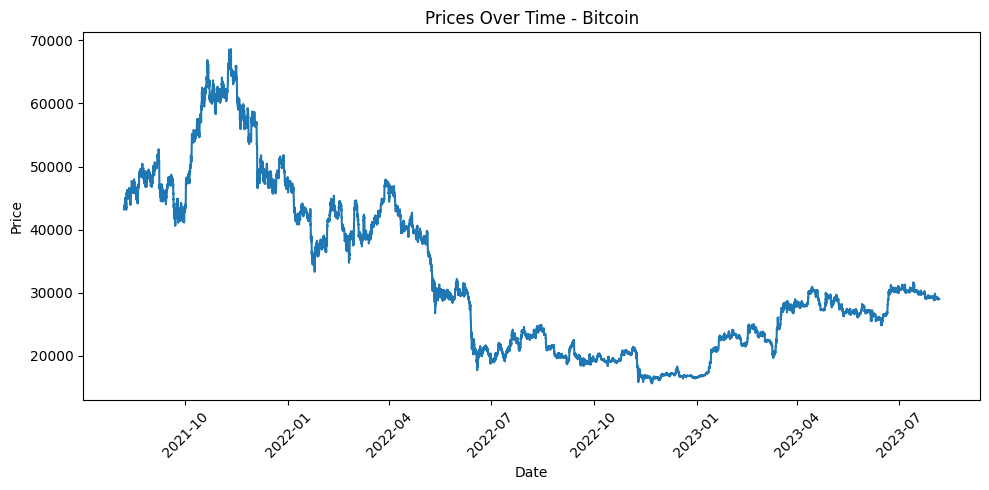

Line PLot: Ethereum


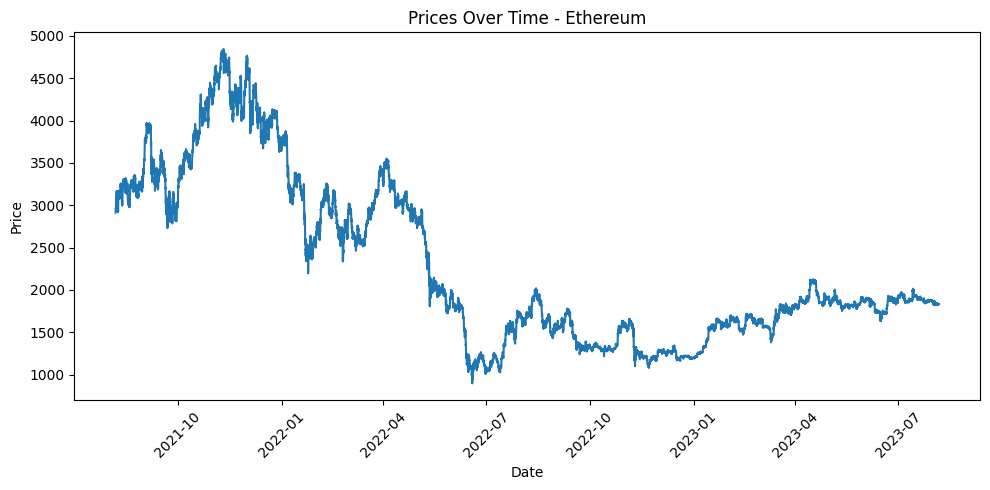

Line PLot: BNB


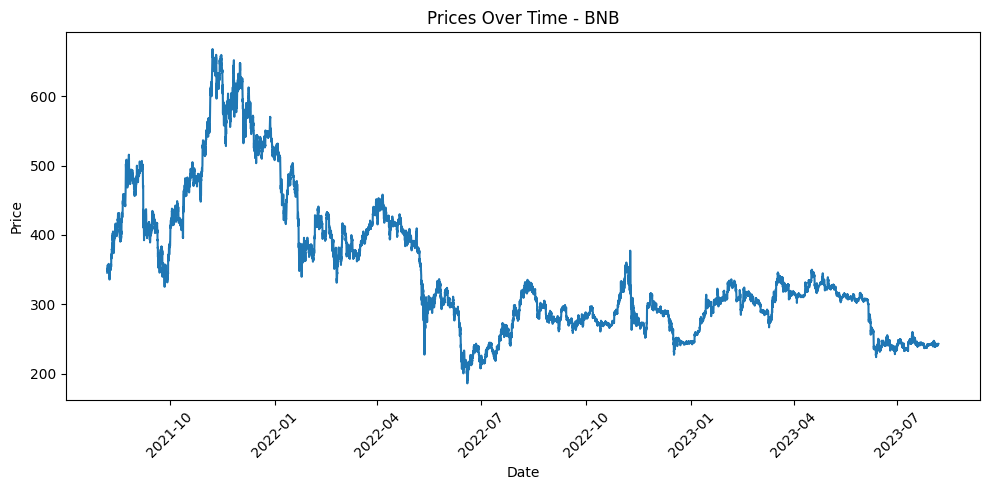

Line PLot: Tether


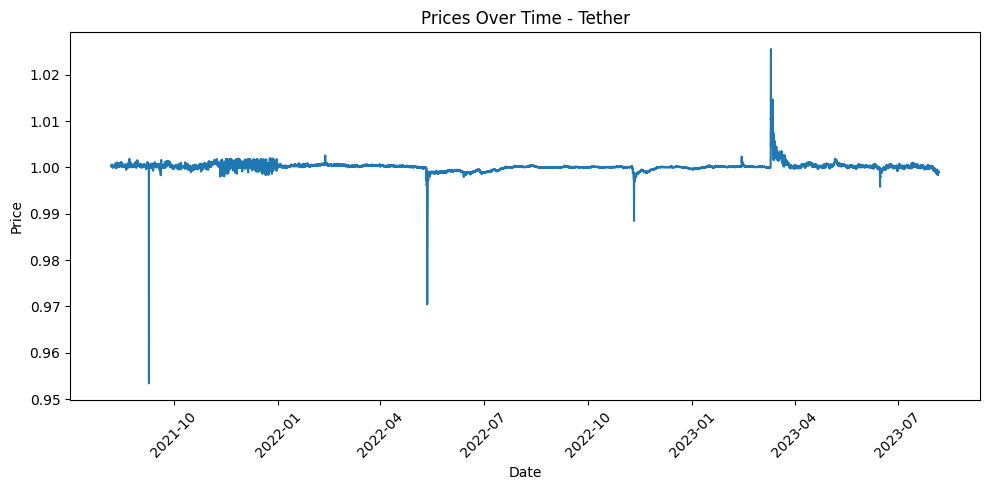

Line PLot: USD_coin


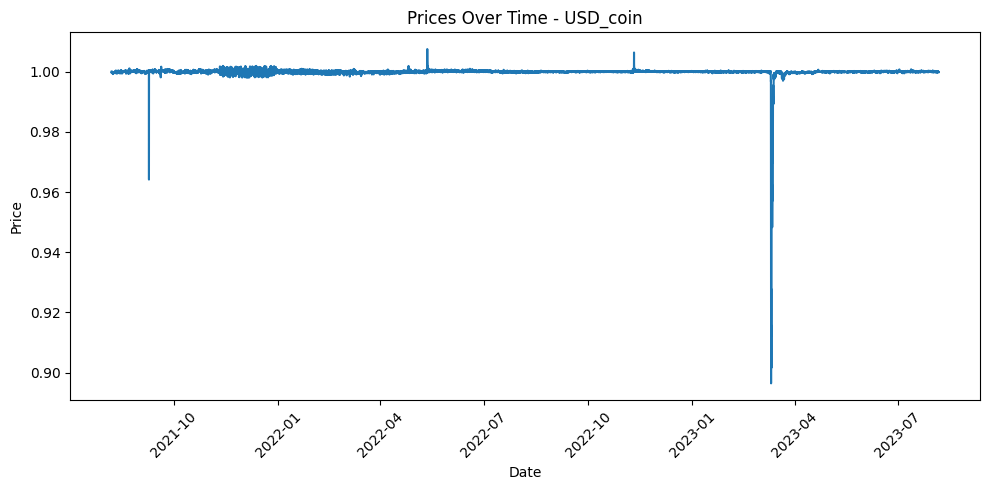

In [ ]:
# Exploratory Data Analysis for each DataFrame
for name, df in dataframes:
    print(f"Line PLot: {name}")

    # Line plot of Close prices over time
    plt.figure(figsize=(10, 5))
    sns.lineplot(x='Date', y='Price', data=df)
    plt.title(f'Prices Over Time - {name}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

###Multiple line plot

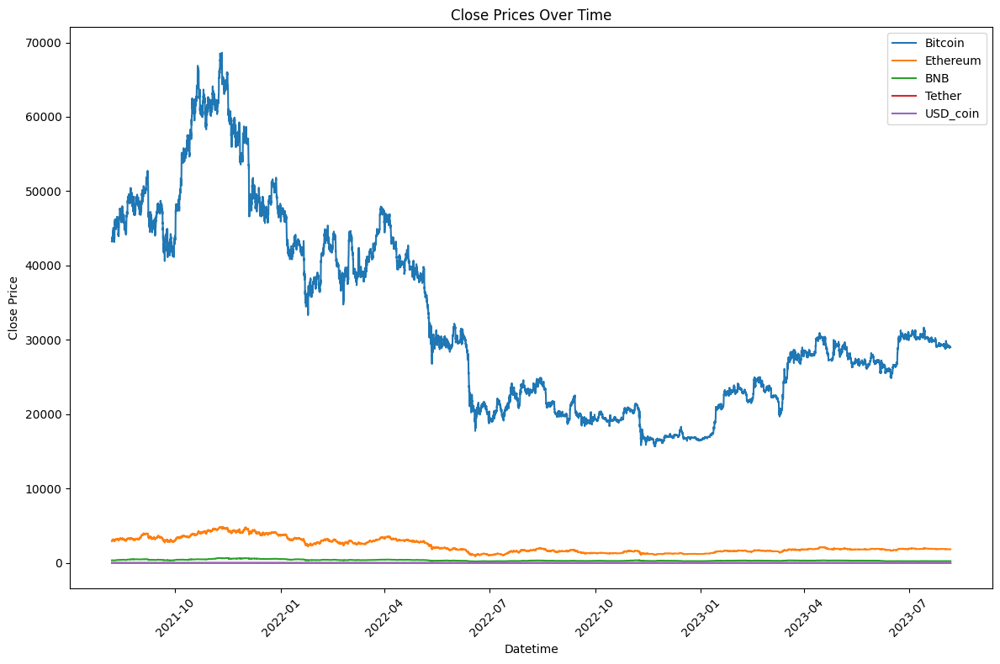

In [ ]:
plt.figure(figsize=(12, 8))

for name, df in dataframes:
    plt.plot(df['Date'], df['Price'], label=name)

plt.title('Close Prices Over Time')
plt.xlabel('Datetime')
plt.ylabel('Close Price')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()

plt.show()

####Line plot stable coins

*   The coins seem to be highly correlated as one coin price rises other price drops and vice versa example see around 2022-05.




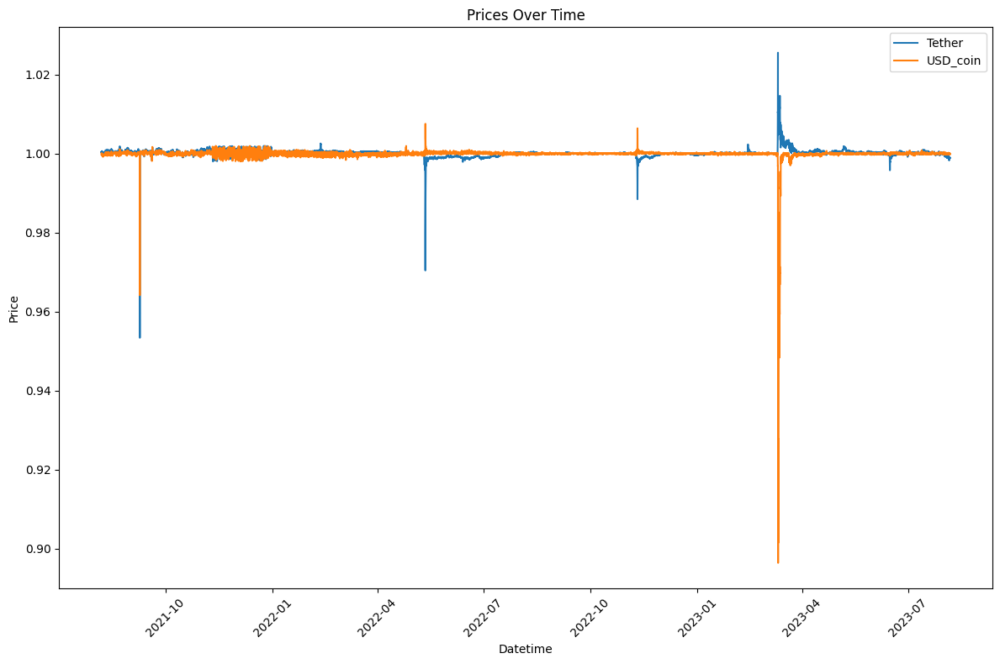

In [ ]:
stable_coins = [

    ('Tether', df_tether),
    ('USD_coin', df_usdc)
]

plt.figure(figsize=(12, 8))

for name, df in stable_coins:
    plt.plot(df['Date'], df['Price'], label=name)

plt.title('Prices Over Time')
plt.xlabel('Datetime')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()

plt.show()

####Line plot eth and bnb coins

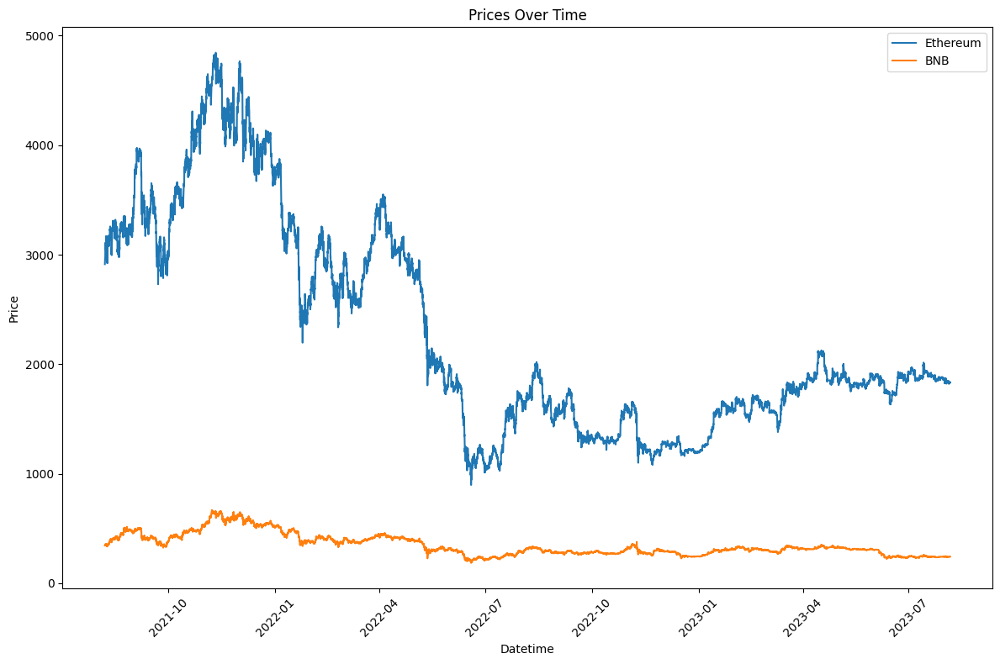

In [ ]:
Bnb_eth_coins = [

    ('Ethereum', df_eth),
    ('BNB', df_bnb)
]

plt.figure(figsize=(12, 8))

for name, df in Bnb_eth_coins:
    plt.plot(df['Date'], df['Price'], label=name)

plt.title('Prices Over Time')
plt.xlabel('Datetime')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()

plt.show()

###Moving average plot

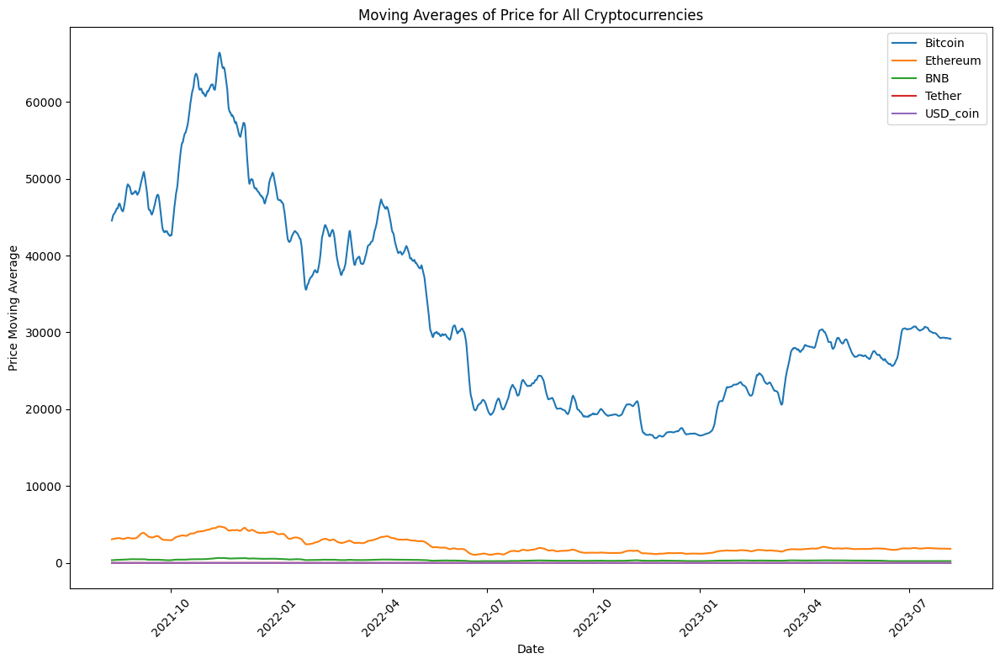

In [ ]:
column_to_plot = 'Price'
window_size = 90  # Adjusting the window size

# Calculating moving averages
plt.figure(figsize=(12, 8))

for name, df in dataframes:
    moving_avg = df[column_to_plot].rolling(window=window_size).mean()
    plt.plot(df['Date'], moving_avg, label=name)

plt.title(f'Moving Averages of {column_to_plot} for All Cryptocurrencies')
plt.xlabel('Date')
plt.ylabel(f'{column_to_plot} Moving Average')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

####Moving average plot quarterly

No significant pattern observed for quarterly moving average

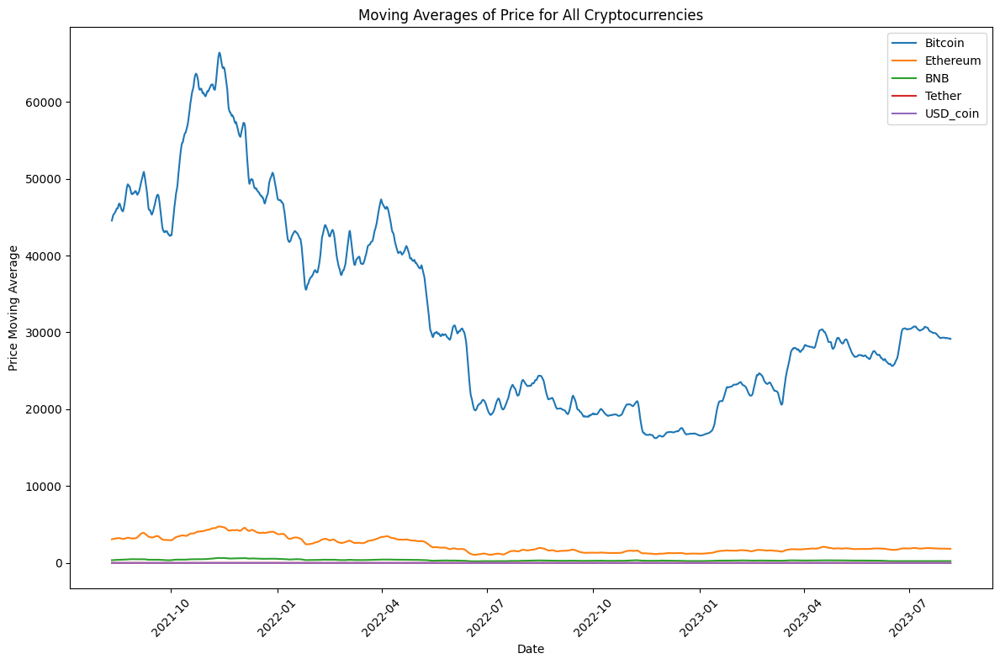

In [ ]:
column_to_plot = 'Price'
window_size = 90  # Adjusting the window size

# Calculating moving averages
plt.figure(figsize=(12, 8))

for name, df in dataframes:
    moving_avg = df[column_to_plot].rolling(window=window_size).mean()
    plt.plot(df['Date'], moving_avg, label=name)

plt.title(f'Moving Averages of {column_to_plot} for All Cryptocurrencies')
plt.xlabel('Date')
plt.ylabel(f'{column_to_plot} Moving Average')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

####moving average quarterly plot for eth and bnb

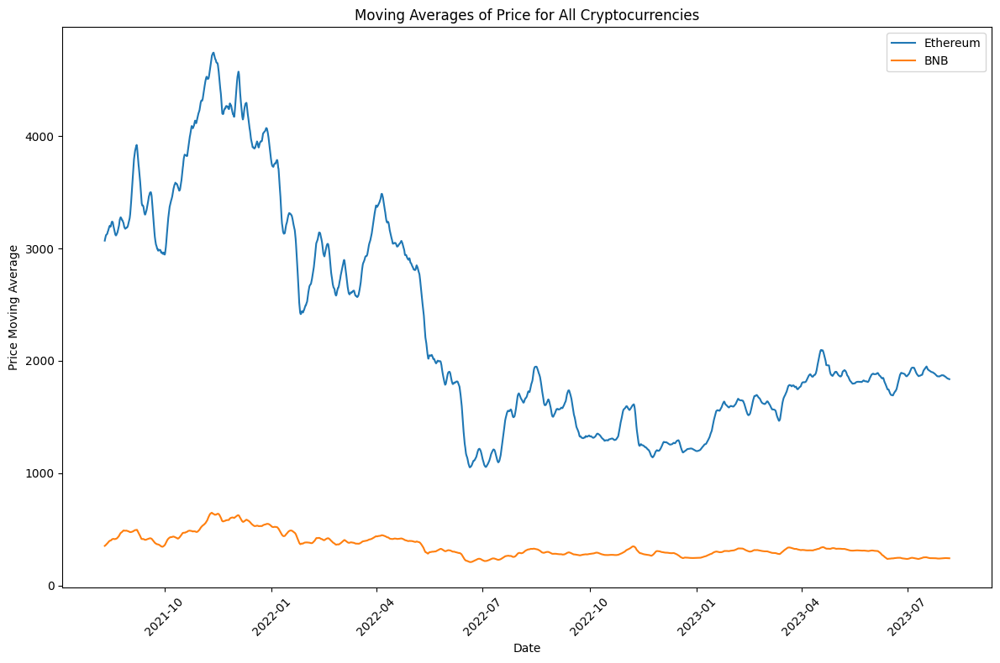

In [ ]:
column_to_plot = 'Price'
window_size = 90  # Adjusting the window size

# Calculating moving averages
plt.figure(figsize=(12, 8))

for name, df in Bnb_eth_coins:
    moving_avg = df[column_to_plot].rolling(window=window_size).mean()
    plt.plot(df['Date'], moving_avg, label=name)

plt.title(f'Moving Averages of {column_to_plot} for All Cryptocurrencies')
plt.xlabel('Date')
plt.ylabel(f'{column_to_plot} Moving Average')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

####Moving average quarterly plot for year 2021

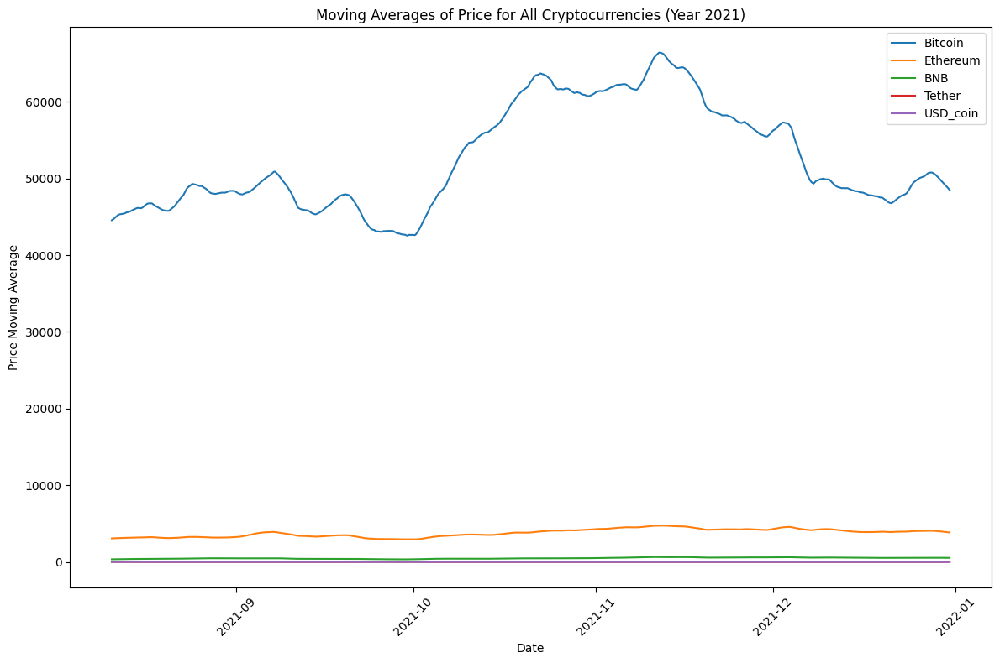

In [ ]:
# Column for which to calculate moving averages and create plots
column_to_plot = 'Price'
window_size = 90  # Adjust the window size as needed

# Calculate moving averages and create line plots for each DataFrame (data for 2021)
plt.figure(figsize=(12, 8))

for name, df in dataframes:
    # Filter data for the year 2021
    year_2021_df = df[(df['Date'] >= '2021-01-01') & (df['Date'] <= '2021-12-31')]

    moving_avg = year_2021_df[column_to_plot].rolling(window=window_size).mean()
    plt.plot(year_2021_df['Date'], moving_avg, label=name)

plt.title(f'Moving Averages of {column_to_plot} for All Cryptocurrencies (Year 2021)')
plt.xlabel('Date')
plt.ylabel(f'{column_to_plot} Moving Average')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

####Moving average quarterly plot for 2022

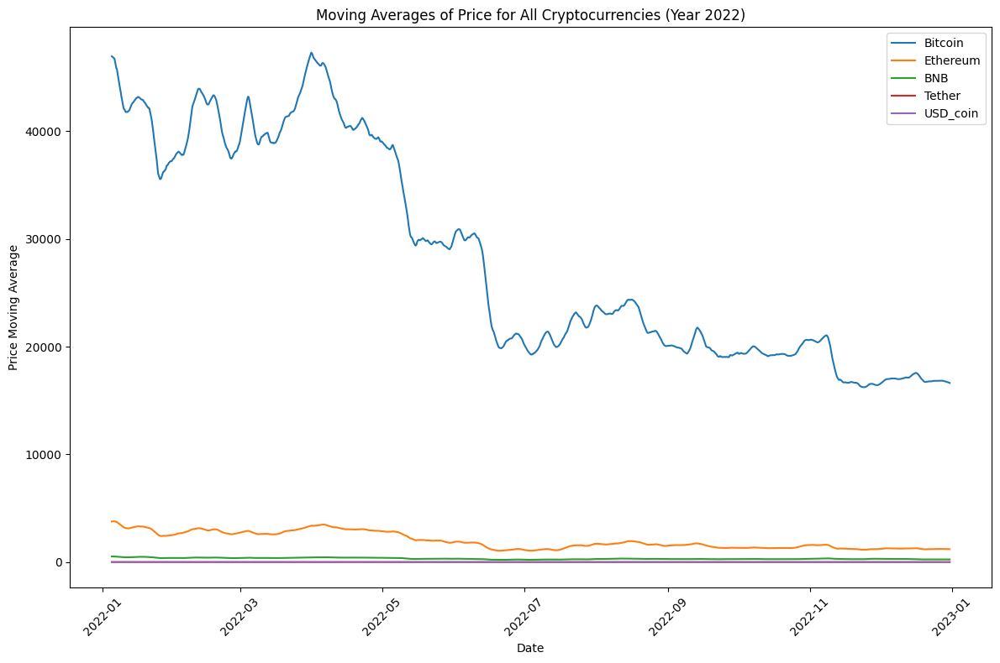

In [ ]:
# Column for which to calculate moving averages and create plots
column_to_plot = 'Price'
window_size = 90  # Adjust the window size as needed

# Calculate moving averages and create line plots for each DataFrame (data for 2022)
plt.figure(figsize=(12, 8))

for name, df in dataframes:
    # Filter data for the year 2022
    year_2021_df = df[(df['Date'] >= '2022-01-01') & (df['Date'] <= '2022-12-31')]

    moving_avg = year_2021_df[column_to_plot].rolling(window=window_size).mean()
    plt.plot(year_2021_df['Date'], moving_avg, label=name)

plt.title(f'Moving Averages of {column_to_plot} for All Cryptocurrencies (Year 2022)')
plt.xlabel('Date')
plt.ylabel(f'{column_to_plot} Moving Average')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

###Correlation heatmap

*   Ethereum and Bitcoin, BNB & Bitcoin, BNB & Ethereum are highly correlated.




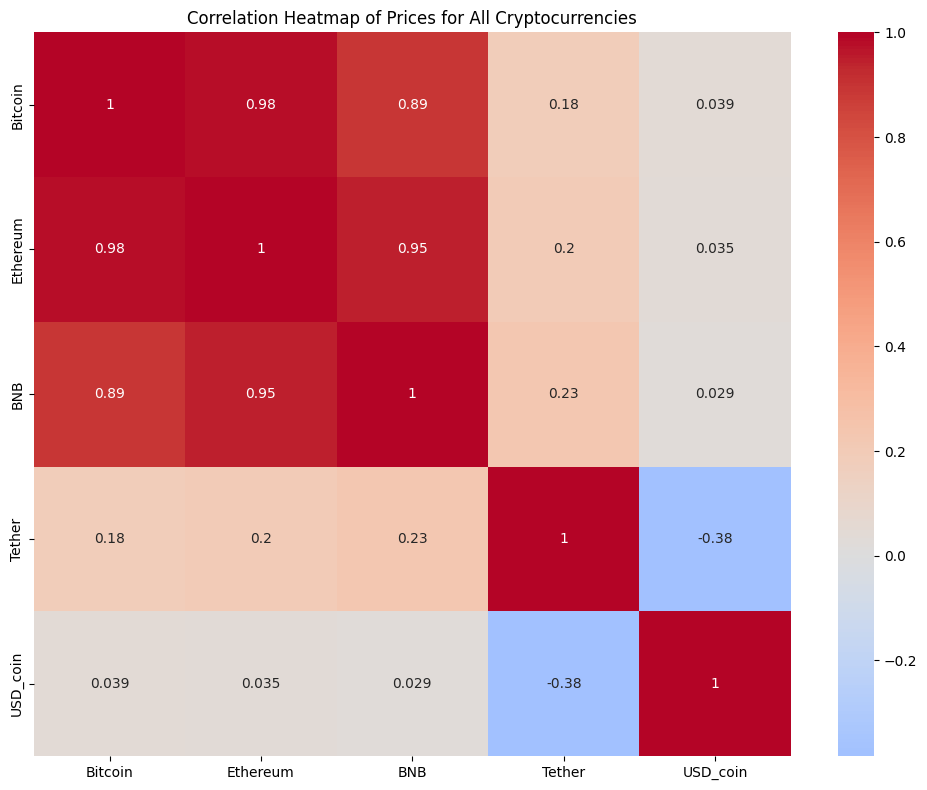

In [ ]:

# Column for which to calculate correlation and create heatmap
column_to_plot = 'Price'

# Create a DataFrame to store correlation coefficients
correlation_matrix = pd.DataFrame(index=[name for name, _ in dataframes], columns=[name for name, _ in dataframes])

# Calculate correlation coefficients for close prices
for name1, df1 in dataframes:
    for name2, df2 in dataframes:
        correlation = df1[column_to_plot].corr(df2[column_to_plot])
        correlation_matrix.loc[name1, name2] = correlation

# Convert correlation values to numeric
correlation_matrix = correlation_matrix.apply(pd.to_numeric)

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Prices for All Cryptocurrencies')
plt.tight_layout()
plt.show()

####Correlation Bitcoin


*   Below observation it is clear that whale transaction>100k USD,market cap are highly correlated with prices.
*   whale transaction>1m USD,Total NFT Trades Volume In USD,Amount of Uniq Addresses Bought More Than 100k USD of NFTs, Fear and greed index value are all slightly correlated with the price.



In [ ]:
df_btc.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume_x',
       'value', 'value_classification_encoded', 'Price', 'Volume_y',
       'Daily Active Addresses', 'Price MA(7)', 'Price MA(50)', 'Price MA(30)',
       'Price MA(200)', 'Volume.1', 'Marketcap', 'Social dominance',
       'Social dominance twitter news', 'Social volume', 'weighted sentiment',
       'trending words', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)'],
      dtype='object')

<ipython-input-42-db3514dae70a>:13: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_btc[numeric_columns].corr()


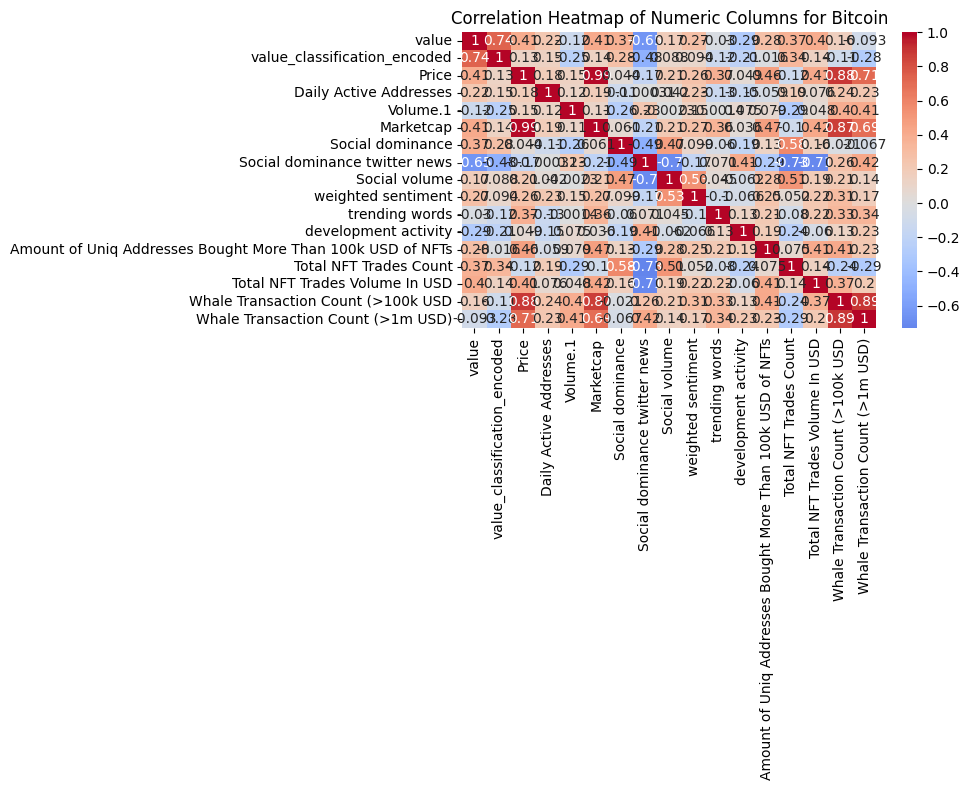

In [ ]:
# List of numeric column names
numeric_columns = ['Date',
       'value', 'value_classification_encoded', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
       'Social dominance twitter news', 'Social volume', 'weighted sentiment',
       'trending words', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_btc[numeric_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for Bitcoin')
plt.tight_layout()
plt.show()

<ipython-input-43-0ccbbb7cb8c0>:12: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_btc[required_columns].corr()


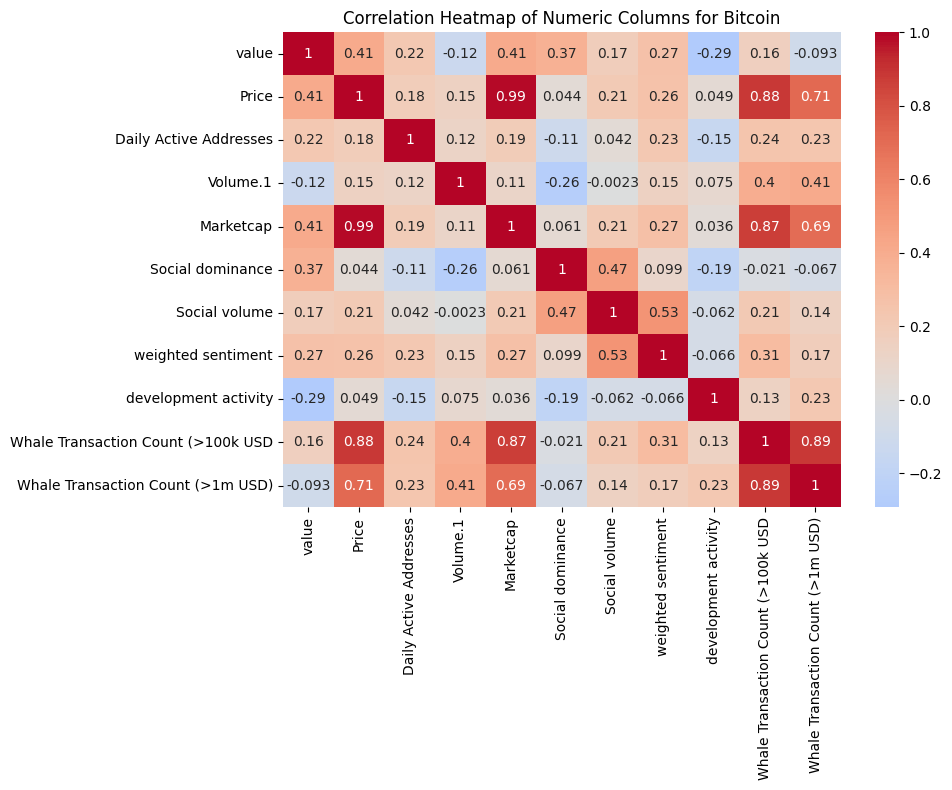

In [ ]:
required_columns = ['Date',
       'value', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
        'Social volume', 'weighted sentiment',
        'development activity',


       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_btc[required_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for Bitcoin')
plt.tight_layout()
plt.show()

####Correlation Ethereum

<ipython-input-44-bd7596879dbf>:13: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_eth[numeric_columns].corr()


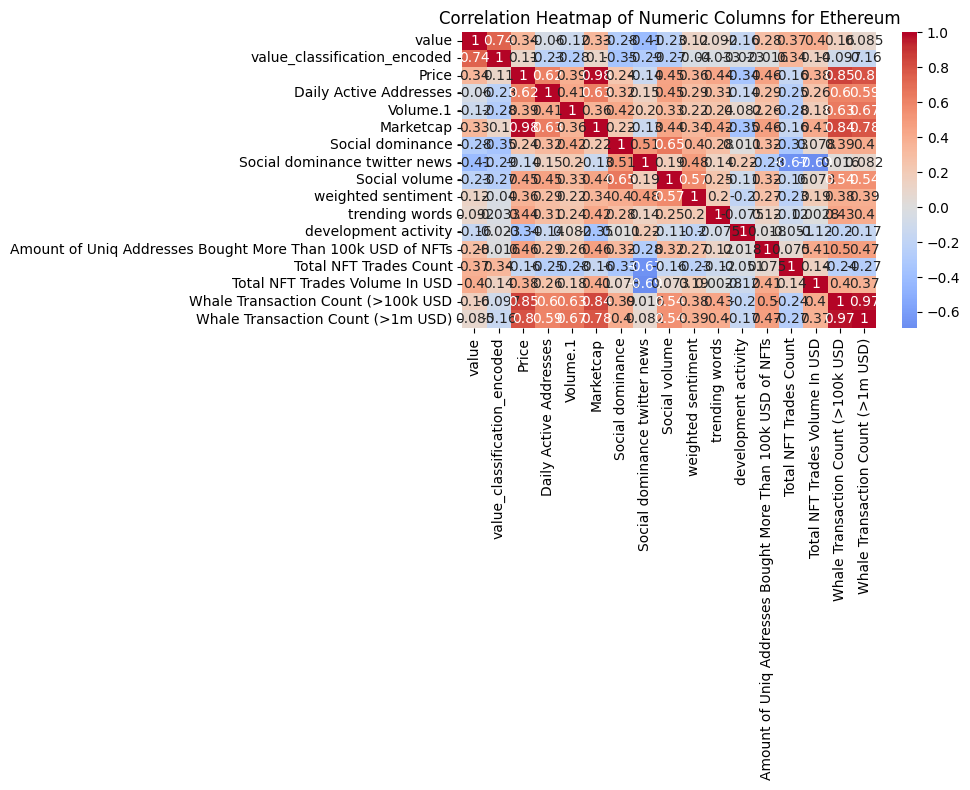

In [ ]:
# List of numeric column names
numeric_columns = ['Date',
       'value', 'value_classification_encoded', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
       'Social dominance twitter news', 'Social volume', 'weighted sentiment',
       'trending words', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_eth[numeric_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for Ethereum')
plt.tight_layout()
plt.show()

####Correlation BNB

<ipython-input-45-60d3c40f9213>:13: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_bnb[numeric_columns].corr()


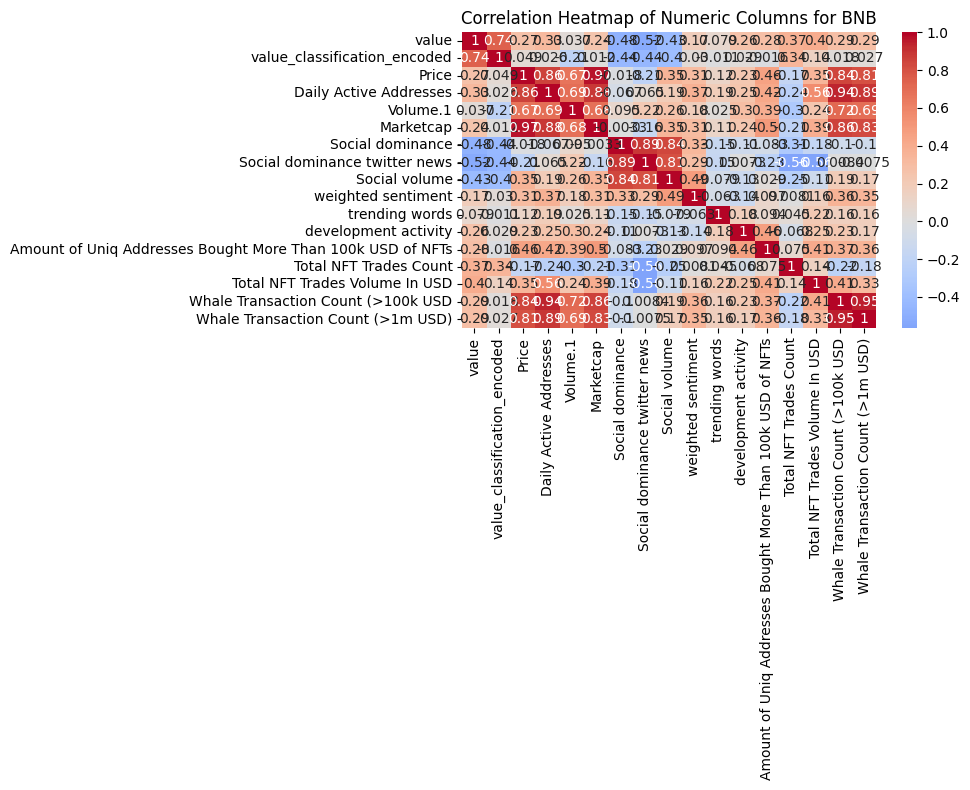

In [ ]:
# List of numeric column names
numeric_columns = ['Date',
       'value', 'value_classification_encoded', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
       'Social dominance twitter news', 'Social volume', 'weighted sentiment',
       'trending words', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_bnb[numeric_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for BNB')
plt.tight_layout()
plt.show()

####Correlation Tether


*   It is peculiar that the market cap and whale transactions are not paying much significant role for tether price.




<ipython-input-46-1420d7963a9b>:13: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_tether[numeric_columns].corr()


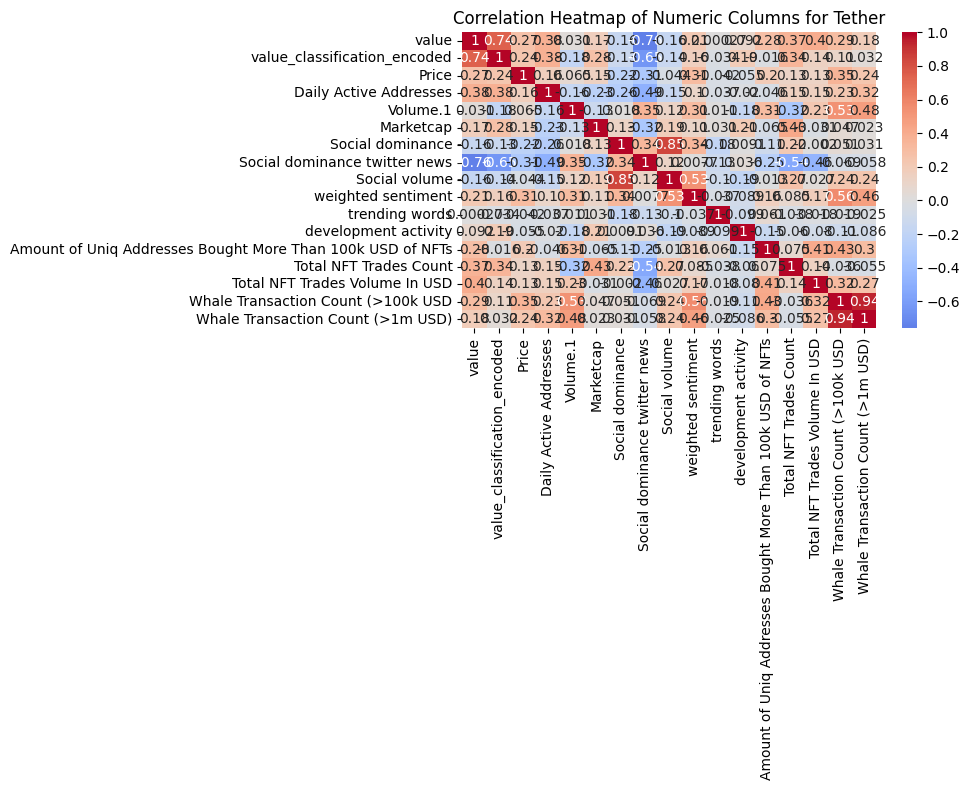

In [ ]:
# List of numeric column names
numeric_columns = ['Date',
       'value', 'value_classification_encoded', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
       'Social dominance twitter news', 'Social volume', 'weighted sentiment',
       'trending words', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_tether[numeric_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for Tether')
plt.tight_layout()
plt.show()

<ipython-input-47-8090fe171cbf>:10: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_tether[required_columns].corr()


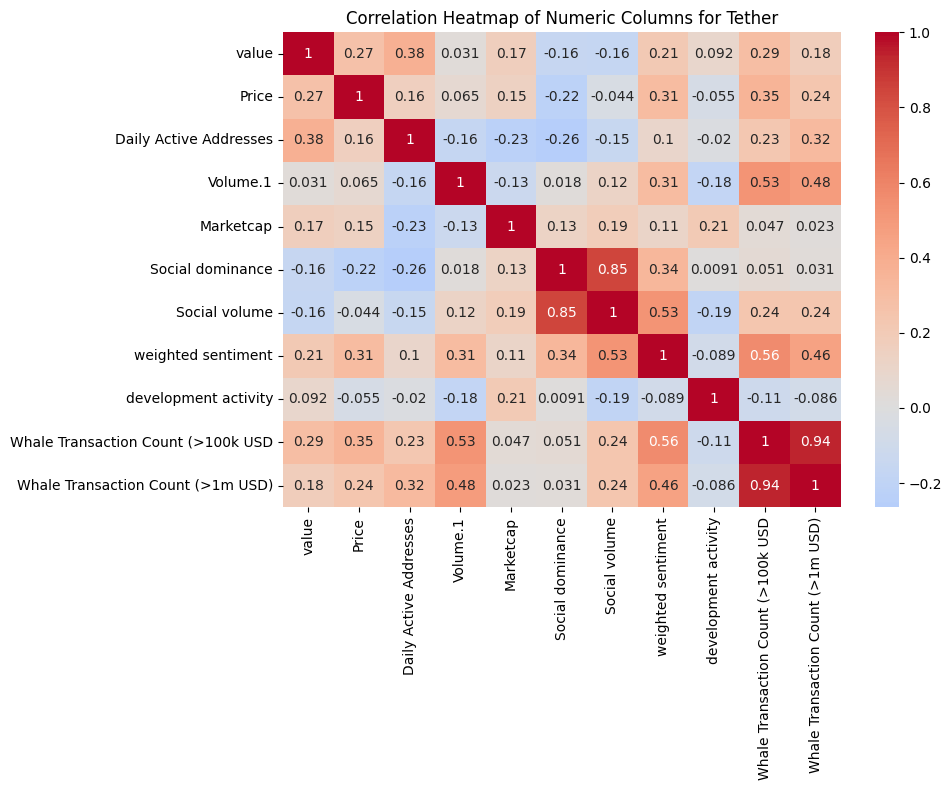

In [ ]:
required_columns = ['Date',
       'value', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
        'Social volume', 'weighted sentiment',
        'development activity',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_tether[required_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for Tether')
plt.tight_layout()
plt.show()

####Correlation USD coin

<ipython-input-48-981ed2069ce7>:13: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_usdc[numeric_columns].corr()


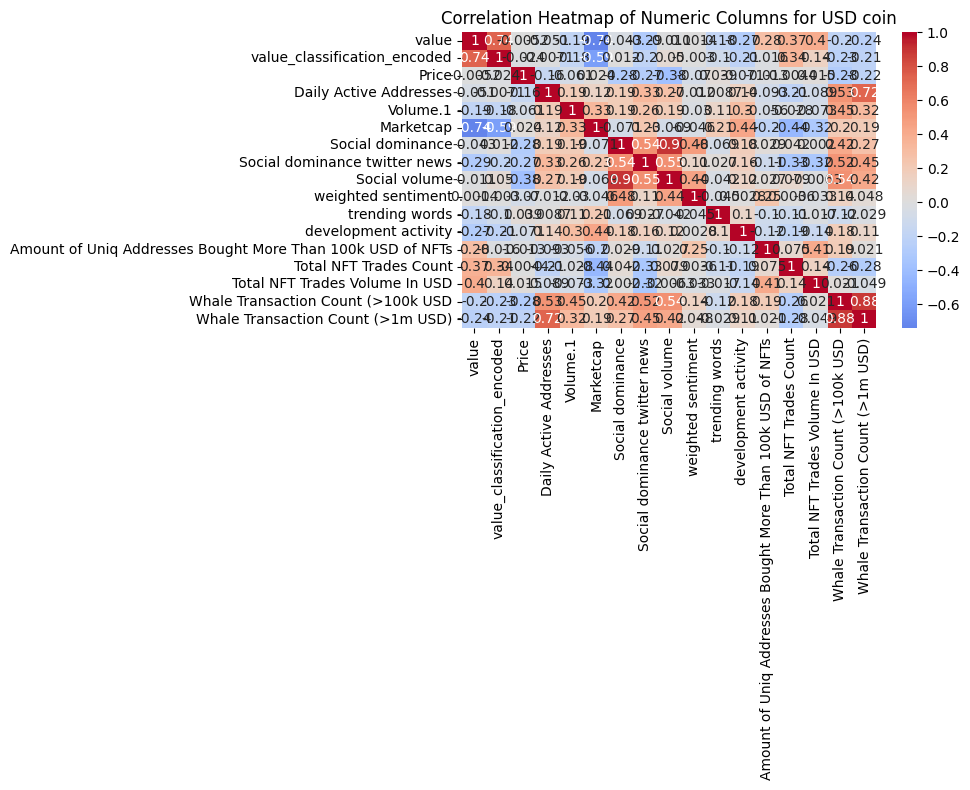

In [ ]:
# List of numeric column names
numeric_columns = ['Date',
       'value', 'value_classification_encoded', 'Price',
       'Daily Active Addresses', 'Volume.1', 'Marketcap', 'Social dominance',
       'Social dominance twitter news', 'Social volume', 'weighted sentiment',
       'trending words', 'development activity',
       'Amount of Uniq Addresses Bought More Than 100k USD of NFTs',
       'Total NFT Trades Count', 'Total NFT Trades Volume In USD',
       'Whale Transaction Count (>100k USD',
       'Whale Transaction Count (>1m USD)']

# Calculate correlation coefficients for numeric columns
correlation_matrix = df_usdc[numeric_columns].corr()

# Create a correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Numeric Columns for USD coin')
plt.tight_layout()
plt.show()

###Area Plot

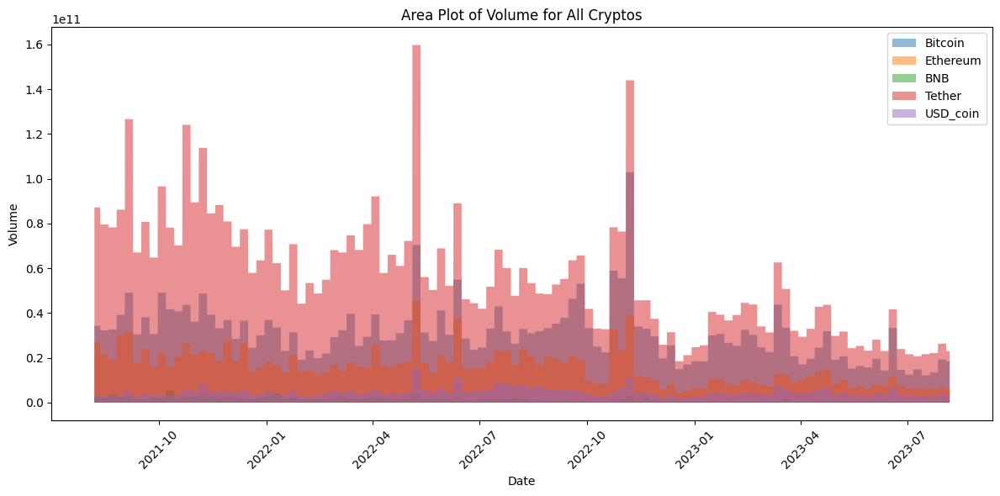

In [ ]:
# Plot a single area plot for volume of each DataFrame
plt.figure(figsize=(12, 6))

for name, df in dataframes:
    plt.fill_between(df['Date'], df['Volume.1'], alpha=0.5, label=name)

plt.title('Area Plot of Volume for All Cryptos')
plt.xlabel('Date')
plt.ylabel('Volume')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

It is observed that the tether has high trading volume followed by Bitcoin,BNB,Tether and USD coin.

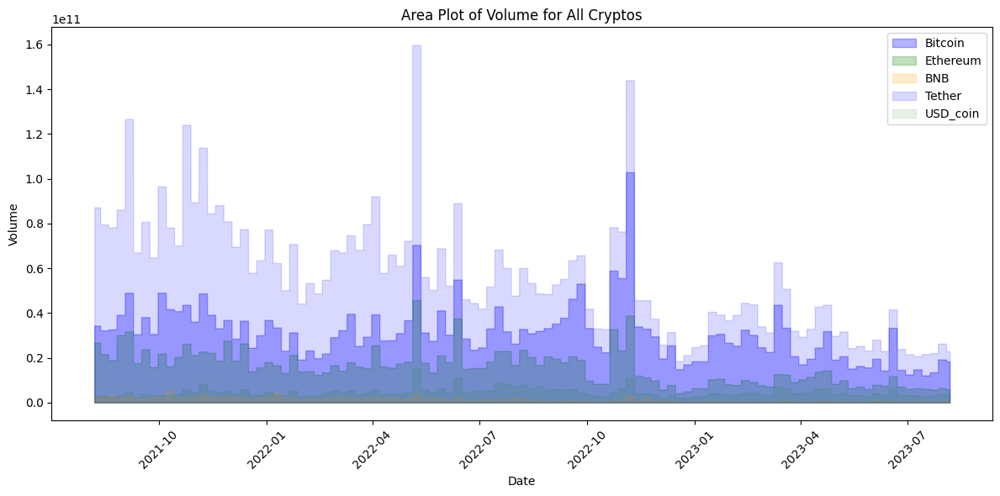

In [ ]:


# Assuming you have a list of dataframes, 'dataframes', where each element is a tuple of (name, df)

plt.figure(figsize=(12, 6))

# Define a list of colors for the area plots
colors = ['blue', 'green', 'orange']

for i, (name, df) in enumerate(dataframes):
    color = colors[i % len(colors)]  # Cycle through colors if there are more dataframes than colors
    alpha = 0.3 - i * 0.05  # Adjust alpha to prevent overlap
    plt.fill_between(df['Date'], df['Volume.1'], alpha=alpha, label=name, color=color)

plt.title('Area Plot of Volume for All Cryptos')
plt.xlabel('Date')
plt.ylabel('Volume')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


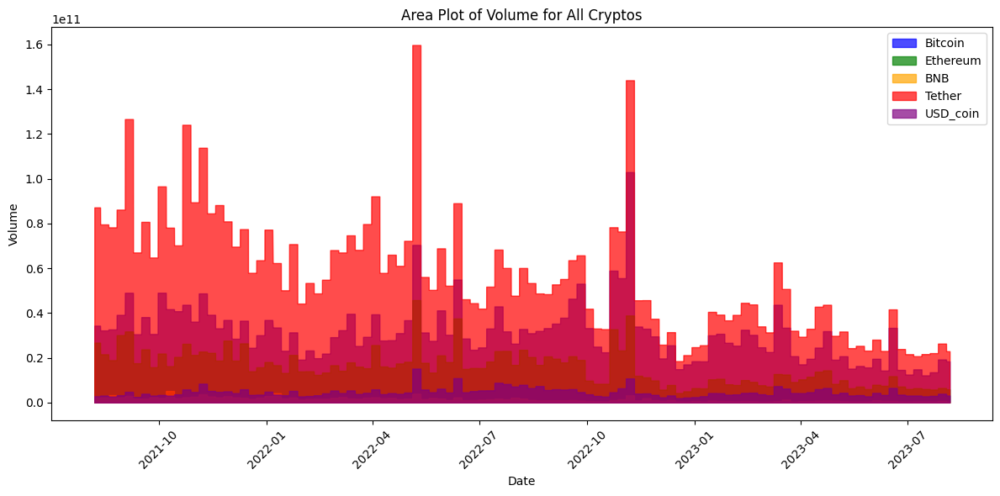

In [ ]:



plt.figure(figsize=(12, 6))

# Define a list of colors for the area plots
colors = ['blue', 'green', 'orange', 'red', 'purple', 'brown']

for i, (name, df) in enumerate(dataframes):
    color = colors[i % len(colors)]  # Cycle through colors if there are more dataframes than colors
    plt.fill_between(df['Date'], df['Volume.1'], alpha=0.7, label=name, color=color)

plt.title('Area Plot of Volume for All Cryptos')
plt.xlabel('Date')
plt.ylabel('Volume')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


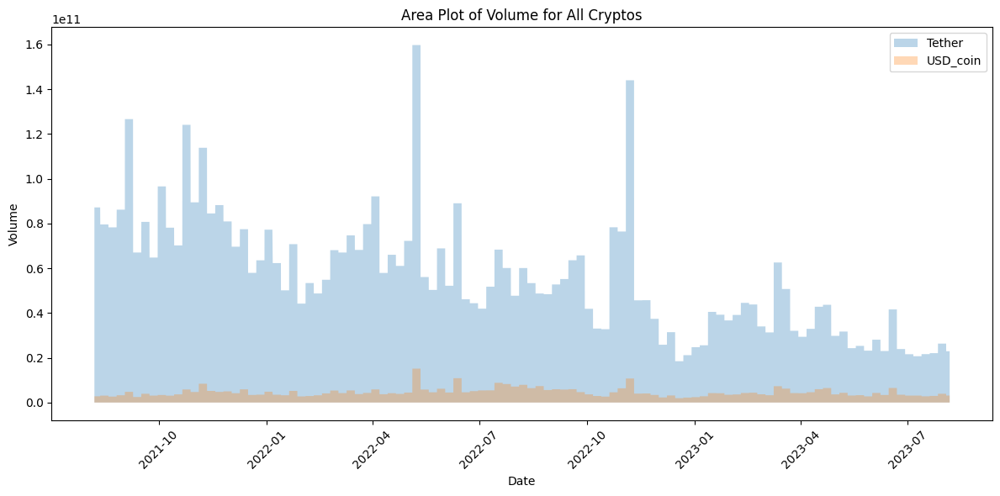

In [ ]:
# Plot a single area plot for volume of each DataFrame
plt.figure(figsize=(12, 6))

for name, df in stable_coins:
    plt.fill_between(df['Date'], df['Volume.1'], alpha=0.3, label=name)

plt.title('Area Plot of Volume for All Cryptos')
plt.xlabel('Date')
plt.ylabel('Volume')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

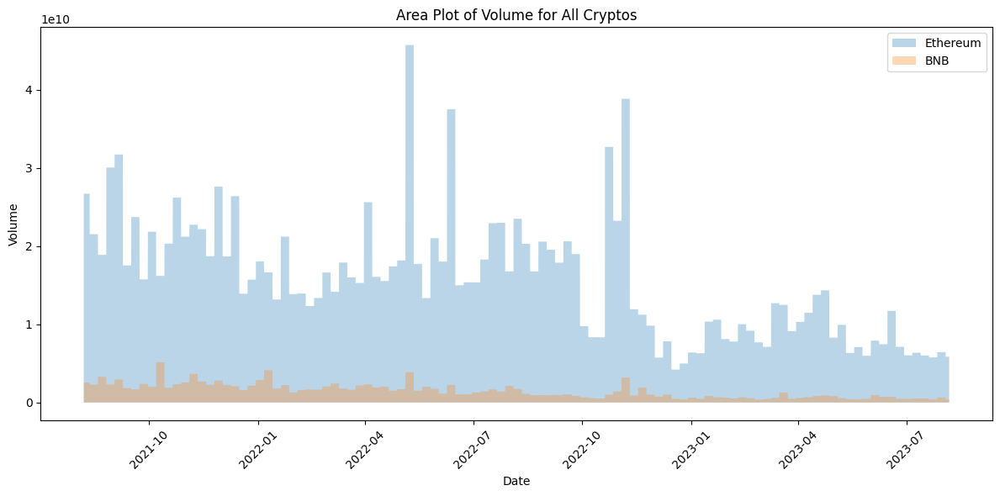

In [ ]:

# Plot a single area plot for volume of each DataFrame
plt.figure(figsize=(12, 6))

for name, df in Bnb_eth_coins:
    plt.fill_between(df['Date'], df['Volume.1'], alpha=0.3, label=name)

plt.title('Area Plot of Volume for All Cryptos')
plt.xlabel('Date')
plt.ylabel('Volume')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

###Box Plot

It is observed that Bitcoin has higher price followed by ethereum, bnb, tether and usdc.

BNB,tether and usdc has few outliers which are not significant.

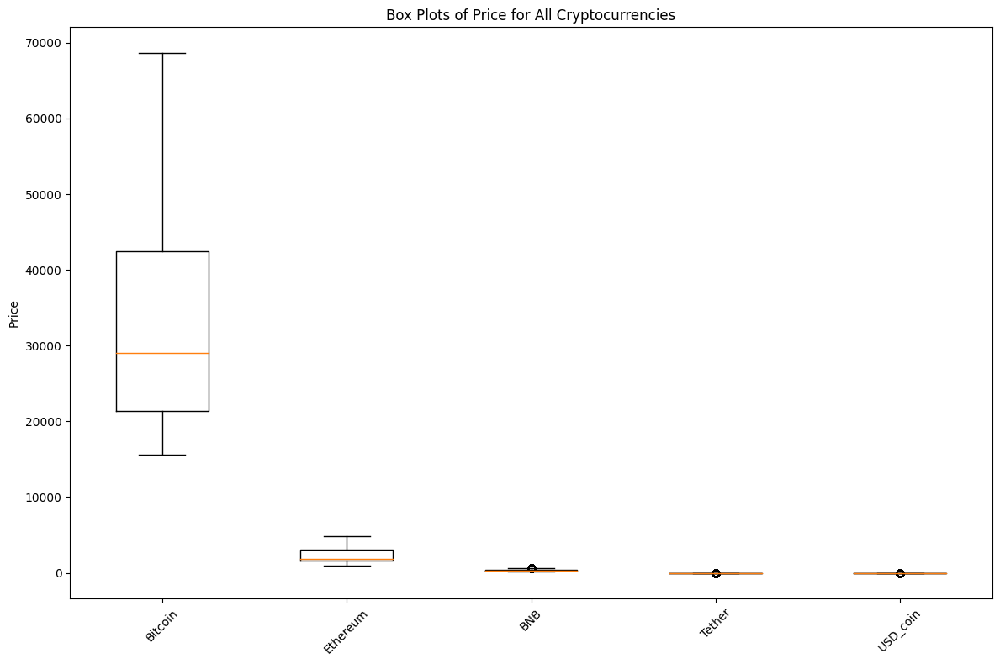

In [ ]:
# Column for which to create bar plots
column_to_plot = 'Price'

# Create side-by-side box plots for the specified column in all DataFrames
plt.figure(figsize=(12, 8))

data_to_plot = [df[column_to_plot] for _, df in dataframes]
names = [name for name, _ in dataframes]

plt.boxplot(data_to_plot, labels=names)
plt.title(f'Box Plots of {column_to_plot} for All Cryptocurrencies')
plt.ylabel(column_to_plot)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#ML models

In [ ]:
df_btc.set_index('Date', inplace=True)

###Check Stationarity

####Augumented Dickey Fuller Test
The Augmented Dickey-Fuller (ADF) test is a statistical test used to determine whether a given time series data is stationary or non-stationary.

The P value below is >0.05 which means we cannot reject null hypothesis and the data is not stationary.

ADF Statistic: -1.3130285383681355
p-value: 0.6231908632883106
Critical Values: {'1%': -3.4307282690061256, '5%': -2.8617071801628327, '10%': -2.5668589856832766}


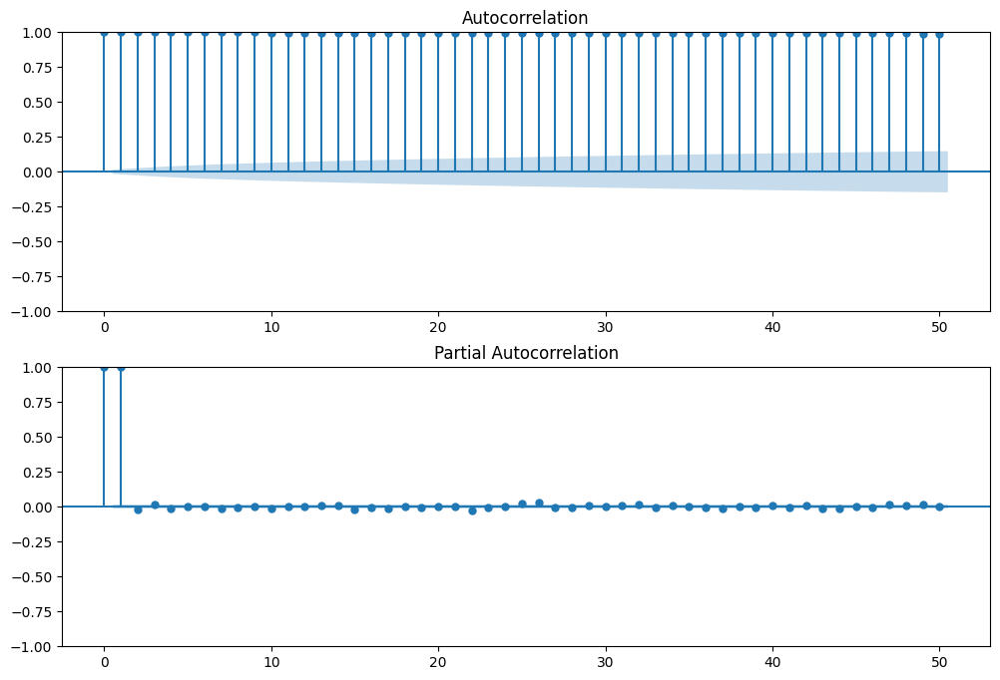

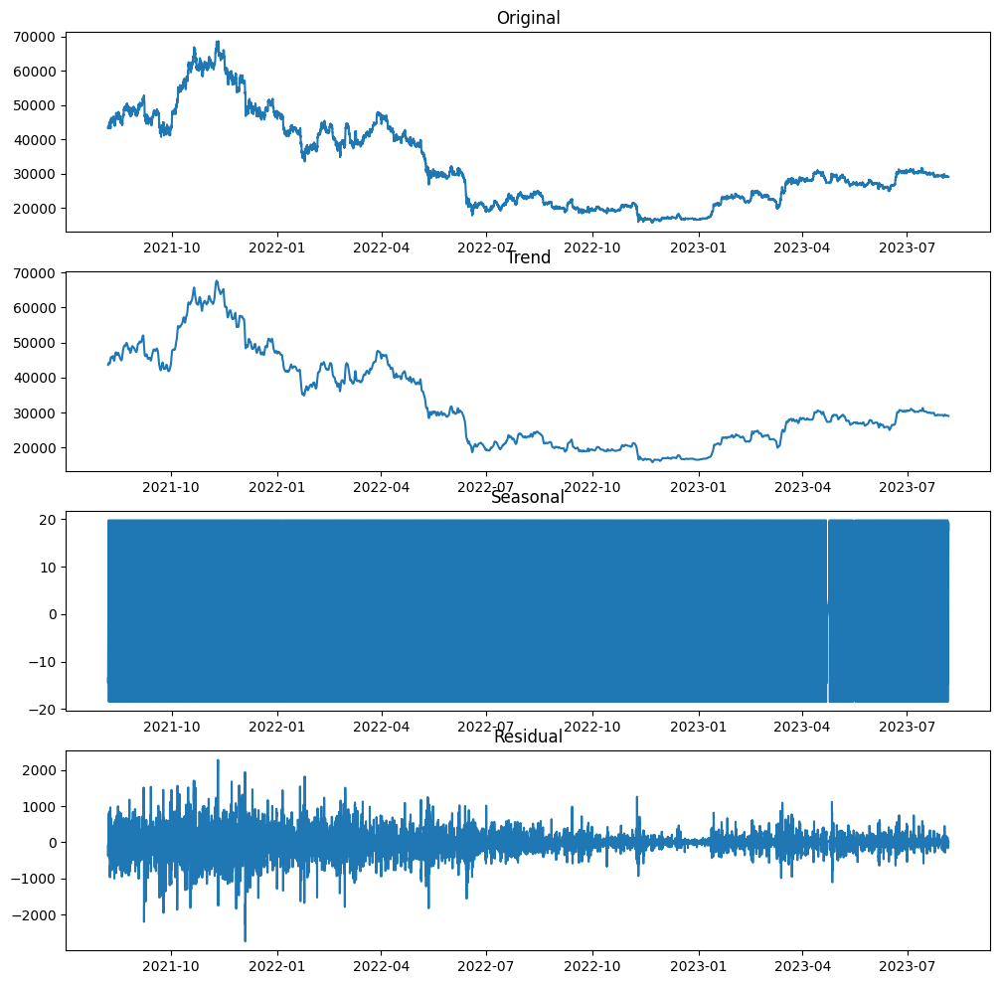

In [ ]:
# Define a function to check stationarity
def check_stationarity(ts):

    # Perform Augmented Dickey-Fuller Test
    adf_result = adfuller(ts, autolag='AIC')
    print(f'ADF Statistic: {adf_result[0]}')
    print(f'p-value: {adf_result[1]}')
    print(f'Critical Values: {adf_result[4]}')

    # Plot ACF and PACF to determine order of differencing and MA, AR components
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))
    plot_acf(ts, ax=ax1, lags=50)
    plot_pacf(ts, ax=ax2, lags=50)
    plt.show()

    # Decompose the time series to check for seasonality
    decomposition = seasonal_decompose(ts, model='additive', period=24)  # Assuming hourly data with daily seasonality
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(12, 12))
    ax1.set_title('Original')
    ax1.plot(decomposition.observed, label='Original')
    ax2.set_title('Trend')
    ax2.plot(decomposition.trend, label='Trend')
    ax3.set_title('Seasonal')
    ax3.plot(decomposition.seasonal, label='Seasonal')
    ax4.set_title('Residual')
    ax4.plot(decomposition.resid, label='Residual')
    plt.show()

# Apply the stationarity check function to your time series
check_stationarity(df_btc['Close'])


####Box cox transformation
The Box-Cox transformation is a statistical technique used to stabilize the variance of a dataset and to transform data that is skewed or has outliers.

Below is the result p value>0.05  where we cannot reject null hypothesis and data is non stationary.

In [ ]:

def box_cox(df):
  # Apply the Box-Cox transformation
  df_boxcox = boxcox(df['Close'], lmbda=0.5)

  # Perform the ADF test on the transformed data
  result = adfuller(df_boxcox, maxlag=75)

  # Print the results of the ADF test
  print("p-value =",result[1])

box_cox(df_btc)

p-value = 0.6299420969639883


In [ ]:

def box_cox(df):
  # Apply the Box-Cox transformation to the 'Close' column
  df['Prices'], lmbda = boxcox(df['Close'])

  adf_result = adfuller(df['Prices'])
  p_value = adf_result[1]

  # Print the ADF test result
  print("p-value =", p_value)

box_cox(df_btc)

p-value = 0.6138542054559284


####Seasonal differencing

p value is less than 0.05 indicating that data is stationary and can reject null hypothesis.

> If the seasonal plot is a straight horizontal line, it means the
seasonal component is effectively zero - i.e. no discernible seasonal pattern was found.

> All the p values for lag observations are 0.000 which is lower than 0.05 suggesting that data is stationary but the seasonality plot of them has no pattern or trend.

> However for 672 lags(observations) it is observed that the seasonality plot has some trend or pattern.





box_diff_seasonal_1 p value = 0.000000
box_diff_seasonal_3 p value = 0.000000
box_diff_seasonal_6 p value = 0.000000
box_diff_seasonal_12 p value = 0.000000
box_diff_seasonal_24 p value = 0.000000
box_diff_seasonal_168 p value = 0.000000
box_diff_seasonal_672 p value = 0.004827


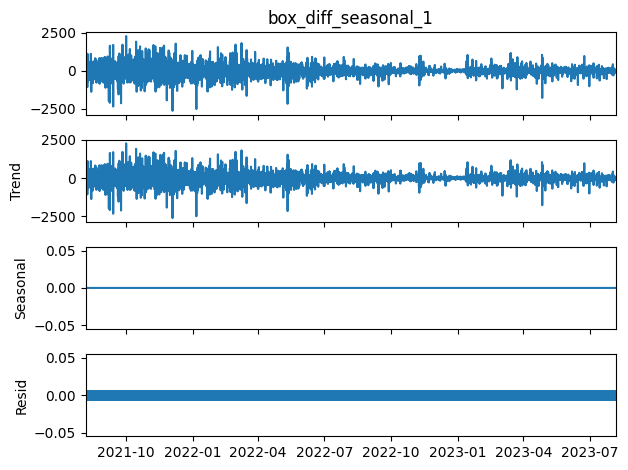

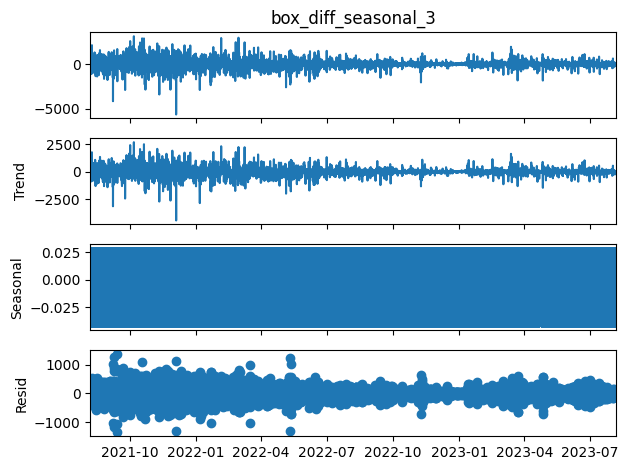

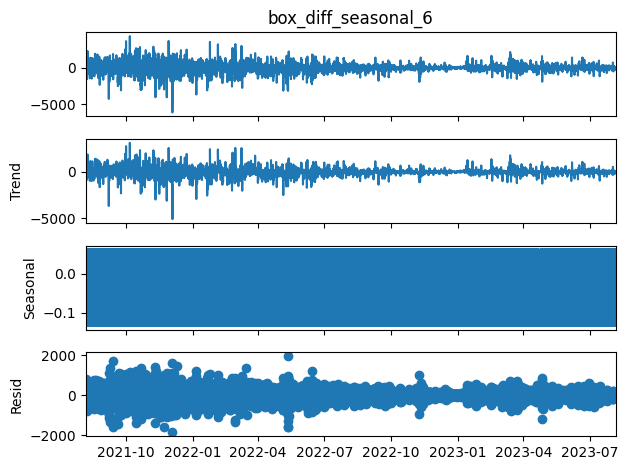

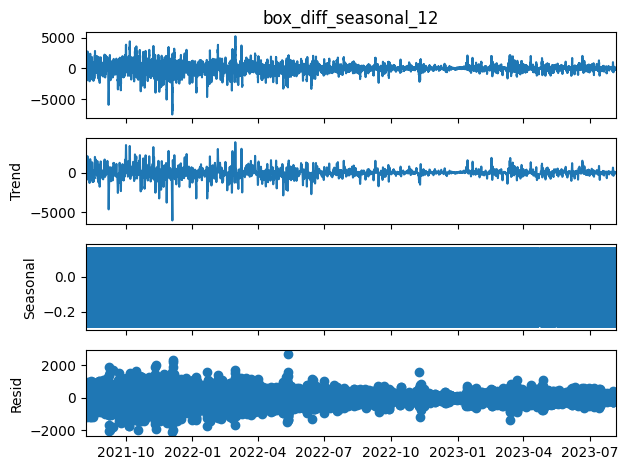

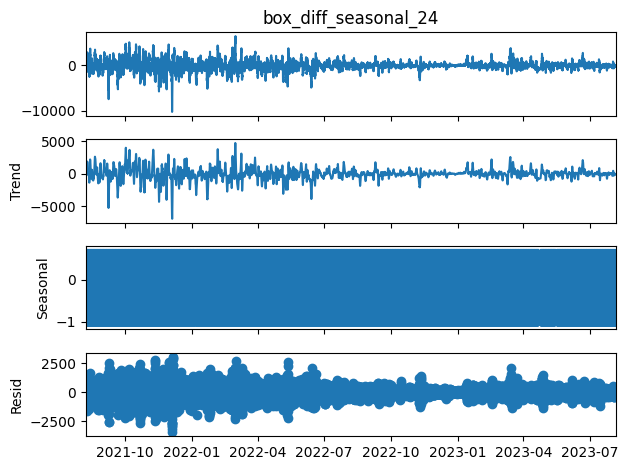

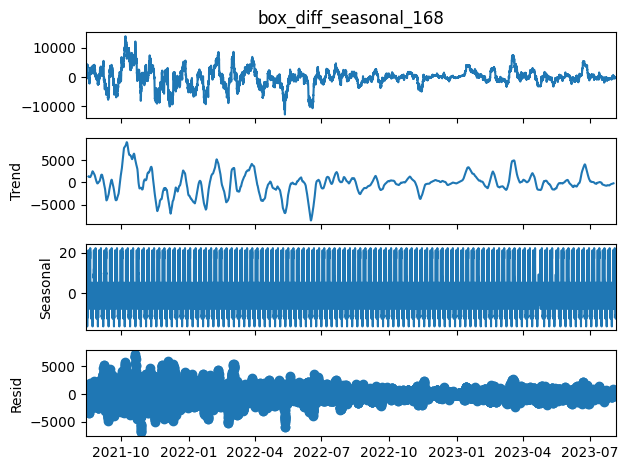

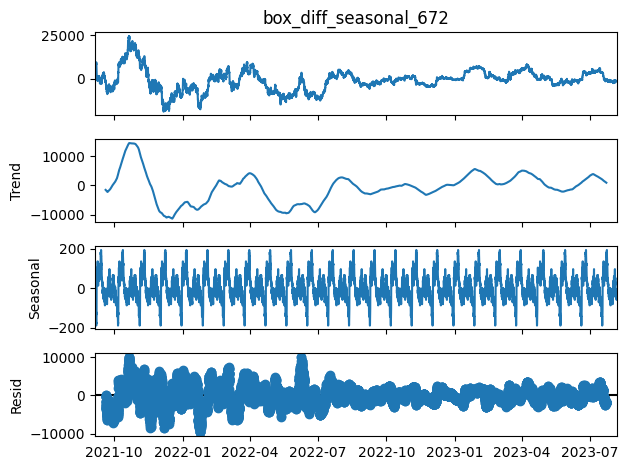

In [ ]:
# creating new dataframe to compute seasonal differentition for 1,3,6,12,24,168,672 lags(observations)

def Seasonal_diff(df):
  df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1)) #1hr
  df['box_diff_seasonal_3'] = (df.Close - df.Close.shift(3)) #3hrs
  df['box_diff_seasonal_6'] = (df.Close - df.Close.shift(6))  #6hrs
  df['box_diff_seasonal_12'] = (df.Close - df.Close.shift(12)) #12hrs
  df['box_diff_seasonal_24'] = (df.Close - df.Close.shift(24)) #daily
  df['box_diff_seasonal_168'] = (df.Close - df.Close.shift(168)) #WEEKLY
  df['box_diff_seasonal_672'] = (df.Close - df.Close.shift(672)) #MONTHLY

  #computation ADF test
  print("box_diff_seasonal_1 p value = %f" % adfuller(df.box_diff_seasonal_1[1:])[1])
  print("box_diff_seasonal_3 p value = %f" % adfuller(df.box_diff_seasonal_3[3:])[1])
  print("box_diff_seasonal_6 p value = %f" % adfuller(df.box_diff_seasonal_6[6:])[1])
  print("box_diff_seasonal_12 p value = %f" % adfuller(df.box_diff_seasonal_12[12:])[1])
  print("box_diff_seasonal_24 p value = %f" % adfuller(df.box_diff_seasonal_24[24:])[1])
  print("box_diff_seasonal_168 p value = %f" % adfuller(df.box_diff_seasonal_168[168:])[1])
  print("box_diff_seasonal_672 p value = %f" % adfuller(df.box_diff_seasonal_672[672:])[1])

  seasonal_decompose(df.box_diff_seasonal_1[1:],period=1).plot()
  seasonal_decompose(df.box_diff_seasonal_3[3:],period=3).plot()
  seasonal_decompose(df.box_diff_seasonal_6[6:],period=6).plot()
  seasonal_decompose(df.box_diff_seasonal_12[12:],period=12).plot()
  seasonal_decompose(df.box_diff_seasonal_24[24:],period=24).plot()
  seasonal_decompose(df.box_diff_seasonal_168[168:],period=168).plot()
  seasonal_decompose(df.box_diff_seasonal_672[672:],period=672).plot()

Seasonal_diff(df_btc)

####Second order differencing

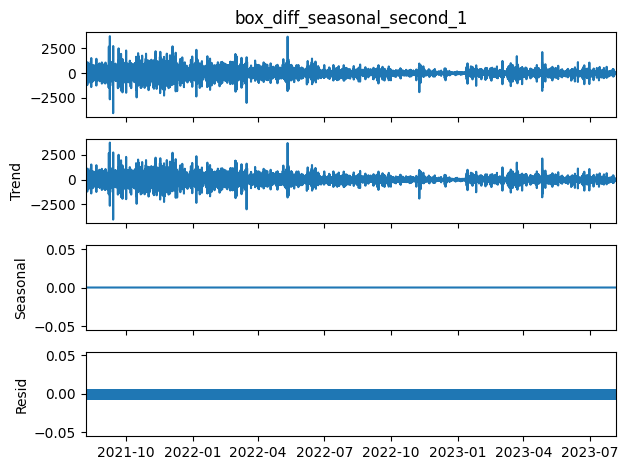

In [ ]:
df= df_btc
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1)) #1hr

df['box_diff_seasonal_second_1'] = (df.box_diff_seasonal_1[1:] - df.box_diff_seasonal_1[1:].shift(1)) #1hr
seasonal_decompose(df.box_diff_seasonal_second_1[2:],period=1).plot()

plt.show()

####Auto correlation & partial auto correlation


> Below auto correlation plot shows significant spike at 0 lag, can take AR as 0.

> Below partial auto correlation plot shows significant spike at 0, can take MA as 0.



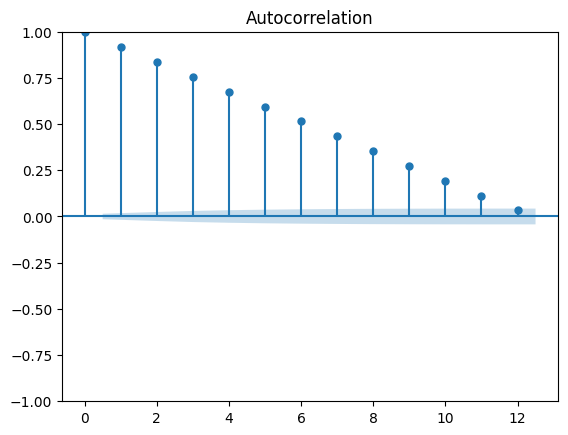

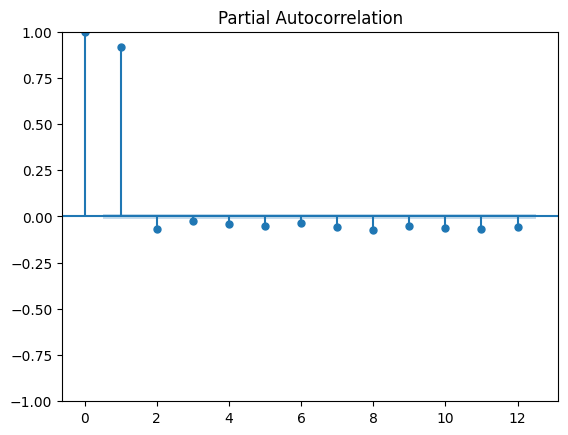

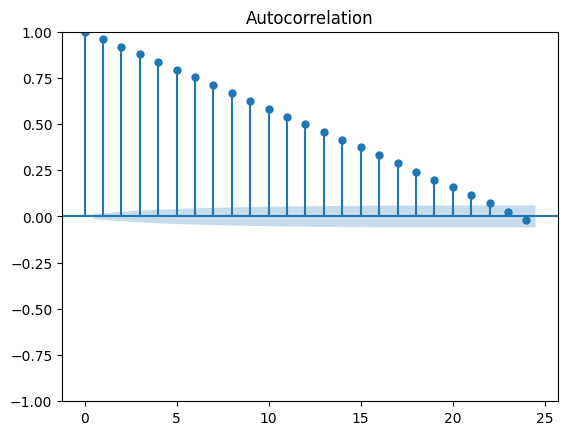

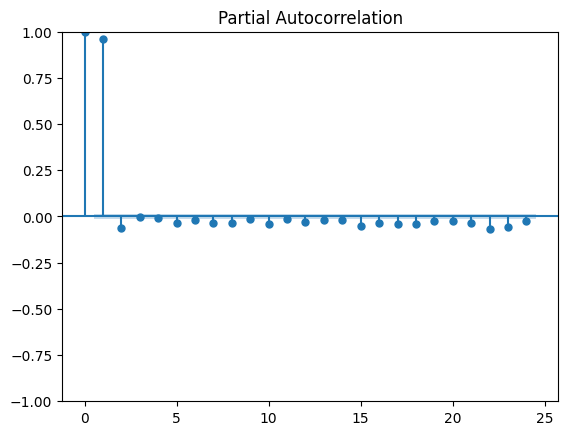

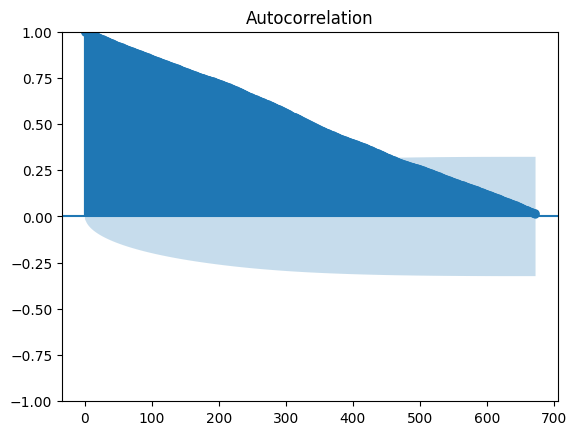

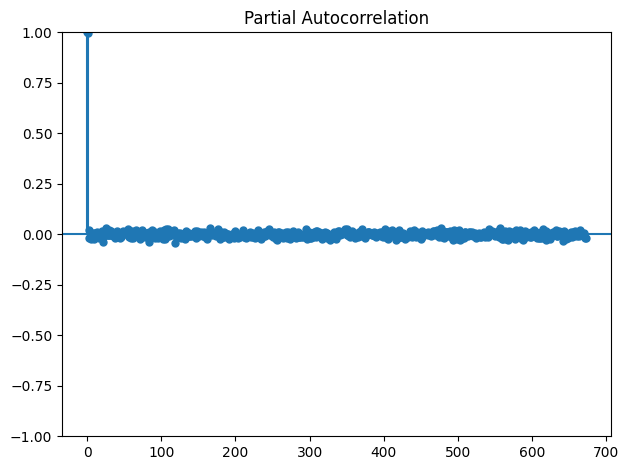

In [ ]:
def AC_PAC(df):
  df['box_diff_seasonal_12'] = (df.Close - df.Close.shift(12)) #12hrs
  df['box_diff_seasonal_24'] = (df.Close - df.Close.shift(24)) #daily
  df['box_diff_seasonal_672'] = (df.Close - df.Close.shift(672)) #monthly

  plot_acf(df['box_diff_seasonal_12'][12:].values.squeeze(), lags=12)
  plot_pacf(df['box_diff_seasonal_12'][12:].values.squeeze(), lags=12)

  plot_acf(df['box_diff_seasonal_24'][24:].values.squeeze(), lags=24)
  plot_pacf(df['box_diff_seasonal_24'][24:].values.squeeze(), lags=24)

  plot_acf(df['box_diff_seasonal_672'][672:].values.squeeze(), lags=672)
  plot_pacf(df['box_diff_seasonal_672'][672:].values.squeeze(), lags=672)

  plt.tight_layout()
  plt.show()

AC_PAC(df_btc.copy())

###ARIMA


> Forecasting for 30 days on hourly basis.

> The MAE error rate is > 50 which is higher, other error rate MSE and RMSE also has high error rate.

> Although the MAE values are lower for 1,7,30 day forecast it is observed from the plot that the prediction plot is linear and it is not learning any underlying patterns.




####Fine tune arima

In [ ]:
df =df_btc
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
#ts =df_btc['Close']
ts=df['box_diff_seasonal_1'][1:]

test_data = ts.iloc[-168:]

# The remaining data is the training data
train_data = ts.iloc[:-168]

model = auto_arima(train_data, seasonal=True, stepwise=True, suppress_warnings=True, error_action="ignore")

# Print the summary of the best model
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                17147
Model:               SARIMAX(2, 0, 3)   Log Likelihood             -116873.379
Date:                Sun, 15 Oct 2023   AIC                         233760.757
Time:                        16:41:31   BIC                         233815.004
Sample:                             0   HQIC                        233778.638
                              - 17147                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     -0.9708      5.411     -0.179      0.858     -11.576       9.635
ar.L1         -1.1547      0.006   -200.484      0.000      -1.166      -1.143
ar.L2         -0.9792      0.006   -157.199      0.0

Model diagnostics

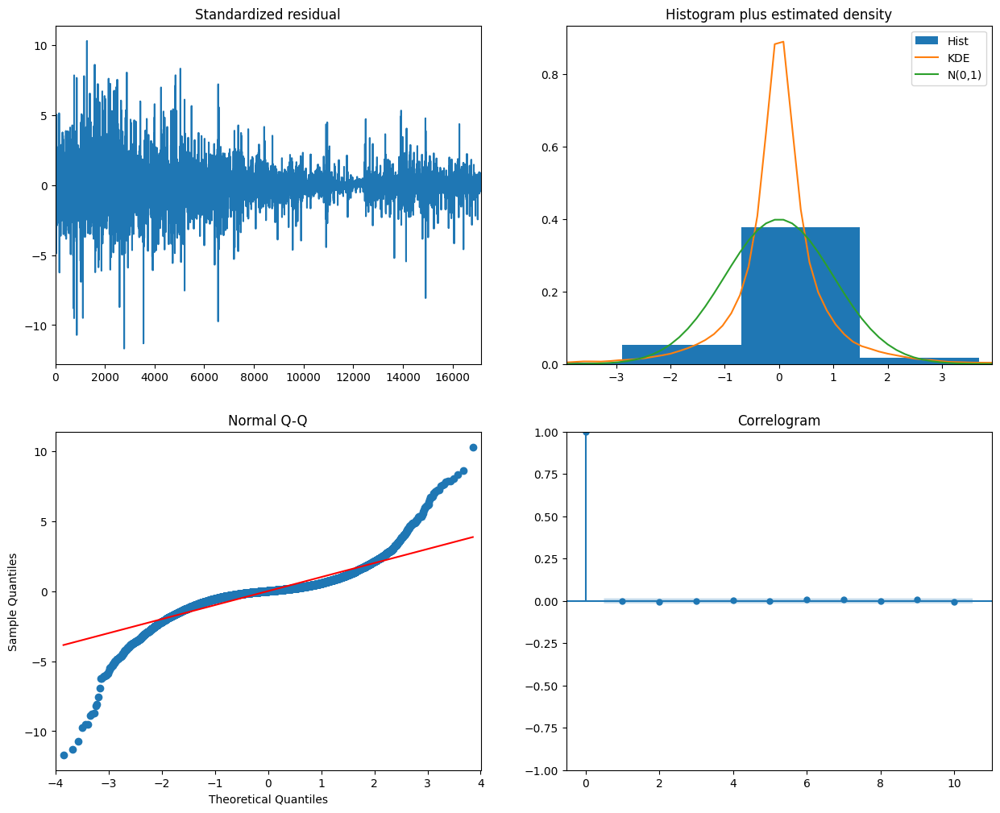

In [ ]:
model.plot_diagnostics(figsize=(15,12))
plt.show()

In [ ]:
df_btc[['Close','box_diff_seasonal_1','box_diff_seasonal_3','box_diff_seasonal_12']].head(50)

,Close,box_diff_seasonal_1,box_diff_seasonal_3,box_diff_seasonal_12
Date,,,,
2021-08-07 00:00:00,43218.195312,NaN,NaN,NaN
2021-08-07 01:00:00,43227.308594,9.113281,NaN,NaN
2021-08-07 02:00:00,43304.347656,77.039062,NaN,NaN
2021-08-07 03:00:00,43767.613281,463.265625,549.417969,NaN
2021-08-07 04:00:00,43361.441406,-406.171875,134.132812,NaN
2021-08-07 05:00:00,43418.191406,56.750000,113.843750,NaN
2021-08-07 06:00:00,43284.878906,-133.312500,-482.734375,NaN
2021-08-07 07:00:00,43262.601562,-22.277344,-98.839844,NaN
2021-08-07 08:00:00,43471.585938,208.984375,53.394531,NaN


####30 Day forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


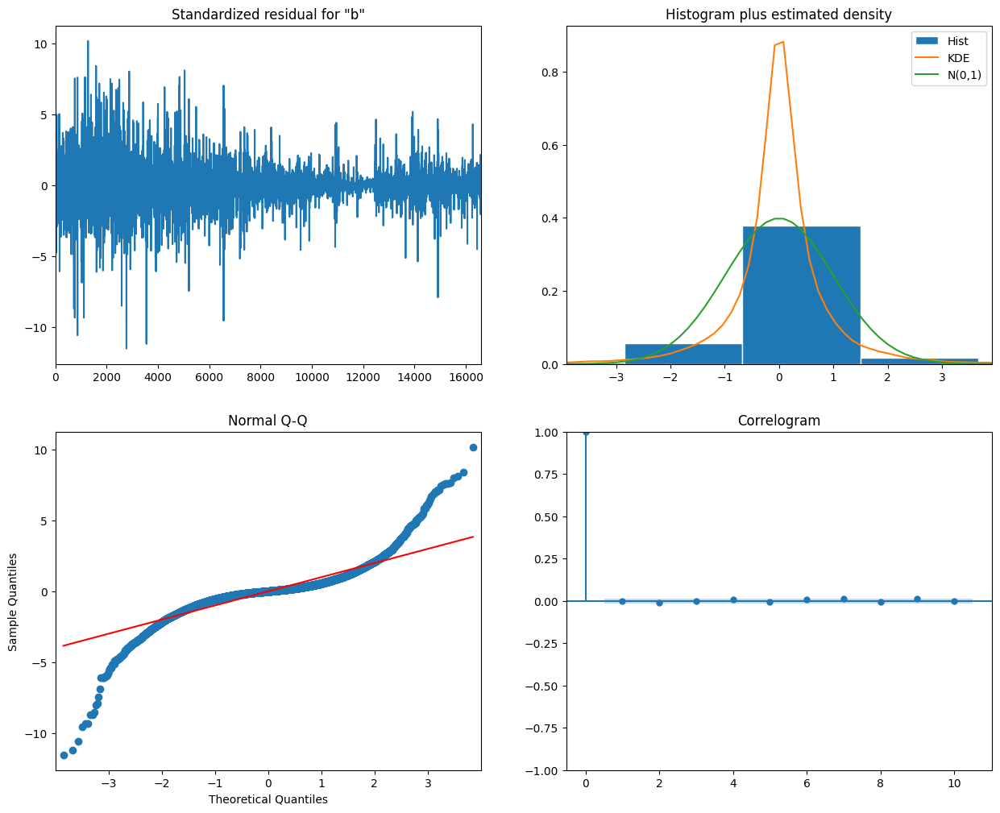

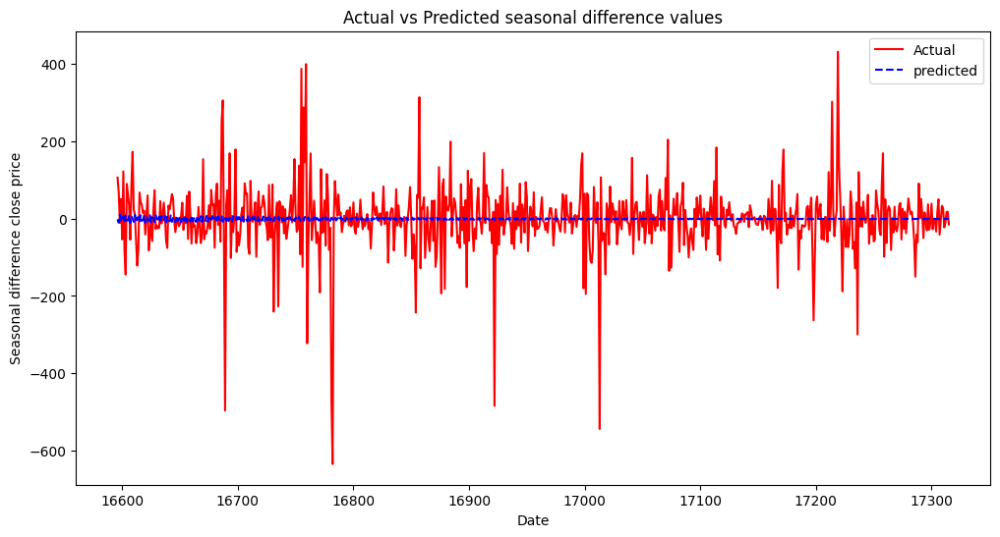

Mean Absolute Error (MAE): 52.6651859339055
Mean Squared Error (MSE): 7287.417061605932
Root Mean Squared Error (RMSE): 85.36636961711521
R2 score: -0.004988670988432808


In [ ]:
p,d,q = 2,0,3
def arima_forecast(df,days):

  ts =df
  test_data = ts.iloc[-24*days:] #test data
  # The remaining data is the training data
  train_data = ts.iloc[:-24*days]

  test_data = pd.DataFrame(test_data) #convert series to df
  test_data2= test_data.copy()

  model = ARIMA(train_data, order=(p,d,q))  # ARIMA(p, d, q) order

  model_fit = model.fit()
  model_fit.plot_diagnostics(figsize=(15,12))

  forecast_steps=len(test_data)
  forecast = model_fit.forecast(steps=forecast_steps)

  df_forecast = pd.DataFrame(forecast.values, columns=['Forecasted Close'], index=test_data.index)

  plt.figure(figsize=(12, 6))
  plt.plot(test_data, color='red', label='Actual')
  plt.plot(df_forecast['Forecasted Close'],ls='--', color='blue', label='predicted')
  #plt.plot(pd.date_range(start=test_data.index[0], periods=forecast_steps+1, inclusive='right'), forecast, label='Forecasted Prices', color='blue')
  plt.xlabel('Date')
  plt.ylabel('Seasonal difference close price')
  plt.title('Actual vs Predicted seasonal difference values')
  plt.legend()
  plt.show()

  # Calculate Mean Absolute Error (MAE)
  mae = mean_absolute_error(test_data2, df_forecast['Forecasted Close'])

  # Calculate Mean Squared Error (MSE)
  mse = mean_squared_error(test_data2, df_forecast['Forecasted Close'])

  # Calculate Root Mean Squared Error (RMSE)
  rmse = np.sqrt(mse)

  #R2score
  r2 = r2_score(test_data2, df_forecast['Forecasted Close'])

  # Print the metrics
  print(f"Mean Absolute Error (MAE): {mae}")
  print(f"Mean Squared Error (MSE): {mse}")
  print(f"Root Mean Squared Error (RMSE): {rmse}")
  print(f"R2 score: {r2}")

  return df_forecast

df =df_btc
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
df_forecast = arima_forecast(df['box_diff_seasonal_1'],30)


Merging seasonal, forecasted and actual close values to determine forecasted close price

In [ ]:

df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

In [ ]:
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-07 00:00:00,30038.089844,106.150391,30038.089844,30038.089844
2023-07-07 01:00:00,30106.765625,68.675781,10.110559,30048.200403
2023-07-07 02:00:00,30095.699219,-11.066406,-7.820515,30040.379888
2023-07-07 03:00:00,30146.527344,50.828125,-0.991874,30039.388013
2023-07-07 04:00:00,30092.861328,-53.666016,6.445015,30045.833028
2023-07-07 05:00:00,30215.101562,122.240234,-11.574521,30034.258507
2023-07-07 06:00:00,30132.957031,-82.144531,8.320655,30042.579162
2023-07-07 07:00:00,29988.156250,-144.800781,-3.925434,30038.653728
2023-07-07 08:00:00,30078.146484,89.990234,-5.111683,30033.542045


An R-squared score of 0.3944 indicates that the linear regression model explains a moderate amount of the variance in the dependent variable. This means that the independent variable(s) are able to explain about 39% of the variation in the dependent variable. In other words, the model is able to predict the values of the dependent variable with moderate accuracy.

An R-squared score of 0 is considered to be low, while an R-squared score of 1 is considered to be high. A moderate R-squared score, such as 0.3944, suggests that the model is a reasonable fit for the data. However, there is still some room for improvement, and it is possible that other factors are also influencing the dependent variable.

In [ ]:
def evaluation_metrics(merged_df):
# Calculate Mean Absolute Error (MAE)
  mae = mean_absolute_error(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])

  # Calculate Mean Squared Error (MSE)
  mse = mean_squared_error(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])

  # Calculate Root Mean Squared Error (RMSE)
  rmse = np.sqrt(mse)
  #R2score
  r2 = r2_score(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])

  # Print the metrics
  print(f"Mean Absolute Error (MAE): {mae}")
  print(f"Mean Squared Error (MSE): {mse}")
  print(f"Root Mean Squared Error (RMSE): {rmse}")
  print(f"R2 score: {r2}")

evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 366.87930217934274
Mean Squared Error (MSE): 203868.24308415732
Root Mean Squared Error (RMSE): 451.51771070928913
R2 score: 0.39443018125013474


Actual vs predicted close prices

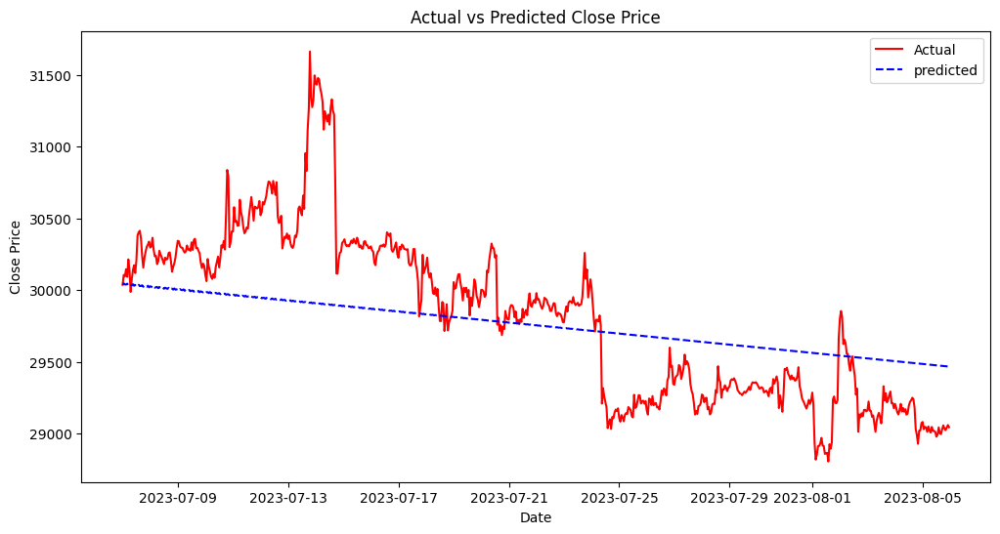

In [ ]:
def actual_predicted_plot(merged_df):
  plt.figure(figsize=(12, 6))
  plt.plot(merged_df['Close'], color='red', label='Actual')
  plt.plot(merged_df['cumulative_sum_close'],ls='--', color='blue', label='predicted')
  plt.xlabel('Date')
  plt.ylabel('Close Price')
  plt.title('Actual vs Predicted Close Price')
  plt.legend()
  plt.show()

actual_predicted_plot(merged_df)

####7 Day Forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


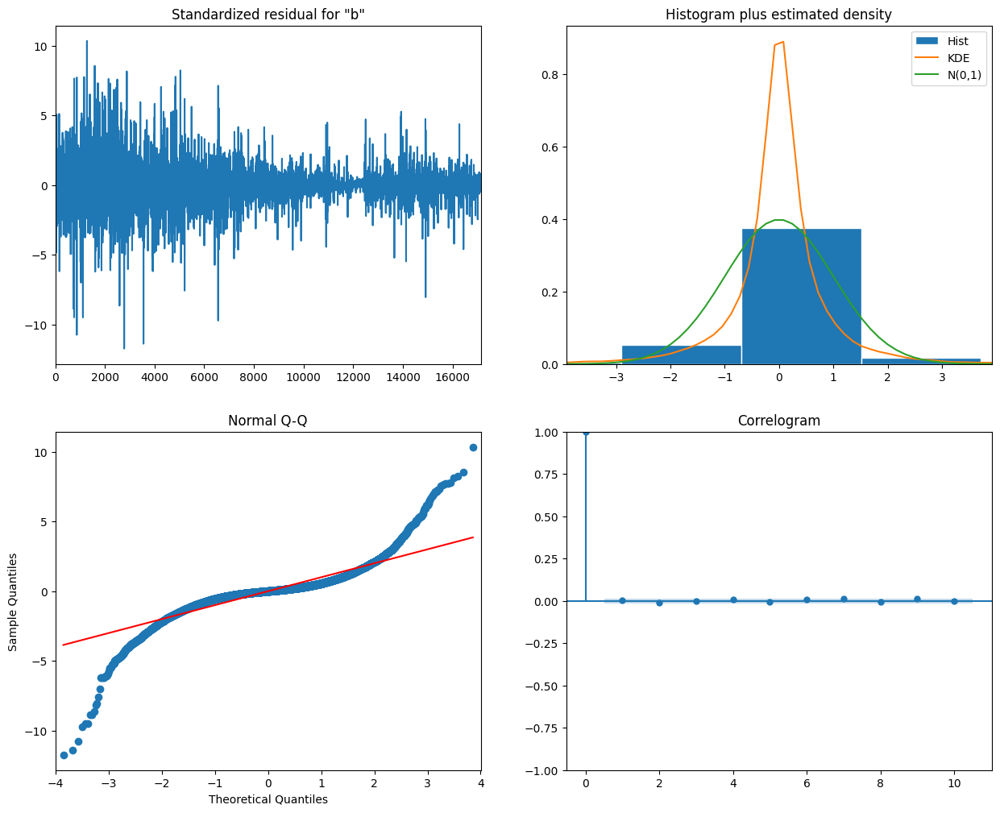

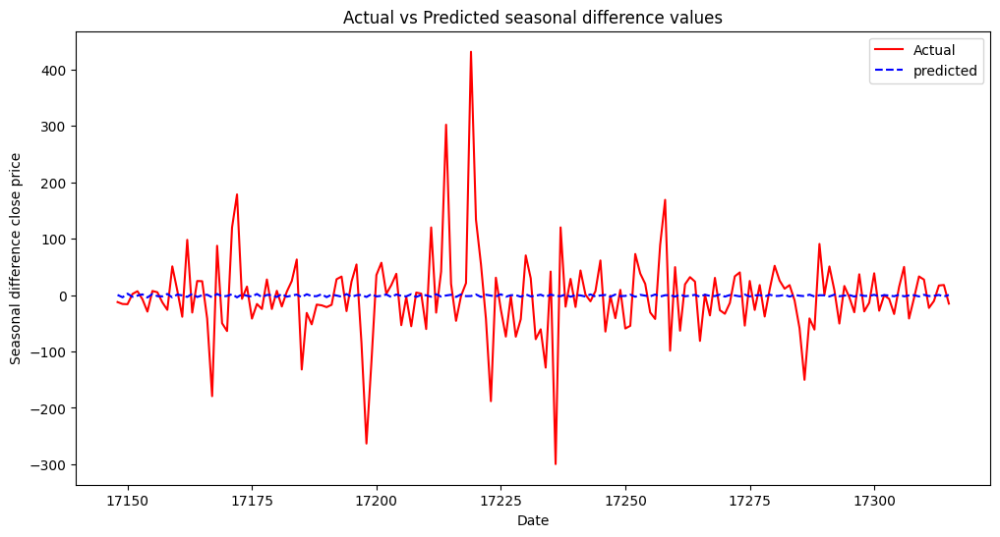

Mean Absolute Error (MAE): 47.517506922285186
Mean Squared Error (MSE): 5557.260592057388
Root Mean Squared Error (RMSE): 74.54703610511545
R2 score: -0.0006525212429930871


In [ ]:
p,d,q = 2,0,3
df_forecast = arima_forecast(df['box_diff_seasonal_1'],7)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
17148,29346.968750,-12.304688,29346.968750,29346.968750
17149,29331.294922,-15.673828,2.590563,29349.559313
17150,29315.218750,-16.076172,-2.982335,29346.576977
17151,29317.332031,2.113281,-0.885844,29345.691133
17152,29324.300781,6.968750,1.461095,29347.152228
17153,29317.068359,-7.232422,-4.163064,29342.989163
17154,29287.849609,-29.218750,2.017620,29345.006783
17155,29295.306641,7.457031,-1.760239,29343.246544
17156,29300.433594,5.126953,-2.166535,29341.080009
17157,29287.623047,-12.810547,2.187747,29343.267756


In [ ]:
r2 = r2_score(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])
print(r2)

-0.04202394968410994


In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 153.3231618417209
Mean Squared Error (MSE): 39501.73157036418
Root Mean Squared Error (RMSE): 198.7504253337944
R2 score: -0.04202394968410994


Actual vs predicted close price

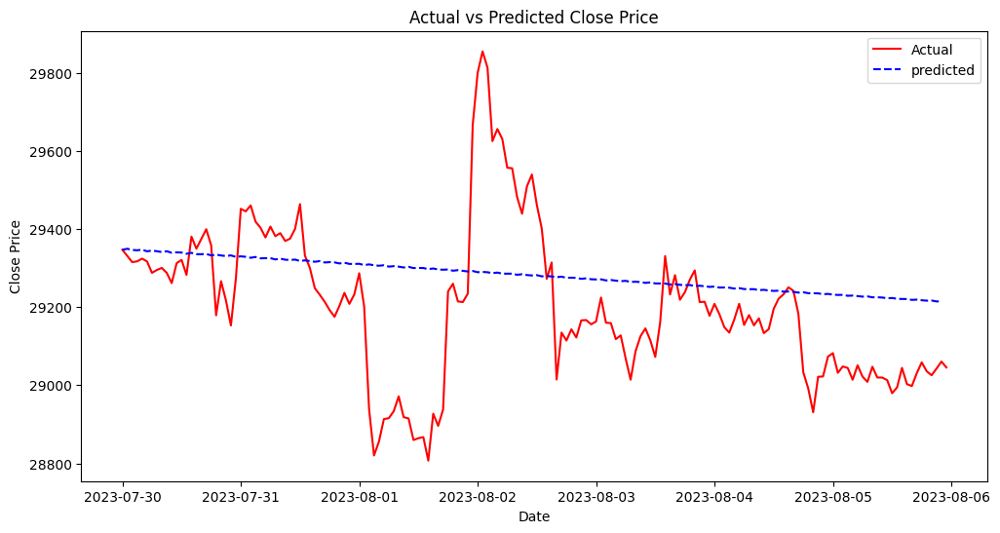

In [ ]:
actual_predicted_plot(merged_df)

####1 Day forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


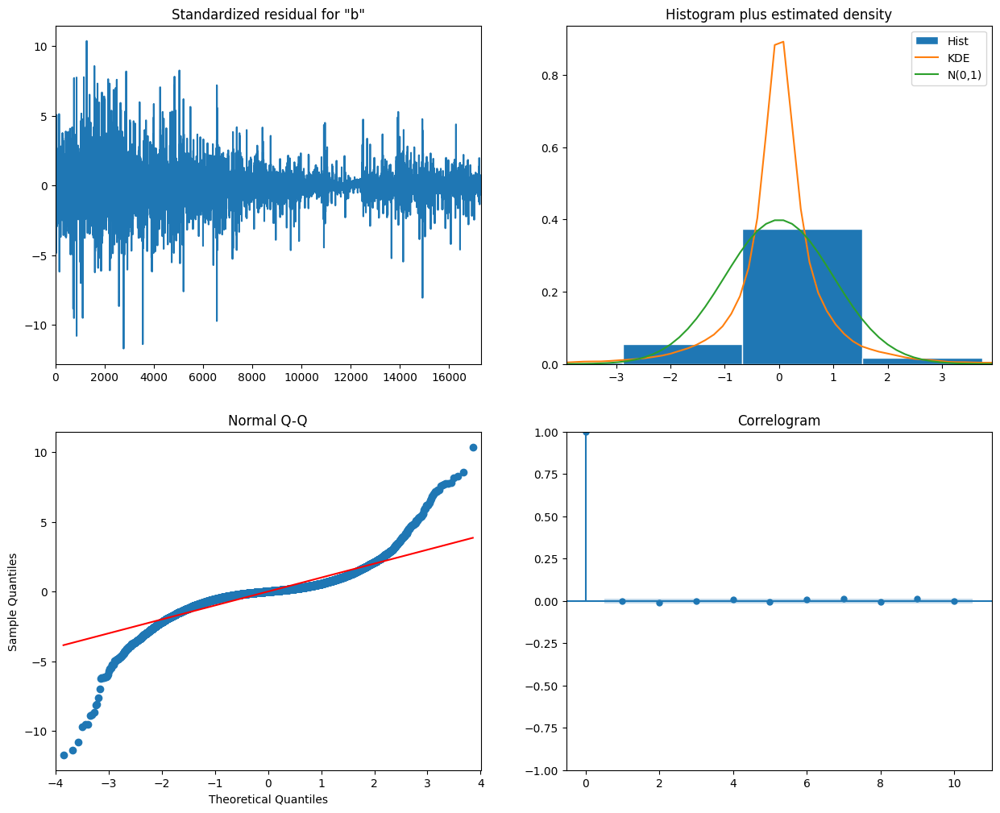

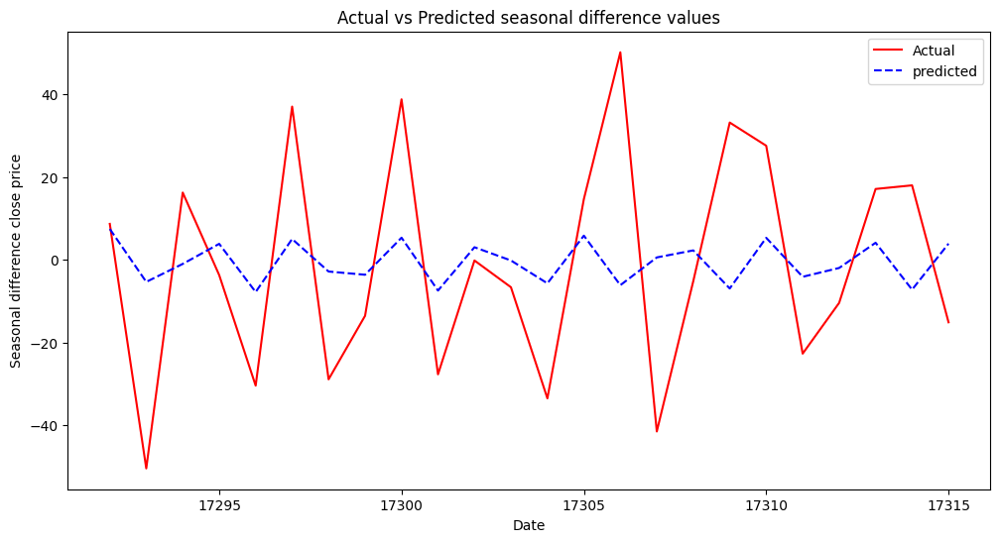

Mean Absolute Error (MAE): 21.41182814631108
Mean Squared Error (MSE): 658.2717659366587
Root Mean Squared Error (RMSE): 25.656807399531584
R2 score: 0.09231772413932648


In [ ]:
df_forecast = arima_forecast(df['box_diff_seasonal_1'],1)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
17292,29082.199219,8.697266,29082.199219,29082.199219
17293,29031.822266,-50.376953,-0.975810,29081.223409
17294,29048.087891,16.265625,3.875270,29085.098679
17295,29044.406250,-3.681641,-7.762732,29077.335947
17296,29014.021484,-30.384766,5.044669,29082.380616
17297,29051.050781,37.029297,-2.816340,29079.564276
17298,29022.191406,-28.859375,-3.596001,29075.968275
17299,29008.681641,-13.509766,5.361990,29081.330265
17300,29047.466797,38.785156,-7.419377,29073.910888
17301,29019.812500,-27.654297,3.054098,29076.964985


In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 47.026279755249895
Mean Squared Error (MSE): 2734.824926110183
Root Mean Squared Error (RMSE): 52.29555359789379
R2 score: -4.944448696977024


Actual vs predicted plot

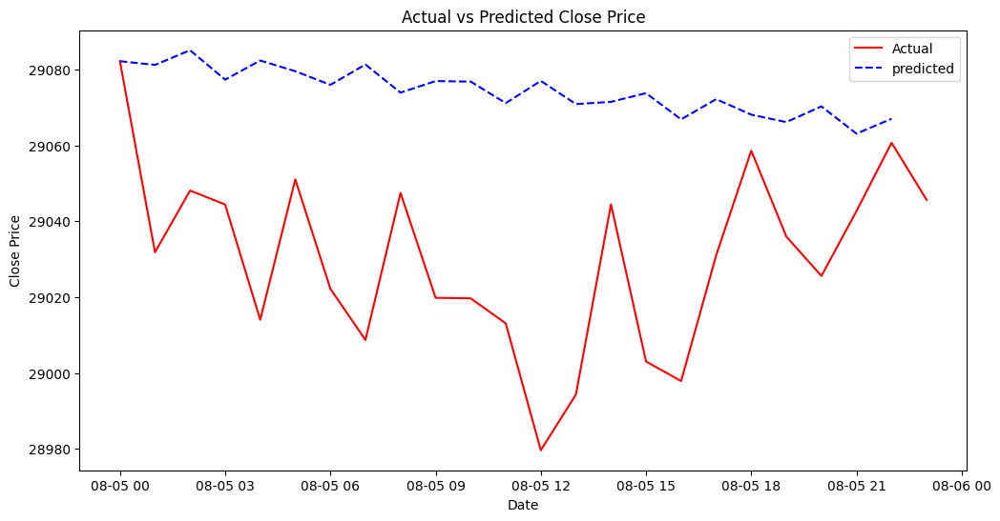

In [ ]:
actual_predicted_plot(merged_df)

###SARIMAX


> Below all the experiments it is concluded that sarima is best when used with exog values as fear and index,sentiment(neutral,fear,greed) Whale Transaction Count (>100k USD it showed better evaluation metrics as compared to other experiments.



> AS compared to arima, sarimax showed better performance where its MAE is 123 for sarimax and mae is 152 for arima for a 7day forecast indicating that sarimax is learn some underlying patterns from the exog variables.





####Fine tune parameter
Best SARIMAX Model Parameters: (1, 1, 0) (0, 0, 0, 7)

In [ ]:


# Define parameter ranges
p_values = range(0, 3)
d_values = range(0, 2)
q_values = range(0, 3)
P_values = range(0, 3)
D_values = range(0, 2)
Q_values = range(0, 3)
s = 7  # Seasonal period

data = df['box_diff_seasonal_1'][:500]
# Split data into training, validation, and test sets
train_size = int(len(data) * 0.6)
valid_size = int(len(data) * 0.2)
train_data = data[:train_size]
valid_data = data[train_size:train_size + valid_size]
test_data = data[train_size + valid_size:]

best_model = None
best_mse = float('inf')

# Grid search over parameter combinations
for p, d, q, P, D, Q in product(p_values, d_values, q_values, P_values, D_values, Q_values):
    try:
        model = sm.tsa.SARIMAX(train_data, order=(p, d, q), seasonal_order=(P, D, Q, s))
        results = model.fit()
        forecast = results.forecast(steps=len(valid_data))
        mse = mean_squared_error(valid_data, forecast)

        if mse < best_mse:
            best_mse = mse
            best_model = model

    except Exception as e:
        continue

# Fit the best model on the entire training set
final_model = best_model.fit()

# Evaluate on the test set
forecast_test = final_model.forecast(steps=len(test_data))
mse_test = mean_squared_error(test_data, forecast_test)

print("Best SARIMA Model Parameters:", best_model.order, best_model.seasonal_order)
print("Validation MSE:", best_mse)
print("Test MSE:", mse_test)




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/

Best SARIMA Model Parameters: (1, 1, 0) (0, 0, 0, 7)
Validation MSE: 63056.78372836663
Test MSE: 72554.56725208698


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


####value experiment

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


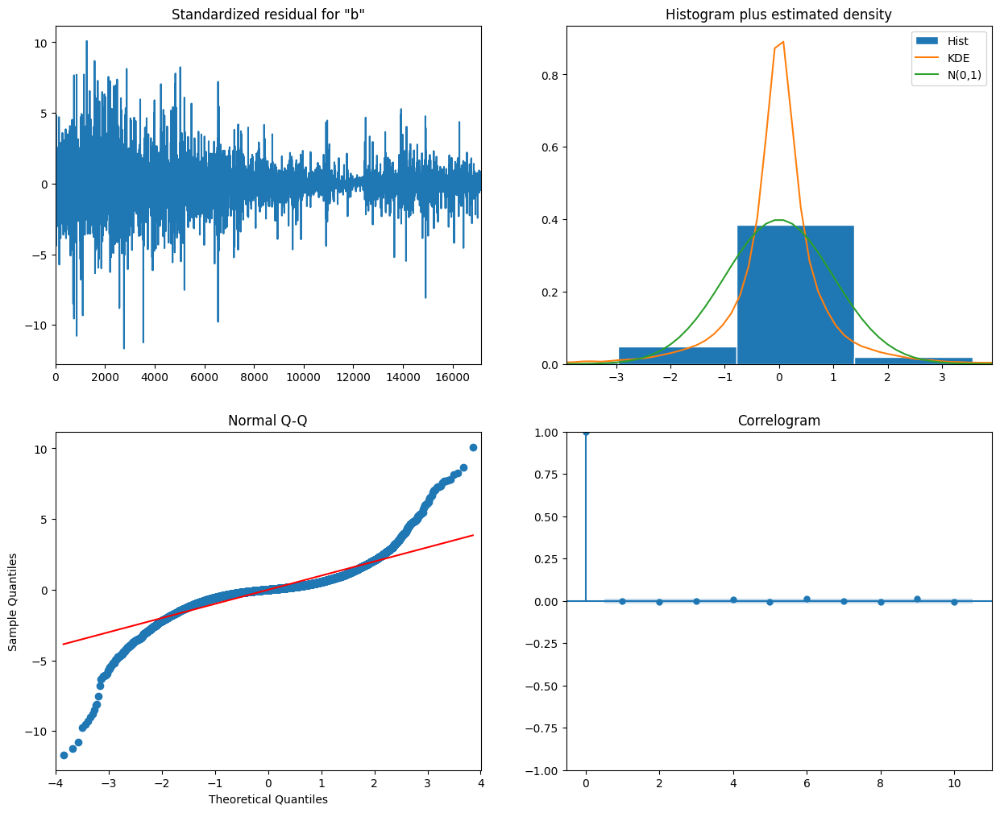

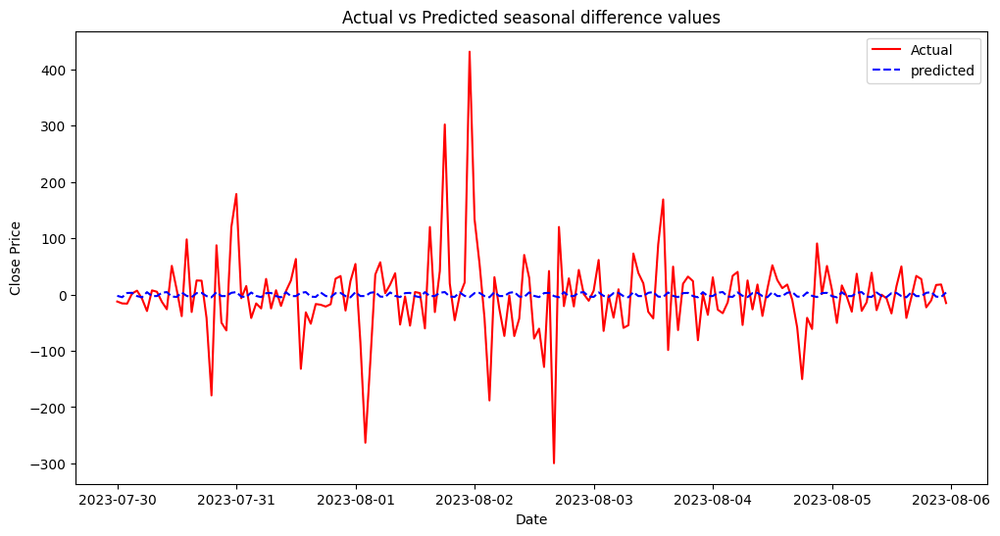

Mean Absolute Error (MAE): 47.26103730440036
Mean Squared Error (MSE): 5521.438537303098
Root Mean Squared Error (RMSE): 74.30638288399656
R2 score: 0.0057976764420345495


In [ ]:


# Load your data with 'Close' and 'Fear_Greed_Index' columns
# Define SARIMAX model order parameters
p, d, q = 1, 0, 1  # Non-seasonal order
P, D, Q, s = 2, 1, 2, 7  # Seasonal order with daily seasonality


def sarimax_model(df,days,exog):

  ts =df['box_diff_seasonal_1']
  test_data = ts.iloc[-24*days:] #test data
  # The remaining data is the training data
  train_data = ts.iloc[:-24*days]

  test_data = pd.DataFrame(test_data) #convert series to df
  test_data2= test_data.copy()
#print(df['value'][:-24*days])
  #print(test_data)
  exog = exog
  model = sm.tsa.SARIMAX(train_data, exog=exog[:-24*days], order=(p, d, q), seasonal_order=(P, D, Q, s))
  model_fit = model.fit()
  model_fit.plot_diagnostics(figsize=(15,12))

  forecast_steps=len(test_data)
  forecast = model_fit.get_forecast(steps=forecast_steps,exog=exog[-24*days:])
  #print(forecast.info())
  #print(forecast)
  #forecast = pd.DataFrame(forecast)
  #df_forecast = pd.DataFrame(forecast)
  df_forecast = pd.DataFrame(forecast.predicted_mean, columns=['Forecasted'], index=test_data.index)
  forecast = forecast.predicted_mean
  forecast = pd.DataFrame(forecast)
  forecast.reset_index(inplace=True)

  df_forecast.reset_index(inplace=True)
  df_forecast['Forecasted Close']=forecast.predicted_mean
  df_forecast.set_index('Date',inplace=True)
  df_forecast.drop('Forecasted',axis=1,inplace=True)



  plt.figure(figsize=(12, 6))
  plt.plot( test_data, color='red', label='Actual')
  plt.plot( df_forecast,ls='--', color='blue', label='predicted')
  #plt.plot(pd.date_range(start=test_data.index[0], periods=forecast_steps+1, inclusive='right'), forecast, label='Forecasted Prices', color='blue')
  plt.xlabel('Date')
  plt.ylabel('Close Price')
  plt.title('Actual vs Predicted seasonal difference values')
  plt.legend()
  plt.show()

  # Calculate Mean Absolute Error (MAE)
  mae = mean_absolute_error(test_data2, forecast.predicted_mean)

  # Calculate Mean Squared Error (MSE)
  mse = mean_squared_error(test_data2, forecast.predicted_mean)

  # Calculate Root Mean Squared Error (RMSE)
  rmse = np.sqrt(mse)
  #R2score
  r2 = r2_score(test_data2, forecast.predicted_mean)

  # Print the metrics
  print(f"Mean Absolute Error (MAE): {mae}")
  print(f"Mean Squared Error (MSE): {mse}")
  print(f"Root Mean Squared Error (RMSE): {rmse}")
  print(f"R2 score: {r2}")
  return df_forecast

df =df_btc
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
days=7
exog = df['value']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,29346.968750,-12.304688,29346.968750,29346.968750
2023-07-30 01:00:00,29331.294922,-15.673828,2.875753,29349.844503
2023-07-30 02:00:00,29315.218750,-16.076172,3.156903,29353.001406
2023-07-30 03:00:00,29317.332031,2.113281,-2.661330,29350.340076
2023-07-30 04:00:00,29324.300781,6.968750,-4.753772,29345.586304
2023-07-30 05:00:00,29317.068359,-7.232422,4.336122,29349.922426
2023-07-30 06:00:00,29287.849609,-29.218750,-2.647619,29347.274807
2023-07-30 07:00:00,29295.306641,7.457031,-2.586324,29344.688483
2023-07-30 08:00:00,29300.433594,5.126953,3.173999,29347.862482


In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 178.28267624693385
Mean Squared Error (MSE): 48324.89933068038
Root Mean Squared Error (RMSE): 219.82925039830434
R2 score: -0.27477202813107793


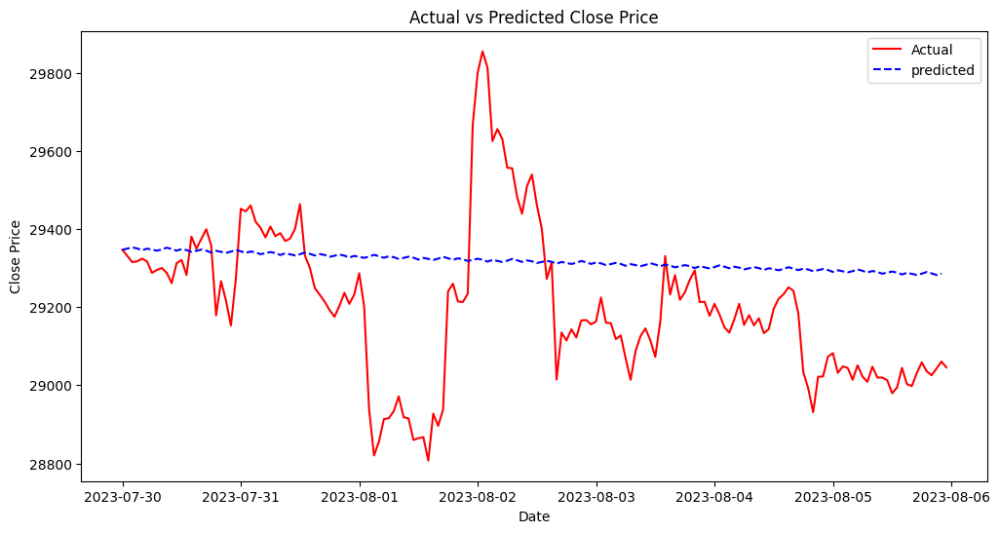

In [ ]:
actual_predicted_plot(merged_df)

####value classification encoded

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


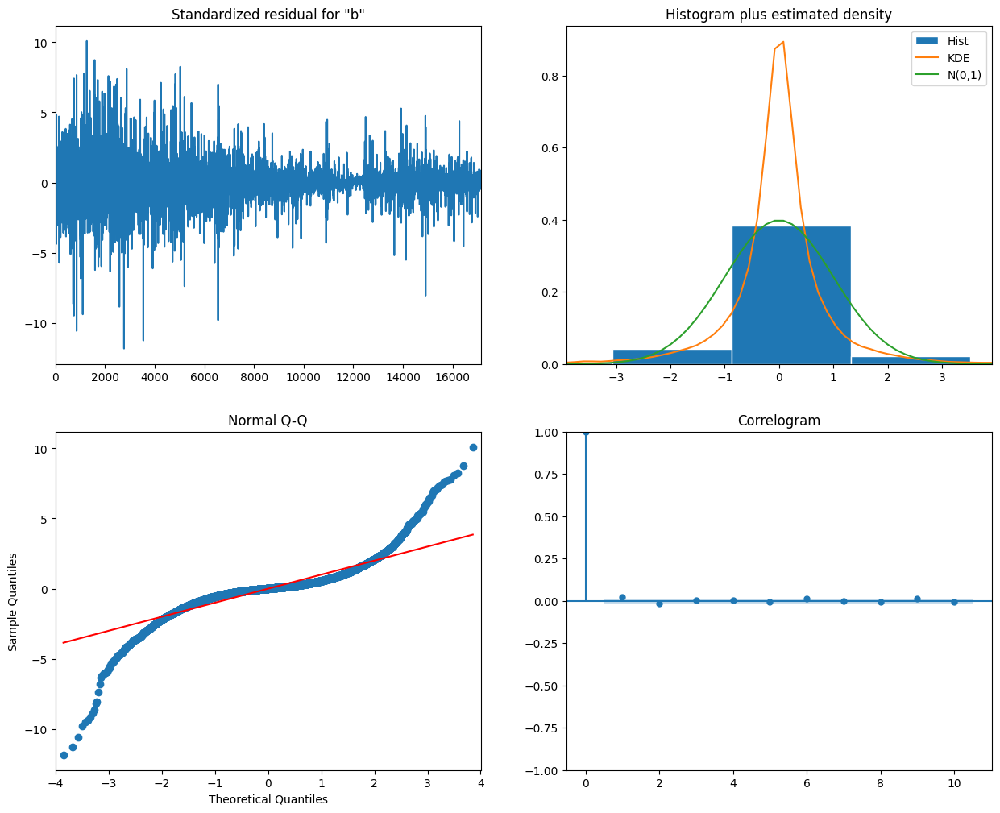

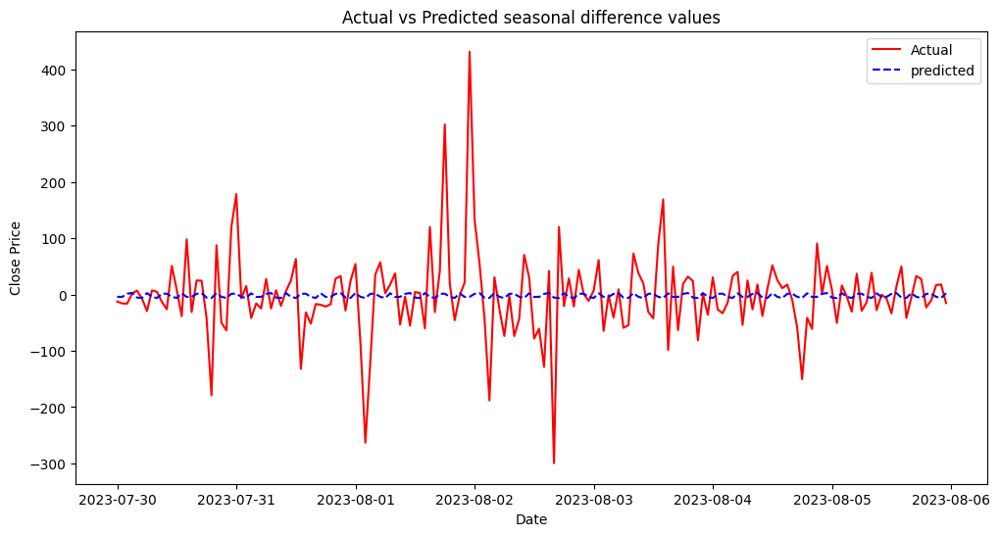

Mean Absolute Error (MAE): 47.159017637187084
Mean Squared Error (MSE): 5502.0051194405605
Root Mean Squared Error (RMSE): 74.1755021515902


In [ ]:

days=7
exog = df['value_classification_encoded']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,29346.968750,-12.304688,29346.968750,29346.968750
2023-07-30 01:00:00,29331.294922,-15.673828,1.589863,29348.558613
2023-07-30 02:00:00,29315.218750,-16.076172,2.989051,29351.547664
2023-07-30 03:00:00,29317.332031,2.113281,-5.345413,29346.202250
2023-07-30 04:00:00,29324.300781,6.968750,-5.905828,29340.296422
2023-07-30 05:00:00,29317.068359,-7.232422,2.737953,29343.034375
2023-07-30 06:00:00,29287.849609,-29.218750,-3.884815,29339.149560
2023-07-30 07:00:00,29295.306641,7.457031,-6.133514,29333.016046
2023-07-30 08:00:00,29300.433594,5.126953,1.417257,29334.433303


In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 119.01579722288139
Mean Squared Error (MSE): 32328.79868000211
Root Mean Squared Error (RMSE): 179.80210977628184


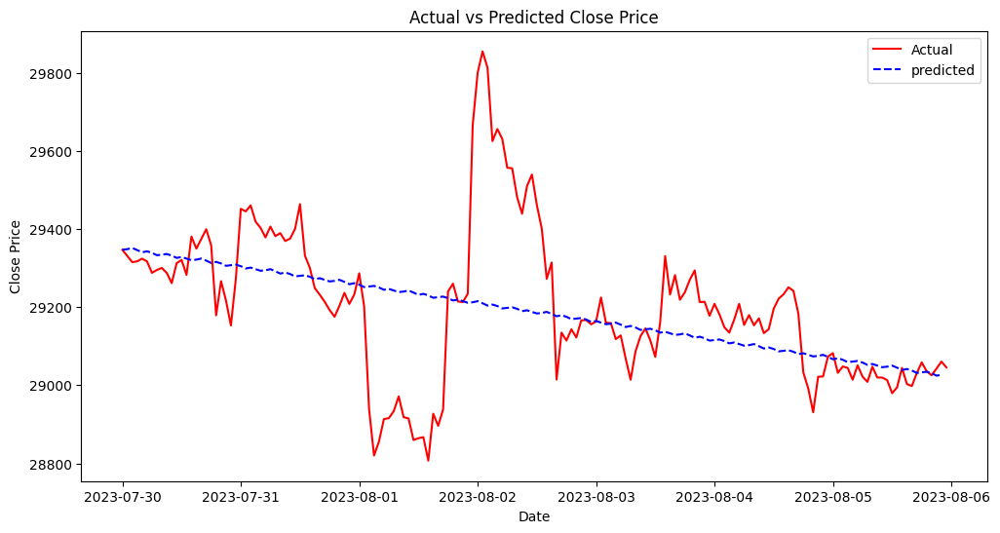

In [ ]:
actual_predicted_plot(merged_df)

####Whale transaction experiment

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


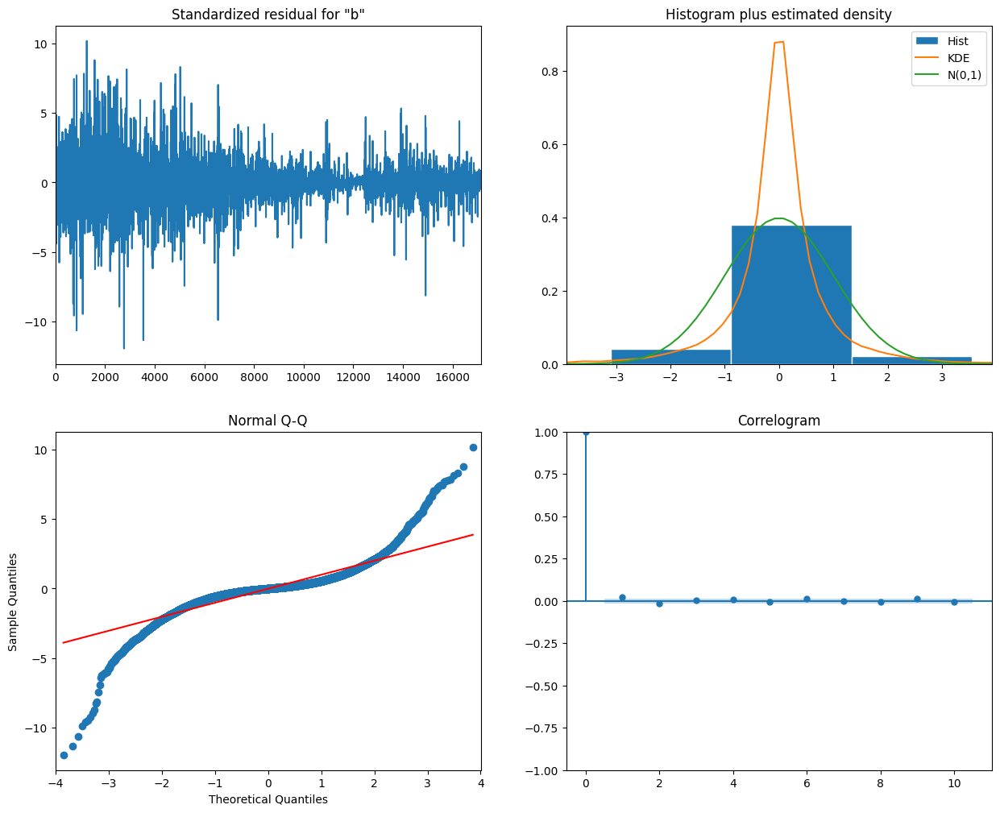

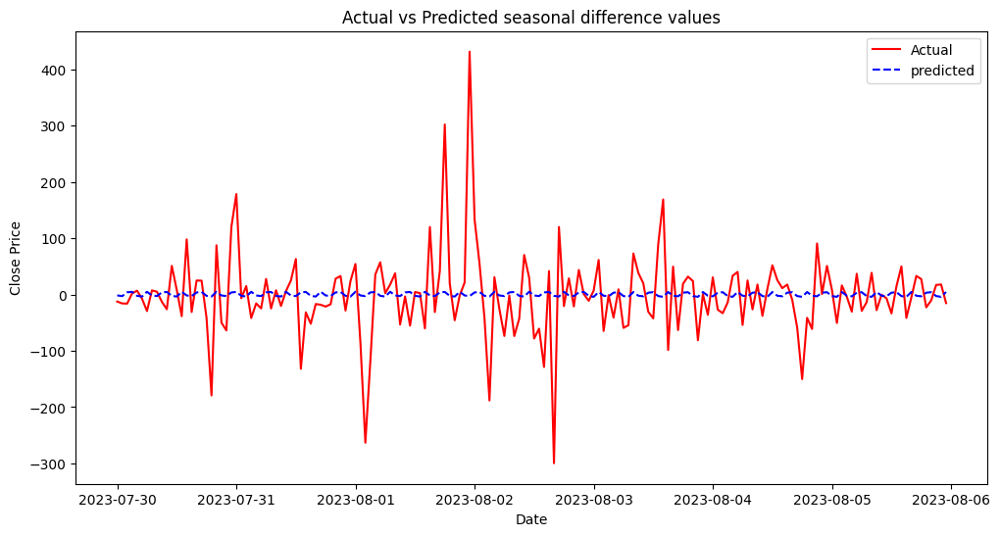

Mean Absolute Error (MAE): 47.31999270546687
Mean Squared Error (MSE): 5518.281919783555
Root Mean Squared Error (RMSE): 74.28513929302115


In [ ]:
days=7
exog = df['Whale Transaction Count (>100k USD']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,29346.968750,-12.304688,29346.968750,29346.968750
2023-07-30 01:00:00,29331.294922,-15.673828,4.108389,29351.077139
2023-07-30 02:00:00,29315.218750,-16.076172,4.845680,29355.922819
2023-07-30 03:00:00,29317.332031,2.113281,-2.192336,29353.730483
2023-07-30 04:00:00,29324.300781,6.968750,-3.489350,29350.241133
2023-07-30 05:00:00,29317.068359,-7.232422,4.994617,29355.235750
2023-07-30 06:00:00,29287.849609,-29.218750,-1.550610,29353.685141
2023-07-30 07:00:00,29295.306641,7.457031,-2.622183,29351.062958
2023-07-30 08:00:00,29300.433594,5.126953,3.838932,29354.901890


In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 230.76196534831462
Mean Squared Error (MSE): 74928.02825986253
Root Mean Squared Error (RMSE): 273.7298453948026


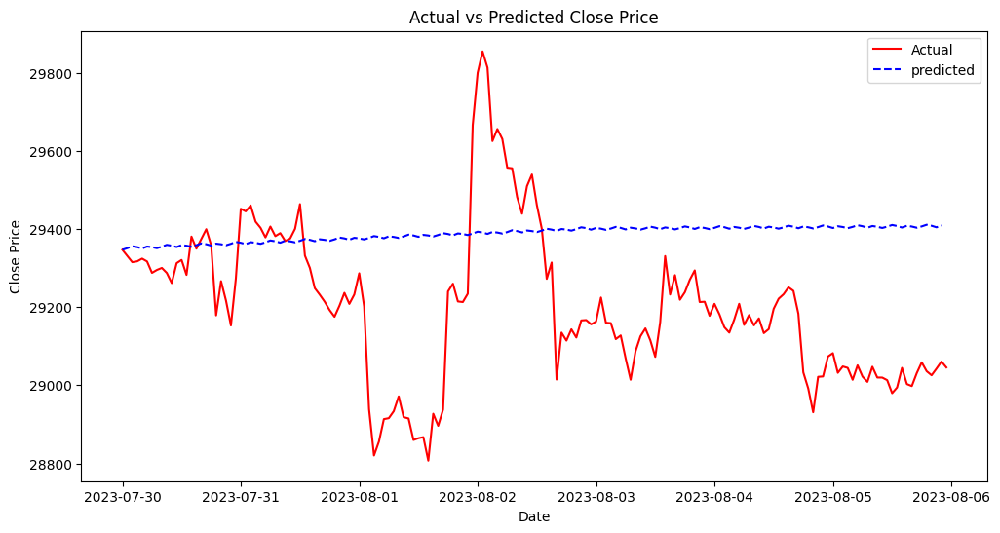

In [ ]:
actual_predicted_plot(merged_df)

####two exog columns experiment

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

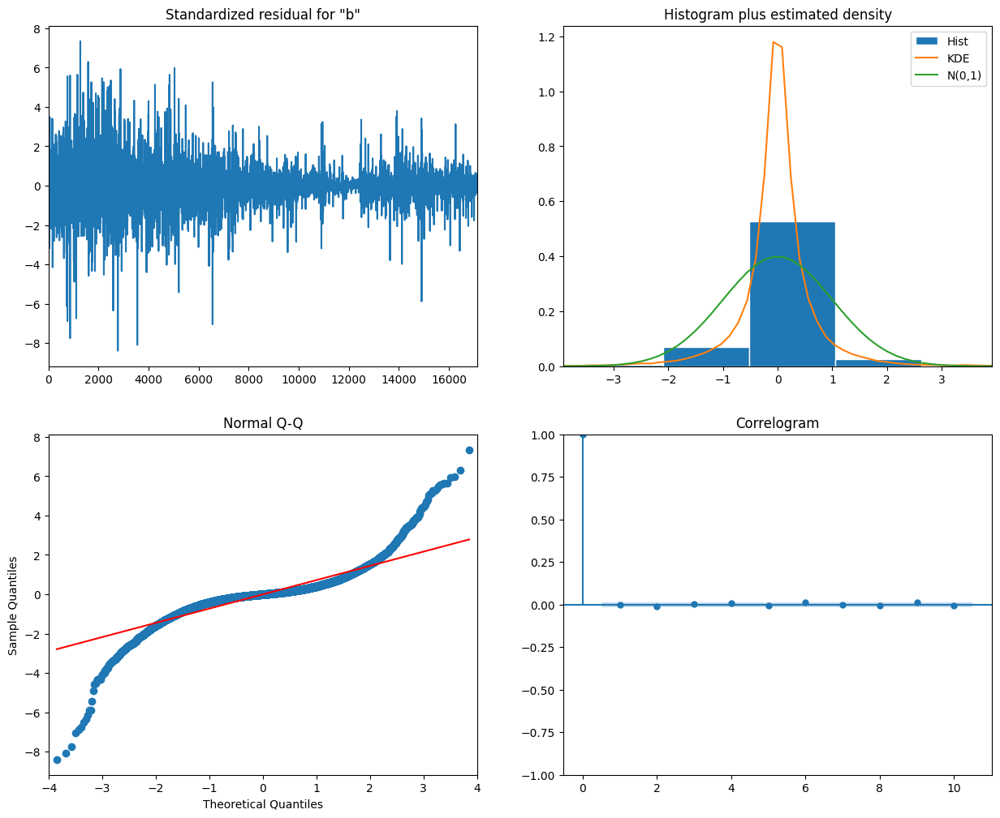

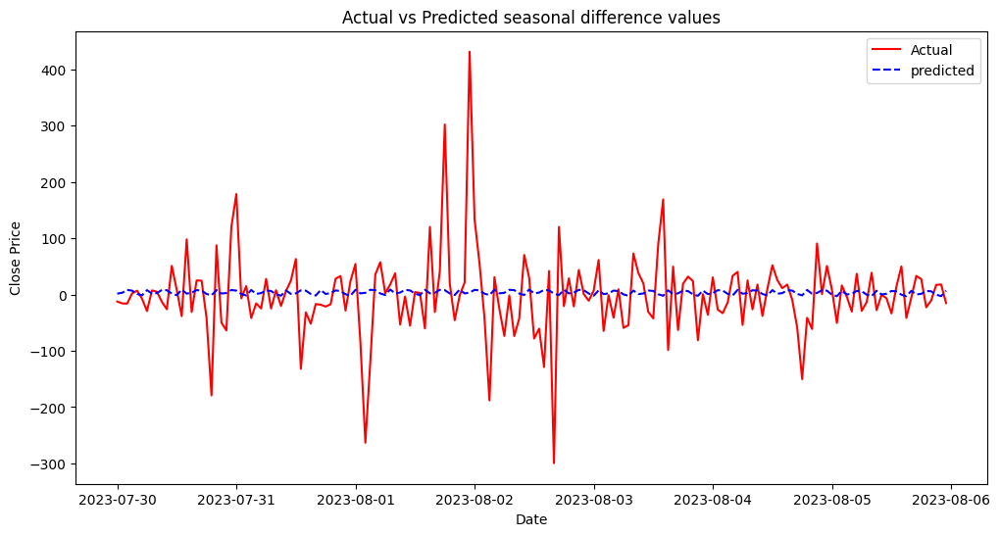

Mean Absolute Error (MAE): 47.67261356849558
Mean Squared Error (MSE): 5546.623414358545
Root Mean Squared Error (RMSE): 74.47565652183636


In [ ]:

exog = df[['Whale Transaction Count (>100k USD','value']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)


In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

In [ ]:
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,29346.968750,-12.304688,29346.968750,29346.968750
2023-07-30 01:00:00,29331.294922,-15.673828,8.256903,29355.225653
2023-07-30 02:00:00,29315.218750,-16.076172,7.042985,29362.268638
2023-07-30 03:00:00,29317.332031,2.113281,1.106165,29363.374803
2023-07-30 04:00:00,29324.300781,6.968750,-1.266925,29362.107878
2023-07-30 05:00:00,29317.068359,-7.232422,7.898045,29370.005924
2023-07-30 06:00:00,29287.849609,-29.218750,1.934132,29371.940056
2023-07-30 07:00:00,29295.306641,7.457031,2.700041,29374.640097
2023-07-30 08:00:00,29300.433594,5.126953,8.246292,29382.886389


In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 484.412614507987
Mean Squared Error (MSE): 328598.682208493
Root Mean Squared Error (RMSE): 573.2352764864468


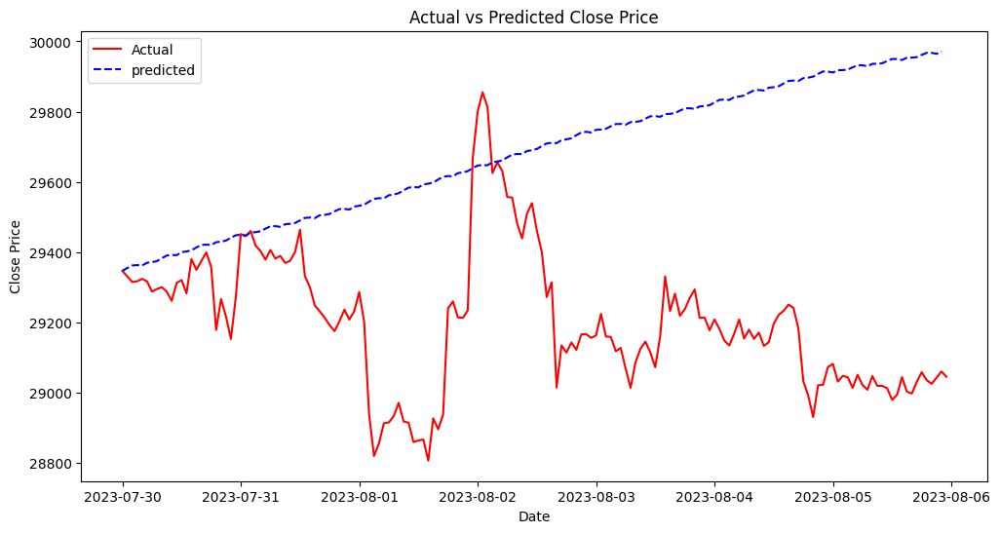

In [ ]:
actual_predicted_plot(merged_df)

####Three exog columns experiment

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

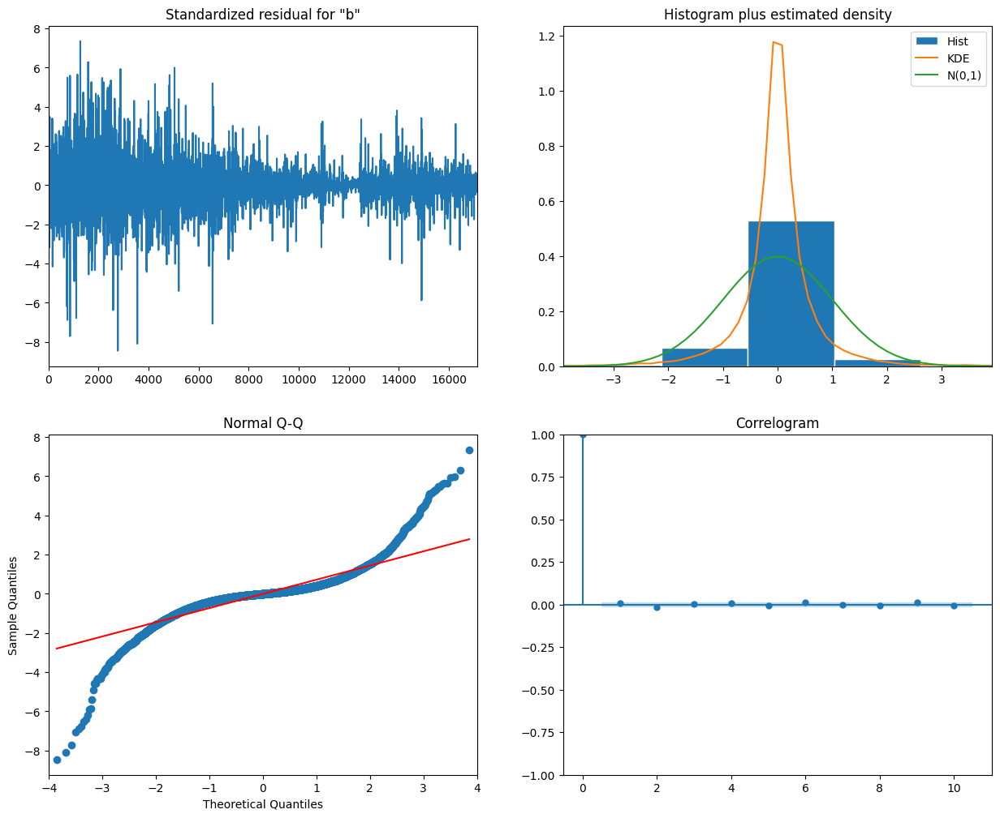

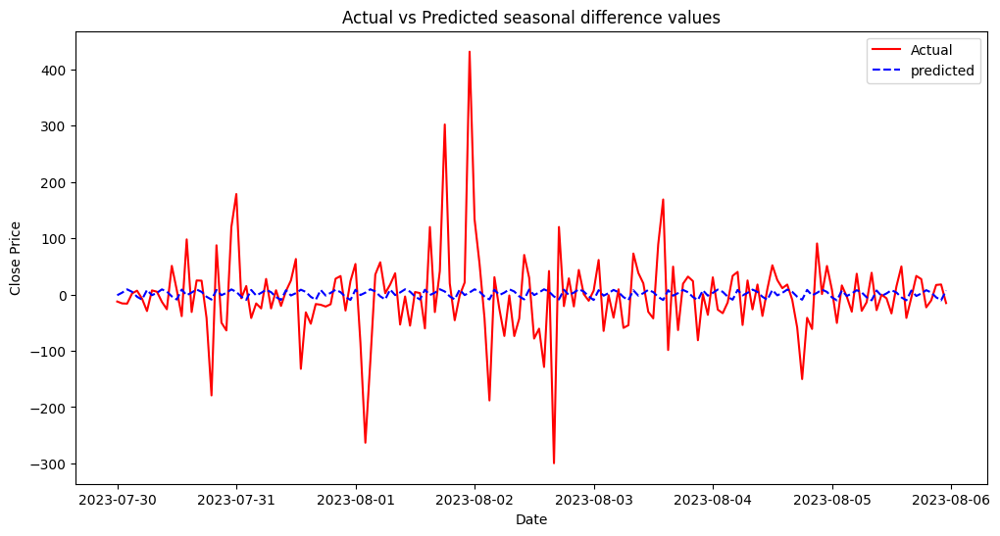

Mean Absolute Error (MAE): 47.76078033835277
Mean Squared Error (MSE): 5522.982532531617
Root Mean Squared Error (RMSE): 74.31677154271179
R2 score: 0.005519661277438415


In [ ]:

exog = df[['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 309.81255216341947
Mean Squared Error (MSE): 134758.21780745586
Root Mean Squared Error (RMSE): 367.09429007743483
R2 score: -2.55481354335025


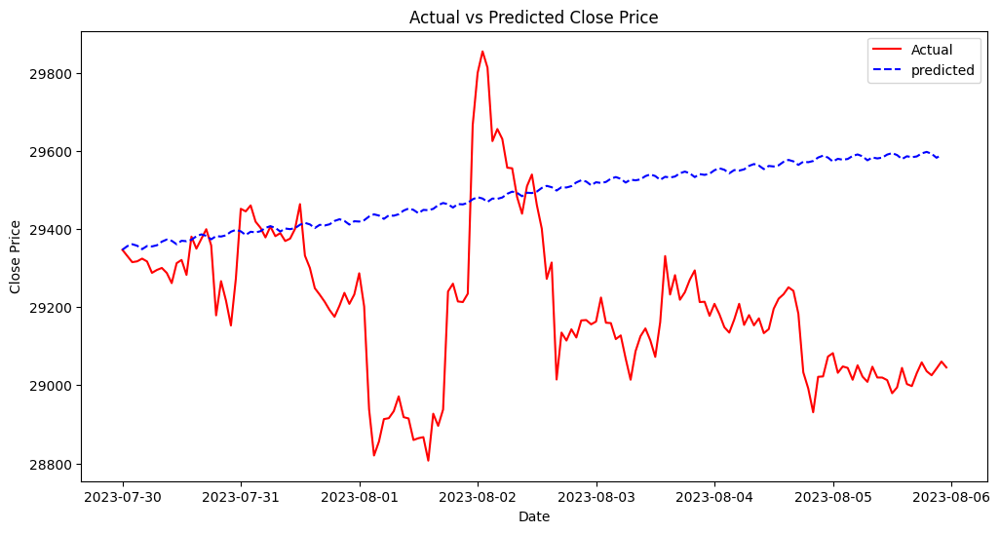

In [ ]:
actual_predicted_plot(merged_df)

####Four exog columns

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

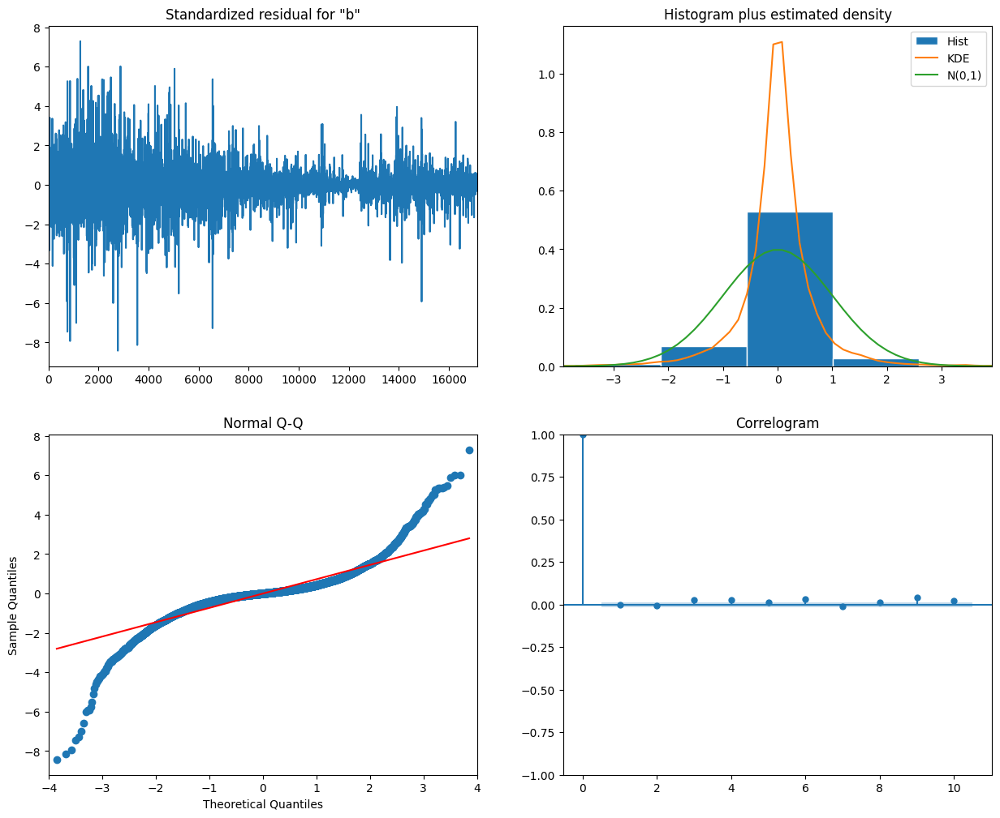

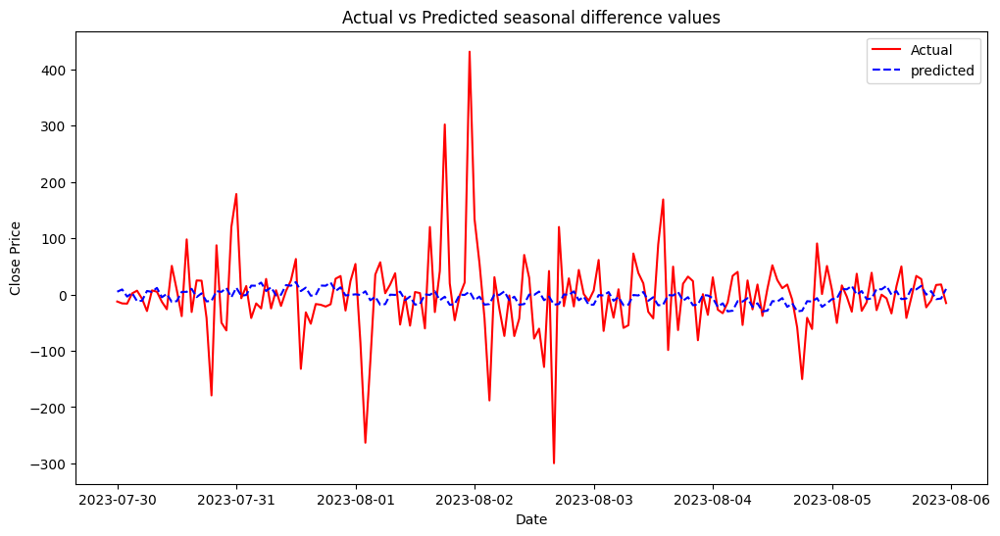

Mean Absolute Error (MAE): 49.02579320241674
Mean Squared Error (MSE): 5574.841070522372
Root Mean Squared Error (RMSE): 74.6648583372551


In [ ]:

exog = df[['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value','value_classification_encoded']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 226.1509630778279
Mean Squared Error (MSE): 80535.30130064148
Root Mean Squared Error (RMSE): 283.7874227315958


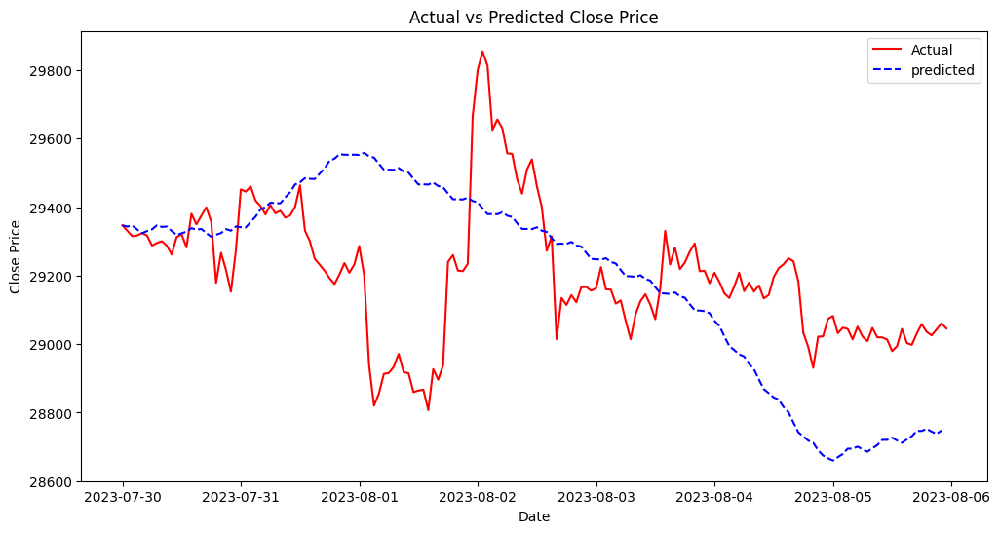

In [ ]:
actual_predicted_plot(merged_df)

###LSTM

####7 Day prediction

Epoch 1/15
429/429 [==============================] - 16s 19ms/step - loss: 0.0515 - val_loss: 0.0473
Epoch 2/15
429/429 [==============================] - 11s 27ms/step - loss: 0.0487 - val_loss: 0.0429
Epoch 3/15
429/429 [==============================] - 9s 20ms/step - loss: 0.0483 - val_loss: 0.0268
Epoch 4/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0478 - val_loss: 0.0449
Epoch 5/15
429/429 [==============================] - 11s 26ms/step - loss: 0.0475 - val_loss: 0.0270
Epoch 6/15
429/429 [==============================] - 7s 16ms/step - loss: 0.0462 - val_loss: 0.0504
Epoch 7/15
429/429 [==============================] - 10s 23ms/step - loss: 0.0458 - val_loss: 0.0274
Epoch 8/15
429/429 [==============================] - 10s 24ms/step - loss: 0.0454 - val_loss: 0.0363
Epoch 9/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0455 - val_loss: 0.0254
Epoch 10/15
429/429 [==============================] - 11s 27ms/step - loss: 0.0453 - 

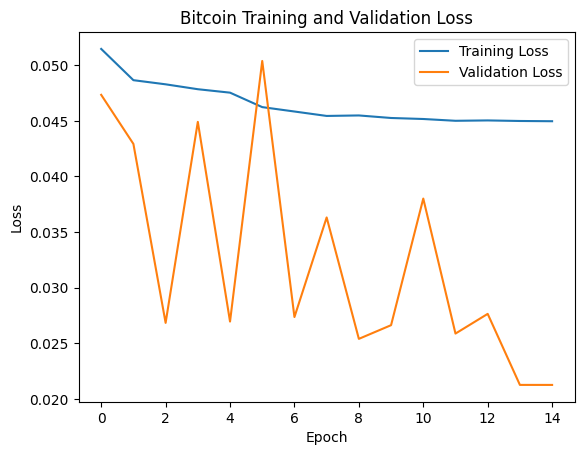

536/536 [==============================] - 4s 6ms/step
Bitcoin Training Set:
RMSE: 10575.05
MSE: 111831650.86
MAE: 9325.04
R2 score: 0.33


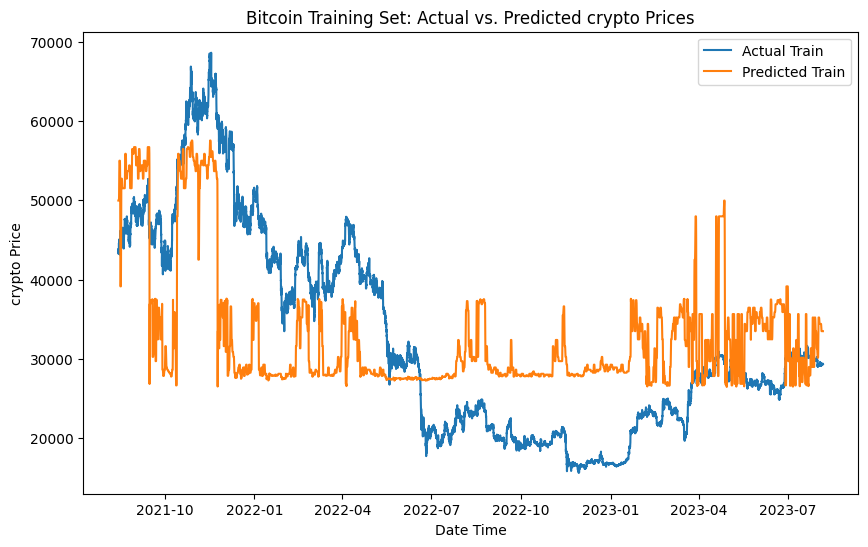

5/5 [==============================] - 0s 7ms/step
Bitcoin Test Set:
RMSE: 4311.12
MSE: 18585784.98
MAE: 4125.76
test R2 score: -472.06


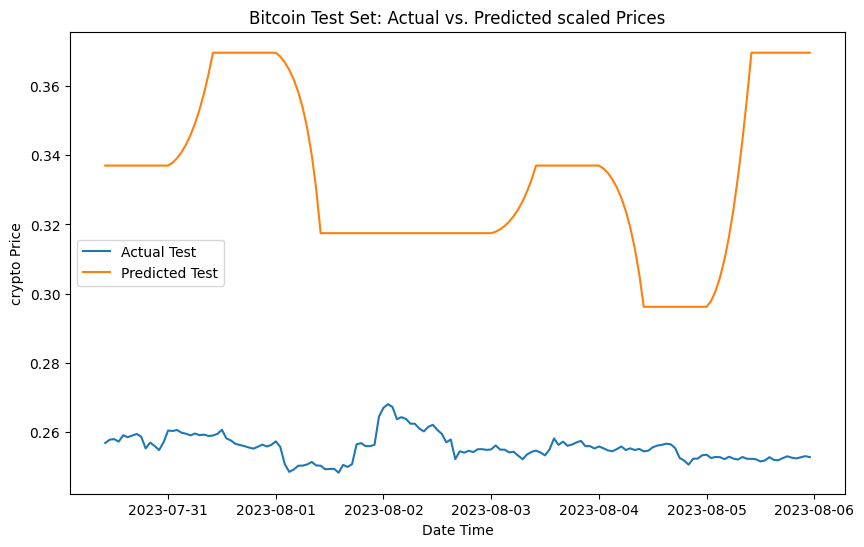

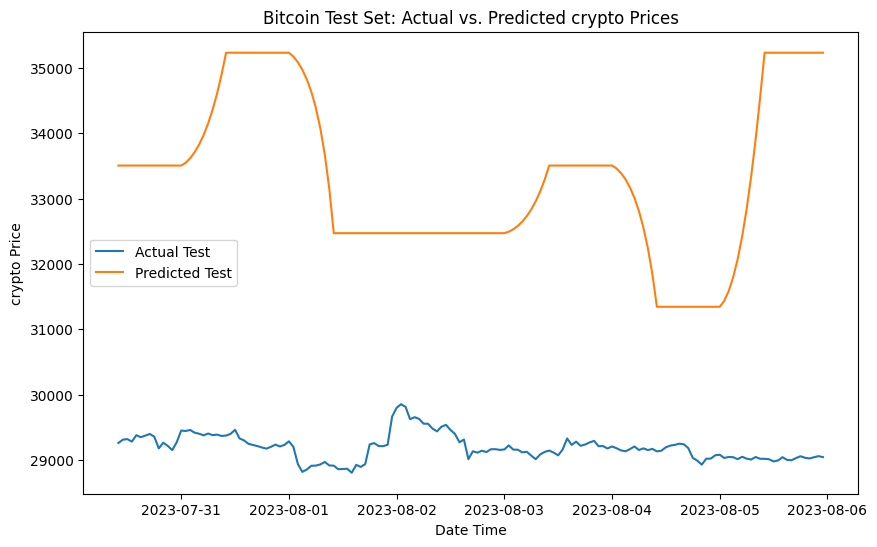

In [ ]:
def apply_lstm_sequences(data,company_name, features, target, test_size=0.2, random_state=False, num_epochs=50, batch_size=32, sequence_length=10):

    X = data[features].values
    y = data[target].values

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y.reshape(-1, 1))

    # Split data into training and testing sets
    #train_size = int((1 - test_size) * len(X_scaled))
    train_size = len(X_scaled)-test_size
    X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
    y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

    # Create sequences
    X_train_seq, y_train_seq = [], []
    X_test_seq, y_test_seq = [], []

    for i in range(len(X_train) - sequence_length):
        X_train_seq.append(X_train[i:i + sequence_length])
        y_train_seq.append(y_train[i + sequence_length])

    for i in range(len(X_test) - sequence_length):
        X_test_seq.append(X_test[i:i + sequence_length])
        y_test_seq.append(y_test[i + sequence_length])

    X_train_seq, y_train_seq = np.array(X_train_seq), np.array(y_train_seq)
    X_test_seq, y_test_seq = np.array(X_test_seq), np.array(y_test_seq)

    # Build and train LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    history = model.fit(X_train_seq, y_train_seq, epochs=num_epochs, batch_size=batch_size, validation_split=0.2, verbose=1)
    model.summary()
    # Plot validation loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{company_name} Training and Validation Loss')
    plt.legend()
    plt.show()

    # Evaluate the model on training data
    y_train_pred_scaled = model.predict(X_train_seq)
    y_train_pred = scaler_y.inverse_transform(y_train_pred_scaled)
    y_train_orig = scaler_y.inverse_transform(y_train_seq)

    # Calculate RMSE, MSE, and MAE for training set
    train_rmse = np.sqrt(mean_squared_error(y_train_orig, y_train_pred))
    train_mse = mean_squared_error(y_train_orig, y_train_pred)
    train_mae = mean_absolute_error(y_train_orig, y_train_pred)
    #R2score
    train_r2 = r2_score(y_train_orig, y_train_pred)

    print(f"{company_name} Training Set:")
    print(f"RMSE: {train_rmse:.2f}")
    print(f"MSE: {train_mse:.2f}")
    print(f"MAE: {train_mae:.2f}")
    print(f"R2 score: {train_r2:.2f}")

    # Plot actual vs. predicted values for training set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_train_orig):],y_train_orig, label='Actual Train')
    plt.plot(data.index[-len(y_train_orig):],y_train_pred, label='Predicted Train')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Training Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

    # Evaluate the model on test data
    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_test_orig = scaler_y.inverse_transform(y_test_seq)

    # Calculate RMSE, MSE, and MAE for test set
    rmse = np.sqrt(mean_squared_error(y_test_orig, y_pred))
    mse = mean_squared_error(y_test_orig, y_pred)
    mae = mean_absolute_error(y_test_orig, y_pred)
    test_r2 = r2_score(y_test_orig, y_pred)

    print(f"{company_name} Test Set:")
    print(f"RMSE: {rmse:.2f}")
    print(f"MSE: {mse:.2f}")
    print(f"MAE: {mae:.2f}")
    print(f"test R2 score: {test_r2:.2f}")
    #scaled results
    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_seq, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred_scaled, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted scaled Prices')
    plt.legend()
    plt.show()

    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_orig, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()


# Sample data and parameters
# Replace with your actual data and parameters
data = df_btc
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Bitcoin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


#### Whale trasaction and fear and greed

Epoch 1/15
429/429 [==============================] - 19s 30ms/step - loss: 0.0112 - val_loss: 0.0085
Epoch 2/15
429/429 [==============================] - 8s 18ms/step - loss: 0.0059 - val_loss: 0.0052
Epoch 3/15
429/429 [==============================] - 11s 27ms/step - loss: 0.0042 - val_loss: 0.0078
Epoch 4/15
429/429 [==============================] - 9s 22ms/step - loss: 0.0027 - val_loss: 0.0119
Epoch 5/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0022 - val_loss: 0.0183
Epoch 6/15
429/429 [==============================] - 12s 29ms/step - loss: 0.0017 - val_loss: 0.0104
Epoch 7/15
429/429 [==============================] - 7s 17ms/step - loss: 0.0016 - val_loss: 0.0070
Epoch 8/15
429/429 [==============================] - 11s 25ms/step - loss: 0.0013 - val_loss: 0.0073
Epoch 9/15
429/429 [==============================] - 10s 23ms/step - loss: 0.0012 - val_loss: 0.0092
Epoch 10/15
429/429 [==============================] - 8s 20ms/step - loss: 0.0012 - v

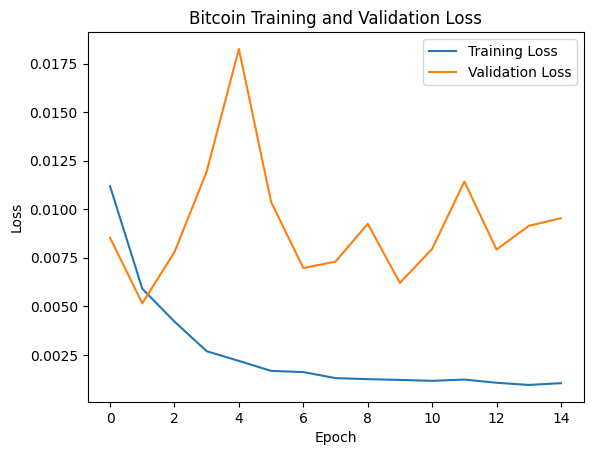

536/536 [==============================] - 5s 7ms/step
Bitcoin Training Set:
RMSE: 2661.90
MSE: 7085738.19
MAE: 1800.71
R2 score: 0.96


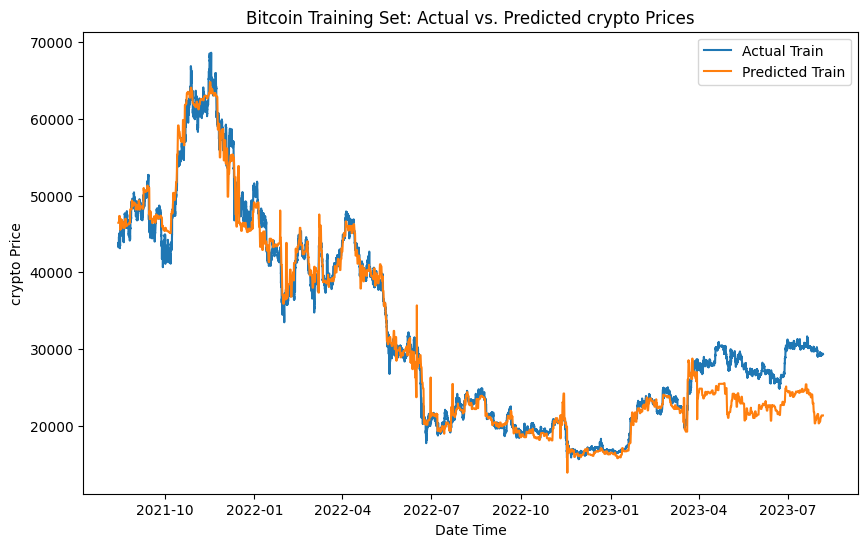

5/5 [==============================] - 0s 8ms/step
Bitcoin Test Set:
RMSE: 8562.77
MSE: 73320987.90
MAE: 8525.03
test R2 score: -1865.22


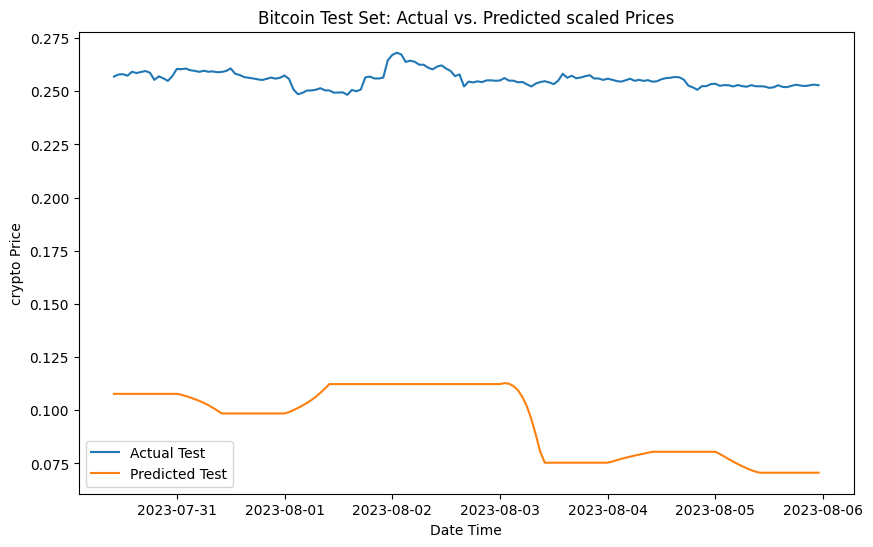

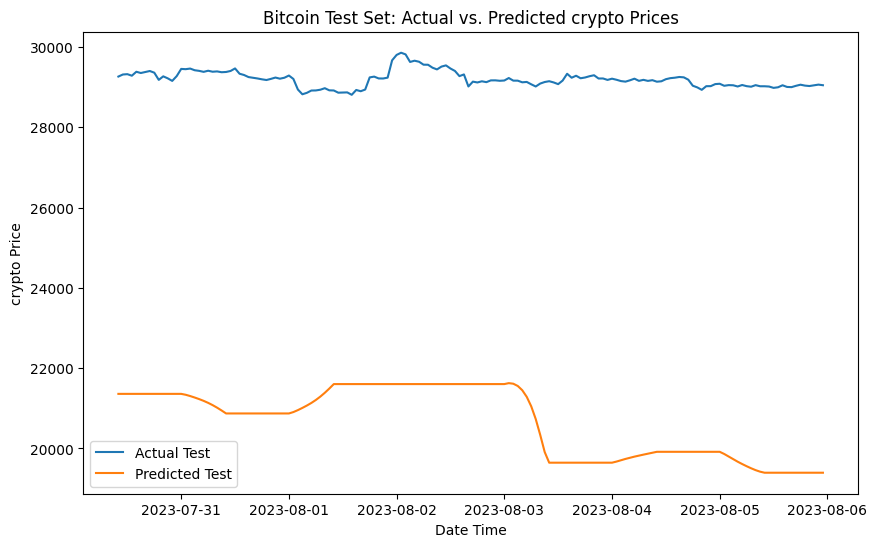

In [ ]:

data = df_btc
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Bitcoin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

###Bi-LSTM

####7 Day Prediction using greed

Epoch 1/15
429/429 [==============================] - 31s 43ms/step - loss: 0.0514 - val_loss: 0.0746
Epoch 2/15
429/429 [==============================] - 18s 43ms/step - loss: 0.0485 - val_loss: 0.0472
Epoch 3/15
429/429 [==============================] - 14s 34ms/step - loss: 0.0483 - val_loss: 0.0409
Epoch 4/15
429/429 [==============================] - 15s 36ms/step - loss: 0.0463 - val_loss: 0.0335
Epoch 5/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0458 - val_loss: 0.0248
Epoch 6/15
429/429 [==============================] - 14s 32ms/step - loss: 0.0458 - val_loss: 0.0331
Epoch 7/15
429/429 [==============================] - 16s 38ms/step - loss: 0.0455 - val_loss: 0.0208
Epoch 8/15
429/429 [==============================] - 20s 47ms/step - loss: 0.0455 - val_loss: 0.0367
Epoch 9/15
429/429 [==============================] - 17s 39ms/step - loss: 0.0454 - val_loss: 0.0294
Epoch 10/15
429/429 [==============================] - 16s 37ms/step - loss: 0.045

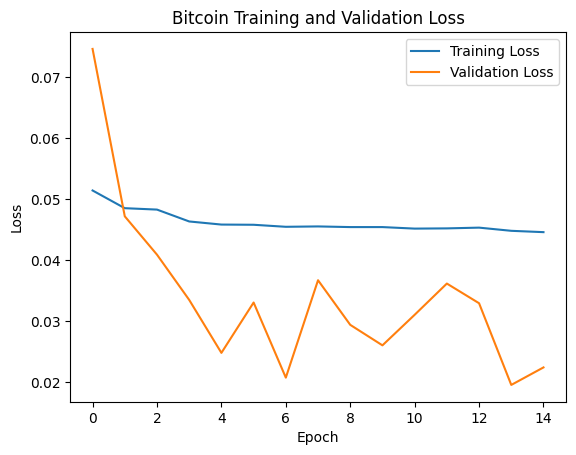

536/536 [==============================] - 6s 7ms/step
Bitcoin Training Set:
RMSE: 10583.71
MSE: 112014906.09
MAE: 9390.99
R2: 0.33


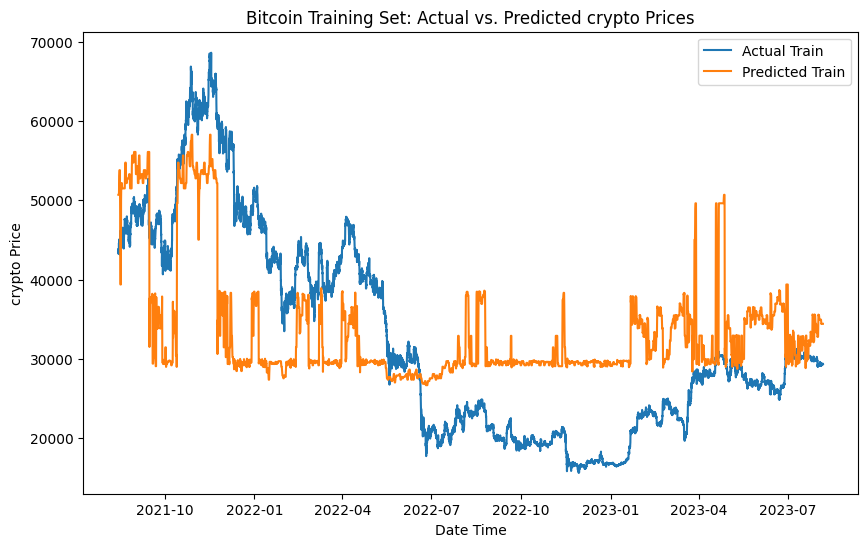

5/5 [==============================] - 0s 8ms/step
Bitcoin Test Set:
RMSE: 5255.88
MSE: 27624306.95
MAE: 5203.69
R2: -702.11


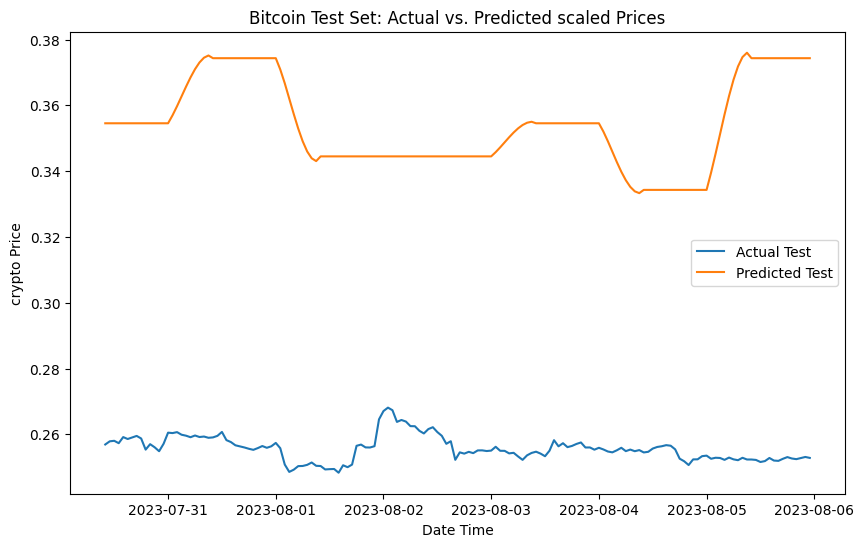

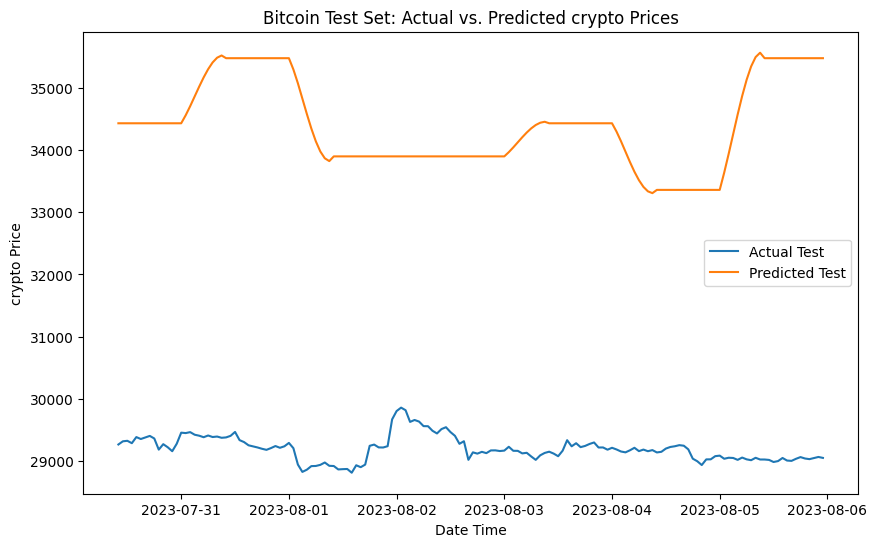

In [ ]:
def apply_bi_lstm_sequences(data,company_name, features, target, test_size=0.2, random_state=42, num_epochs=50, batch_size=32, sequence_length=10):
    # Preprocessing


    X = data[features].values
    y = data[target].values

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y.reshape(-1, 1))

    # Split data into training and testing sets
    #train_size = int((1 - test_size) * len(X_scaled))
    train_size = len(X_scaled)-test_size
    X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
    y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

    # Create sequences
    X_train_seq, y_train_seq = [], []
    X_test_seq, y_test_seq = [], []

    for i in range(len(X_train) - sequence_length):
        X_train_seq.append(X_train[i:i + sequence_length])
        y_train_seq.append(y_train[i + sequence_length])

    for i in range(len(X_test) - sequence_length):
        X_test_seq.append(X_test[i:i + sequence_length])
        y_test_seq.append(y_test[i + sequence_length])

    X_train_seq, y_train_seq = np.array(X_train_seq), np.array(y_train_seq)
    X_test_seq, y_test_seq = np.array(X_test_seq), np.array(y_test_seq)

    # Build and train Bi-LSTM model
    model = Sequential()
    model.add(Bidirectional(LSTM(units=50, return_sequences=True), input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])))
    model.add(Bidirectional(LSTM(units=50)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    history = model.fit(X_train_seq, y_train_seq, epochs=num_epochs, batch_size=batch_size, validation_split=0.2, verbose=1)
    model.summary()
    # Plot validation loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{company_name} Training and Validation Loss')
    plt.legend()
    plt.show()



    # Evaluate the model on training data
    y_train_pred_scaled = model.predict(X_train_seq)
    y_train_pred = scaler_y.inverse_transform(y_train_pred_scaled)
    y_train_orig = scaler_y.inverse_transform(y_train_seq)

    # Calculate RMSE, MSE, and MAE for training set
    train_rmse = np.sqrt(mean_squared_error(y_train_orig, y_train_pred))
    train_mse = mean_squared_error(y_train_orig, y_train_pred)
    train_mae = mean_absolute_error(y_train_orig, y_train_pred)
    #R2score
    train_r2 = r2_score(y_train_orig, y_train_pred)

    print(f"{company_name} Training Set:")
    print(f"RMSE: {train_rmse:.2f}")
    print(f"MSE: {train_mse:.2f}")
    print(f"MAE: {train_mae:.2f}")
    print(f"R2: {train_r2:.2f}")
    # Plot actual vs. predicted values for training set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_train_orig):],y_train_orig, label='Actual Train')
    plt.plot(data.index[-len(y_train_orig):],y_train_pred, label='Predicted Train')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Training Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

    # Evaluate the model on test data
    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_test_orig = scaler_y.inverse_transform(y_test_seq)

    # Calculate RMSE, MSE, and MAE for test set
    rmse = np.sqrt(mean_squared_error(y_test_orig, y_pred))
    mse = mean_squared_error(y_test_orig, y_pred)
    mae = mean_absolute_error(y_test_orig, y_pred)
    test_r2 = r2_score(y_test_orig, y_pred)

    print(f"{company_name} Test Set:")
    print(f"RMSE: {rmse:.2f}")
    print(f"MSE: {mse:.2f}")
    print(f"MAE: {mae:.2f}")
    print(f"R2: {test_r2:.2f}")

    #scaled results
    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_seq, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred_scaled, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted scaled Prices')
    plt.legend()
    plt.show()

    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_orig, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

# Sample data and parameters
# Replace with your actual data and parameters
data = df_btc
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_bi_lstm_sequences(data,'Bitcoin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


####Whale transaction and fear & greed

Epoch 1/15
429/429 [==============================] - 28s 42ms/step - loss: 0.0108 - val_loss: 0.0082
Epoch 2/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0058 - val_loss: 0.0057
Epoch 3/15
429/429 [==============================] - 19s 43ms/step - loss: 0.0037 - val_loss: 0.0066
Epoch 4/15
429/429 [==============================] - 15s 34ms/step - loss: 0.0022 - val_loss: 0.0100
Epoch 5/15
429/429 [==============================] - 16s 37ms/step - loss: 0.0019 - val_loss: 0.0109
Epoch 6/15
429/429 [==============================] - 19s 44ms/step - loss: 0.0015 - val_loss: 0.0098
Epoch 7/15
429/429 [==============================] - 15s 35ms/step - loss: 0.0015 - val_loss: 0.0057
Epoch 8/15
429/429 [==============================] - 15s 36ms/step - loss: 0.0014 - val_loss: 0.0047
Epoch 9/15
429/429 [==============================] - 19s 43ms/step - loss: 0.0012 - val_loss: 0.0094
Epoch 10/15
429/429 [==============================] - 15s 35ms/step - loss: 0.001

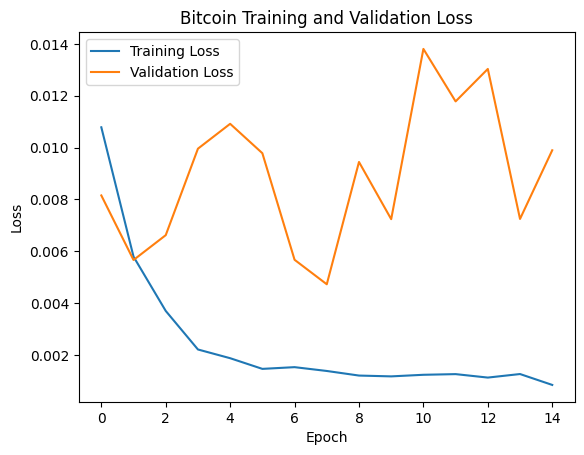

536/536 [==============================] - 10s 14ms/step
Bitcoin Training Set:
RMSE: 2645.88
MSE: 7000658.79
MAE: 1748.51
R2: 0.96


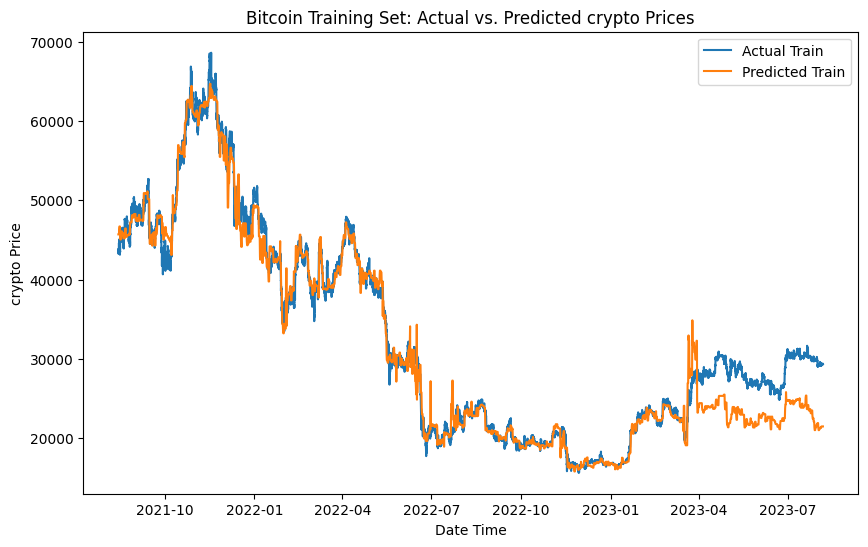

5/5 [==============================] - 0s 10ms/step
Bitcoin Test Set:
RMSE: 7590.00
MSE: 57608154.75
MAE: 7580.71
R2: -1465.28


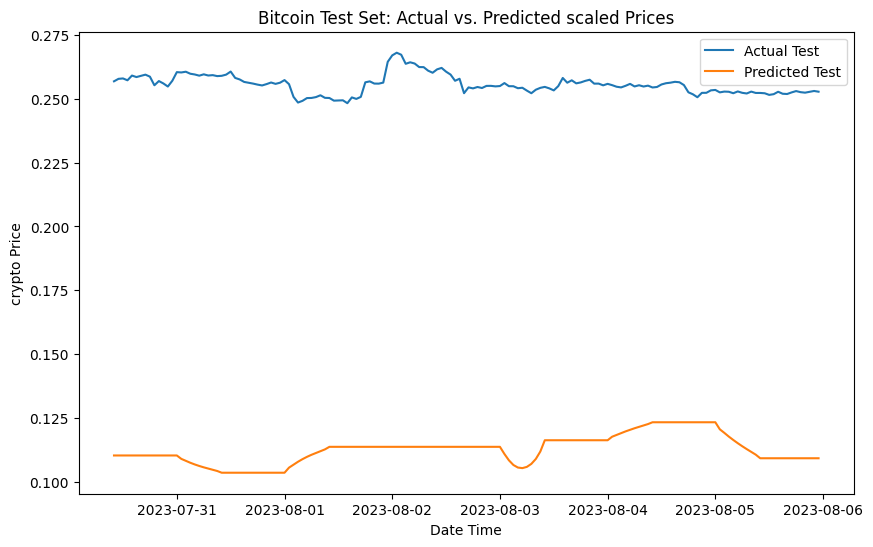

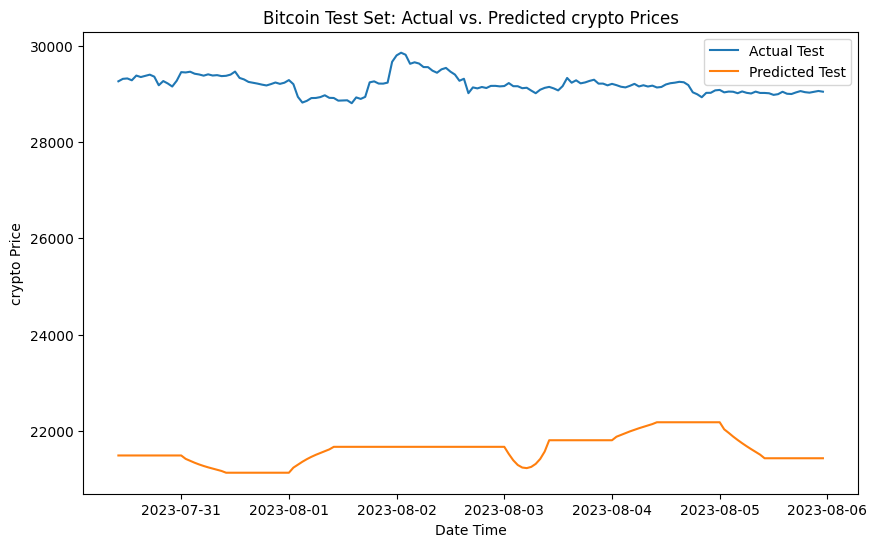

In [ ]:

data = df_btc
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10
apply_bi_lstm_sequences(data,'Bitcoin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


#Ethereum

In [31]:
df_eth.set_index('Date', inplace=True)

##ARIMA

###Check stationarity


> The P value below is >0.05 which means we cannot reject null hypothesis and the data is not stationary.



ADF Statistic: -1.3473327027141035
p-value: 0.6072491811364937
Critical Values: {'1%': -3.4307284222362635, '5%': -2.861707247880268, '10%': -2.566859021728268}


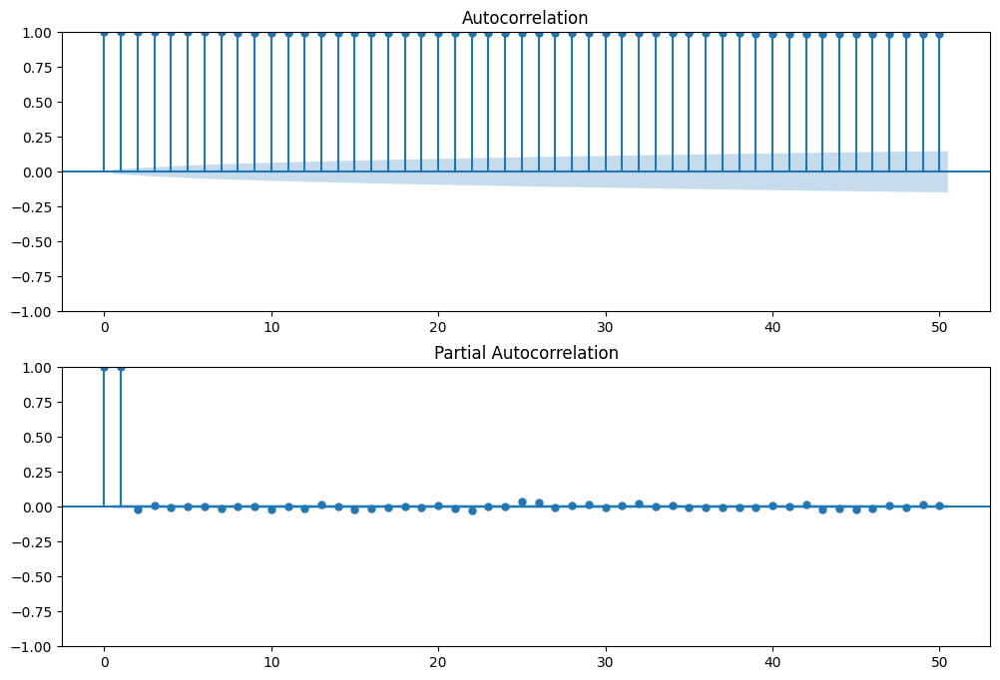

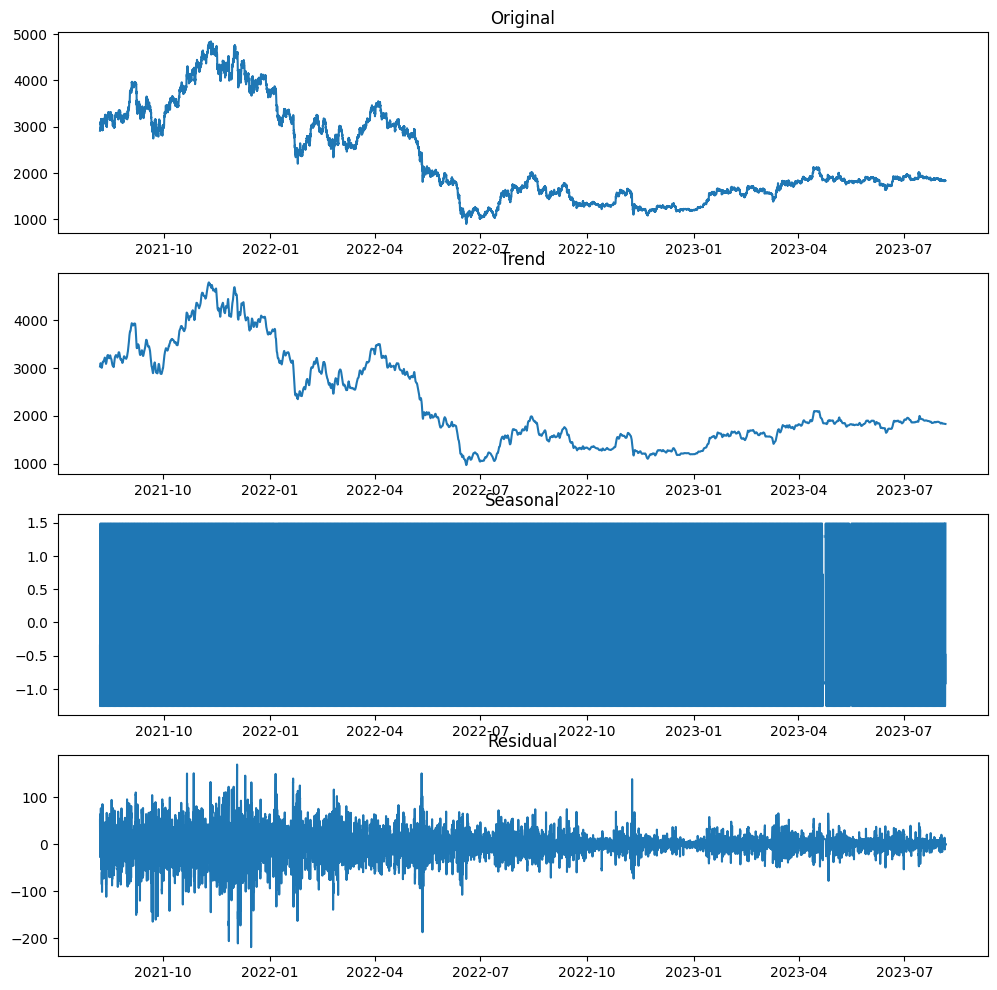

In [ ]:
check_stationarity(df_eth['Close'])

###Seasonal differencing


> p value is less than 0.05 indicating that data is stationary and can reject null hypothesis.



box_diff_seasonal_1 p value = 0.000000
box_diff_seasonal_3 p value = 0.000000
box_diff_seasonal_6 p value = 0.000000
box_diff_seasonal_12 p value = 0.000000
box_diff_seasonal_24 p value = 0.000000
box_diff_seasonal_168 p value = 0.000000
box_diff_seasonal_672 p value = 0.001980


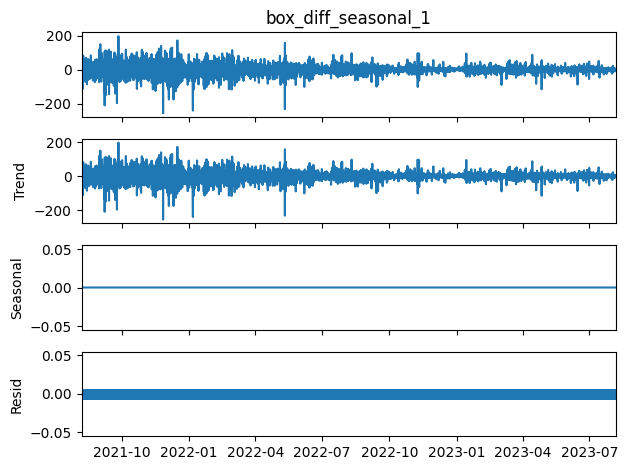

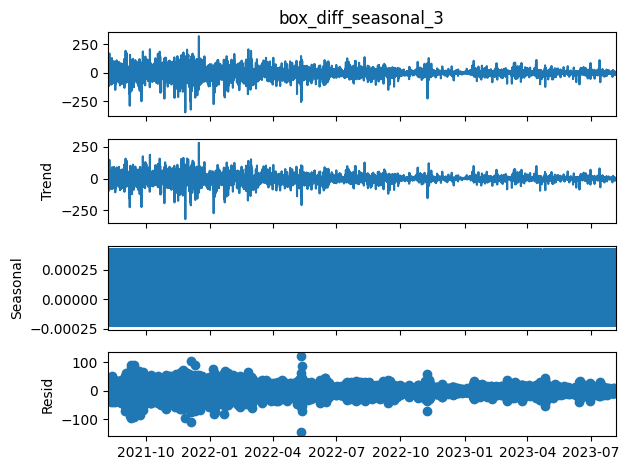

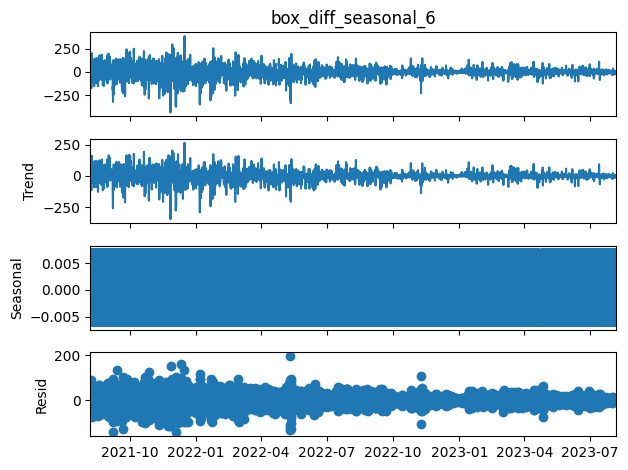

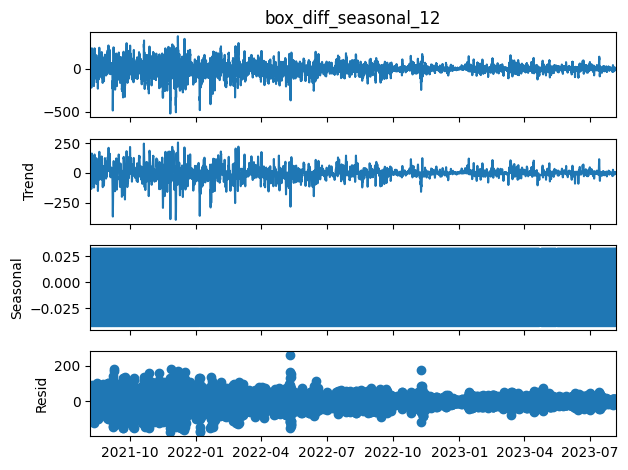

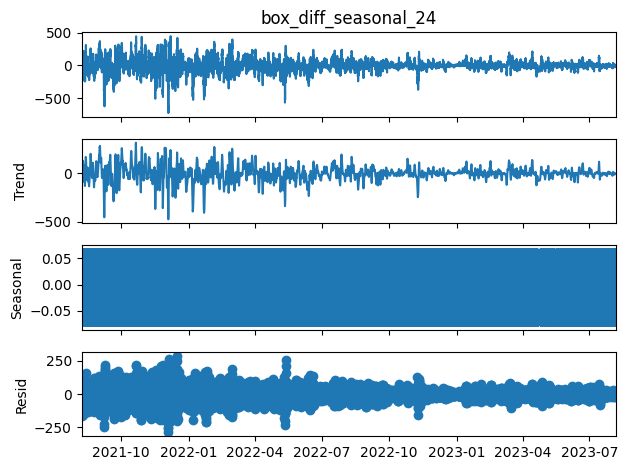

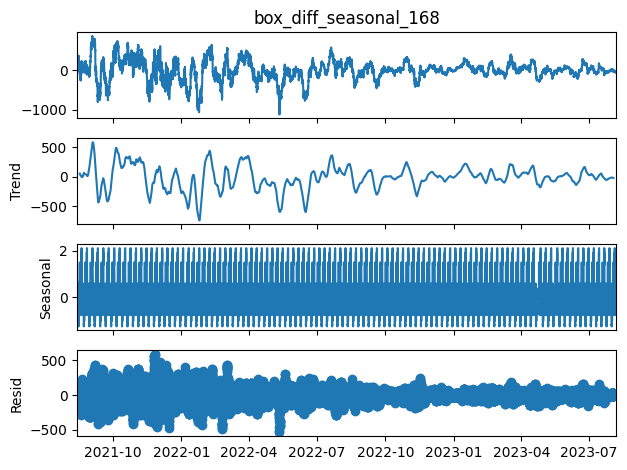

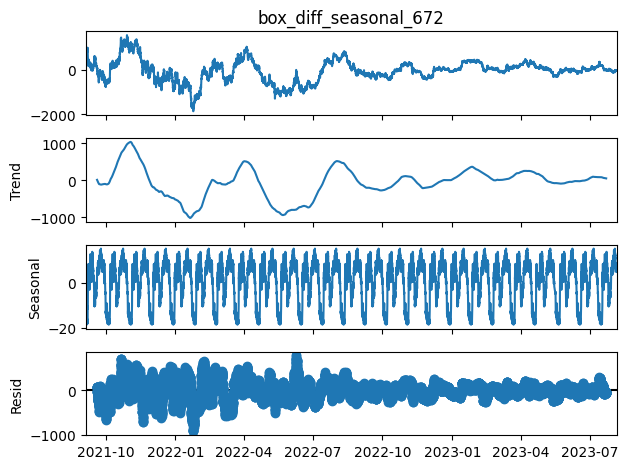

In [ ]:
# creating new dataframe to compute seasonal differentition for 1,3,6,12,24,168,672 lags(observations)

def Seasonal_diff(df):
  df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1)) #1hr
  df['box_diff_seasonal_3'] = (df.Close - df.Close.shift(3)) #3hrs
  df['box_diff_seasonal_6'] = (df.Close - df.Close.shift(6))  #6hrs
  df['box_diff_seasonal_12'] = (df.Close - df.Close.shift(12)) #12hrs
  df['box_diff_seasonal_24'] = (df.Close - df.Close.shift(24)) #daily
  df['box_diff_seasonal_168'] = (df.Close - df.Close.shift(168)) #WEEKLY
  df['box_diff_seasonal_672'] = (df.Close - df.Close.shift(672)) #MONTHLY

  #computation ADF test
  print("box_diff_seasonal_1 p value = %f" % adfuller(df.box_diff_seasonal_1[1:])[1])
  print("box_diff_seasonal_3 p value = %f" % adfuller(df.box_diff_seasonal_3[3:])[1])
  print("box_diff_seasonal_6 p value = %f" % adfuller(df.box_diff_seasonal_6[6:])[1])
  print("box_diff_seasonal_12 p value = %f" % adfuller(df.box_diff_seasonal_12[12:])[1])
  print("box_diff_seasonal_24 p value = %f" % adfuller(df.box_diff_seasonal_24[24:])[1])
  print("box_diff_seasonal_168 p value = %f" % adfuller(df.box_diff_seasonal_168[168:])[1])
  print("box_diff_seasonal_672 p value = %f" % adfuller(df.box_diff_seasonal_672[672:])[1])

  seasonal_decompose(df.box_diff_seasonal_1[1:],period=1).plot()
  seasonal_decompose(df.box_diff_seasonal_3[3:],period=3).plot()
  seasonal_decompose(df.box_diff_seasonal_6[6:],period=6).plot()
  seasonal_decompose(df.box_diff_seasonal_12[12:],period=12).plot()
  seasonal_decompose(df.box_diff_seasonal_24[24:],period=24).plot()
  seasonal_decompose(df.box_diff_seasonal_168[168:],period=168).plot()
  seasonal_decompose(df.box_diff_seasonal_672[672:],period=672).plot()

Seasonal_diff(df_eth)

###Fine tune ARIMA

In [ ]:
df

,Open,High,Low,Close,Adj Close,Volume_x,value,value_classification_encoded,Price,Volume_y,...,Total NFT Trades Volume In USD,Whale Transaction Count (>100k USD,Whale Transaction Count (>1m USD),box_diff_seasonal_1,box_diff_seasonal_3,box_diff_seasonal_6,box_diff_seasonal_12,box_diff_seasonal_24,box_diff_seasonal_168,box_diff_seasonal_672
Date,,,,,,,,,,,,,,,,,,,,,
2021-08-07 00:00:00,2891.707520,2913.185059,2868.535645,2913.185059,2913.185059,0,69.0,3.0,2913.185109,26729035052,...,1.166618e+08,65923,10628,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-07 01:00:00,2916.874756,2926.063965,2889.468750,2917.718750,2917.718750,0,69.0,3.0,2917.718710,26729035052,...,1.166618e+08,65923,10628,4.533691,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-07 02:00:00,2916.534668,2930.369385,2910.024170,2927.084229,2927.084229,0,69.0,3.0,2927.084145,26729035052,...,1.166618e+08,65923,10628,9.365479,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-07 03:00:00,2927.516846,2939.033936,2911.632080,2939.033936,2939.033936,1476608,69.0,3.0,2939.034040,26729035052,...,1.166618e+08,65923,10628,11.949707,25.848877,NaN,NaN,NaN,NaN,NaN
2021-08-07 04:00:00,2936.439453,2981.819336,2930.944336,2960.582275,2960.582275,906735616,69.0,3.0,2960.582159,26729035052,...,1.166618e+08,65923,10628,21.548340,42.863525,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-08-05 19:00:00,1835.527222,1836.092407,1833.813721,1833.813721,1833.813721,0,50.0,4.0,1833.813717,5869920698,...,2.054683e+05,16967,2102,-2.275635,4.699829,2.913696,5.476685,5.526489,-43.892334,-13.924927
2023-08-05 20:00:00,1833.805298,1833.805298,1832.317139,1832.612549,1832.612549,0,50.0,4.0,1832.612558,5869920698,...,2.054683e+05,16967,2102,-1.201172,0.334839,-1.129272,1.918823,12.197876,-51.316040,-16.345215
2023-08-05 21:00:00,1832.765625,1834.942261,1832.765625,1833.999878,1833.999878,0,50.0,4.0,1834.018249,5869920698,...,2.054683e+05,16967,2102,1.387329,-2.089478,2.497681,5.616943,6.576050,-47.468628,-21.562256


In [ ]:
df =df_eth
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))

ts=df['box_diff_seasonal_1'][1:]

test_data = ts.iloc[-168:]

# The remaining data is the training data
train_data = ts.iloc[:-168]

model = auto_arima(train_data, seasonal=True, stepwise=True, suppress_warnings=True, error_action="ignore")

# Print the summary of the best model
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                17146
Model:               SARIMAX(0, 0, 1)   Log Likelihood              -74977.532
Date:                Sun, 15 Oct 2023   AIC                         149959.064
Time:                        18:20:59   BIC                         149974.563
Sample:                             0   HQIC                        149964.173
                              - 17146                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.0222      0.004      5.653      0.000       0.014       0.030
sigma2       367.9764      1.345    273.537      0.000     365.340     370.613
Ljung-Box (L1) (Q):                   0.00   Jarque-

###7 Day Forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

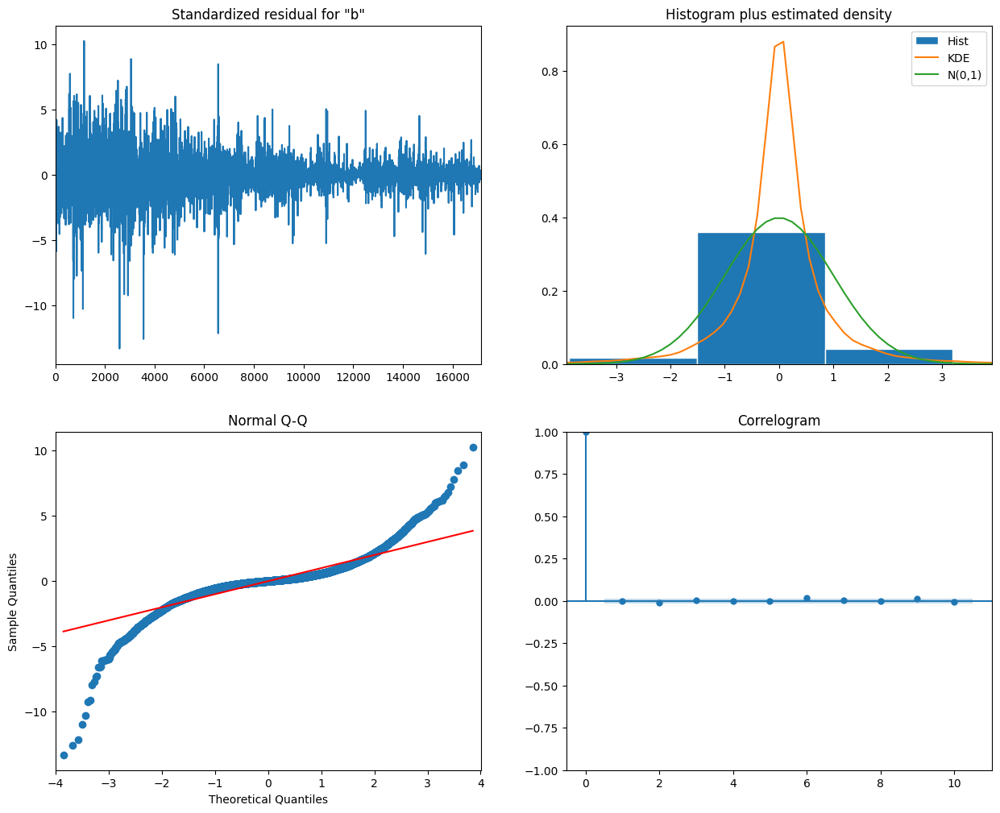

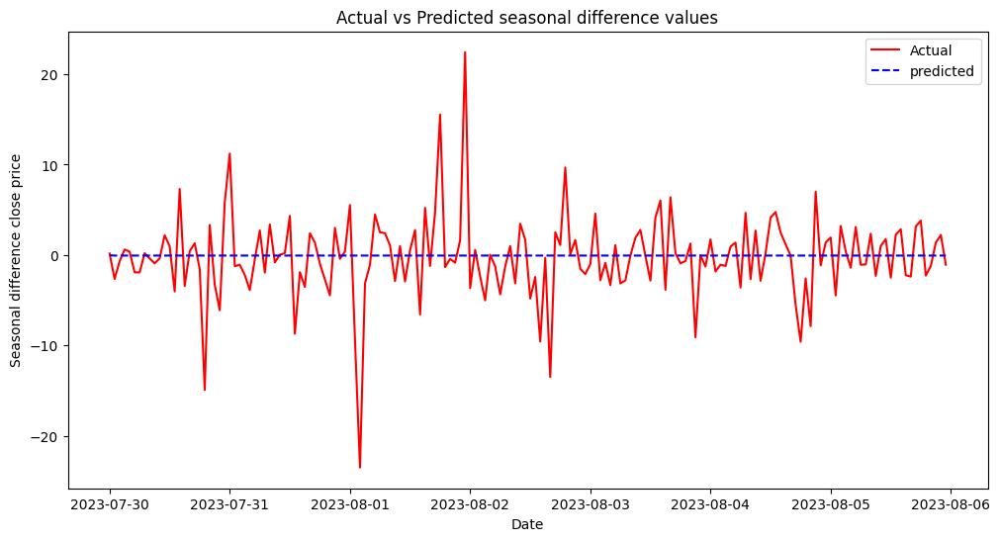

Mean Absolute Error (MAE): 3.055024061740875
Mean Squared Error (MSE): 21.487326737541462
Root Mean Squared Error (RMSE): 4.635442453266081
R2 score: -0.0021298094665929135


In [32]:
p,d,q =0,0,1
def arima_forecast(df,days):

  ts =df
  test_data = ts.iloc[-24*days:] #test data
  # The remaining data is the training data
  train_data = ts.iloc[:-24*days]

  test_data = pd.DataFrame(test_data) #convert series to df
  test_data2= test_data.copy()

  model = ARIMA(train_data, order=(p, d, q))  # ARIMA(p, d, q) order

  model_fit = model.fit()
  model_fit.plot_diagnostics(figsize=(15,12))

  forecast_steps=len(test_data)
  forecast = model_fit.forecast(steps=forecast_steps)
#print(forecast.info())
#print(forecast)
#df_forecast = pd.DataFrame(forecast)
  df_forecast = pd.DataFrame(forecast.values, columns=['Forecasted Close'], index=test_data.index)
#print(df_forecast.info())
#print(df_forecast)

  plt.figure(figsize=(12, 6))
  plt.plot(test_data, color='red', label='Actual')
  plt.plot(df_forecast['Forecasted Close'],ls='--', color='blue', label='predicted')
  #plt.plot(pd.date_range(start=test_data.index[0], periods=forecast_steps+1, inclusive='right'), forecast, label='Forecasted Prices', color='blue')
  plt.xlabel('Date')
  plt.ylabel('Seasonal difference close price')
  plt.title('Actual vs Predicted seasonal difference values')
  plt.legend()
  plt.show()

  # Calculate Mean Absolute Error (MAE)
  mae = mean_absolute_error(test_data2, df_forecast['Forecasted Close'])

  # Calculate Mean Squared Error (MSE)
  mse = mean_squared_error(test_data2, df_forecast['Forecasted Close'])

  # Calculate Root Mean Squared Error (RMSE)
  rmse = np.sqrt(mse)
  #R2score
  r2 = r2_score(test_data2, df_forecast['Forecasted Close'])

  # Print the metrics
  print(f"Mean Absolute Error (MAE): {mae}")
  print(f"Mean Squared Error (MSE): {mse}")
  print(f"Root Mean Squared Error (RMSE): {rmse}")
  print(f"R2 score: {r2}")

  return df_forecast
df =df_eth
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
df_forecast = arima_forecast(df['box_diff_seasonal_1'],7)

In [33]:

df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

In [34]:
merged_df


,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,1881.351074,0.165771,1881.351074,1881.351074
2023-07-30 01:00:00,1878.699585,-2.651489,-0.060189,1881.290885
2023-07-30 02:00:00,1878.004639,-0.694946,-0.060189,1881.230696
2023-07-30 03:00:00,1878.618042,0.613403,-0.060189,1881.170507
2023-07-30 04:00:00,1878.993774,0.375732,-0.060189,1881.110318
...,...,...,...,...
2023-08-05 19:00:00,1833.813721,-2.275635,-0.060189,1871.540276
2023-08-05 20:00:00,1832.612549,-1.201172,-0.060189,1871.480087
2023-08-05 21:00:00,1833.999878,1.387329,-0.060189,1871.419898


Actual vs predicted values evaluation metrics

In [35]:
def evaluation_metrics(merged_df):
# Calculate Mean Absolute Error (MAE)
  mae = mean_absolute_error(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])

  # Calculate Mean Squared Error (MSE)
  mse = mean_squared_error(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])

  # Calculate Root Mean Squared Error (RMSE)
  rmse = np.sqrt(mse)
  #R2score
  r2 = r2_score(merged_df.Close[1:-1], merged_df.cumulative_sum_close[1:-1])

  # Print the metrics
  print(f"Mean Absolute Error (MAE): {mae}")
  print(f"Mean Squared Error (MSE): {mse}")
  print(f"Root Mean Squared Error (RMSE): {rmse}")
  print(f"R2 score: {r2}")

evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 29.144167027607796
Mean Squared Error (MSE): 1061.4741842608726
Root Mean Squared Error (RMSE): 32.58027293103716
R2 score: -2.778866811187829


Actual vs predicted close prices

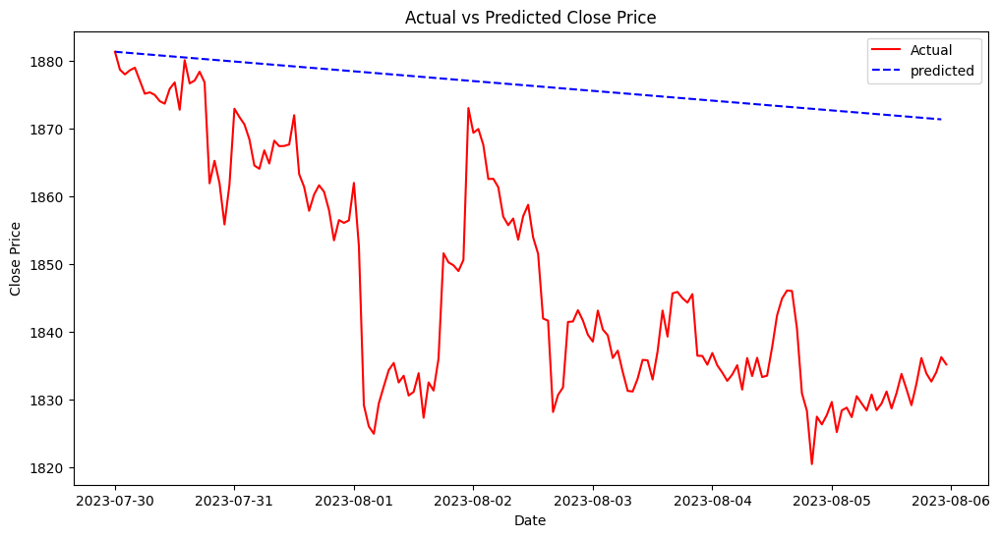

In [36]:
def actual_predicted_plot(merged_df):
  plt.figure(figsize=(12, 6))
  plt.plot(merged_df['Close'], color='red', label='Actual')
  plt.plot(merged_df['cumulative_sum_close'],ls='--', color='blue', label='predicted')
  plt.xlabel('Date')
  plt.ylabel('Close Price')
  plt.title('Actual vs Predicted Close Price')
  plt.legend()
  plt.show()

actual_predicted_plot(merged_df)

##SARIMAX

####Fine tune sarimax

In [ ]:


# Define parameter ranges
p_values = range(0, 3)
d_values = range(0, 2)
q_values = range(0, 3)
P_values = range(0, 3)
D_values = range(0, 2)
Q_values = range(0, 3)
s = 7  # Seasonal period

data = df['box_diff_seasonal_1'][:500]
# Split data into training, validation, and test sets
train_size = int(len(data) * 0.6)
valid_size = int(len(data) * 0.2)
train_data = data[:train_size]
valid_data = data[train_size:train_size + valid_size]
test_data = data[train_size + valid_size:]

best_model = None
best_mse = float('inf')

# Grid search over parameter combinations
for p, d, q, P, D, Q in product(p_values, d_values, q_values, P_values, D_values, Q_values):
    try:
        model = sm.tsa.SARIMAX(train_data, order=(p, d, q), seasonal_order=(P, D, Q, s))
        results = model.fit()
        forecast = results.forecast(steps=len(valid_data))
        mse = mean_squared_error(valid_data, forecast)

        if mse < best_mse:
            best_mse = mse
            best_model = model

    except Exception as e:
        continue

# Fit the best model on the entire training set
final_model = best_model.fit()

# Evaluate on the test set
forecast_test = final_model.forecast(steps=len(test_data))
mse_test = mean_squared_error(test_data, forecast_test)

print("Best SARIMA Model Parameters:", best_model.order, best_model.seasonal_order)
print("Validation MSE:", best_mse)
print("Test MSE:", mse_test)




/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood op

Best SARIMA Model Parameters: (1, 1, 2) (2, 0, 2, 7)
Validation MSE: 391.4447186188718
Test MSE: 460.6787635707818


###7Day forecast Greed index

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

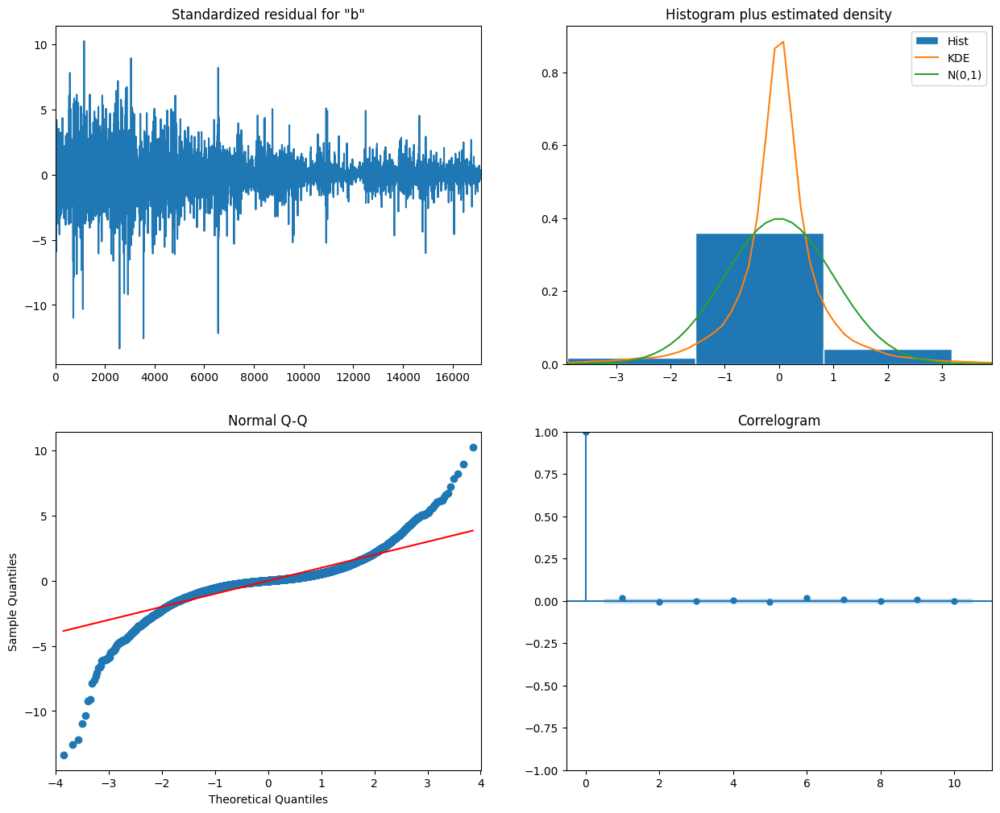

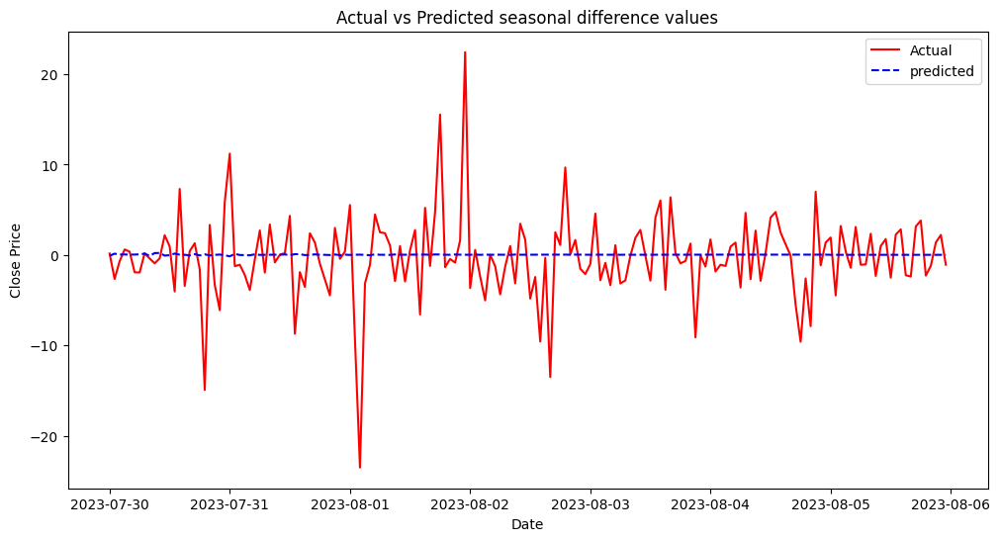

Mean Absolute Error (MAE): 3.066432650695493
Mean Squared Error (MSE): 21.58974461050304
Root Mean Squared Error (RMSE): 4.646476580216782
R2 score: -0.006906392648419635


In [ ]:
# Define SARIMAX model order parameters
p, d, q = 1, 1, 2  # Non-seasonal order
P, D, Q, s = 2, 0, 2, 7  # Seasonal order with daily seasonality


days=7
exog = df['value']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,1881.351074,0.165771,1881.351074,1881.351074
2023-07-30 01:00:00,1878.699585,-2.651489,0.050664,1881.401738
2023-07-30 02:00:00,1878.004639,-0.694946,0.063508,1881.465246
2023-07-30 03:00:00,1878.618042,0.613403,0.035541,1881.500787
2023-07-30 04:00:00,1878.993774,0.375732,0.053498,1881.554285
2023-07-30 05:00:00,1877.084351,-1.909424,0.070617,1881.624902
2023-07-30 06:00:00,1875.147583,-1.936768,0.155820,1881.780722
2023-07-30 07:00:00,1875.352783,0.205200,-0.101256,1881.679466
2023-07-30 08:00:00,1874.965454,-0.387329,0.216546,1881.896012


In [ ]:
evaluation_metrics(merged_df)


Mean Absolute Error (MAE): 37.05575407854608
Mean Squared Error (MSE): 1698.1258286605196
Root Mean Squared Error (RMSE): 41.20832232280901
R2 score: -5.045357890276302


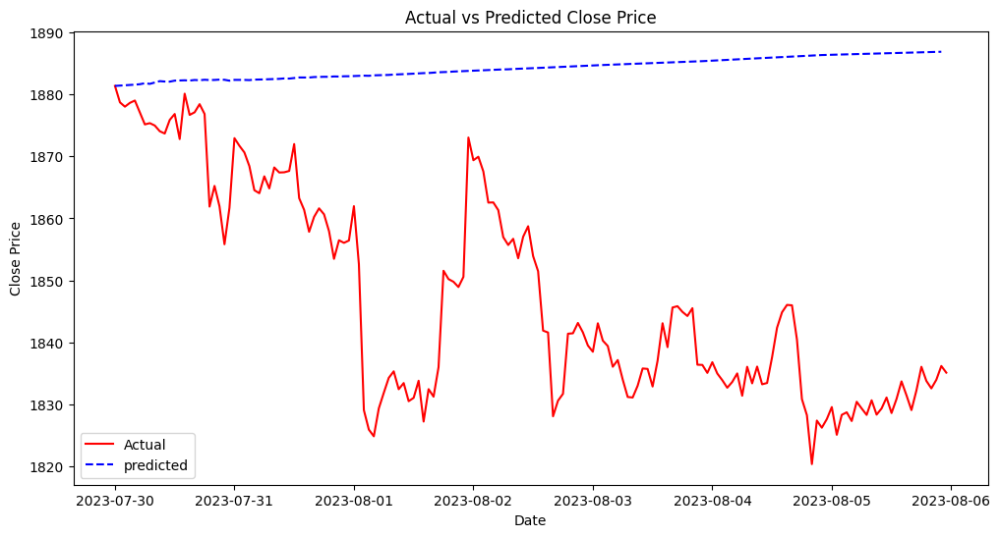

In [ ]:
def actual_predicted_plot(merged_df):
  plt.figure(figsize=(12, 6))
  plt.plot(merged_df['Close'], color='red', label='Actual')
  plt.plot(merged_df['cumulative_sum_close'],ls='--', color='blue', label='predicted')
  plt.xlabel('Date')
  plt.ylabel('Close Price')
  plt.title('Actual vs Predicted Close Price')
  plt.legend()
  plt.show()

actual_predicted_plot(merged_df)

###7Day forecast greed and whale transaction

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

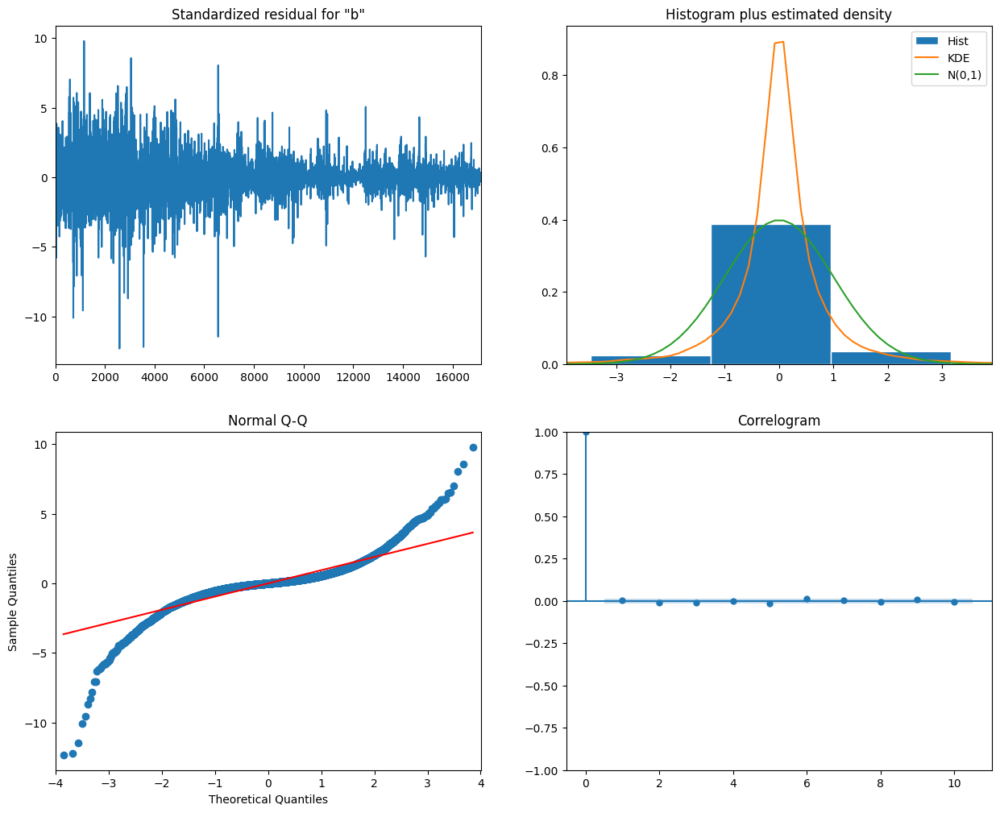

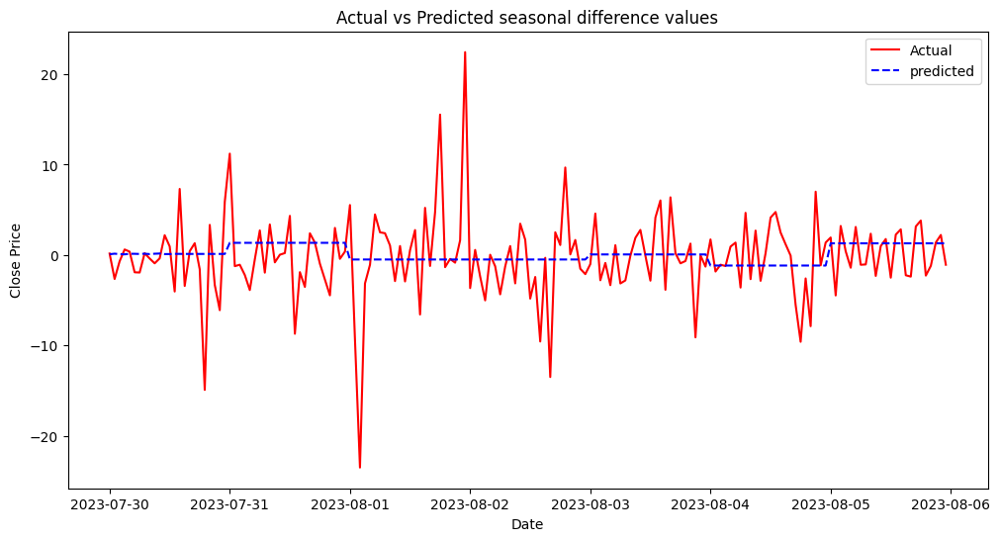

Mean Absolute Error (MAE): 3.146949328159531
Mean Squared Error (MSE): 22.083551399902046
Root Mean Squared Error (RMSE): 4.699313928639163
R2 score: -0.029936642517015333


In [ ]:
exog = df[['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,1881.351074,0.165771,1881.351074,1881.351074
2023-07-30 01:00:00,1878.699585,-2.651489,0.098805,1881.449879
2023-07-30 02:00:00,1878.004639,-0.694946,0.077376,1881.527255
2023-07-30 03:00:00,1878.618042,0.613403,0.136403,1881.663658
2023-07-30 04:00:00,1878.993774,0.375732,0.135570,1881.799228
2023-07-30 05:00:00,1877.084351,-1.909424,0.116841,1881.916069
2023-07-30 06:00:00,1875.147583,-1.936768,0.143966,1882.060035
2023-07-30 07:00:00,1875.352783,0.205200,0.103077,1882.163112
2023-07-30 08:00:00,1874.965454,-0.387329,0.143896,1882.307008


Mean Absolute Error (MAE): 45.526387572694354
Mean Squared Error (MSE): 2469.271729699248
Root Mean Squared Error (RMSE): 49.691767222541486
R2 score: -7.790650894314744


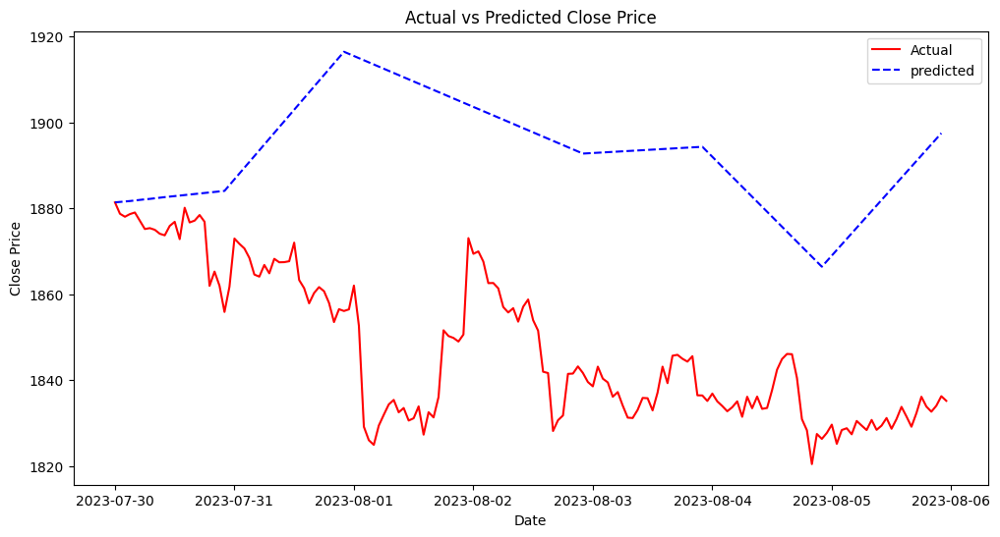

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

##LSTM

###7 Day prediction greed

Epoch 1/15
429/429 [==============================] - 17s 30ms/step - loss: 0.0575 - val_loss: 0.0785
Epoch 2/15
429/429 [==============================] - 7s 17ms/step - loss: 0.0546 - val_loss: 0.0662
Epoch 3/15
429/429 [==============================] - 9s 22ms/step - loss: 0.0543 - val_loss: 0.0752
Epoch 4/15
429/429 [==============================] - 10s 24ms/step - loss: 0.0541 - val_loss: 0.0751
Epoch 5/15
429/429 [==============================] - 7s 16ms/step - loss: 0.0539 - val_loss: 0.0562
Epoch 6/15
429/429 [==============================] - 12s 27ms/step - loss: 0.0538 - val_loss: 0.0522
Epoch 7/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0530 - val_loss: 0.0523
Epoch 8/15
429/429 [==============================] - 9s 20ms/step - loss: 0.0514 - val_loss: 0.0401
Epoch 9/15
429/429 [==============================] - 11s 25ms/step - loss: 0.0505 - val_loss: 0.0381
Epoch 10/15
429/429 [==============================] - 7s 17ms/step - loss: 0.0502 - va

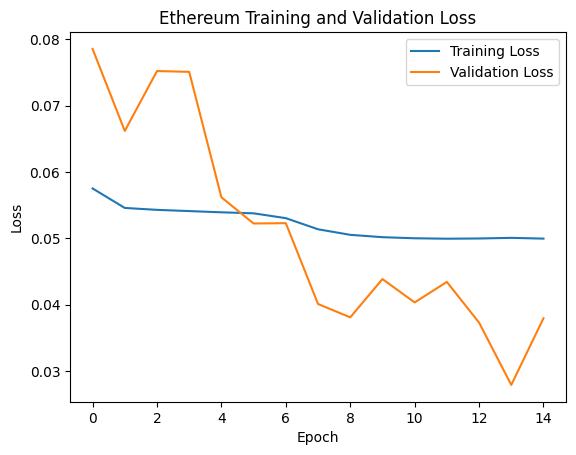

536/536 [==============================] - 5s 7ms/step
Ethereum Training Set:
RMSE: 860.28
MSE: 740074.38
MAE: 749.66
R2 score: 0.23


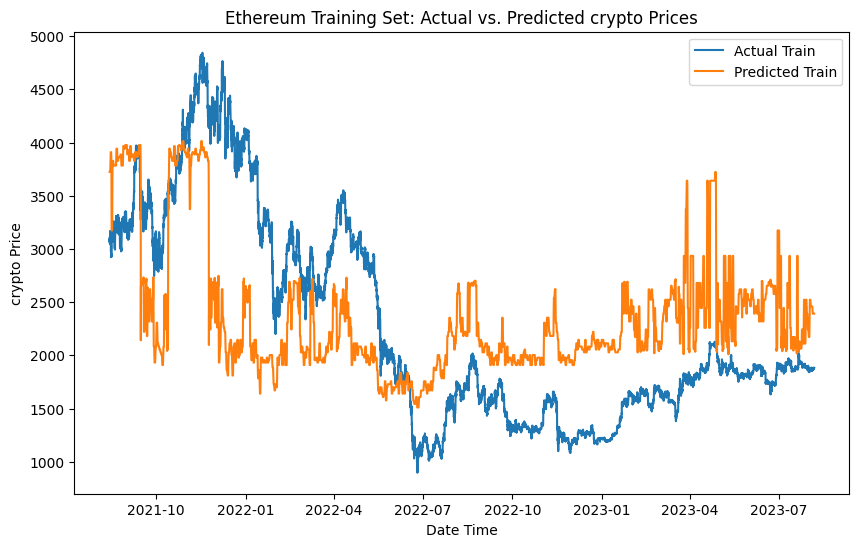

5/5 [==============================] - 0s 9ms/step
Ethereum Test Set:
RMSE: 543.57
MSE: 295469.76
MAE: 536.59
test R2 score: -1215.50


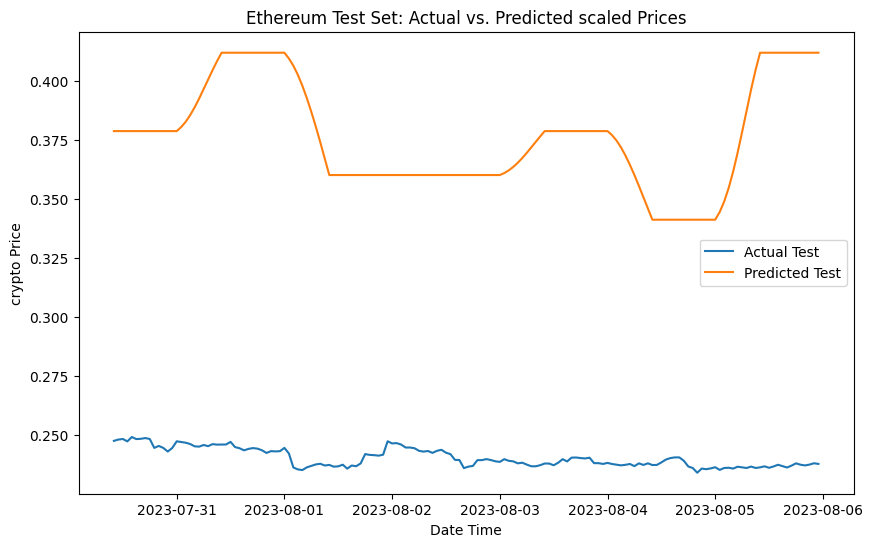

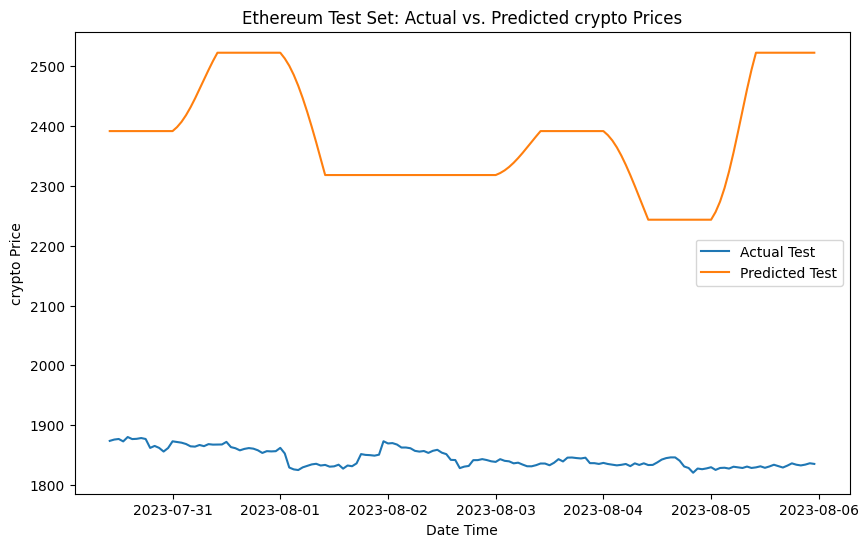

In [ ]:
data = df_eth
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Ethereum', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

### Whale trasaction and fear and greed

Epoch 1/15
429/429 [==============================] - 16s 27ms/step - loss: 0.0159 - val_loss: 0.0237
Epoch 2/15
429/429 [==============================] - 9s 20ms/step - loss: 0.0101 - val_loss: 0.0237
Epoch 3/15
429/429 [==============================] - 8s 18ms/step - loss: 0.0091 - val_loss: 0.0191
Epoch 4/15
429/429 [==============================] - 12s 27ms/step - loss: 0.0084 - val_loss: 0.0191
Epoch 5/15
429/429 [==============================] - 7s 16ms/step - loss: 0.0074 - val_loss: 0.0175
Epoch 6/15
429/429 [==============================] - 9s 21ms/step - loss: 0.0066 - val_loss: 0.0149
Epoch 7/15
429/429 [==============================] - 10s 23ms/step - loss: 0.0060 - val_loss: 0.0166
Epoch 8/15
429/429 [==============================] - 7s 17ms/step - loss: 0.0058 - val_loss: 0.0165
Epoch 9/15
429/429 [==============================] - 11s 26ms/step - loss: 0.0054 - val_loss: 0.0178
Epoch 10/15
429/429 [==============================] - 9s 20ms/step - loss: 0.0049 - va

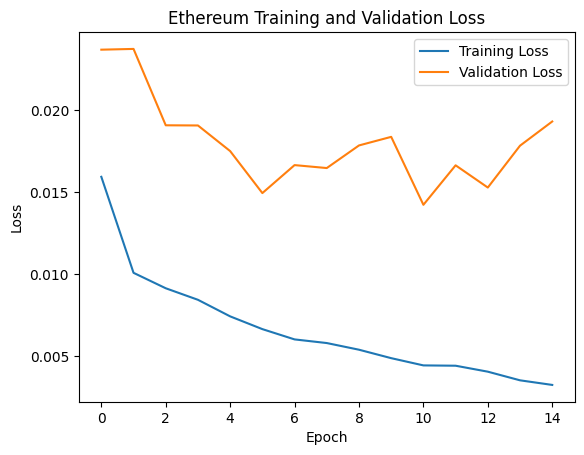

536/536 [==============================] - 5s 6ms/step
Ethereum Training Set:
RMSE: 302.10
MSE: 91264.71
MAE: 189.10
R2 score: 0.90


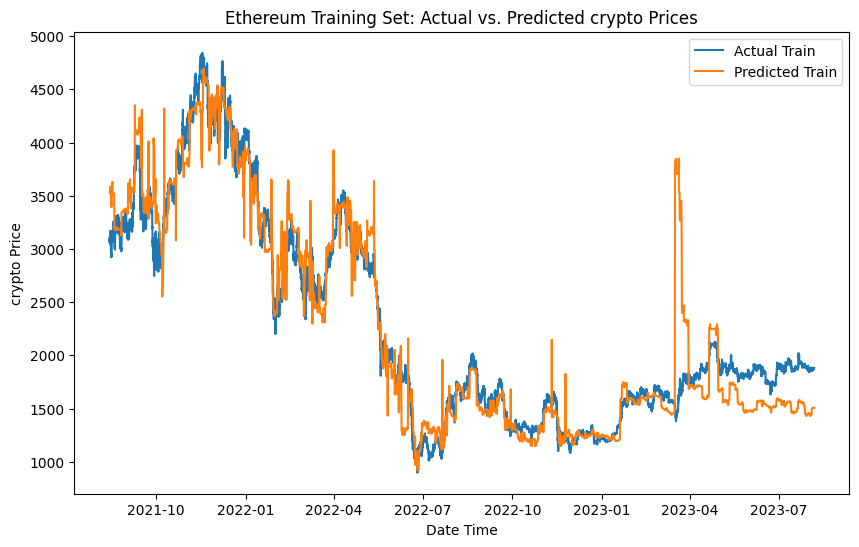

5/5 [==============================] - 0s 8ms/step
Ethereum Test Set:
RMSE: 362.40
MSE: 131331.01
MAE: 361.62
test R2 score: -539.71


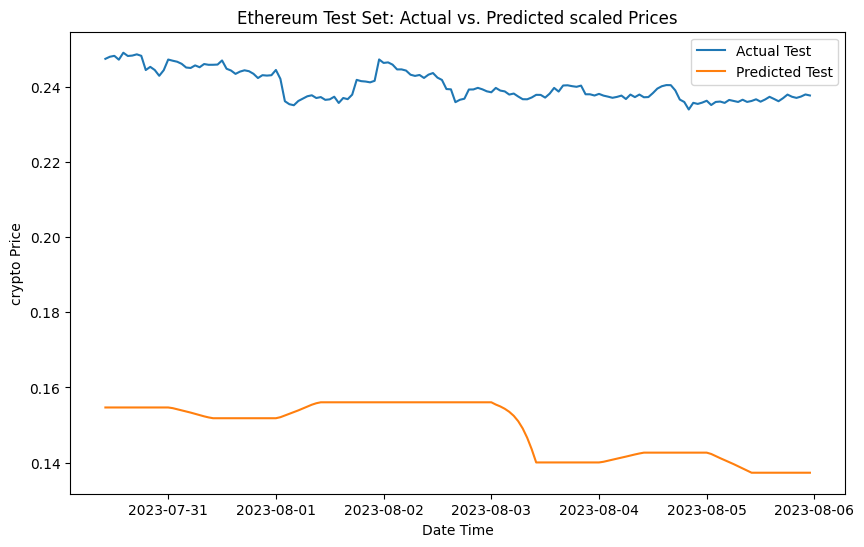

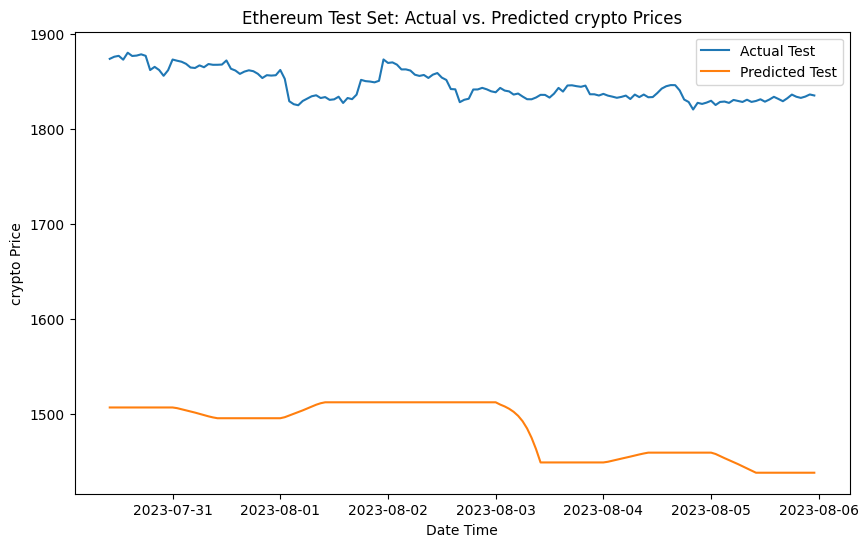

In [ ]:

data = df_eth
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Ethereum', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

##Bi-LSTM

####7 Day Prediction using greed

Epoch 1/15
429/429 [==============================] - 29s 43ms/step - loss: 0.0561 - val_loss: 0.1045
Epoch 2/15
429/429 [==============================] - 13s 31ms/step - loss: 0.0548 - val_loss: 0.0775
Epoch 3/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0542 - val_loss: 0.0693
Epoch 4/15
429/429 [==============================] - 17s 39ms/step - loss: 0.0541 - val_loss: 0.0863
Epoch 5/15
429/429 [==============================] - 13s 31ms/step - loss: 0.0537 - val_loss: 0.0587
Epoch 6/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0525 - val_loss: 0.0261
Epoch 7/15
429/429 [==============================] - 17s 39ms/step - loss: 0.0506 - val_loss: 0.0336
Epoch 8/15
429/429 [==============================] - 13s 31ms/step - loss: 0.0502 - val_loss: 0.0439
Epoch 9/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0502 - val_loss: 0.0366
Epoch 10/15
429/429 [==============================] - 17s 40ms/step - loss: 0.050

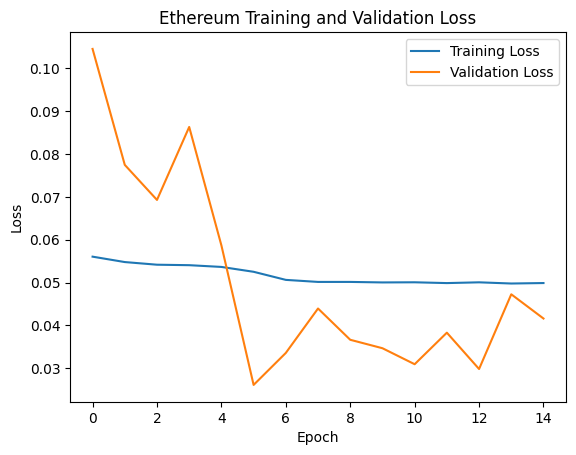

536/536 [==============================] - 8s 11ms/step
Ethereum Training Set:
RMSE: 863.46
MSE: 745563.85
MAE: 766.20
R2: 0.22


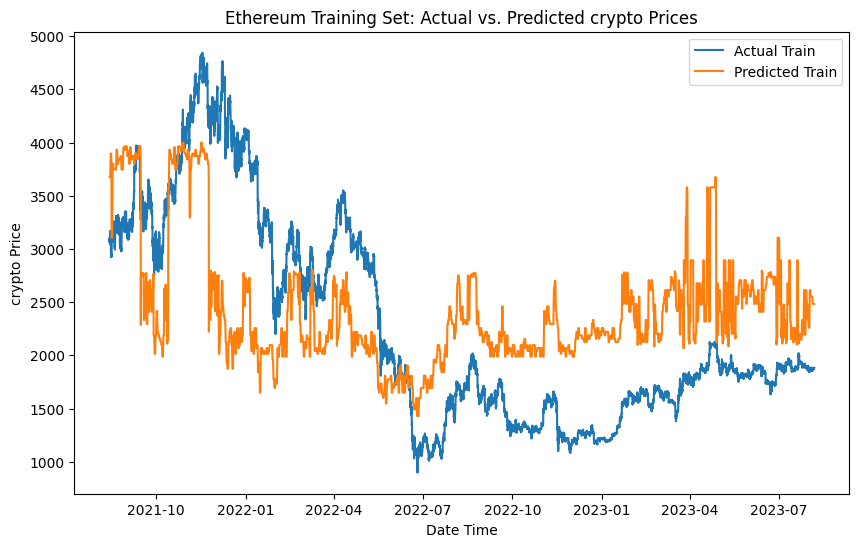

5/5 [==============================] - 0s 15ms/step
Ethereum Test Set:
RMSE: 633.38
MSE: 401164.60
MAE: 627.31
R2: -1650.66


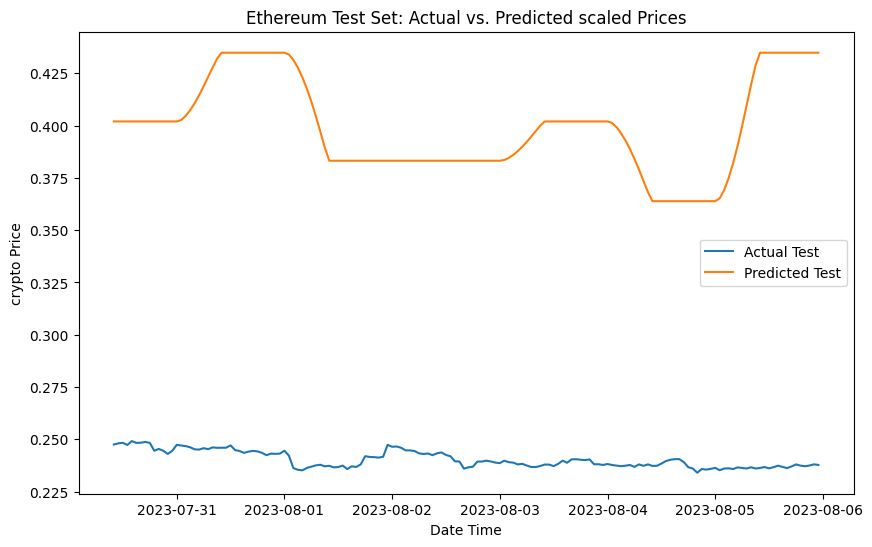

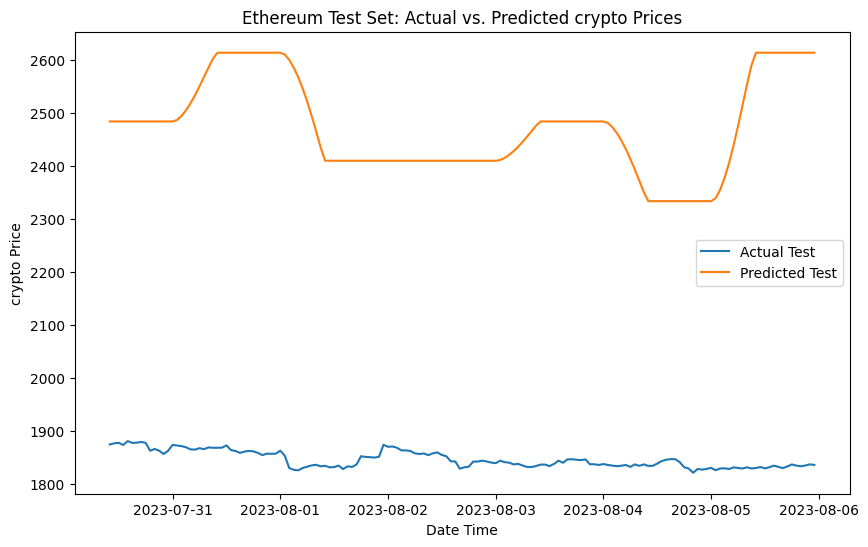

In [ ]:
data = df_eth
features = ['value']
target = 'Close'
test_size = 168
random_state = 42
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_bi_lstm_sequences(data,'Ethereum', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

####Whale transaction and fear & greed

Epoch 1/15
429/429 [==============================] - 30s 48ms/step - loss: 0.0157 - val_loss: 0.0160
Epoch 2/15
429/429 [==============================] - 19s 45ms/step - loss: 0.0099 - val_loss: 0.0190
Epoch 3/15
429/429 [==============================] - 21s 50ms/step - loss: 0.0089 - val_loss: 0.0165
Epoch 4/15
429/429 [==============================] - 13s 30ms/step - loss: 0.0082 - val_loss: 0.0172
Epoch 5/15
429/429 [==============================] - 18s 41ms/step - loss: 0.0071 - val_loss: 0.0160
Epoch 6/15
429/429 [==============================] - 17s 41ms/step - loss: 0.0062 - val_loss: 0.0152
Epoch 7/15
429/429 [==============================] - 13s 29ms/step - loss: 0.0061 - val_loss: 0.0156
Epoch 8/15
429/429 [==============================] - 18s 41ms/step - loss: 0.0056 - val_loss: 0.0155
Epoch 9/15
429/429 [==============================] - 17s 41ms/step - loss: 0.0050 - val_loss: 0.0184
Epoch 10/15
429/429 [==============================] - 13s 30ms/step - loss: 0.004

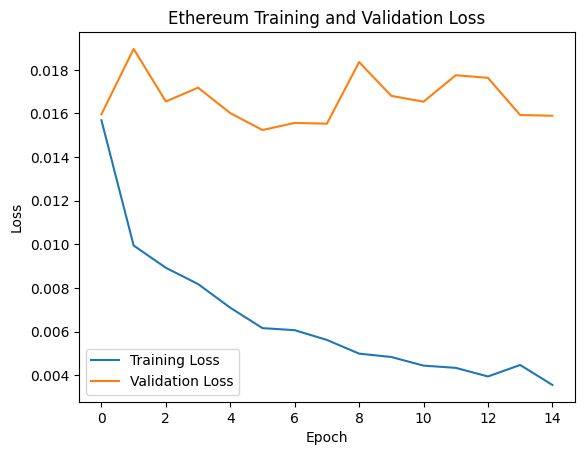

536/536 [==============================] - 8s 12ms/step
Ethereum Training Set:
RMSE: 293.13
MSE: 85923.98
MAE: 178.11
R2: 0.91


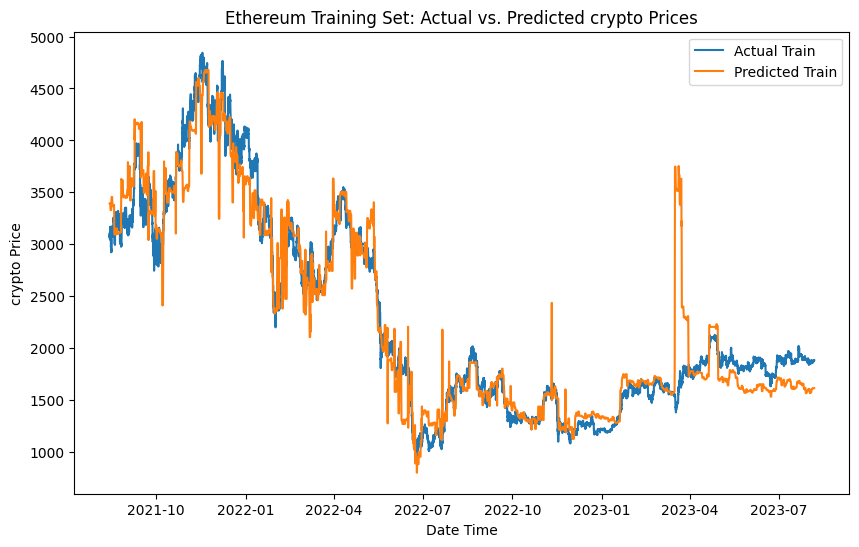

5/5 [==============================] - 0s 15ms/step
Ethereum Test Set:
RMSE: 242.35
MSE: 58733.93
MAE: 241.73
R2: -240.82


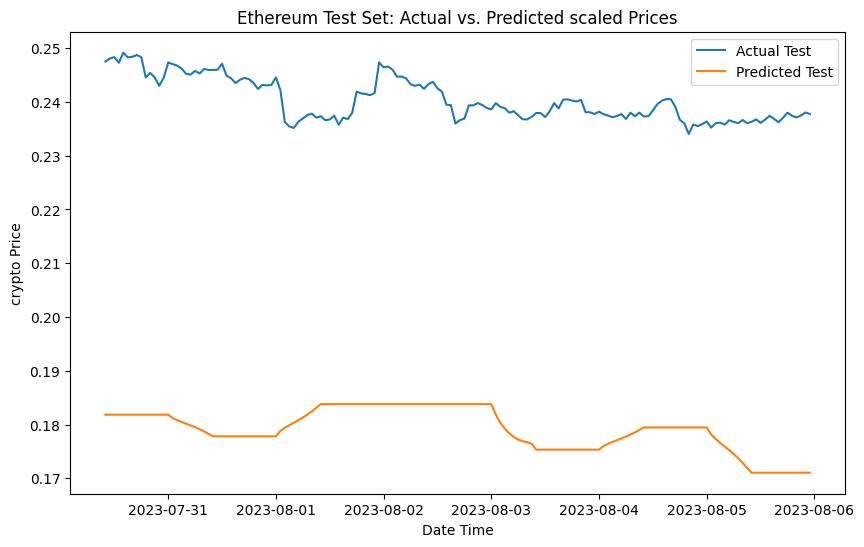

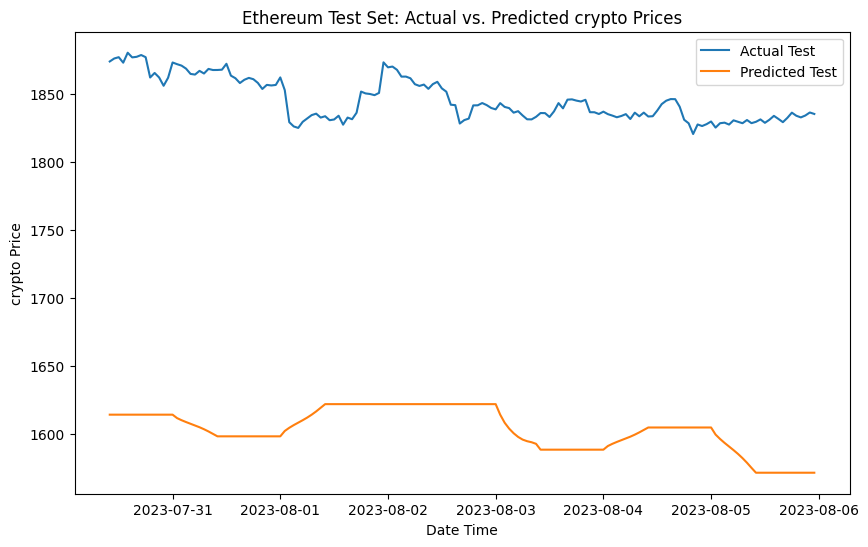

In [ ]:
# Replace with your actual data and parameters
data = df_eth
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = 42
num_epochs = 15
batch_size = 32
sequence_length = 10
apply_bi_lstm_sequences(data,'Ethereum', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


#Binance

In [ ]:
df_bnb.set_index('Date', inplace=True)

##ARIMA

###Check stationarity


> The P value below is >0.05 which means we cannot reject null hypothesis and the data is not stationary.



ADF Statistic: -1.6125425159866296
p-value: 0.4766410714519613
Critical Values: {'1%': -3.4307286194289484, '5%': -2.861707335026192, '10%': -2.5668590681147583}


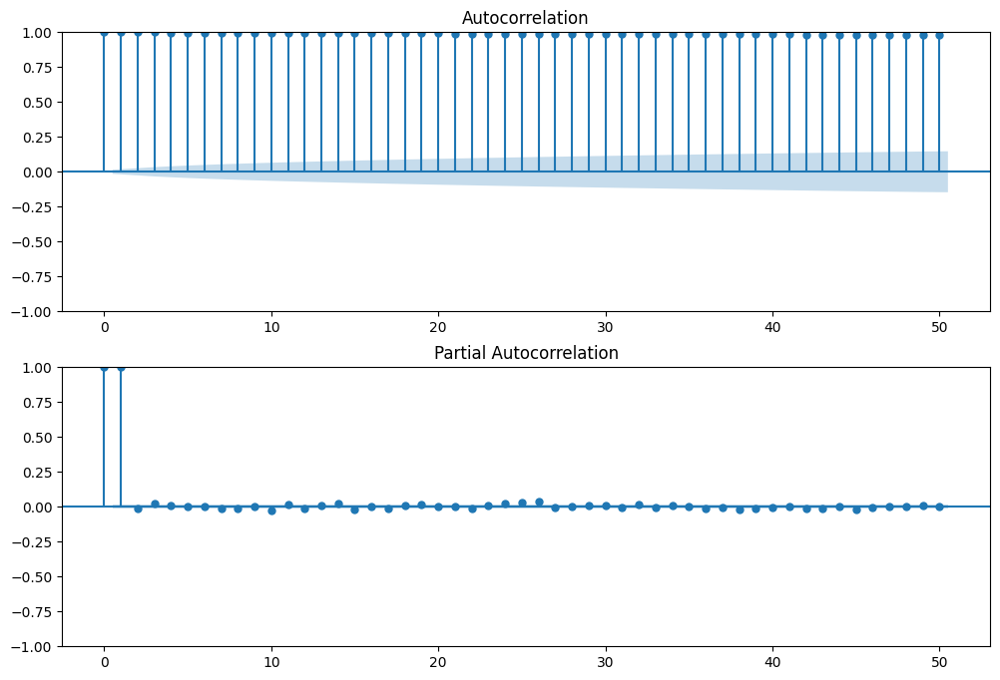

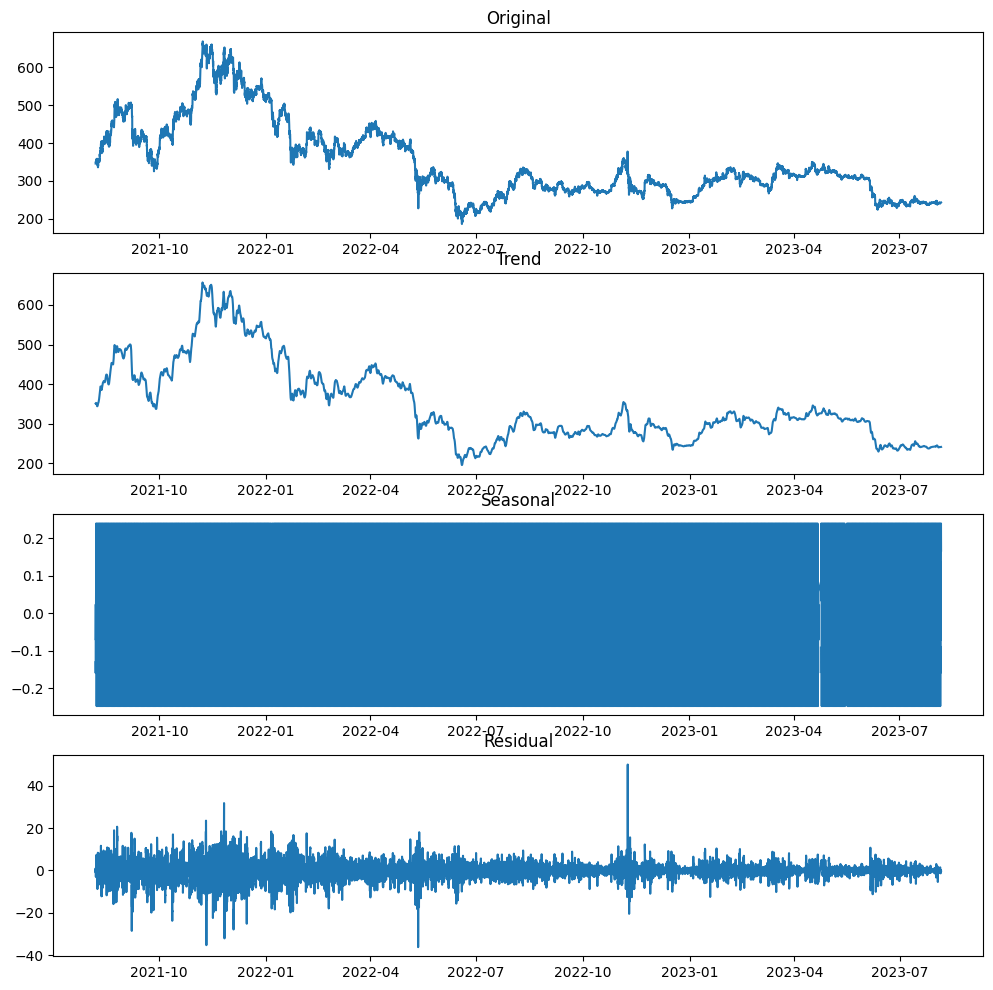

In [ ]:
check_stationarity(df_bnb['Close'])

###Seasonal differencing


> p value is less than 0.05 indicating that data is stationary and can reject null hypothesis.



box_diff_seasonal_1 p value = 0.000000
box_diff_seasonal_3 p value = 0.000000
box_diff_seasonal_6 p value = 0.000000
box_diff_seasonal_12 p value = 0.000000
box_diff_seasonal_24 p value = 0.000000
box_diff_seasonal_168 p value = 0.000000
box_diff_seasonal_672 p value = 0.000125


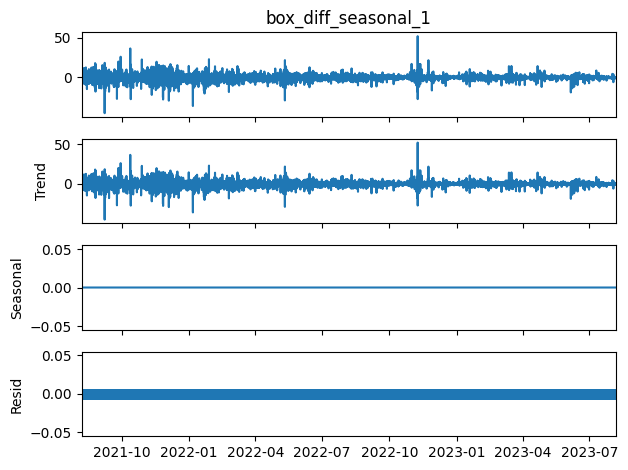

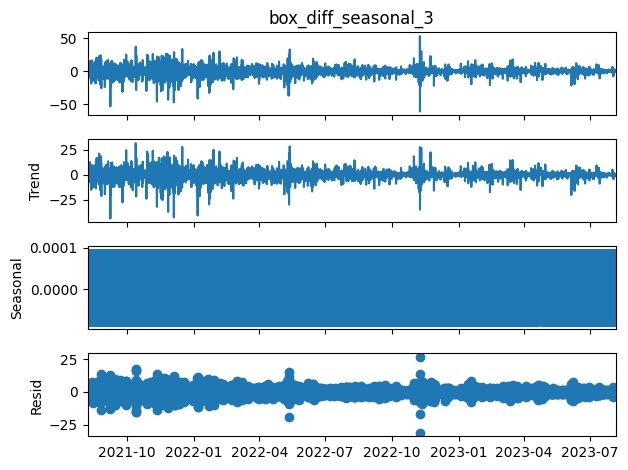

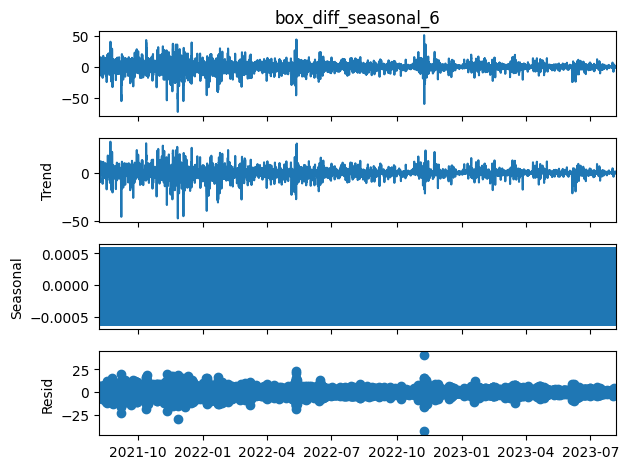

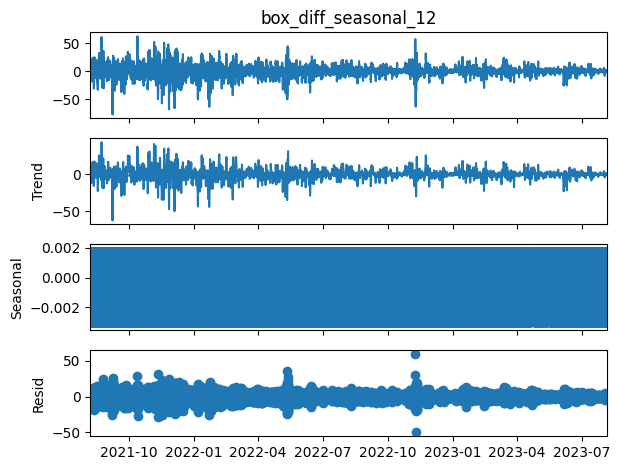

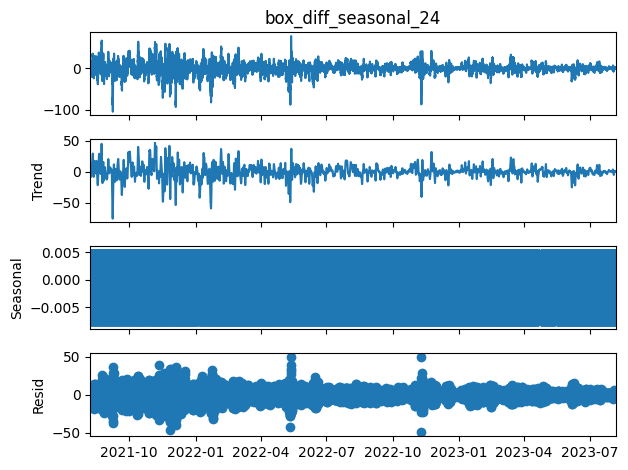

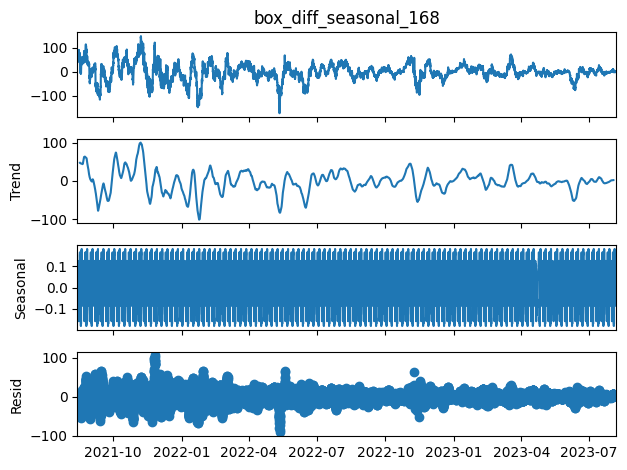

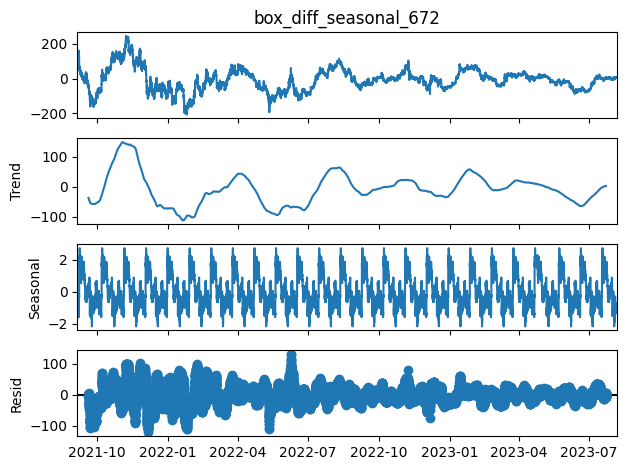

In [ ]:
Seasonal_diff(df_bnb)

###Fine tune ARIMA

In [ ]:
df =df_bnb
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))

ts=df['box_diff_seasonal_1'][1:]

test_data = ts.iloc[-168:]

# The remaining data is the training data
train_data = ts.iloc[:-168]

model = auto_arima(train_data, seasonal=True, stepwise=True, suppress_warnings=True, error_action="ignore")

# Print the summary of the best model
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                17150
Model:               SARIMAX(0, 0, 2)   Log Likelihood              -41921.237
Date:                Tue, 17 Oct 2023   AIC                          83848.473
Time:                        11:29:16   BIC                          83871.723
Sample:                             0   HQIC                         83856.137
                              - 17150                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.0110      0.003      3.488      0.000       0.005       0.017
ma.L2         -0.0251      0.004     -6.684      0.000      -0.032      -0.018
sigma2         7.7748      0.023    342.224      0.0

###7 Day Forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

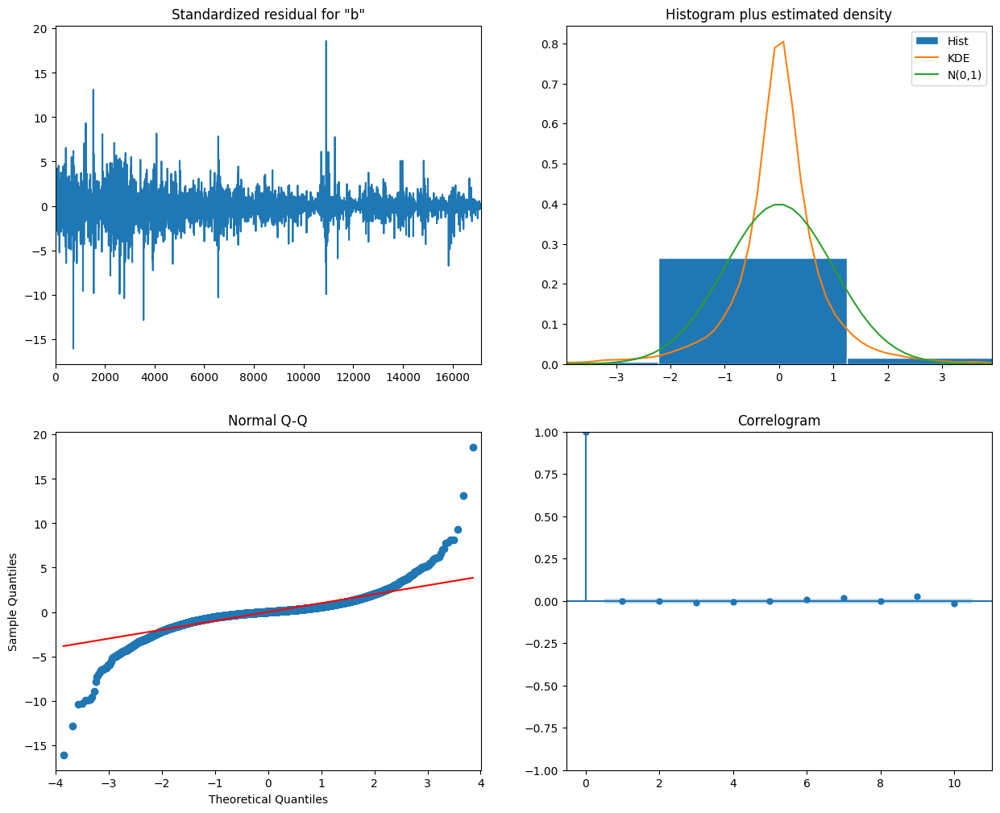

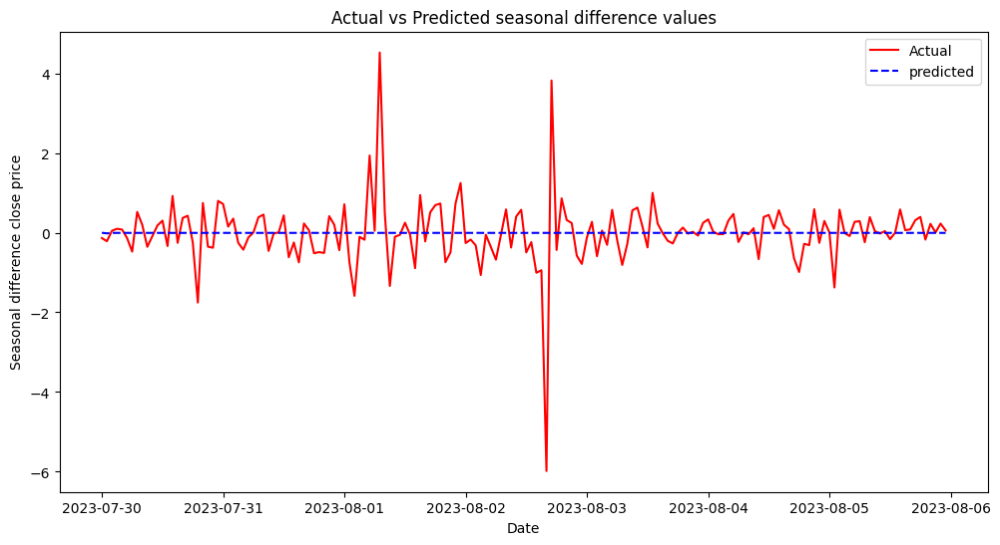

Mean Absolute Error (MAE): 0.4627732456946175
Mean Squared Error (MSE): 0.6841647622143306
Root Mean Squared Error (RMSE): 0.827142528355501
R2 score: -6.137924719840093e-05


In [ ]:
p,d,q =0,0,2
df =df_bnb
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
df_forecast = arima_forecast(df['box_diff_seasonal_1'],7)

In [ ]:

df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

In [ ]:
evaluation_metrics(merged_df)

Mean Absolute Error (MAE): 1.3377888474118478
Mean Squared Error (MSE): 3.3548741742590074
Root Mean Squared Error (RMSE): 1.8316315607291243
R2 score: 0.027238289565128193


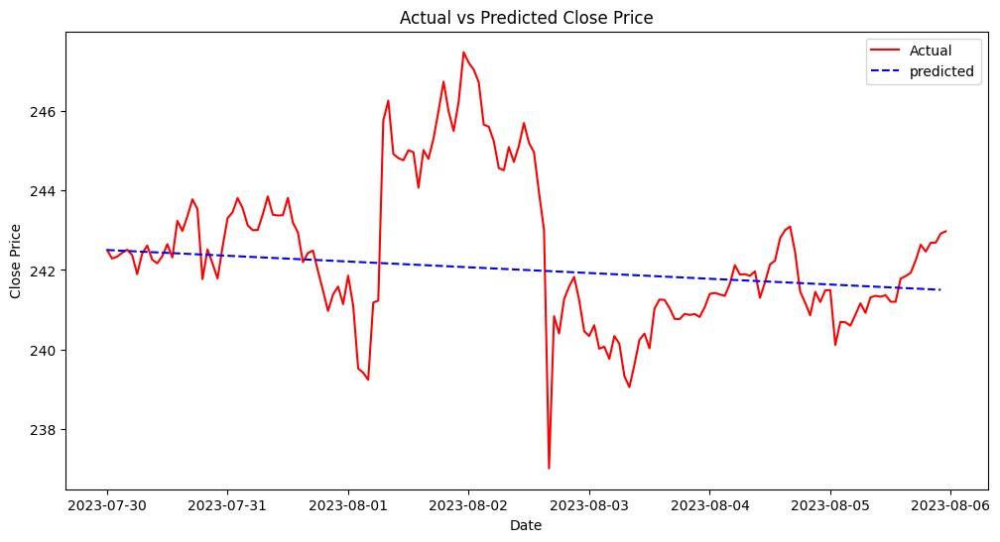

In [ ]:
actual_predicted_plot(merged_df)

##SARIMAX

####Fine tune sarimax

In [ ]:


# Define parameter ranges
p_values = range(0, 3)
d_values = range(0, 2)
q_values = range(0, 3)
P_values = range(0, 3)
D_values = range(0, 2)
Q_values = range(0, 3)
s = 7  # Seasonal period

data = df['box_diff_seasonal_1'][:500]
# Split data into training, validation, and test sets
train_size = int(len(data) * 0.6)
valid_size = int(len(data) * 0.2)
train_data = data[:train_size]
valid_data = data[train_size:train_size + valid_size]
test_data = data[train_size + valid_size:]

best_model = None
best_mse = float('inf')

# Grid search over parameter combinations
for p, d, q, P, D, Q in product(p_values, d_values, q_values, P_values, D_values, Q_values):
    try:
        model = sm.tsa.SARIMAX(train_data, order=(p, d, q), seasonal_order=(P, D, Q, s))
        results = model.fit()
        forecast = results.forecast(steps=len(valid_data))
        mse = mean_squared_error(valid_data, forecast)

        if mse < best_mse:
            best_mse = mse
            best_model = model

    except Exception as e:
        continue

# Fit the best model on the entire training set
final_model = best_model.fit()

# Evaluate on the test set
forecast_test = final_model.forecast(steps=len(test_data))
mse_test = mean_squared_error(test_data, forecast_test)

print("Best SARIMA Model Parameters:", best_model.order, best_model.seasonal_order)
print("Validation MSE:", best_mse)
print("Test MSE:", mse_test)




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/

Best SARIMA Model Parameters: (1, 1, 2) (2, 0, 2, 7)
Validation MSE: 17.13463401269653
Test MSE: 24.08307192890951


/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


###7Day forecast Greed index

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


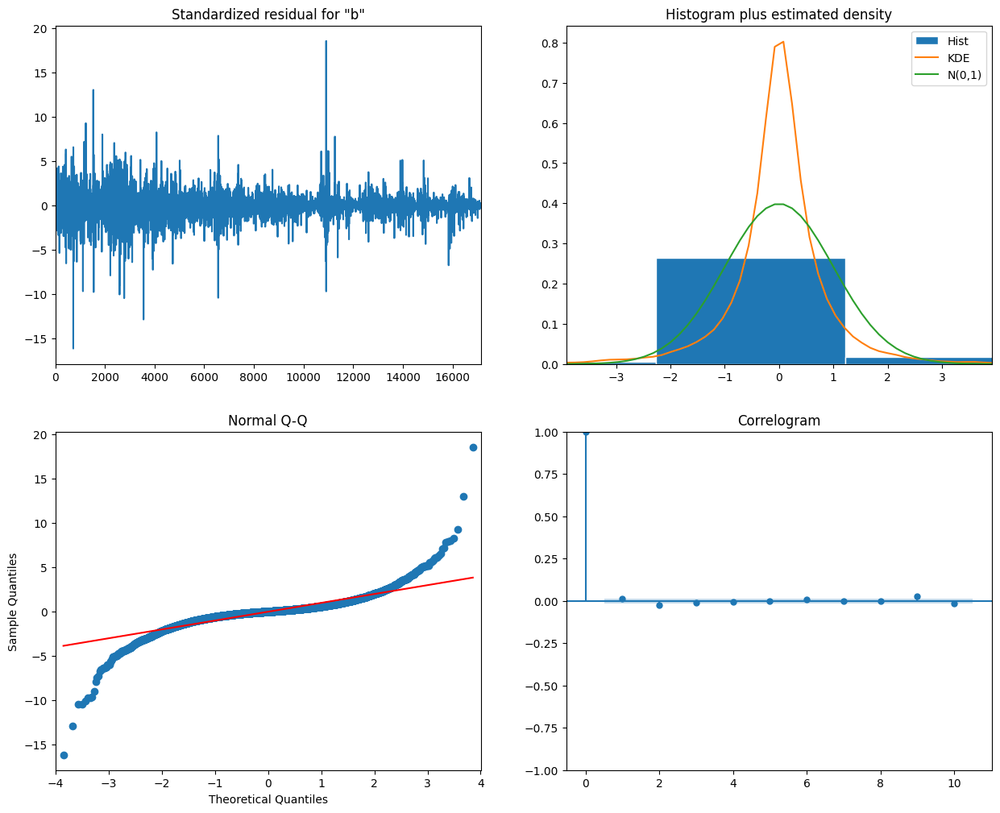

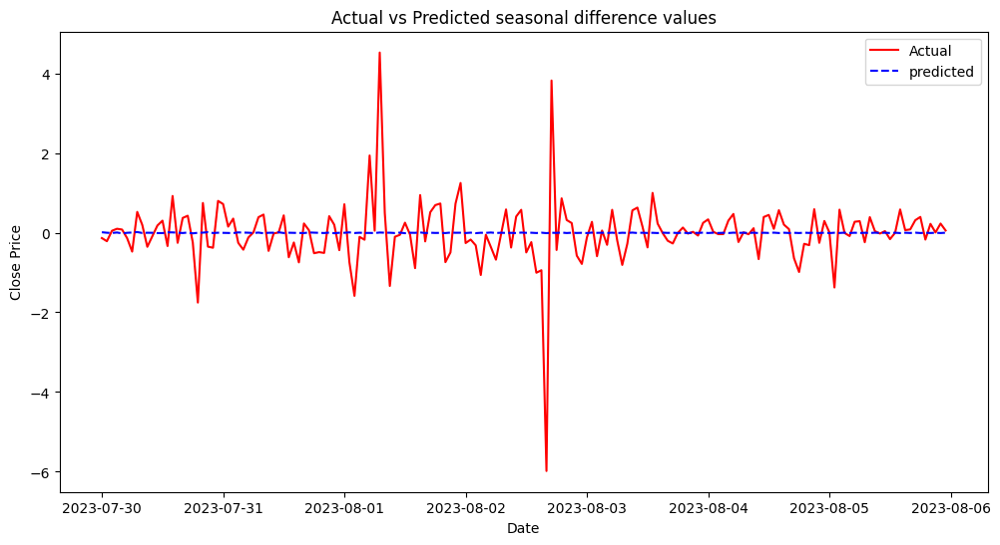

Mean Absolute Error (MAE): 0.46285437086944353
Mean Squared Error (MSE): 0.6830270235913738
Root Mean Squared Error (RMSE): 0.8264544897278819
R2 score: 0.0016016828093952107


In [ ]:
p, d, q = 1, 1, 2  # Non-seasonal order
P, D, Q, s = 2, 0, 2, 7  # Seasonal order with daily seasonality


days=7
exog = df['value']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,242.499481,-0.135696,242.499481,242.499481
2023-07-30 01:00:00,242.284531,-0.214951,-0.008481,242.491000
2023-07-30 02:00:00,242.331940,0.047409,0.004059,242.495059
2023-07-30 03:00:00,242.429626,0.097687,-0.019279,242.475780
2023-07-30 04:00:00,242.507492,0.077866,-0.003602,242.472178
2023-07-30 05:00:00,242.369675,-0.137817,0.003383,242.475562
2023-07-30 06:00:00,241.893997,-0.475677,0.015229,242.490790
2023-07-30 07:00:00,242.415085,0.521088,-0.008437,242.482353
2023-07-30 08:00:00,242.609970,0.194885,-0.002035,242.480318


Mean Absolute Error (MAE): 1.361441597679366
Mean Squared Error (MSE): 3.279132003588629
Root Mean Squared Error (RMSE): 1.8108373763506842
R2 score: 0.04920009190593899


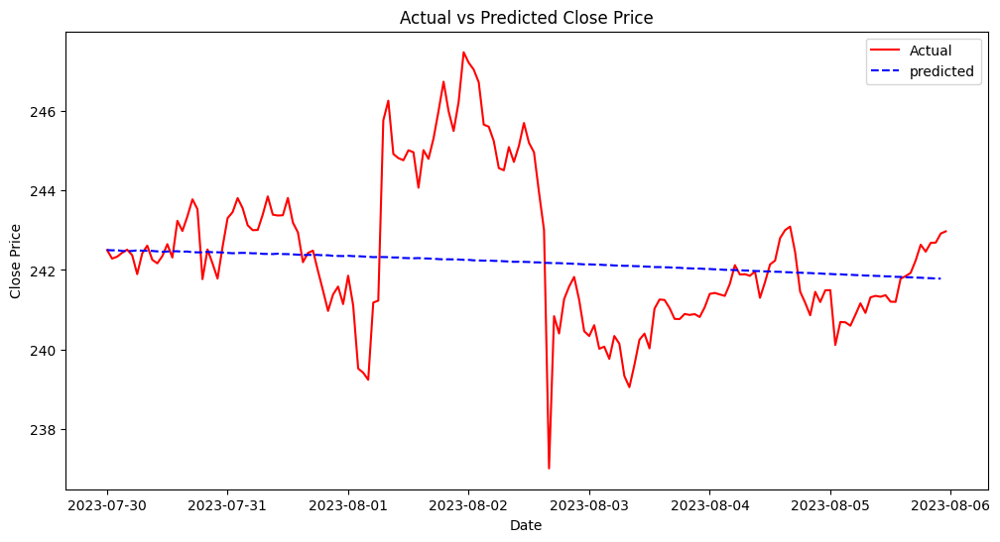

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

###7Day forecast greed and whale transaction

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

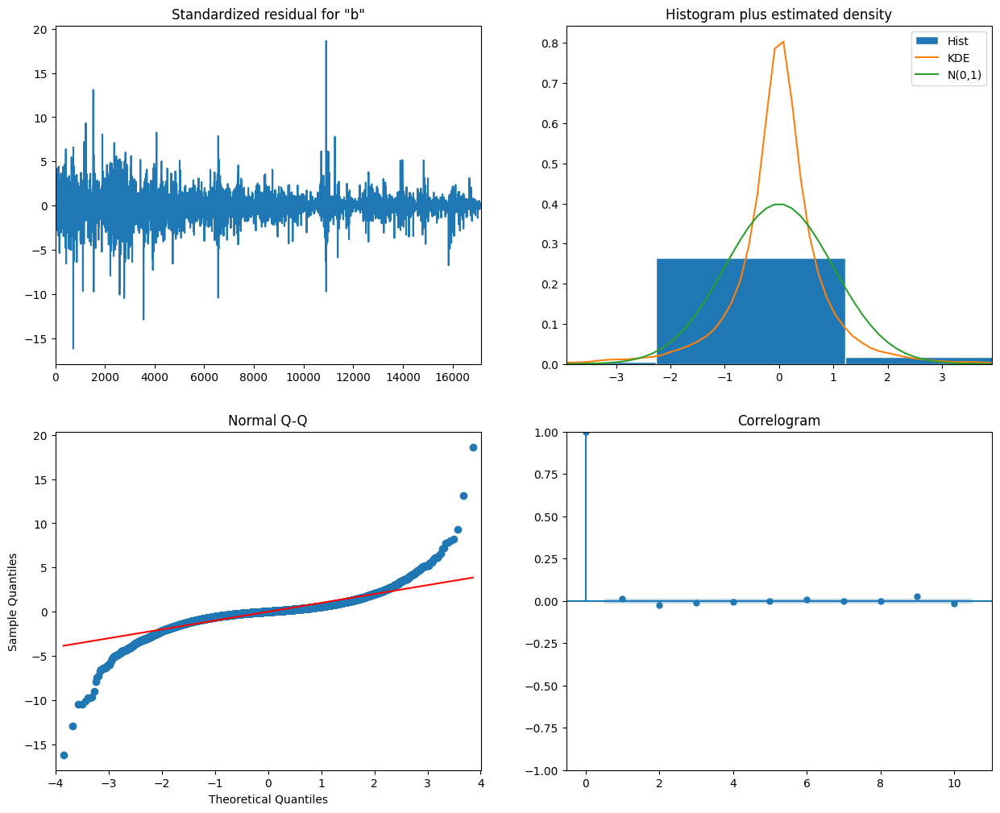

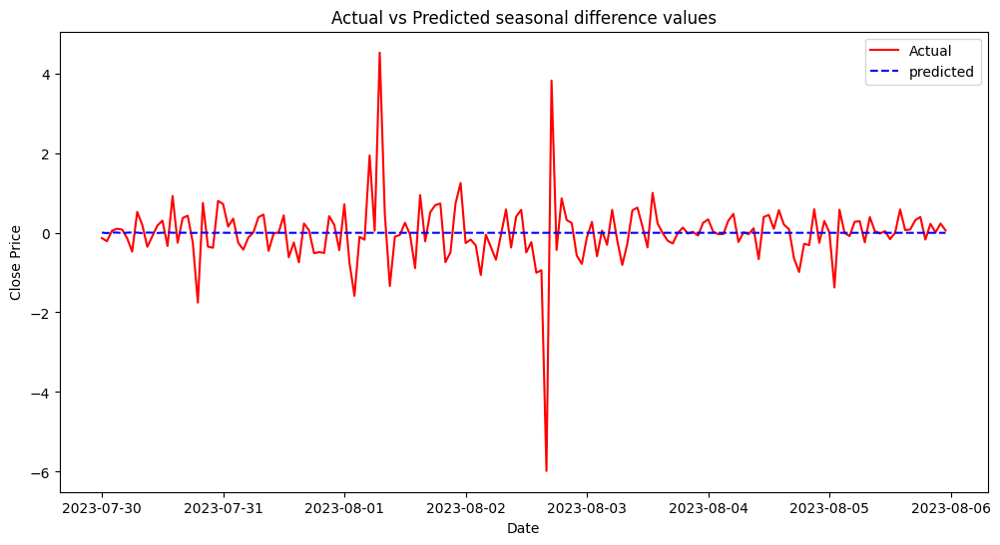

Mean Absolute Error (MAE): 0.46289165882972694
Mean Squared Error (MSE): 0.6841728882249959
Root Mean Squared Error (RMSE): 0.827147440439125
R2 score: -7.32572477657456e-05


In [ ]:
df['Whale Transaction Count (>100k USD'].fillna(value=df['Whale Transaction Count (>100k USD'].mean(), inplace=True)
df['Whale Transaction Count (>1m USD)'].fillna(value=df['Whale Transaction Count (>1m USD)'].mean(), inplace=True)
exog = df[['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]

merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions
merged_df.head(50)

,Close,box_diff_seasonal_1,Forecasted Close,cumulative_sum_close
Date,,,,
2023-07-30 00:00:00,242.499481,-0.135696,242.499481,242.499481
2023-07-30 01:00:00,242.284531,-0.214951,0.003863,242.503345
2023-07-30 02:00:00,242.331940,0.047409,0.002308,242.505652
2023-07-30 03:00:00,242.429626,0.097687,-0.010805,242.494847
2023-07-30 04:00:00,242.507492,0.077866,-0.001041,242.493805
2023-07-30 05:00:00,242.369675,-0.137817,0.005710,242.499516
2023-07-30 06:00:00,241.893997,-0.475677,0.000471,242.499986
2023-07-30 07:00:00,242.415085,0.521088,-0.011480,242.488506
2023-07-30 08:00:00,242.609970,0.194885,0.002671,242.491177


Mean Absolute Error (MAE): 1.36904903517491
Mean Squared Error (MSE): 3.2961916716126756
Root Mean Squared Error (RMSE): 1.81554170197566
R2 score: 0.044253560088486354


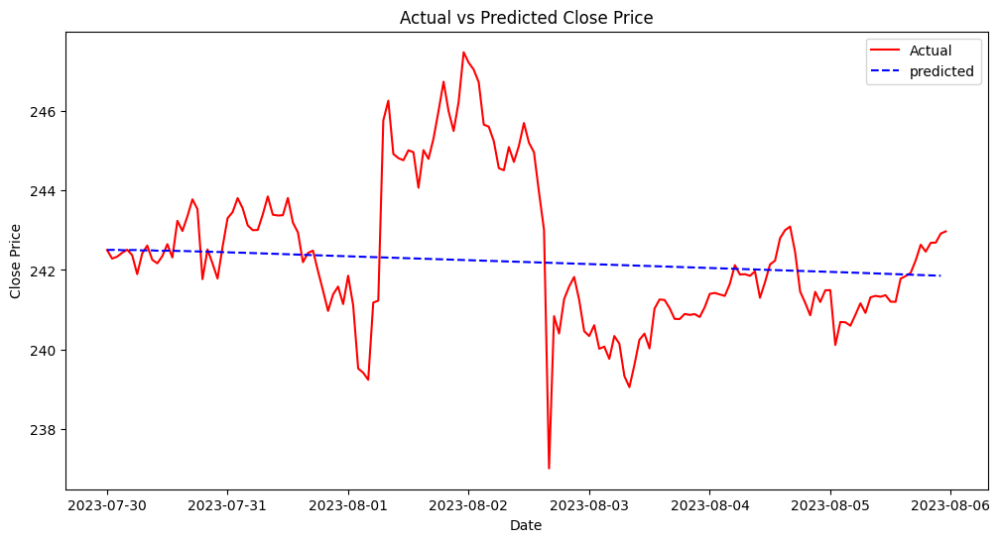

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

##LSTM

###7 Day prediction greed

Epoch 1/15
429/429 [==============================] - 15s 23ms/step - loss: 0.0377 - val_loss: 0.0705
Epoch 2/15
429/429 [==============================] - 10s 23ms/step - loss: 0.0363 - val_loss: 0.1202
Epoch 3/15
429/429 [==============================] - 7s 16ms/step - loss: 0.0362 - val_loss: 0.0681
Epoch 4/15
429/429 [==============================] - 10s 24ms/step - loss: 0.0360 - val_loss: 0.0716
Epoch 5/15
429/429 [==============================] - 9s 22ms/step - loss: 0.0359 - val_loss: 0.0614
Epoch 6/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0350 - val_loss: 0.0518
Epoch 7/15
429/429 [==============================] - 13s 31ms/step - loss: 0.0343 - val_loss: 0.0419
Epoch 8/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0337 - val_loss: 0.0473
Epoch 9/15
429/429 [==============================] - 13s 30ms/step - loss: 0.0336 - val_loss: 0.0464
Epoch 10/15
429/429 [==============================] - 10s 23ms/step - loss: 0.0335 - 

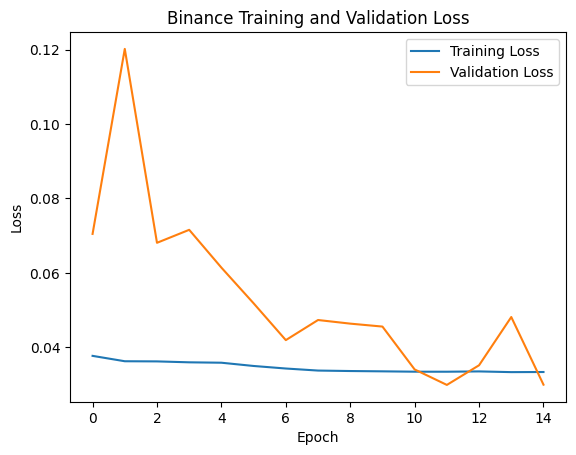

536/536 [==============================] - 4s 6ms/step
Binance Training Set:
RMSE: 86.69
MSE: 7515.06
MAE: 70.70
R2 score: 0.24


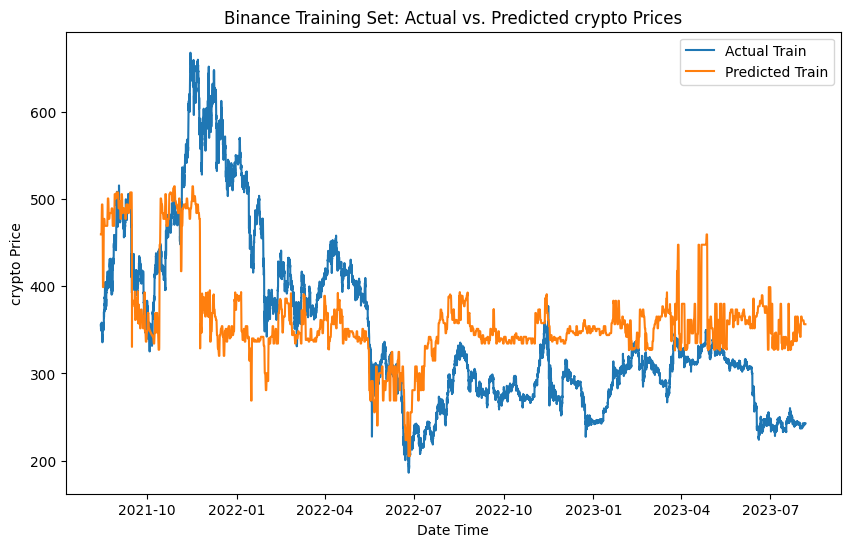

5/5 [==============================] - 0s 7ms/step
Binance Test Set:
RMSE: 113.66
MSE: 12918.07
MAE: 113.48
test R2 score: -3564.47


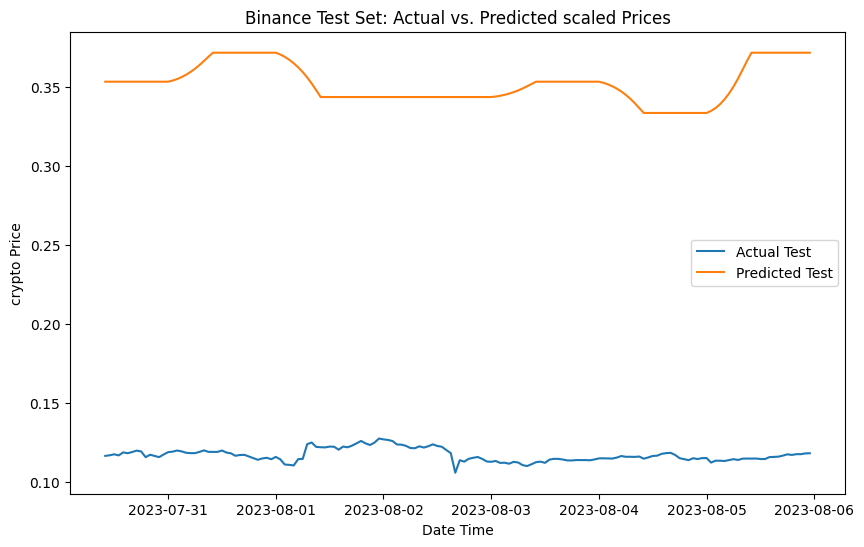

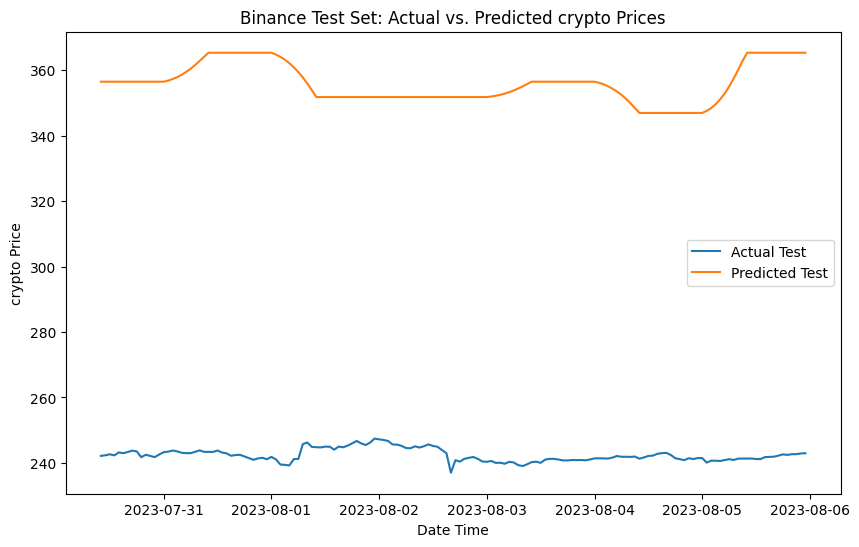

In [ ]:
data = df_bnb
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Binance', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

### Whale trasaction and fear and greed

Epoch 1/15
429/429 [==============================] - 17s 25ms/step - loss: 0.0138 - val_loss: 0.0139
Epoch 2/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0106 - val_loss: 0.0156
Epoch 3/15
429/429 [==============================] - 12s 28ms/step - loss: 0.0100 - val_loss: 0.0176
Epoch 4/15
429/429 [==============================] - 7s 16ms/step - loss: 0.0097 - val_loss: 0.0244
Epoch 5/15
429/429 [==============================] - 9s 22ms/step - loss: 0.0093 - val_loss: 0.0268
Epoch 6/15
429/429 [==============================] - 10s 24ms/step - loss: 0.0089 - val_loss: 0.0231
Epoch 7/15
429/429 [==============================] - 7s 16ms/step - loss: 0.0078 - val_loss: 0.0189
Epoch 8/15
429/429 [==============================] - 11s 26ms/step - loss: 0.0067 - val_loss: 0.0260
Epoch 9/15
429/429 [==============================] - 8s 19ms/step - loss: 0.0060 - val_loss: 0.0168
Epoch 10/15
429/429 [==============================] - 8s 18ms/step - loss: 0.0052 - va

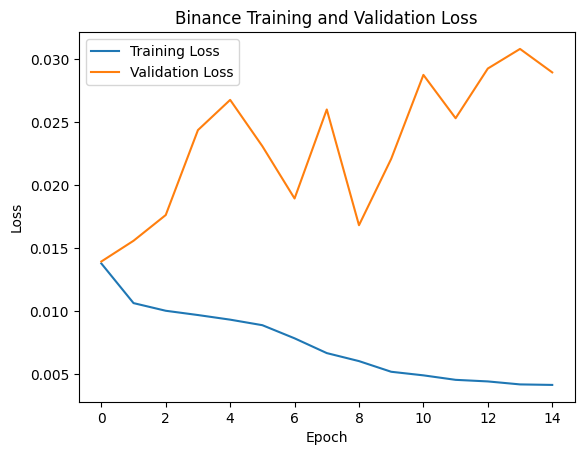

536/536 [==============================] - 5s 7ms/step
Binance Training Set:
RMSE: 44.93
MSE: 2018.78
MAE: 26.20
R2 score: 0.80


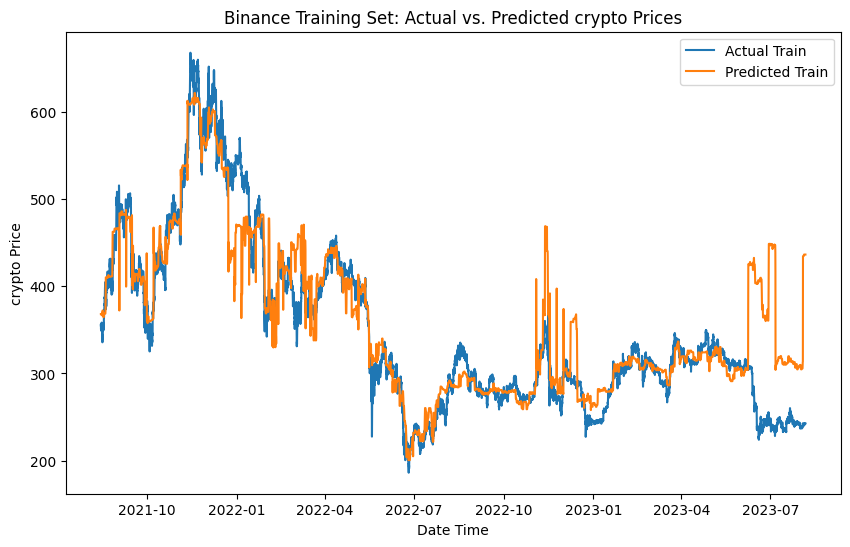

5/5 [==============================] - 0s 6ms/step
Binance Test Set:
RMSE: 194.28
MSE: 37744.46
MAE: 194.26
test R2 score: -10416.71


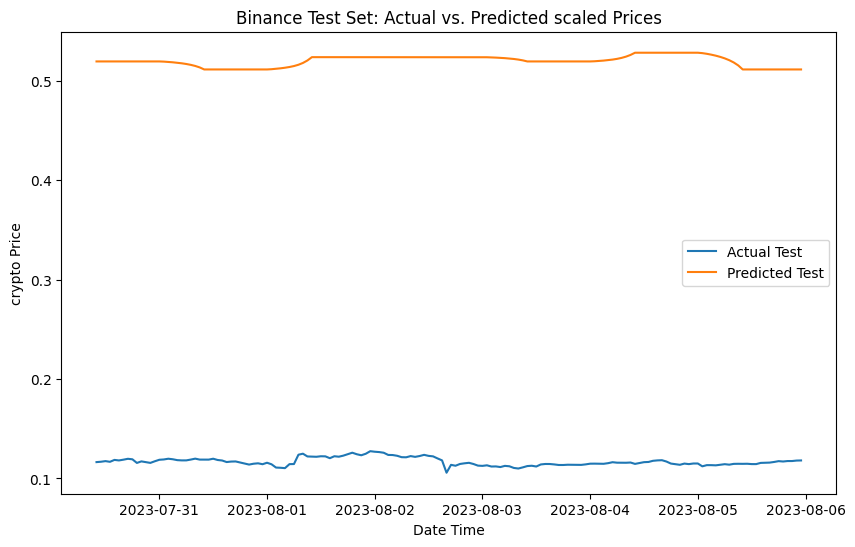

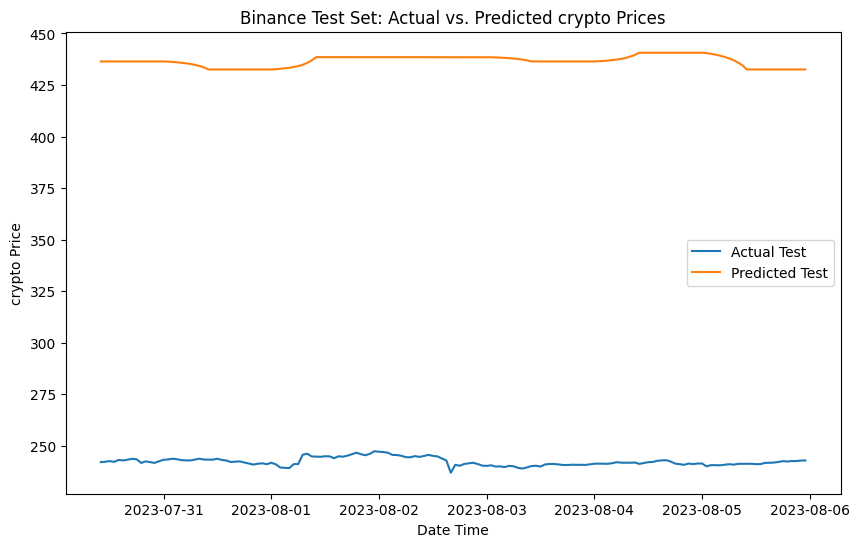

In [ ]:

data = df_bnb
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Binance', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

##Bi-LSTM

####7 Day Prediction using greed

Epoch 1/15
429/429 [==============================] - 29s 46ms/step - loss: 0.0374 - val_loss: 0.0677
Epoch 2/15
429/429 [==============================] - 16s 37ms/step - loss: 0.0363 - val_loss: 0.0802
Epoch 3/15
429/429 [==============================] - 13s 31ms/step - loss: 0.0363 - val_loss: 0.0790
Epoch 4/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0361 - val_loss: 0.0629
Epoch 5/15
429/429 [==============================] - 15s 35ms/step - loss: 0.0362 - val_loss: 0.0637
Epoch 6/15
429/429 [==============================] - 14s 33ms/step - loss: 0.0361 - val_loss: 0.0708
Epoch 7/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0359 - val_loss: 0.0594
Epoch 8/15
429/429 [==============================] - 14s 33ms/step - loss: 0.0351 - val_loss: 0.0326
Epoch 9/15
429/429 [==============================] - 15s 35ms/step - loss: 0.0343 - val_loss: 0.0288
Epoch 10/15
429/429 [==============================] - 18s 42ms/step - loss: 0.033

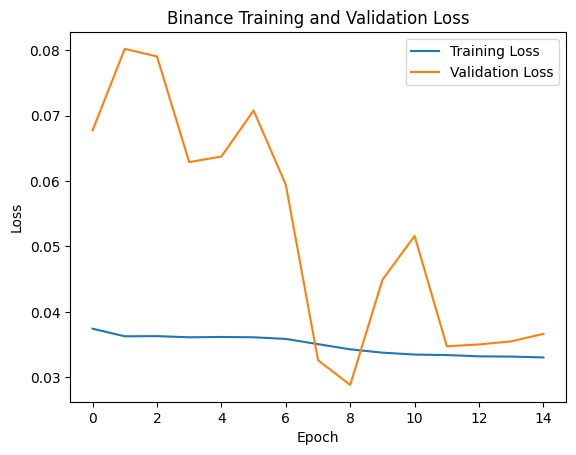

536/536 [==============================] - 7s 9ms/step
Binance Training Set:
RMSE: 88.35
MSE: 7804.91
MAE: 73.16
R2: 0.21


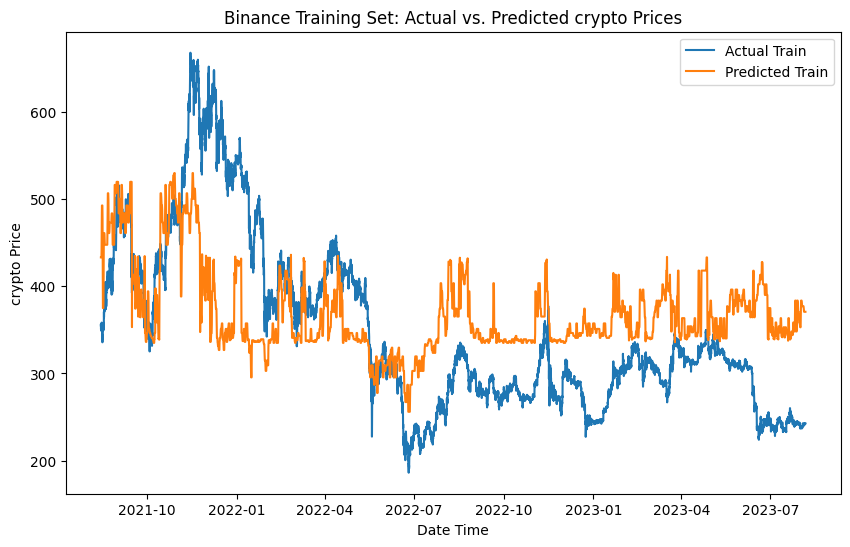

5/5 [==============================] - 0s 15ms/step
Binance Test Set:
RMSE: 128.20
MSE: 16434.78
MAE: 127.91
R2: -4535.10


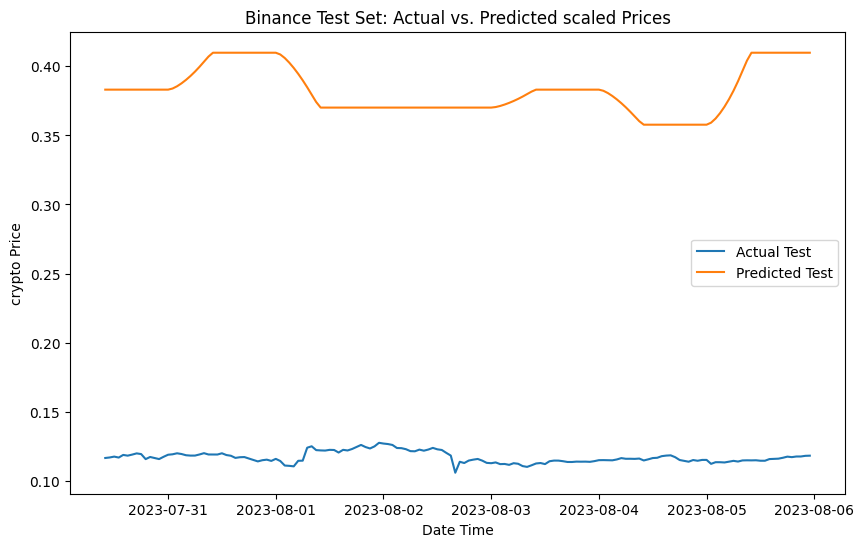

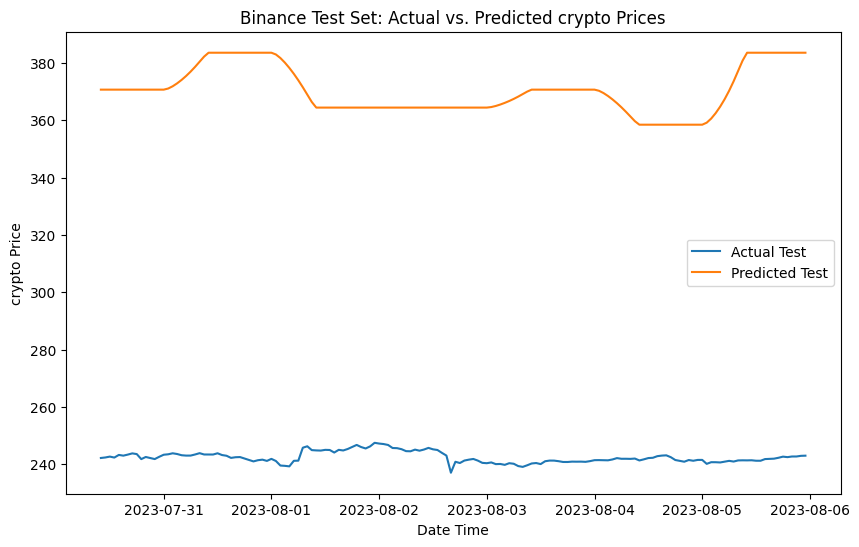

In [ ]:
data = df_bnb
features = ['value']
target = 'Close'
test_size = 168
random_state = 42
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_bi_lstm_sequences(data,'Binance', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


####Whale transaction and fear & greed

Epoch 1/15
429/429 [==============================] - 31s 46ms/step - loss: 0.0130 - val_loss: 0.0164
Epoch 2/15
429/429 [==============================] - 13s 30ms/step - loss: 0.0105 - val_loss: 0.0225
Epoch 3/15
429/429 [==============================] - 17s 39ms/step - loss: 0.0096 - val_loss: 0.0260
Epoch 4/15
429/429 [==============================] - 18s 42ms/step - loss: 0.0082 - val_loss: 0.0315
Epoch 5/15
429/429 [==============================] - 12s 29ms/step - loss: 0.0077 - val_loss: 0.0221
Epoch 6/15
429/429 [==============================] - 17s 40ms/step - loss: 0.0068 - val_loss: 0.0271
Epoch 7/15
429/429 [==============================] - 19s 45ms/step - loss: 0.0058 - val_loss: 0.0197
Epoch 8/15
429/429 [==============================] - 13s 30ms/step - loss: 0.0054 - val_loss: 0.0291
Epoch 9/15
429/429 [==============================] - 25s 59ms/step - loss: 0.0048 - val_loss: 0.0287
Epoch 10/15
429/429 [==============================] - 34s 80ms/step - loss: 0.004

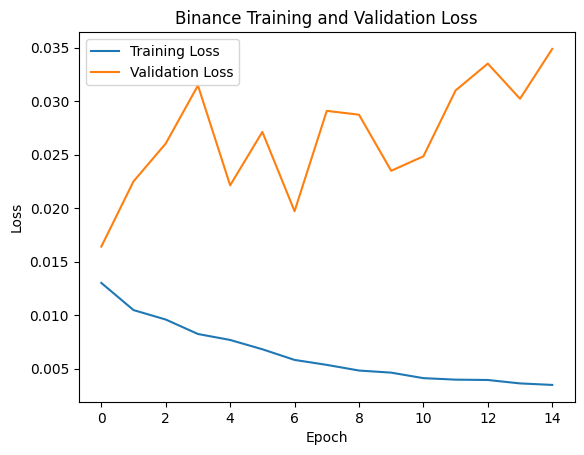

536/536 [==============================] - 6s 8ms/step
Binance Training Set:
RMSE: 48.23
MSE: 2326.36
MAE: 28.40
R2: 0.76


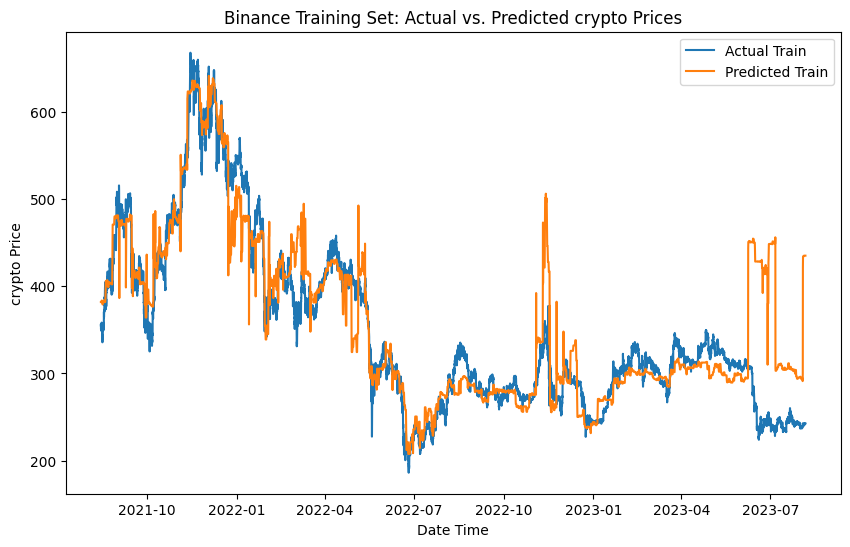

5/5 [==============================] - 0s 8ms/step
Binance Test Set:
RMSE: 192.78
MSE: 37164.33
MAE: 192.77
R2: -10256.59


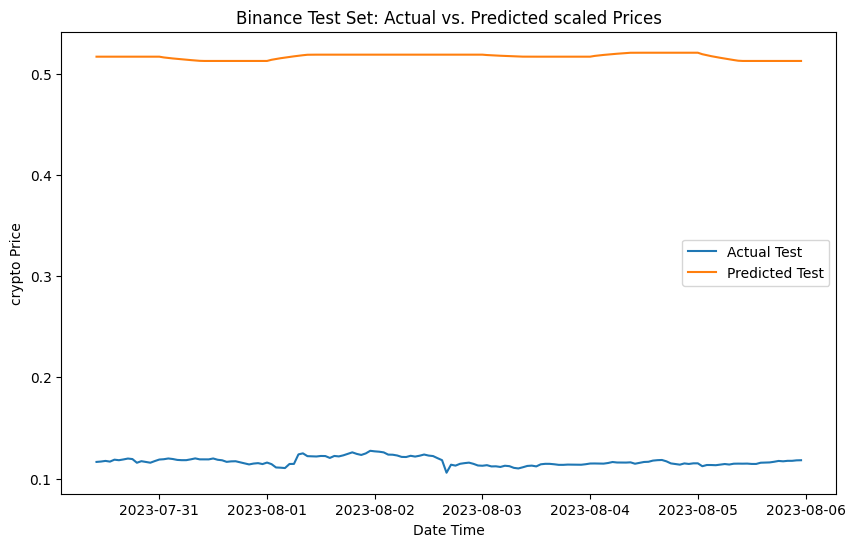

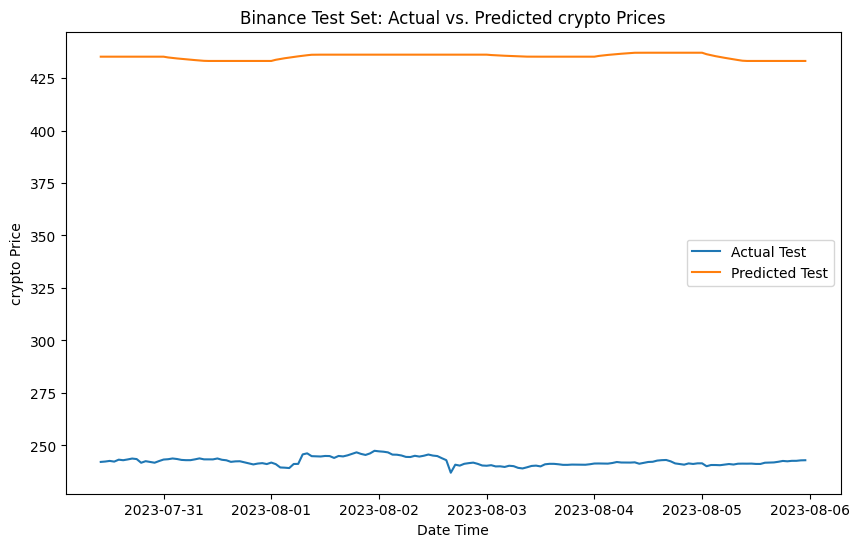

In [ ]:

data = df_bnb
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10
apply_bi_lstm_sequences(data,'Binance', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


#Tether

In [ ]:
df_tether.set_index('Date', inplace=True)

##ARIMA

###Check stationarity

> The P value below is >0.05 which means we cannot reject null hypothesis and the data is not stationary.

ADF Statistic: -8.311087703678579
p-value: 3.787326582237995e-13
Critical Values: {'1%': -3.430728531762389, '5%': -2.861707296283461, '10%': -2.5668590474925734}


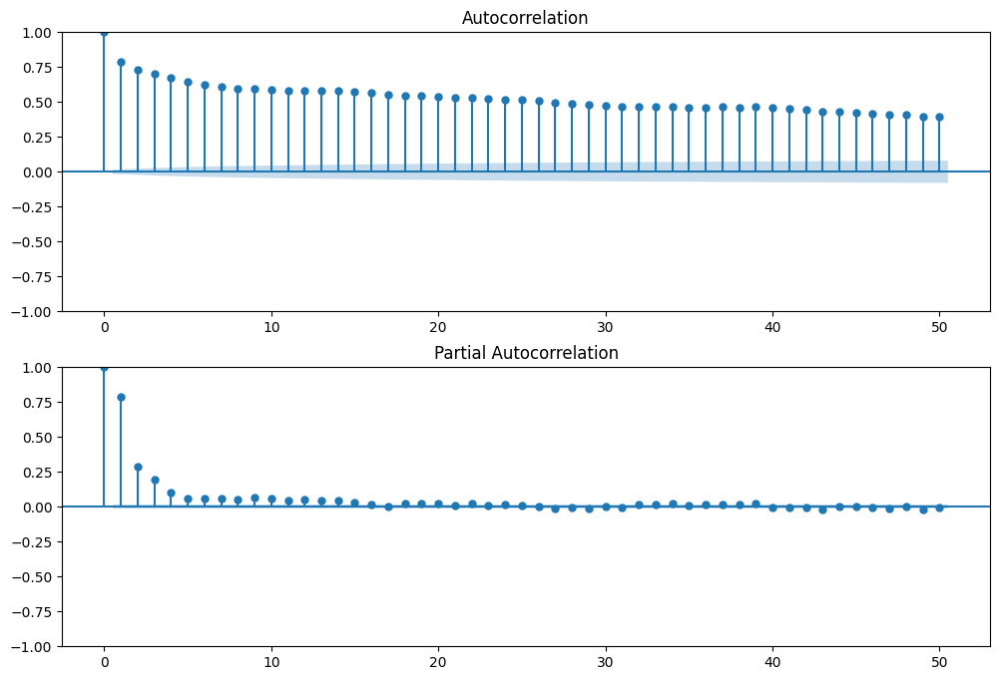

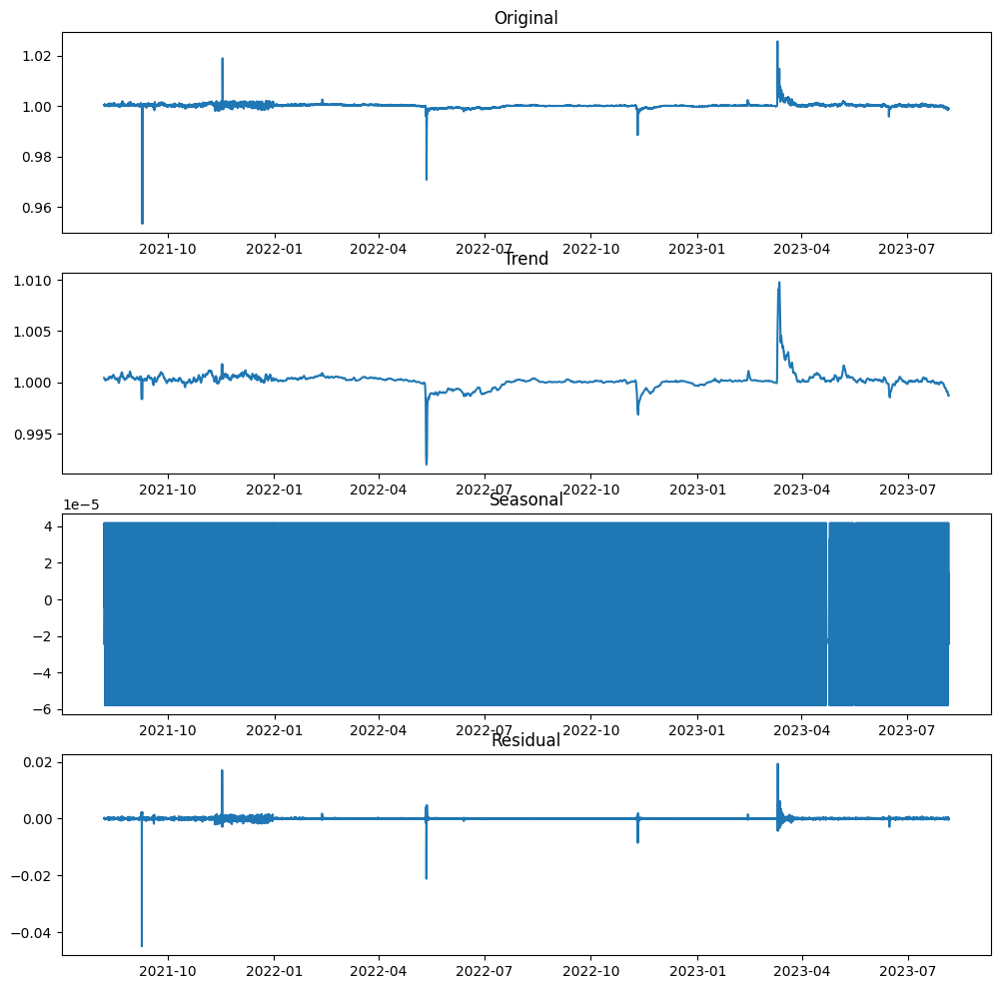

In [ ]:
check_stationarity(df_tether['Close'])

###Seasonal differencing
> p value is less than 0.05 indicating that data is stationary and can reject null hypothesis.

box_diff_seasonal_1 p value = 0.000000
box_diff_seasonal_3 p value = 0.000000
box_diff_seasonal_6 p value = 0.000000
box_diff_seasonal_12 p value = 0.000000
box_diff_seasonal_24 p value = 0.000000
box_diff_seasonal_168 p value = 0.000000
box_diff_seasonal_672 p value = 0.000000


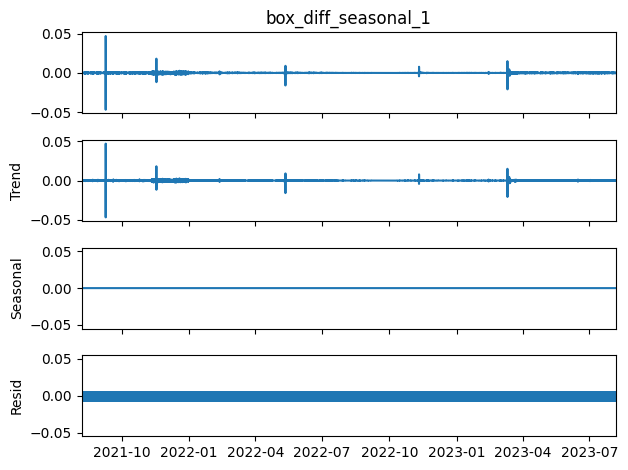

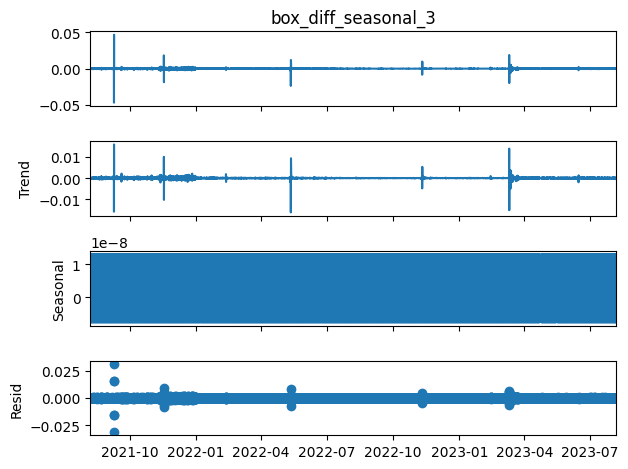

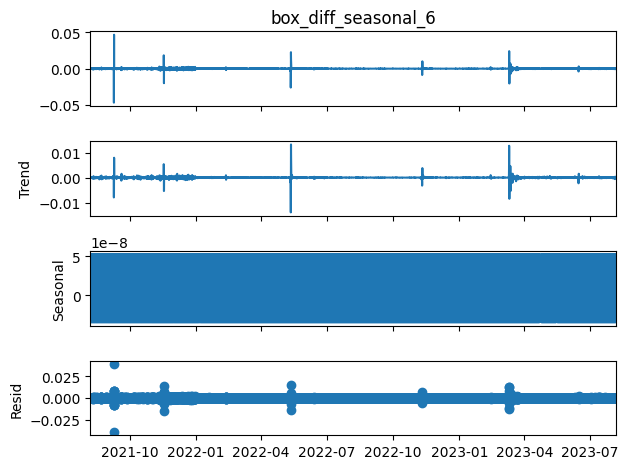

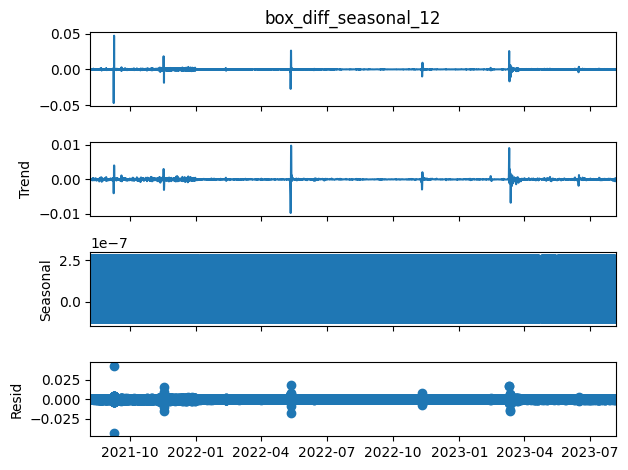

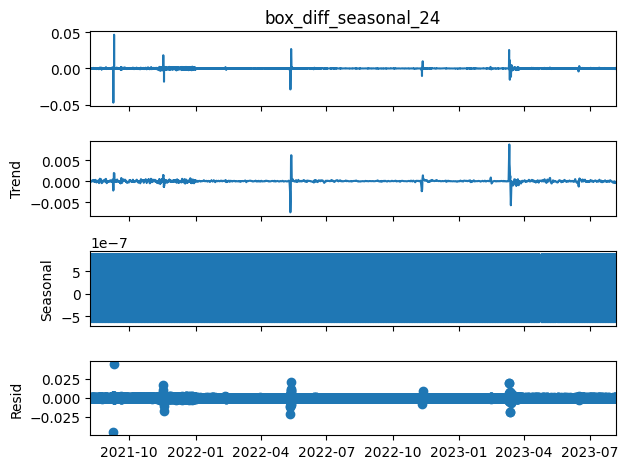

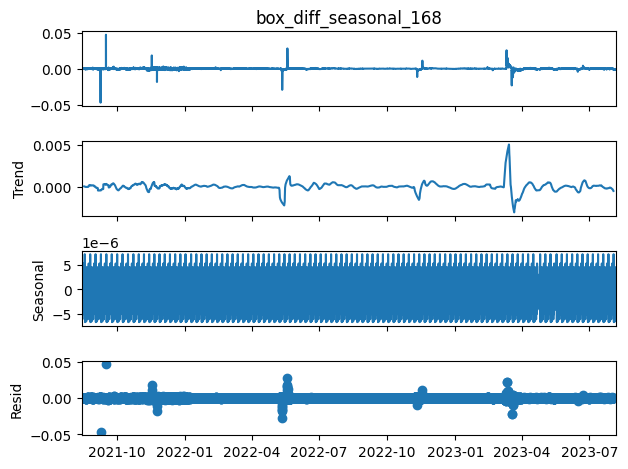

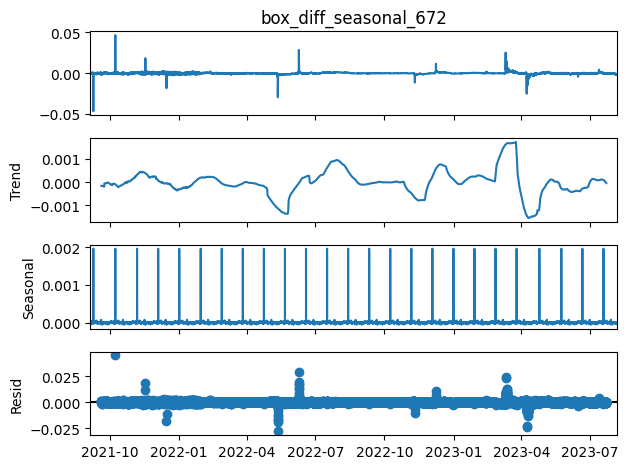

In [ ]:
Seasonal_diff(df_tether)

###Fine tune ARIMA

In [ ]:
df =df_tether
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))

ts=df['box_diff_seasonal_1'][1:]

test_data = ts.iloc[-168:]

# The remaining data is the training data
train_data = ts.iloc[:-168]

model = auto_arima(train_data, seasonal=True, stepwise=True, suppress_warnings=True, error_action="ignore")

# Print the summary of the best model
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                17148
Model:               SARIMAX(0, 0, 5)   Log Likelihood              103745.313
Date:                Wed, 18 Oct 2023   AIC                        -207476.627
Time:                        08:36:25   BIC                        -207422.379
Sample:                             0   HQIC                       -207458.746
                              - 17148                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -7.691e-08    1.4e-06     -0.055      0.956   -2.82e-06    2.67e-06
ma.L1         -0.5300      0.000  -1570.162      0.000      -0.531      -0.529
ma.L2         -0.1136      0.001   -136.818      0.0

###7 Day Forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

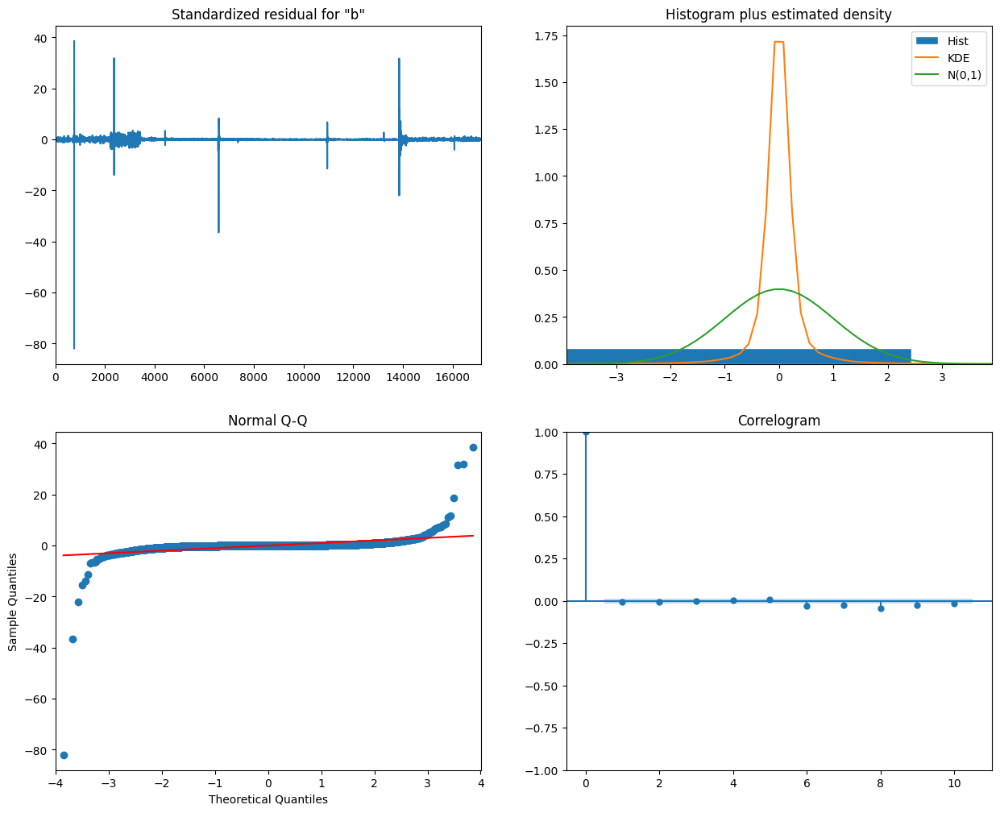

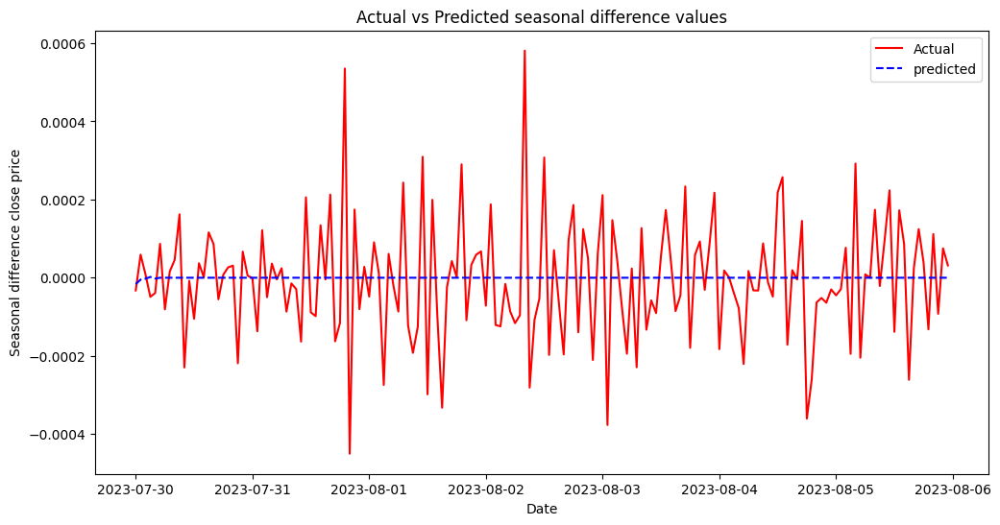

Mean Absolute Error (MAE): 0.00011484832831200678
Mean Squared Error (MSE): 2.3537378850557335e-08
Root Mean Squared Error (RMSE): 0.00015341896509414127
R2 score: -0.0016549956963665124


In [ ]:
p,d,q =0,0,5
df =df_tether
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
df_forecast = arima_forecast(df['box_diff_seasonal_1'],7)


In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions


Mean Absolute Error (MAE): 0.0005933283802380479
Mean Squared Error (MSE): 5.531904885667551e-07
Root Mean Squared Error (RMSE): 0.0007437677652108588
R2 score: -1.4619418212321342


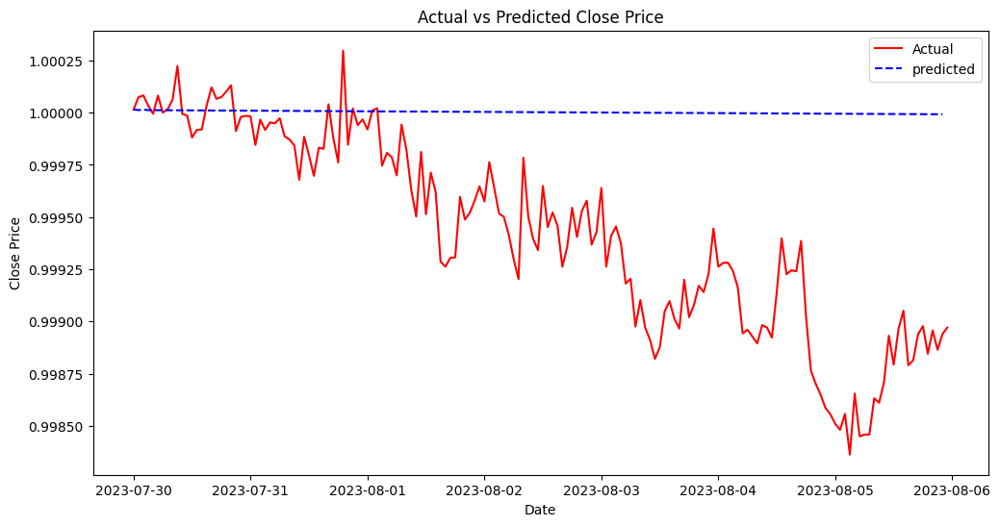

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)


##SARIMAX

####Fine tune sarimax

In [ ]:


# Define parameter ranges
p_values = range(0, 3)
d_values = range(0, 2)
q_values = range(0, 3)
P_values = range(0, 3)
D_values = range(0, 2)
Q_values = range(0, 3)
s = 7  # Seasonal period

data = df['box_diff_seasonal_1'][:500]
# Split data into training, validation, and test sets
train_size = int(len(data) * 0.6)
valid_size = int(len(data) * 0.2)
train_data = data[:train_size]
valid_data = data[train_size:train_size + valid_size]
test_data = data[train_size + valid_size:]

best_model = None
best_mse = float('inf')

# Grid search over parameter combinations
for p, d, q, P, D, Q in product(p_values, d_values, q_values, P_values, D_values, Q_values):
    try:
        model = sm.tsa.SARIMAX(train_data, order=(p, d, q), seasonal_order=(P, D, Q, s))
        results = model.fit()
        forecast = results.forecast(steps=len(valid_data))
        mse = mean_squared_error(valid_data, forecast)

        if mse < best_mse:
            best_mse = mse
            best_model = model

    except Exception as e:
        continue

# Fit the best model on the entire training set
final_model = best_model.fit()

# Evaluate on the test set
forecast_test = final_model.forecast(steps=len(test_data))
mse_test = mean_squared_error(test_data, forecast_test)

print("Best SARIMA Model Parameters:", best_model.order, best_model.seasonal_order)
print("Validation MSE:", best_mse)
print("Test MSE:", mse_test)




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

Best SARIMA Model Parameters: (1, 0, 1) (2, 0, 2, 7)
Validation MSE: 8.628378692547244e-08
Test MSE: 3.304324338817747e-08


/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


###7Day forecast Greed index

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

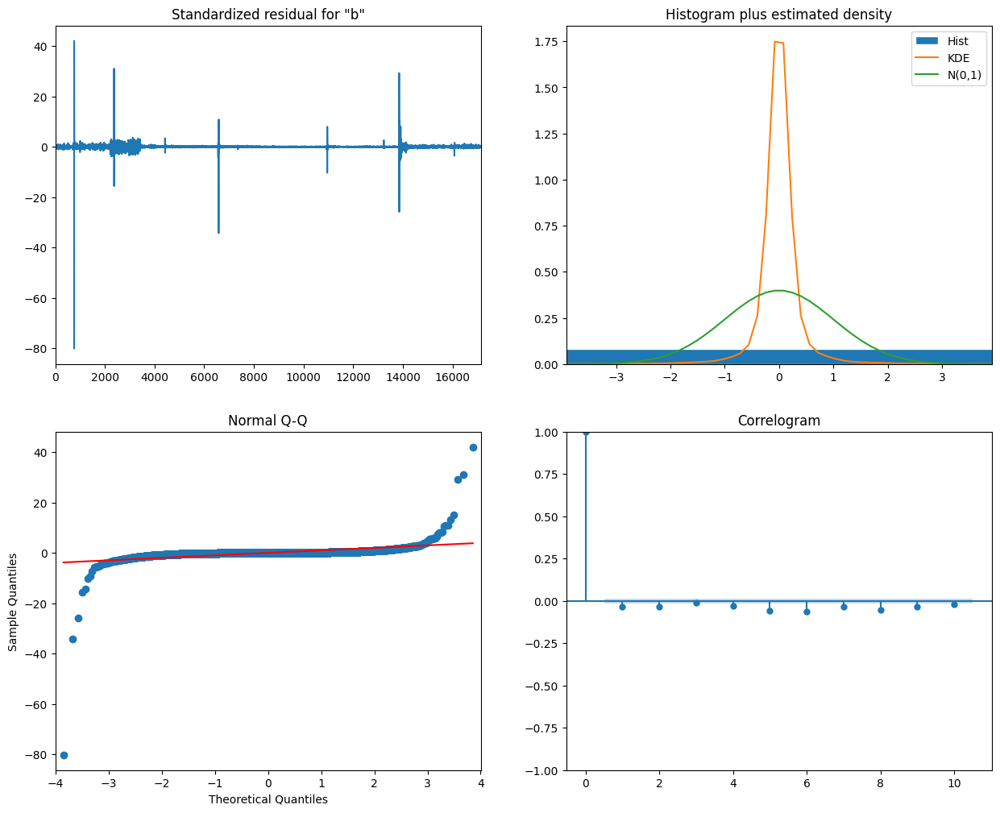

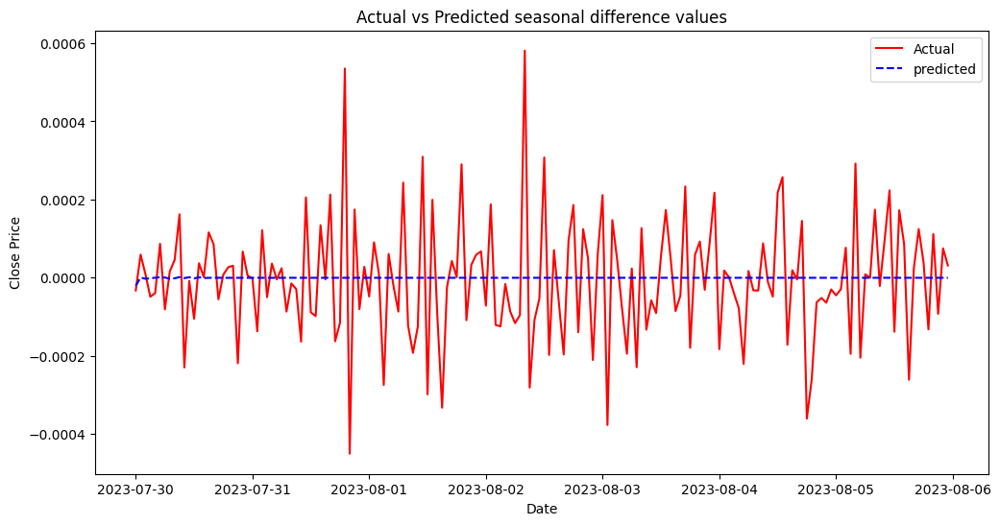

Mean Absolute Error (MAE): 0.00011476943807065982
Mean Squared Error (MSE): 2.3522016127981158e-08
Root Mean Squared Error (RMSE): 0.0001533688890485328
R2 score: -0.0010012207831262554


In [ ]:

p, d, q = 1, 0, 1  # Non-seasonal order
P, D, Q, s = 2, 0, 2, 7  # Seasonal order with daily seasonality


days=7
exog = df['value']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

Mean Absolute Error (MAE): 0.0005811098390769043
Mean Squared Error (MSE): 5.322087909154068e-07
Root Mean Squared Error (RMSE): 0.000729526415502144
R2 score: -1.3685640065445828


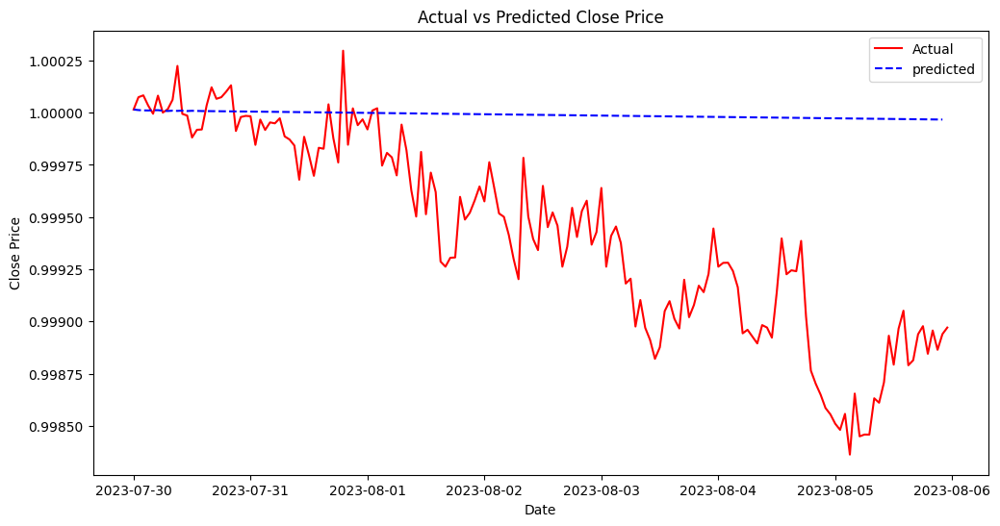

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

###7Day forecast greed and whale transaction

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

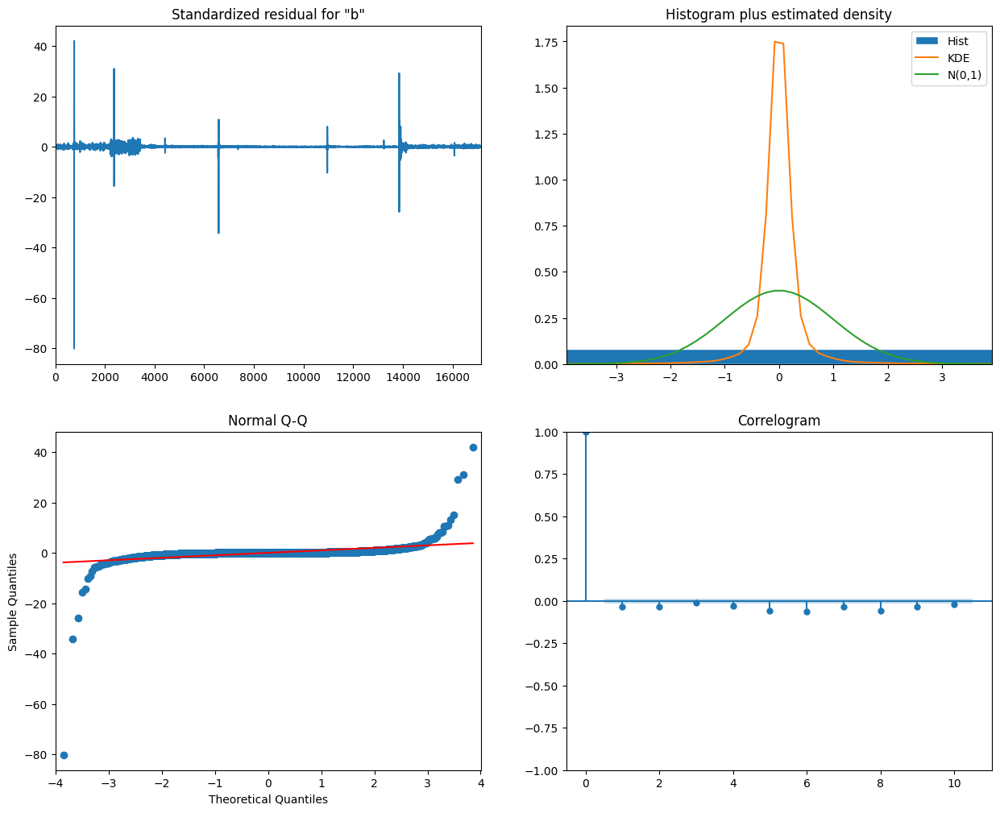

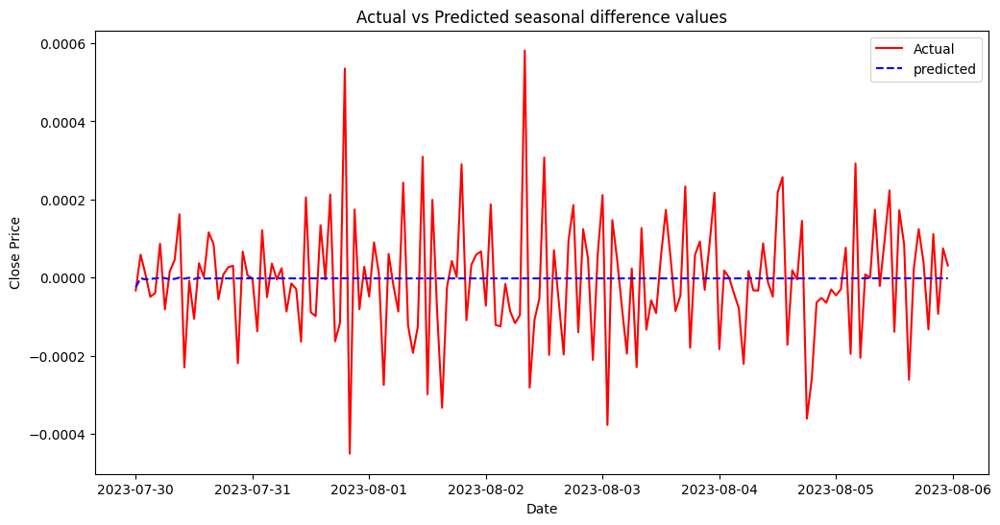

Mean Absolute Error (MAE): 0.00011469834768547104
Mean Squared Error (MSE): 2.3504964168899114e-08
Root Mean Squared Error (RMSE): 0.00015331328764624127
R2 score: -0.00027555884305296985


In [ ]:
exog = df[['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

Mean Absolute Error (MAE): 0.0004667156198395008
Mean Squared Error (MSE): 3.551552907224547e-07
Root Mean Squared Error (RMSE): 0.0005959490672217338
R2 score: -0.5805977892477001


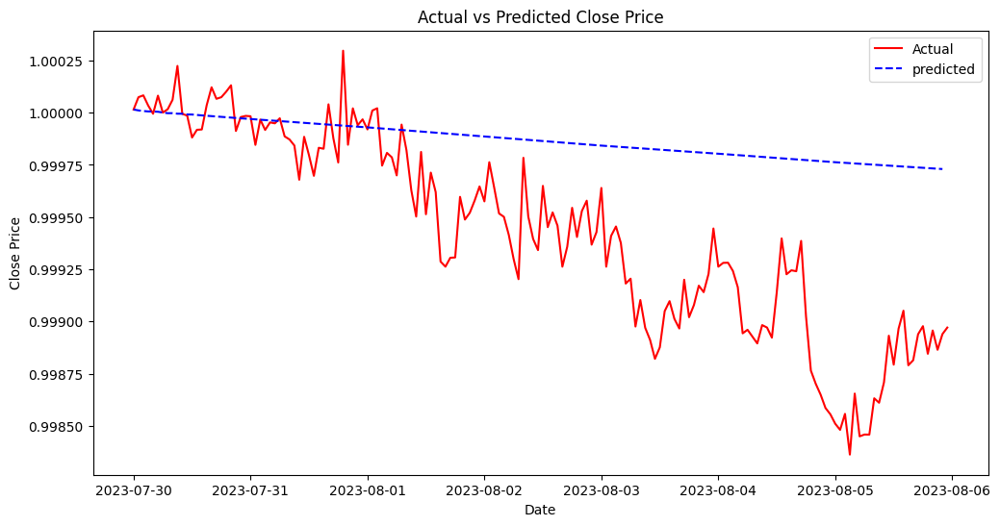

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)


##LSTM

###7 Day prediction greed

Epoch 1/15
429/429 [==============================] - 21s 35ms/step - loss: 0.0103 - val_loss: 4.1060e-04
Epoch 2/15
429/429 [==============================] - 13s 31ms/step - loss: 1.1711e-04 - val_loss: 3.9926e-04
Epoch 3/15
429/429 [==============================] - 15s 34ms/step - loss: 1.2941e-04 - val_loss: 4.0041e-04
Epoch 4/15
429/429 [==============================] - 16s 36ms/step - loss: 1.2321e-04 - val_loss: 4.2249e-04
Epoch 5/15
429/429 [==============================] - 10s 22ms/step - loss: 1.2733e-04 - val_loss: 4.0421e-04
Epoch 6/15
429/429 [==============================] - 8s 19ms/step - loss: 1.2993e-04 - val_loss: 4.0427e-04
Epoch 7/15
429/429 [==============================] - 12s 28ms/step - loss: 1.2504e-04 - val_loss: 4.1432e-04
Epoch 8/15
429/429 [==============================] - 7s 16ms/step - loss: 1.2768e-04 - val_loss: 4.0378e-04
Epoch 9/15
429/429 [==============================] - 9s 22ms/step - loss: 1.2722e-04 - val_loss: 4.0759e-04
Epoch 10/15
429/4

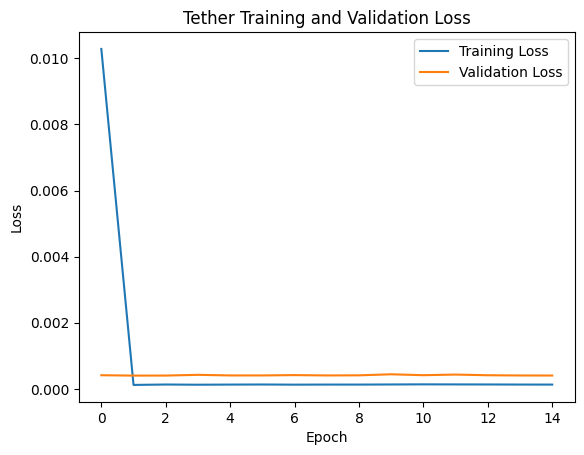

536/536 [==============================] - 4s 6ms/step
Tether Training Set:
RMSE: 0.00
MSE: 0.00
MAE: 0.00
R2 score: 0.12


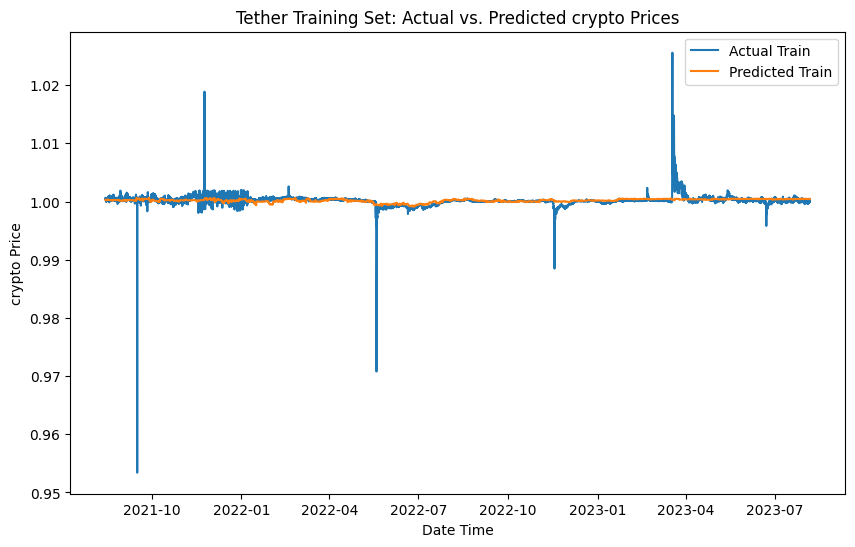

5/5 [==============================] - 0s 7ms/step
Tether Test Set:
RMSE: 0.00
MSE: 0.00
MAE: 0.00
test R2 score: -5.33


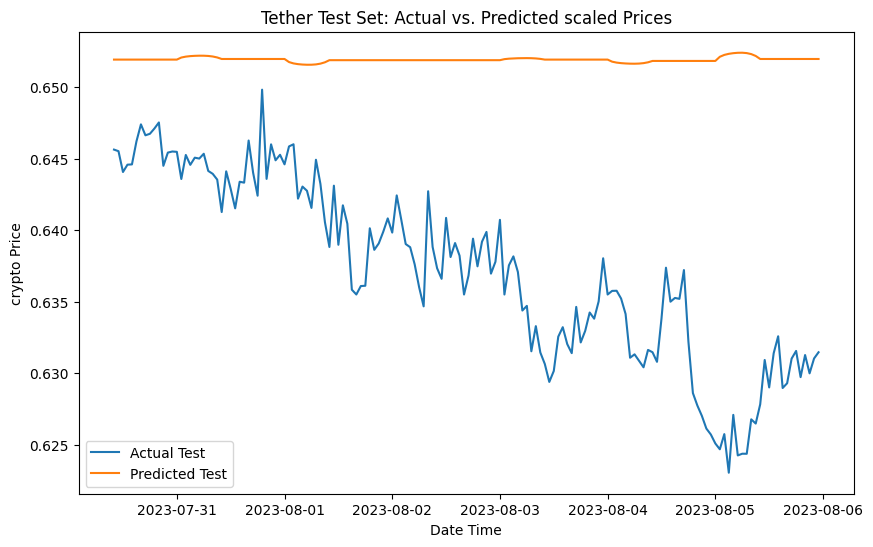

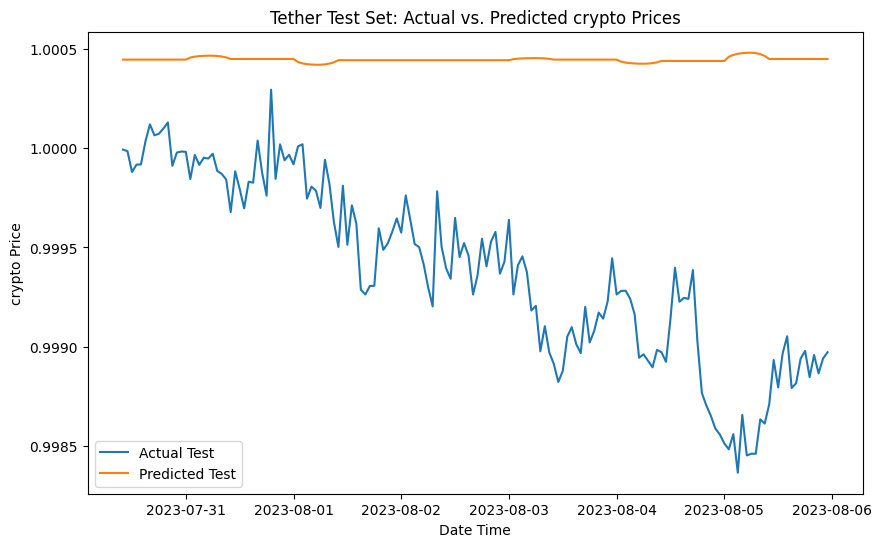

In [ ]:
def apply_lstm_sequences(data,company_name, features, target, test_size=0.2, random_state=False, num_epochs=50, batch_size=32, sequence_length=10):

    X = data[features].values
    y = data[target].values

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y.reshape(-1, 1))

    # Split data into training and testing sets
    #train_size = int((1 - test_size) * len(X_scaled))
    train_size = len(X_scaled)-test_size
    X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
    y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

    # Create sequences
    X_train_seq, y_train_seq = [], []
    X_test_seq, y_test_seq = [], []

    for i in range(len(X_train) - sequence_length):
        X_train_seq.append(X_train[i:i + sequence_length])
        y_train_seq.append(y_train[i + sequence_length])

    for i in range(len(X_test) - sequence_length):
        X_test_seq.append(X_test[i:i + sequence_length])
        y_test_seq.append(y_test[i + sequence_length])

    X_train_seq, y_train_seq = np.array(X_train_seq), np.array(y_train_seq)
    X_test_seq, y_test_seq = np.array(X_test_seq), np.array(y_test_seq)

    # Build and train LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    history = model.fit(X_train_seq, y_train_seq, epochs=num_epochs, batch_size=batch_size, validation_split=0.2, verbose=1)
    model.summary()
    # Plot validation loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{company_name} Training and Validation Loss')
    plt.legend()
    plt.show()

    # Evaluate the model on training data
    y_train_pred_scaled = model.predict(X_train_seq)
    y_train_pred = scaler_y.inverse_transform(y_train_pred_scaled)
    y_train_orig = scaler_y.inverse_transform(y_train_seq)

    # Calculate RMSE, MSE, and MAE for training set
    train_rmse = np.sqrt(mean_squared_error(y_train_orig, y_train_pred))
    train_mse = mean_squared_error(y_train_orig, y_train_pred)
    train_mae = mean_absolute_error(y_train_orig, y_train_pred)
    #R2score
    train_r2 = r2_score(y_train_orig, y_train_pred)

    print(f"{company_name} Training Set:")
    print(f"RMSE: {train_rmse:.2f}")
    print(f"MSE: {train_mse:.2f}")
    print(f"MAE: {train_mae:.2f}")
    print(f"R2 score: {train_r2:.2f}")

    # Plot actual vs. predicted values for training set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_train_orig):],y_train_orig, label='Actual Train')
    plt.plot(data.index[-len(y_train_orig):],y_train_pred, label='Predicted Train')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Training Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

    # Evaluate the model on test data
    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_test_orig = scaler_y.inverse_transform(y_test_seq)

    # Calculate RMSE, MSE, and MAE for test set
    rmse = np.sqrt(mean_squared_error(y_test_orig, y_pred))
    mse = mean_squared_error(y_test_orig, y_pred)
    mae = mean_absolute_error(y_test_orig, y_pred)
    test_r2 = r2_score(y_test_orig, y_pred)

    print(f"{company_name} Test Set:")
    print(f"RMSE: {rmse:.2f}")
    print(f"MSE: {mse:.2f}")
    print(f"MAE: {mae:.2f}")
    print(f"test R2 score: {test_r2:.2f}")
    #scaled results
    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_seq, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred_scaled, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted scaled Prices')
    plt.legend()
    plt.show()

    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_orig, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()


# Sample data and parameters
# Replace with your actual data and parameters
data = df_tether
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Tether', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)



### Whale trasaction and fear and greed


Epoch 1/15
429/429 [==============================] - 16s 22ms/step - loss: 0.0082 - val_loss: 3.7890e-04
Epoch 2/15
429/429 [==============================] - 9s 20ms/step - loss: 1.1543e-04 - val_loss: 3.4433e-04
Epoch 3/15
429/429 [==============================] - 11s 25ms/step - loss: 1.1601e-04 - val_loss: 3.3760e-04
Epoch 4/15
429/429 [==============================] - 7s 16ms/step - loss: 1.1536e-04 - val_loss: 3.1461e-04
Epoch 5/15
429/429 [==============================] - 10s 24ms/step - loss: 1.2328e-04 - val_loss: 2.8634e-04
Epoch 6/15
429/429 [==============================] - 10s 24ms/step - loss: 1.2536e-04 - val_loss: 3.0332e-04
Epoch 7/15
429/429 [==============================] - 7s 17ms/step - loss: 1.1696e-04 - val_loss: 2.9910e-04
Epoch 8/15
429/429 [==============================] - 12s 27ms/step - loss: 1.2706e-04 - val_loss: 4.9663e-04
Epoch 9/15
429/429 [==============================] - 7s 17ms/step - loss: 1.2906e-04 - val_loss: 2.9670e-04
Epoch 10/15
429/42

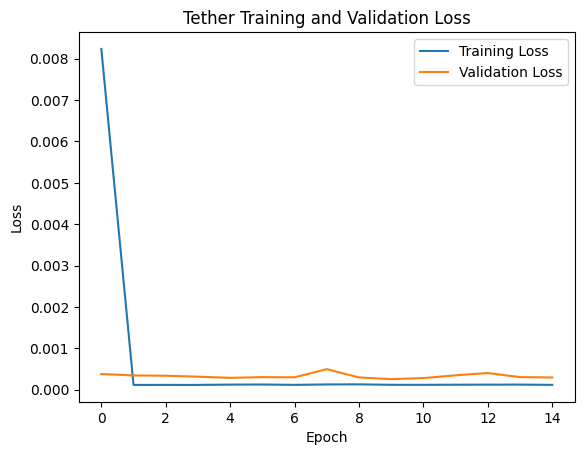

536/536 [==============================] - 6s 6ms/step
Tether Training Set:
RMSE: 0.00
MSE: 0.00
MAE: 0.00
R2 score: 0.27


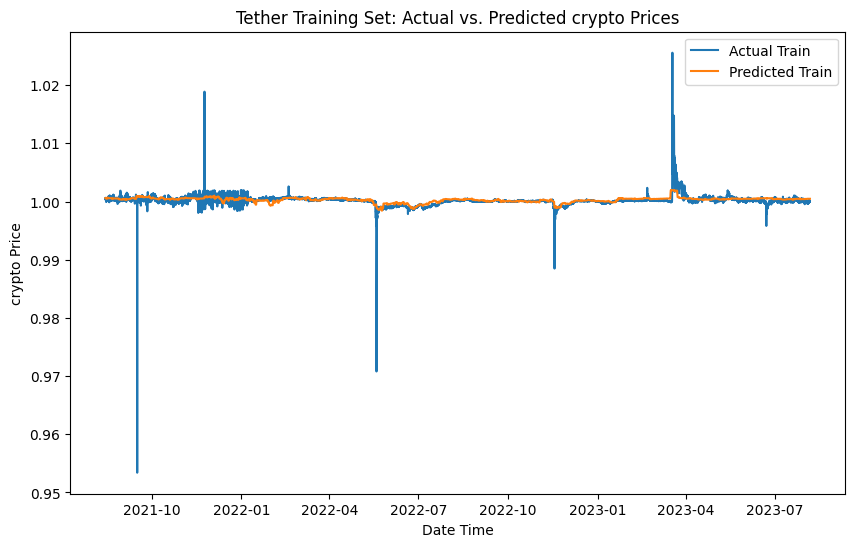

5/5 [==============================] - 0s 6ms/step
Tether Test Set:
RMSE: 0.00
MSE: 0.00
MAE: 0.00
test R2 score: -5.45


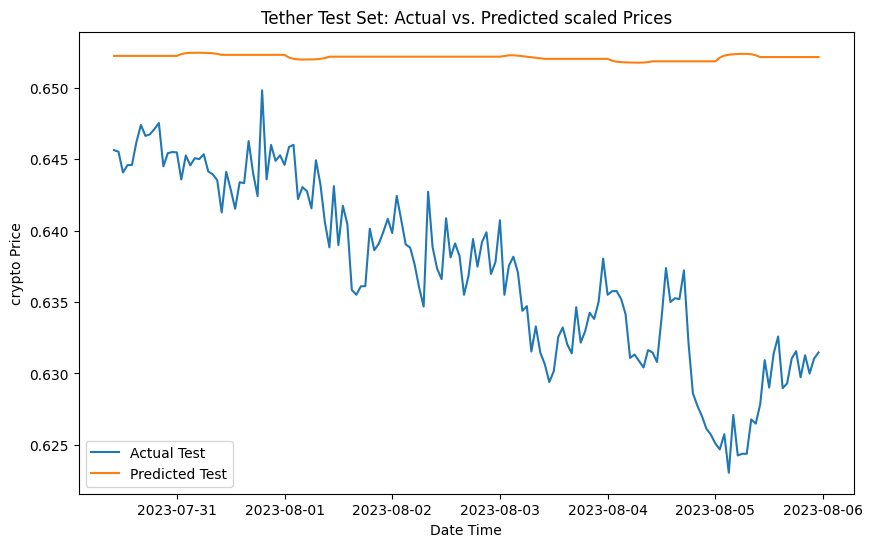

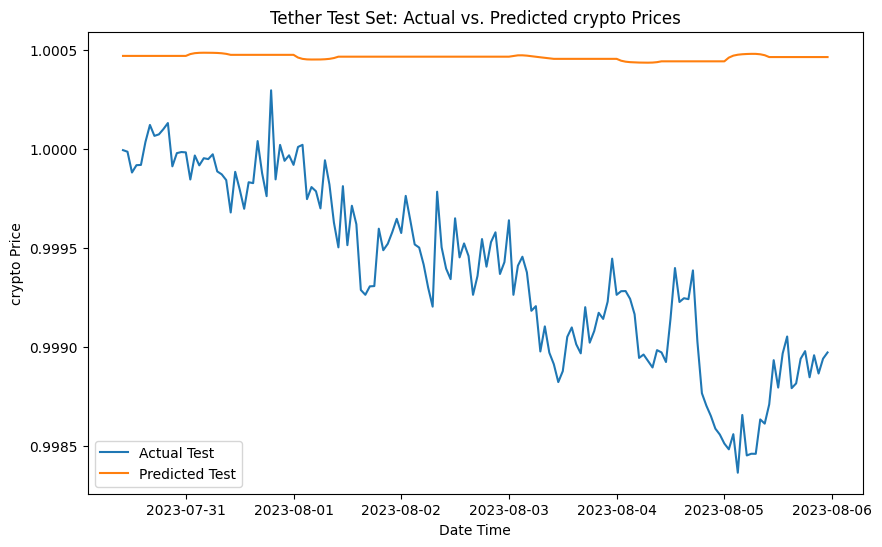

In [ ]:

data = df_tether
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'Tether', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


##Bi-LSTM

####7 Day Prediction using greed

Epoch 1/15
429/429 [==============================] - 47s 56ms/step - loss: 0.0072 - val_loss: 4.0470e-04
Epoch 2/15
429/429 [==============================] - 15s 35ms/step - loss: 1.1763e-04 - val_loss: 4.0395e-04
Epoch 3/15
429/429 [==============================] - 18s 43ms/step - loss: 1.2105e-04 - val_loss: 4.0162e-04
Epoch 4/15
429/429 [==============================] - 14s 32ms/step - loss: 1.2602e-04 - val_loss: 4.0073e-04
Epoch 5/15
429/429 [==============================] - 17s 39ms/step - loss: 1.3189e-04 - val_loss: 4.0556e-04
Epoch 6/15
429/429 [==============================] - 18s 43ms/step - loss: 1.3196e-04 - val_loss: 4.6919e-04
Epoch 7/15
429/429 [==============================] - 13s 31ms/step - loss: 1.4073e-04 - val_loss: 4.0821e-04
Epoch 8/15
429/429 [==============================] - 16s 38ms/step - loss: 1.4887e-04 - val_loss: 4.0860e-04
Epoch 9/15
429/429 [==============================] - 19s 45ms/step - loss: 1.3030e-04 - val_loss: 4.5739e-04
Epoch 10/15
42

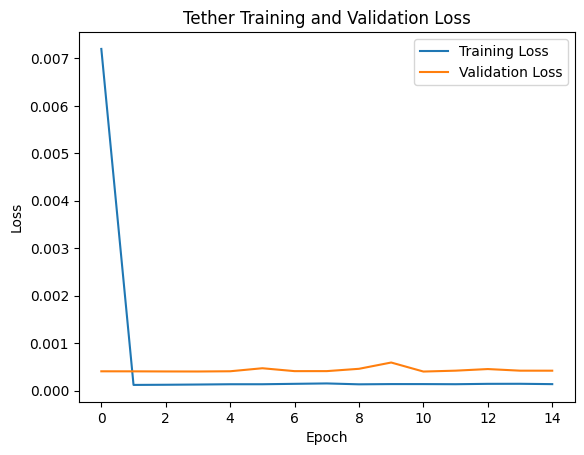

536/536 [==============================] - 8s 12ms/step
Tether Training Set:
RMSE: 0.0009625322349841127
MSE: 9.264683033835112e-07
MAE: 0.0003953501316969531
R2: 0.07504276414169264


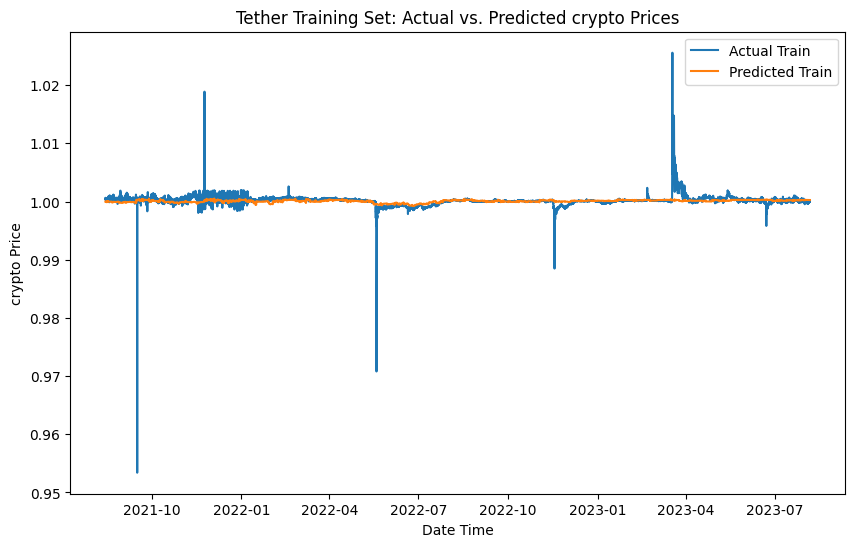

5/5 [==============================] - 0s 15ms/step
Tether Test Set:
RMSE: 0.0009848952531914103
MSE: 9.700186597589723e-07
MAE: 0.000871174320389955
R2: -3.5675897183272776


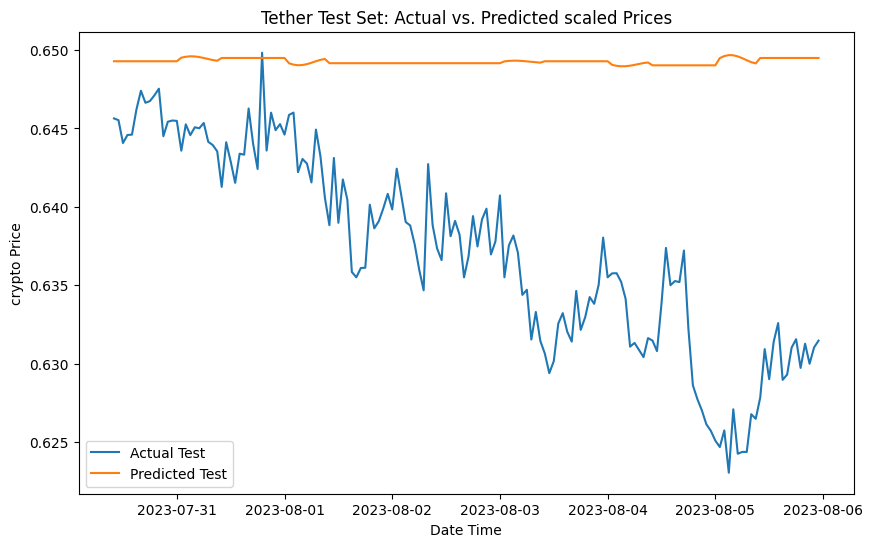

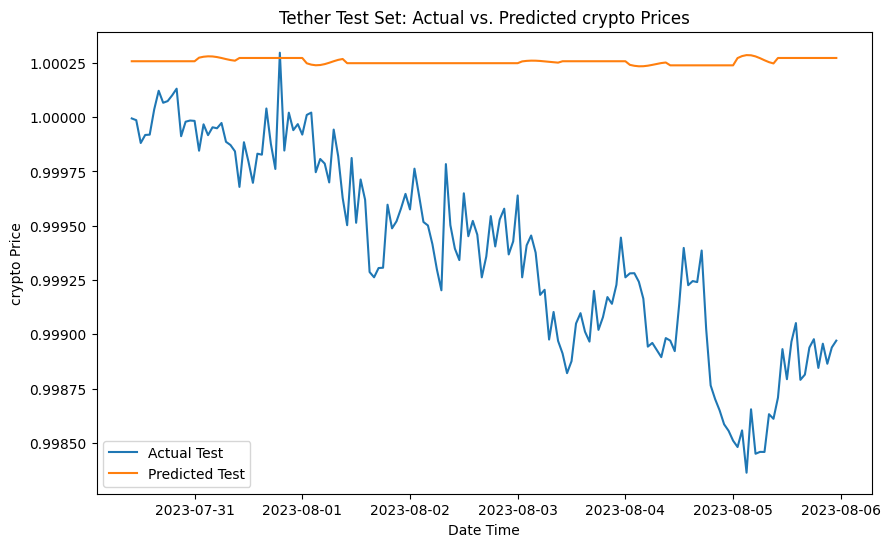

In [ ]:
def apply_bi_lstm_sequences(data,company_name, features, target, test_size=0.2, random_state=42, num_epochs=50, batch_size=32, sequence_length=10):
    # Preprocessing


    X = data[features].values
    y = data[target].values

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y.reshape(-1, 1))

    # Split data into training and testing sets
    #train_size = int((1 - test_size) * len(X_scaled))
    train_size = len(X_scaled)-test_size
    X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
    y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

    # Create sequences
    X_train_seq, y_train_seq = [], []
    X_test_seq, y_test_seq = [], []

    for i in range(len(X_train) - sequence_length):
        X_train_seq.append(X_train[i:i + sequence_length])
        y_train_seq.append(y_train[i + sequence_length])

    for i in range(len(X_test) - sequence_length):
        X_test_seq.append(X_test[i:i + sequence_length])
        y_test_seq.append(y_test[i + sequence_length])

    X_train_seq, y_train_seq = np.array(X_train_seq), np.array(y_train_seq)
    X_test_seq, y_test_seq = np.array(X_test_seq), np.array(y_test_seq)

    # Build and train Bi-LSTM model
    model = Sequential()
    model.add(Bidirectional(LSTM(units=50, return_sequences=True), input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])))
    model.add(Bidirectional(LSTM(units=50)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    history = model.fit(X_train_seq, y_train_seq, epochs=num_epochs, batch_size=batch_size, validation_split=0.2, verbose=1)
    model.summary()
    # Plot validation loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{company_name} Training and Validation Loss')
    plt.legend()
    plt.show()



    # Evaluate the model on training data
    y_train_pred_scaled = model.predict(X_train_seq)
    y_train_pred = scaler_y.inverse_transform(y_train_pred_scaled)
    y_train_orig = scaler_y.inverse_transform(y_train_seq)

    # Calculate RMSE, MSE, and MAE for training set
    train_rmse = np.sqrt(mean_squared_error(y_train_orig, y_train_pred))
    train_mse = mean_squared_error(y_train_orig, y_train_pred)
    train_mae = mean_absolute_error(y_train_orig, y_train_pred)
    #R2score
    train_r2 = r2_score(y_train_orig, y_train_pred)

    print(f"{company_name} Training Set:")
    print(f"RMSE: {train_rmse:}")
    print(f"MSE: {train_mse:}")
    print(f"MAE: {train_mae:}")
    print(f"R2: {train_r2:}")
    # Plot actual vs. predicted values for training set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_train_orig):],y_train_orig, label='Actual Train')
    plt.plot(data.index[-len(y_train_orig):],y_train_pred, label='Predicted Train')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Training Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

    # Evaluate the model on test data
    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_test_orig = scaler_y.inverse_transform(y_test_seq)

    # Calculate RMSE, MSE, and MAE for test set
    rmse = np.sqrt(mean_squared_error(y_test_orig, y_pred))
    mse = mean_squared_error(y_test_orig, y_pred)
    mae = mean_absolute_error(y_test_orig, y_pred)
    test_r2 = r2_score(y_test_orig, y_pred)

    print(f"{company_name} Test Set:")
    print(f"RMSE: {rmse:}")
    print(f"MSE: {mse:}")
    print(f"MAE: {mae:}")
    print(f"R2: {test_r2:}")

    #scaled results
    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_seq, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred_scaled, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted scaled Prices')
    plt.legend()
    plt.show()

    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_orig, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

# Sample data and parameters
# Replace with your actual data and parameters
data = df_tether
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10


# Call the function
apply_bi_lstm_sequences(data,'Tether', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


####Whale transaction and fear & greed

Epoch 1/15
429/429 [==============================] - 65s 92ms/step - loss: 0.0066 - val_loss: 4.5058e-04
Epoch 2/15
429/429 [==============================] - 19s 44ms/step - loss: 1.2027e-04 - val_loss: 4.1399e-04
Epoch 3/15
429/429 [==============================] - 30s 69ms/step - loss: 1.1762e-04 - val_loss: 3.7731e-04
Epoch 4/15
429/429 [==============================] - 33s 77ms/step - loss: 1.1737e-04 - val_loss: 2.7866e-04
Epoch 5/15
429/429 [==============================] - 30s 71ms/step - loss: 1.2824e-04 - val_loss: 3.5431e-04
Epoch 6/15
429/429 [==============================] - 27s 63ms/step - loss: 1.2721e-04 - val_loss: 2.9444e-04
Epoch 7/15
429/429 [==============================] - 14s 32ms/step - loss: 1.2627e-04 - val_loss: 2.8211e-04
Epoch 8/15
429/429 [==============================] - 18s 42ms/step - loss: 1.2763e-04 - val_loss: 3.1980e-04
Epoch 9/15
429/429 [==============================] - 20s 46ms/step - loss: 1.2063e-04 - val_loss: 4.0669e-04
Epoch 10/15
42

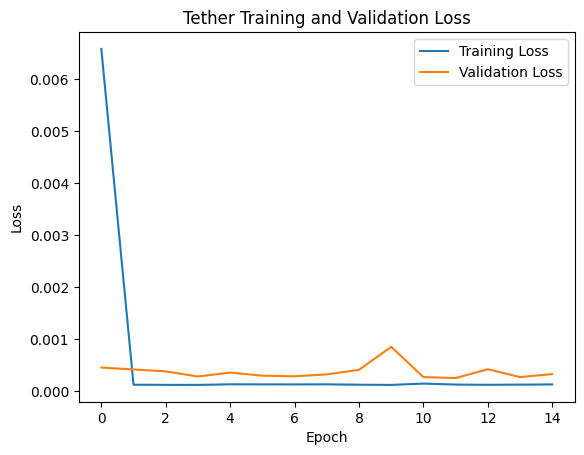

536/536 [==============================] - 6s 8ms/step
Tether Training Set:
RMSE: 0.0008609735514945998
MSE: 7.412754563732242e-07
MAE: 0.0003269413046300169
R2: 0.25993356207378093


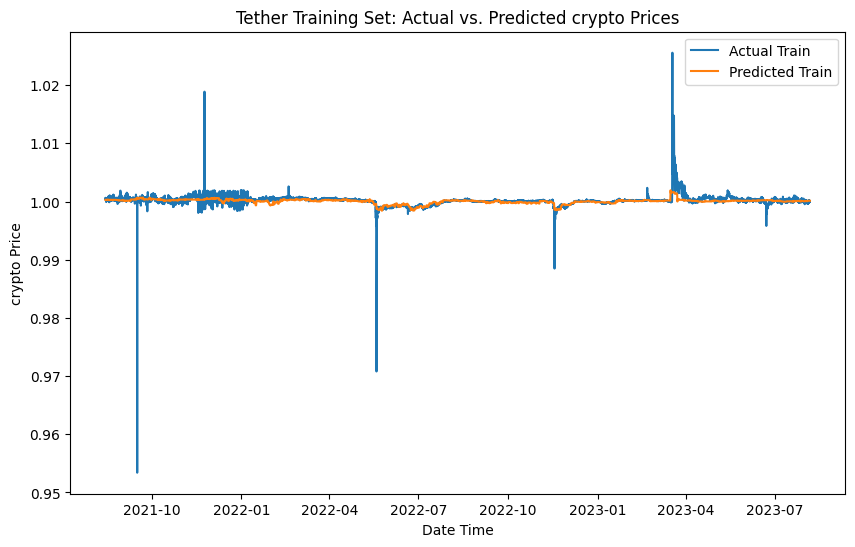

5/5 [==============================] - 0s 10ms/step
Tether Test Set:
RMSE: 0.000862429843764715
MSE: 7.437852354160306e-07
MAE: 0.000735319490674178
R2: -2.5023097336849673


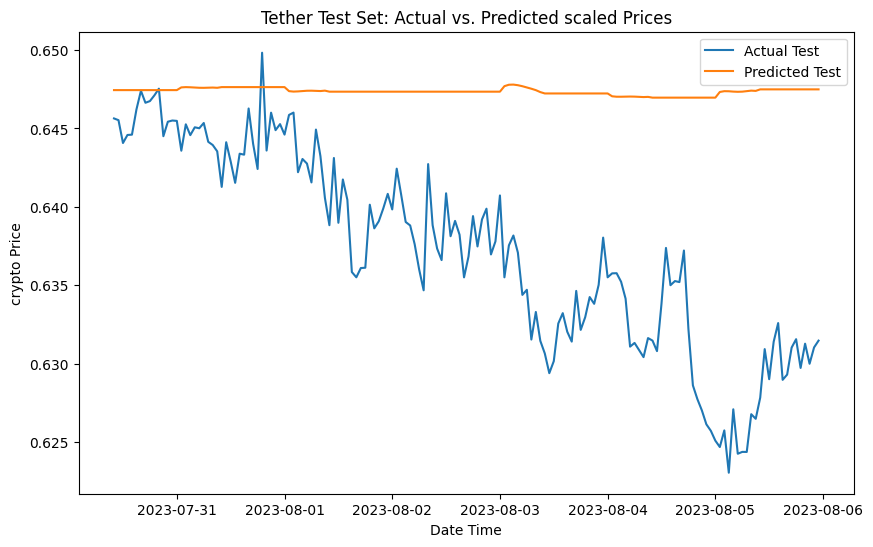

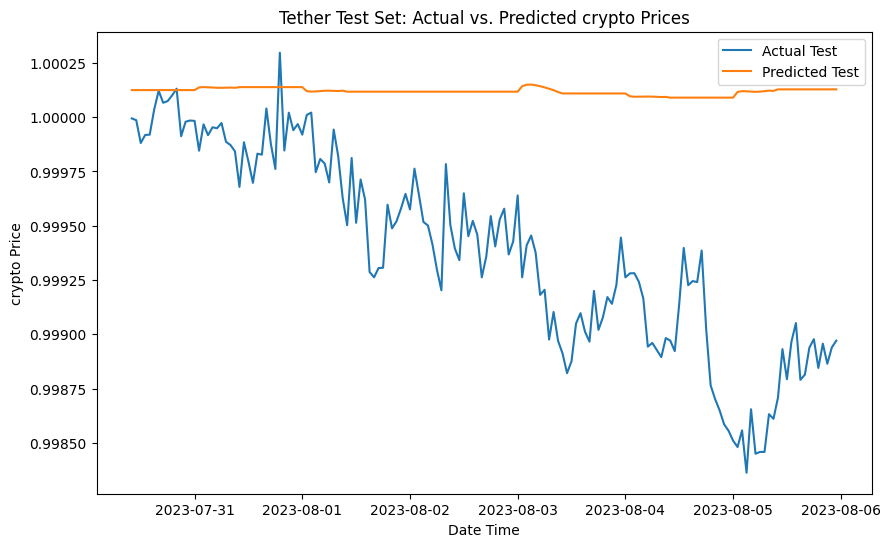

In [ ]:

data = df_tether
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = 42
num_epochs = 15
batch_size = 32
sequence_length = 10
apply_bi_lstm_sequences(data,'Tether', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)


#USD coin

In [ ]:
df_usdc.set_index('Date', inplace=True)

##ARIMA

###Check stationarity


> The P value below is >0.05 which means we cannot reject null hypothesis and the data is not stationary.


ADF Statistic: -14.625599856581491
p-value: 3.8233762504715624e-27
Critical Values: {'1%': -3.4307286632774567, '5%': -2.8617073544042877, '10%': -2.5668590784294327}


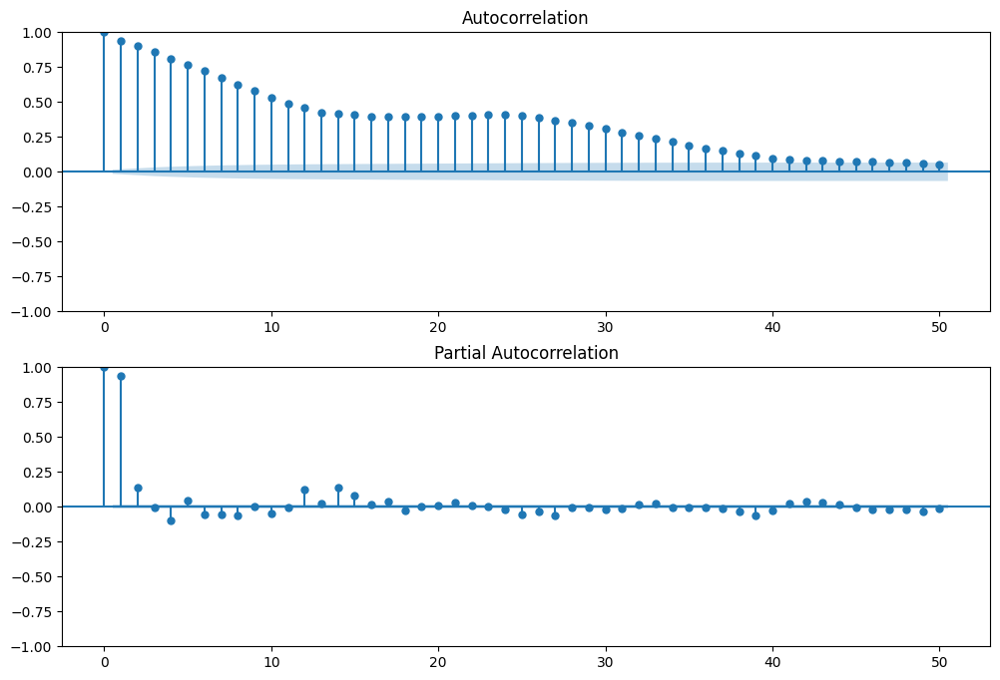

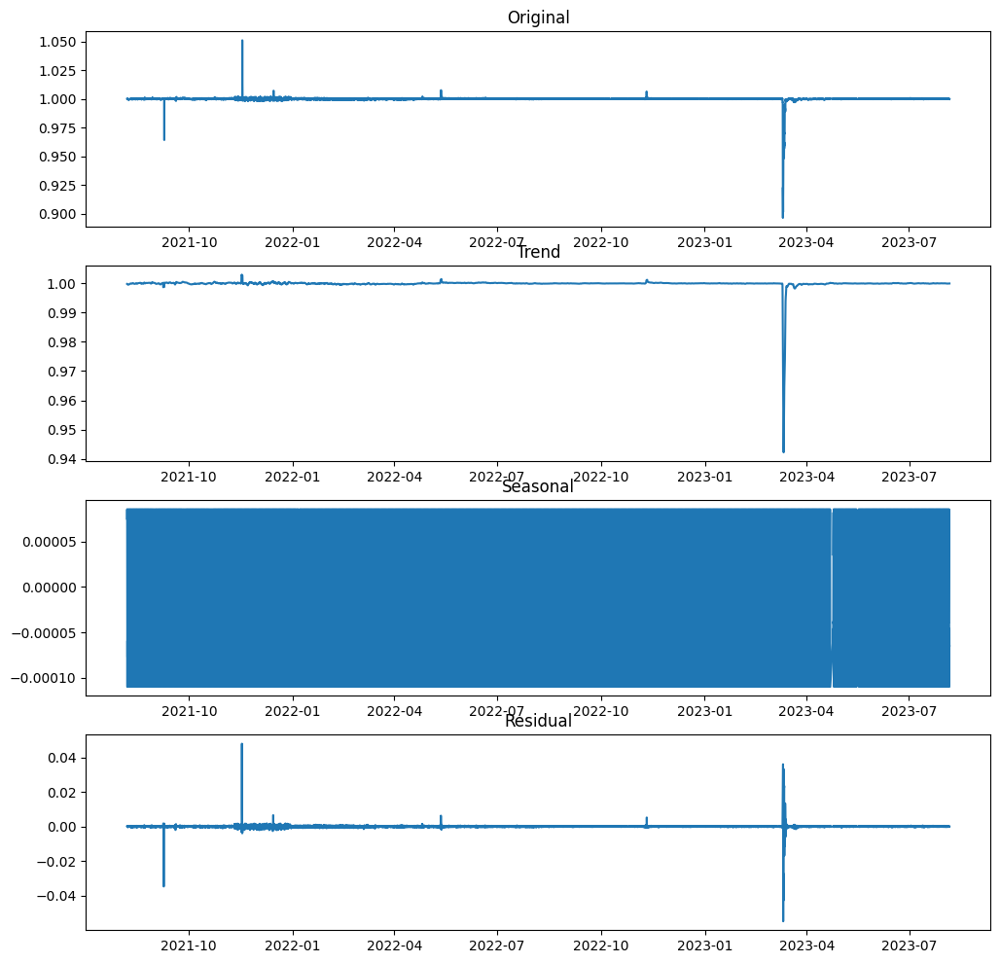

In [ ]:
check_stationarity(df_usdc['Close'])

###Seasonal differencing

> p value is less than 0.05 indicating that data is stationary and can reject null hypothesis.

box_diff_seasonal_1 p value = 0.000000
box_diff_seasonal_3 p value = 0.000000
box_diff_seasonal_6 p value = 0.000000
box_diff_seasonal_12 p value = 0.000000
box_diff_seasonal_24 p value = 0.000000
box_diff_seasonal_168 p value = 0.000000
box_diff_seasonal_672 p value = 0.000000


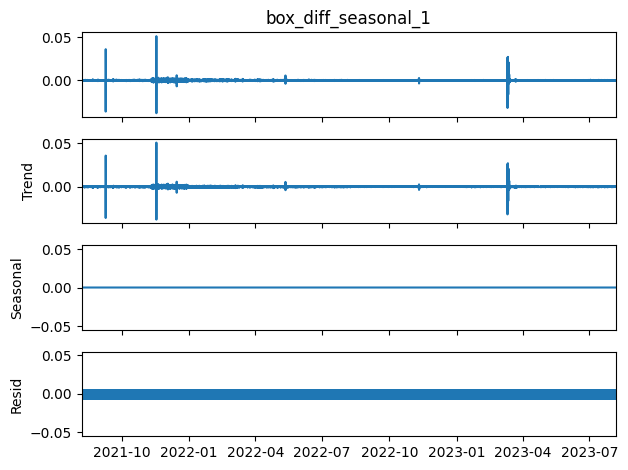

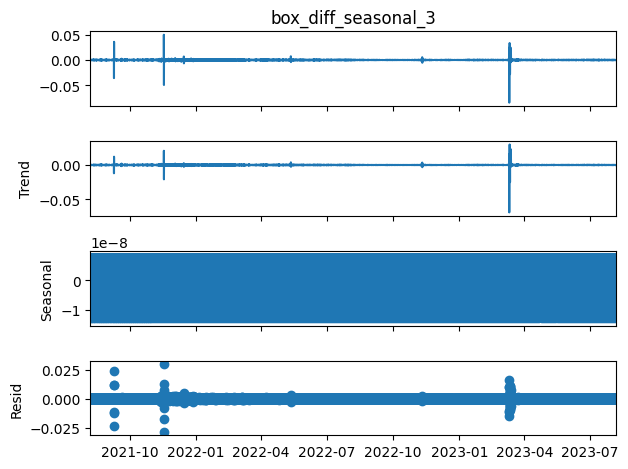

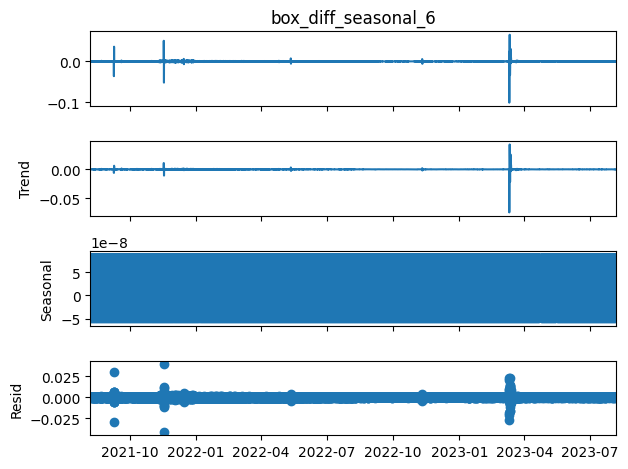

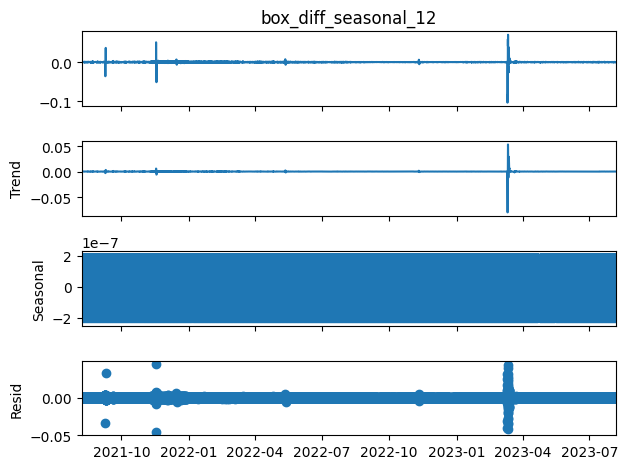

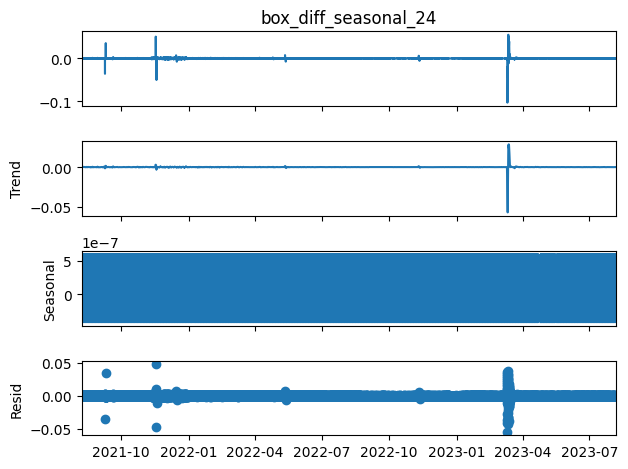

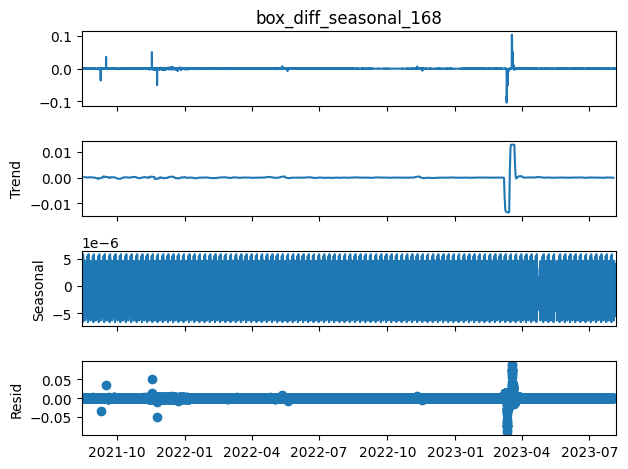

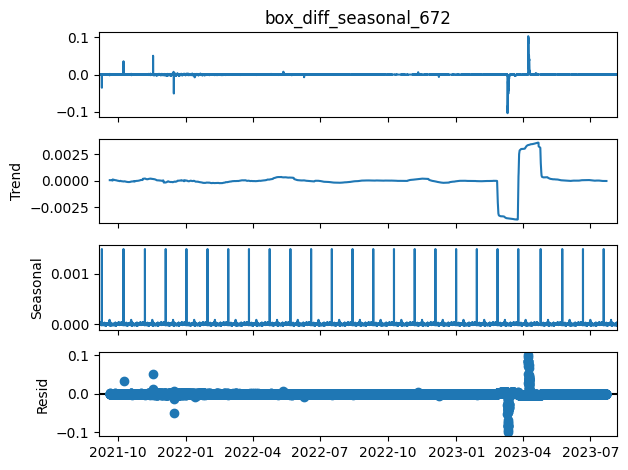

In [ ]:
Seasonal_diff(df_usdc)


###Fine tune ARIMA


In [ ]:
df =df_usdc
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))

ts=df['box_diff_seasonal_1'][1:]

test_data = ts.iloc[-168:]

# The remaining data is the training data
train_data = ts.iloc[:-168]

model = auto_arima(train_data, seasonal=True, stepwise=True, suppress_warnings=True, error_action="ignore")

# Print the summary of the best model
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                17147
Model:               SARIMAX(2, 0, 4)   Log Likelihood               95085.073
Date:                Wed, 18 Oct 2023   AIC                        -190156.147
Time:                        11:02:50   BIC                        -190101.899
Sample:                             0   HQIC                       -190138.265
                              - 17147                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5242      0.000  -2843.768      0.000      -0.525      -0.524
ar.L2         -0.1178      0.000   -427.307      0.000      -0.118      -0.117
ma.L1          0.3643      0.000   1876.486      0.0

###7 Day Forecast

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

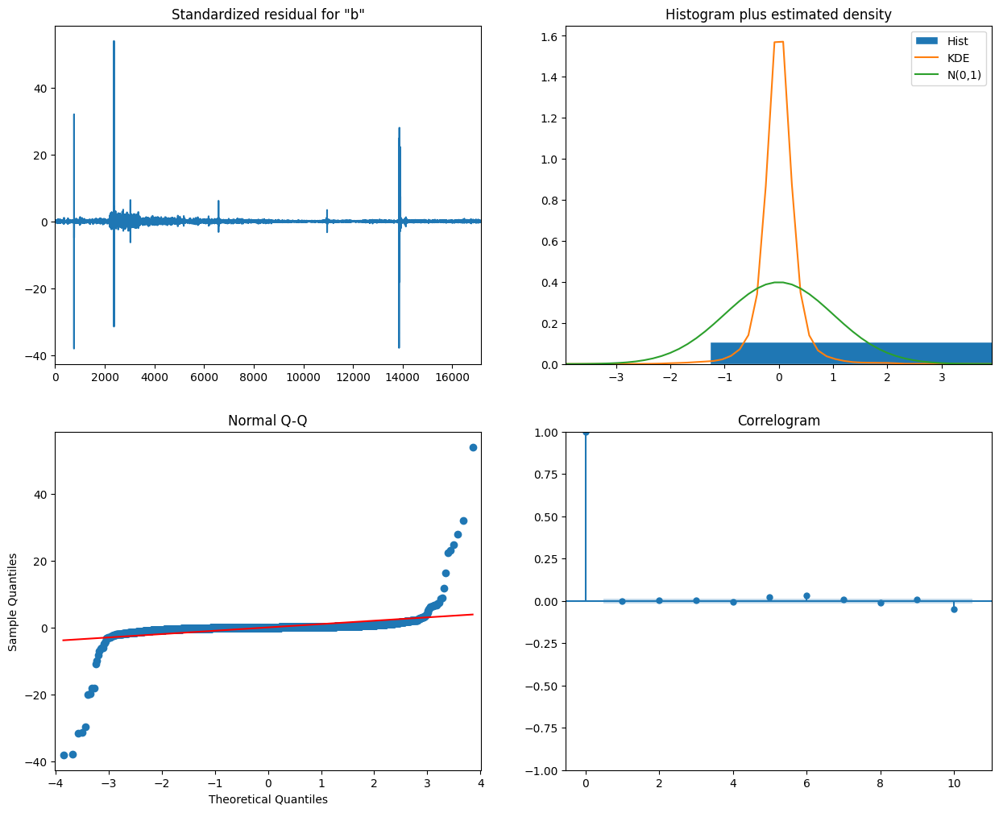

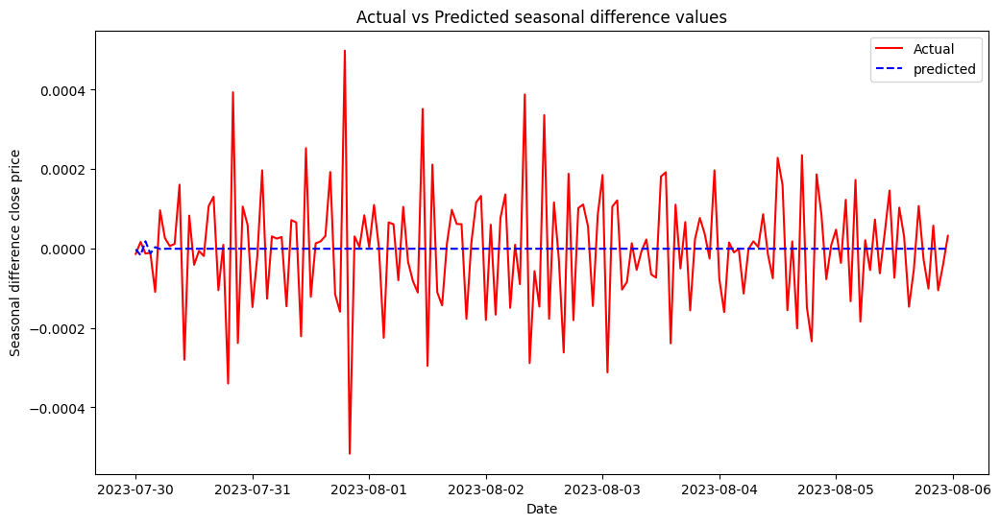

Mean Absolute Error (MAE): 0.00011018576907907464
Mean Squared Error (MSE): 2.120017167557368e-08
Root Mean Squared Error (RMSE): 0.00014560278732075727
R2 score: -0.0007306998970162404


In [ ]:
p,d,q =2,0,4
df =df_usdc
df['box_diff_seasonal_1'] = (df.Close - df.Close.shift(1))
df_forecast = arima_forecast(df['box_diff_seasonal_1'],7)


In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

Mean Absolute Error (MAE): 8.188631697929578e-05
Mean Squared Error (MSE): 1.1347299032212024e-08
Root Mean Squared Error (RMSE): 0.00010652370173915299
R2 score: 0.05788012173686652


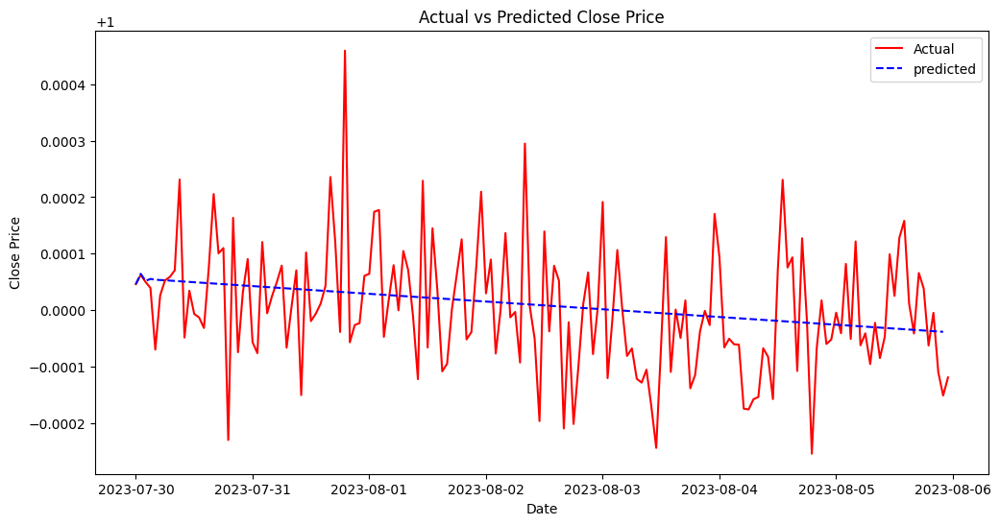

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

##SARIMAX

####Fine tune sarimax

In [ ]:


# Define parameter ranges
p_values = range(0, 3)
d_values = range(0, 2)
q_values = range(0, 3)
P_values = range(0, 3)
D_values = range(0, 2)
Q_values = range(0, 3)
s = 7  # Seasonal period

data = df['box_diff_seasonal_1'][:500]
# Split data into training, validation, and test sets
train_size = int(len(data) * 0.6)
valid_size = int(len(data) * 0.2)
train_data = data[:train_size]
valid_data = data[train_size:train_size + valid_size]
test_data = data[train_size + valid_size:]

best_model = None
best_mse = float('inf')

# Grid search over parameter combinations
for p, d, q, P, D, Q in product(p_values, d_values, q_values, P_values, D_values, Q_values):
    try:
        model = sm.tsa.SARIMAX(train_data, order=(p, d, q), seasonal_order=(P, D, Q, s))
        results = model.fit()
        forecast = results.forecast(steps=len(valid_data))
        mse = mean_squared_error(valid_data, forecast)

        if mse < best_mse:
            best_mse = mse
            best_model = model

    except Exception as e:
        continue

# Fit the best model on the entire training set
final_model = best_model.fit()

# Evaluate on the test set
forecast_test = final_model.forecast(steps=len(test_data))
mse_test = mean_squared_error(test_data, forecast_test)

print("Best SARIMA Model Parameters:", best_model.order, best_model.seasonal_order)
print("Validation MSE:", best_mse)
print("Test MSE:", mse_test)




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

Best SARIMA Model Parameters: (1, 0, 1) (2, 0, 2, 7)
Validation MSE: 7.846466672243342e-08
Test MSE: 2.5597277998857237e-08


/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


###7Day forecast Greed index

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


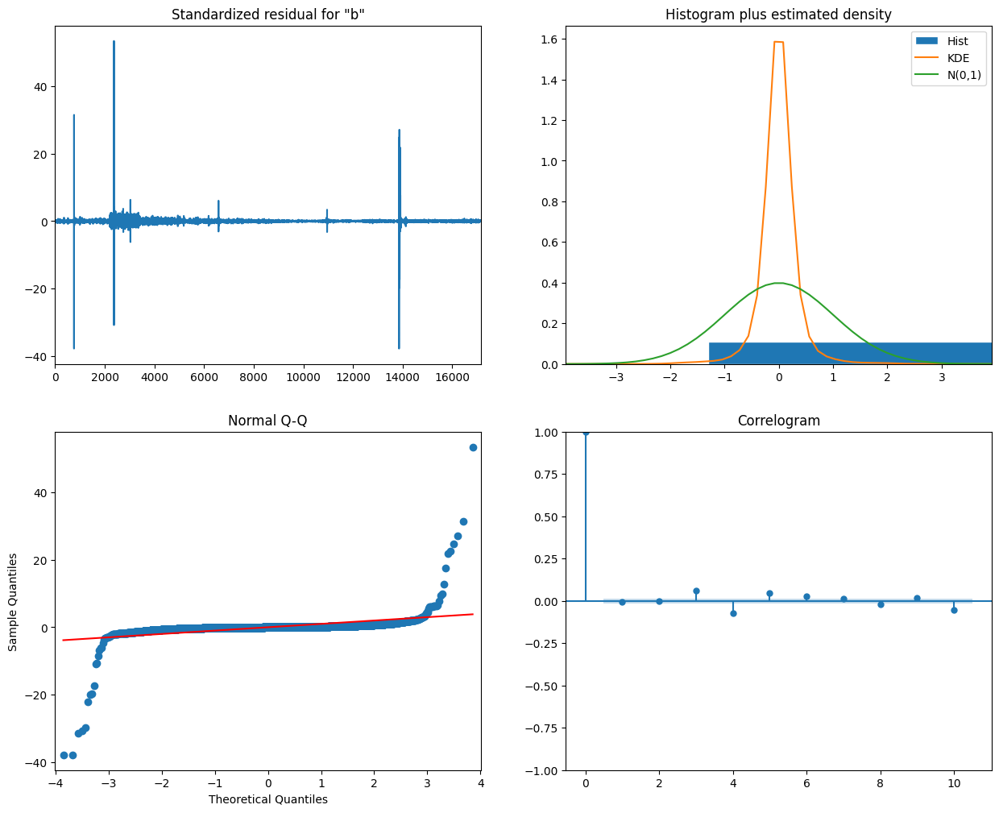

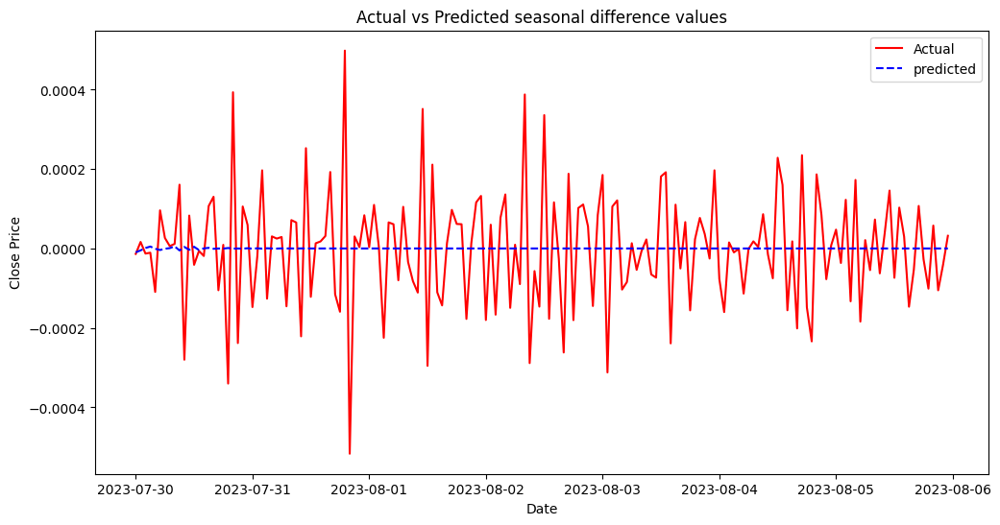

Mean Absolute Error (MAE): 0.00011001667966959273
Mean Squared Error (MSE): 2.1224584997108286e-08
Root Mean Squared Error (RMSE): 0.0001456865985501353
R2 score: -0.0018831037888340507


In [ ]:

p, d, q = 1, 0, 1  # Non-seasonal order
P, D, Q, s = 2, 0, 2, 7  # Seasonal order with daily seasonality


days=7
exog = df['value']
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

Mean Absolute Error (MAE): 0.00010280451233848139
Mean Squared Error (MSE): 1.6282286619599037e-08
Root Mean Squared Error (RMSE): 0.00012760206353973683
R2 score: -0.3518517353209969


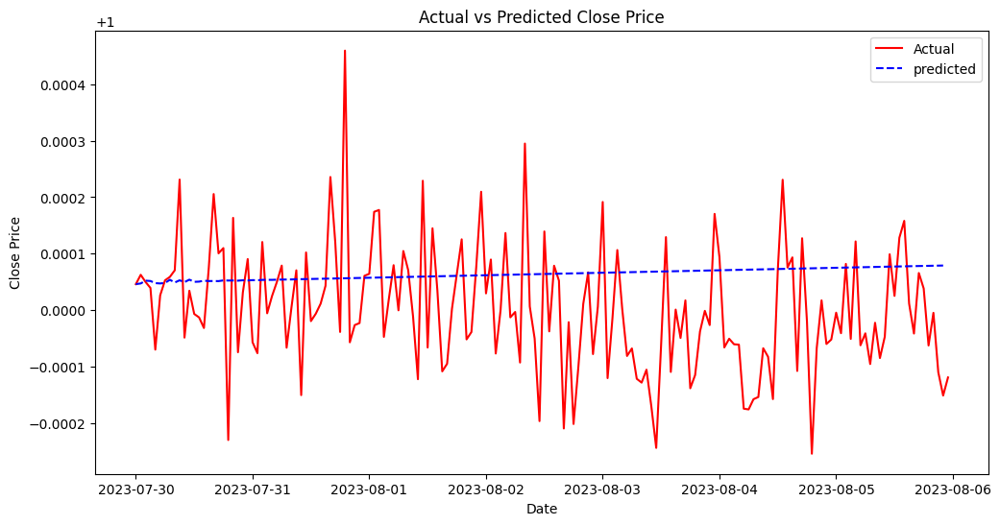

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

###7Day forecast greed and whale transaction

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/stat

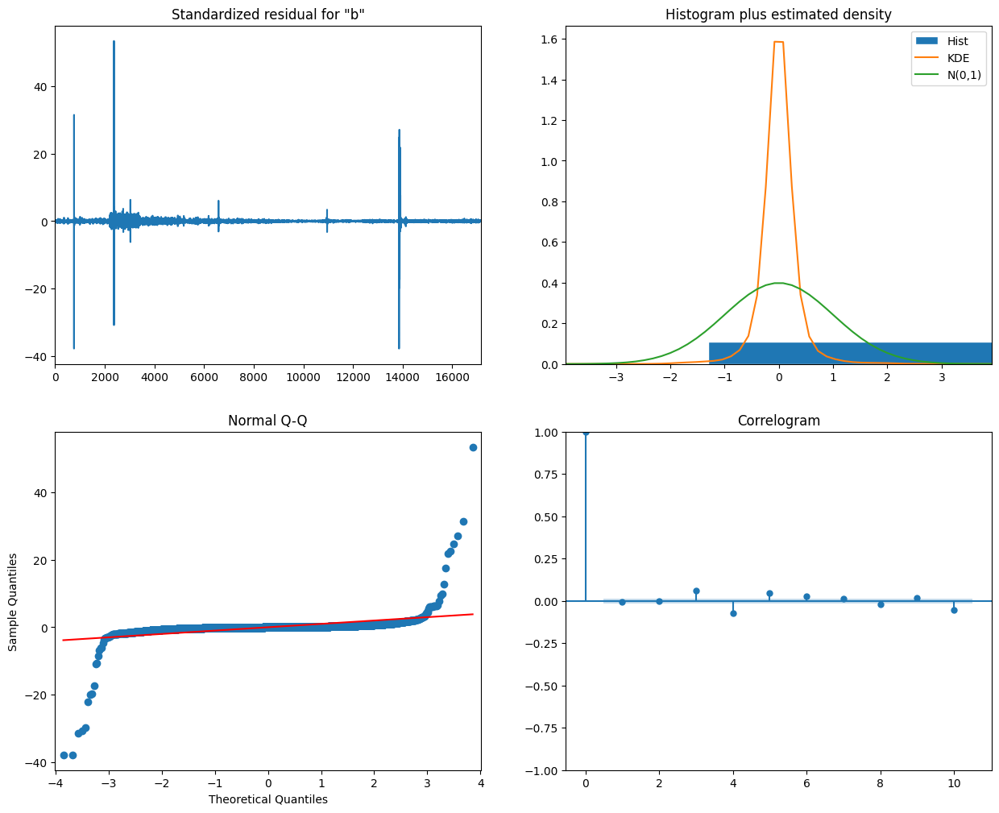

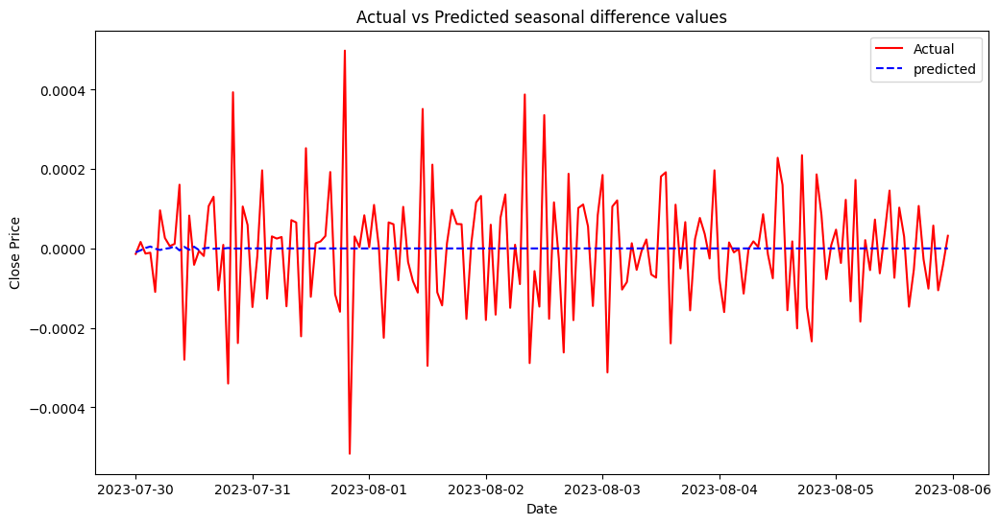

Mean Absolute Error (MAE): 0.00011000999967906595
Mean Squared Error (MSE): 2.122487404634988e-08
Root Mean Squared Error (RMSE): 0.00014568759057088522
R2 score: -0.001896748039186047


In [ ]:
exog = df[['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']]
days=7
df =df
df_forecast = sarimax_model(df,days,exog)

In [ ]:
df3= df[['Close','box_diff_seasonal_1']]
merged_df = pd.merge(df3, df_forecast, left_index=True, right_index=True, how = 'inner')
merged_df['Forecasted Close'].iloc[0] = 0  #Assign first close value as 0
merged_df['Forecasted Close'] = merged_df['Forecasted Close'].shift(-1) #move values up
merged_df['Forecasted Close'].iloc[0] = merged_df['Close'].iloc[0]
merged_df['cumulative_sum_close'] = merged_df['Forecasted Close'].cumsum() #make cummulative sum to find actual predictions

Mean Absolute Error (MAE): 0.00010703271715534938
Mean Squared Error (MSE): 1.763626613877199e-08
Root Mean Squared Error (RMSE): 0.00013280160442845557
R2 score: -0.4642671229963258


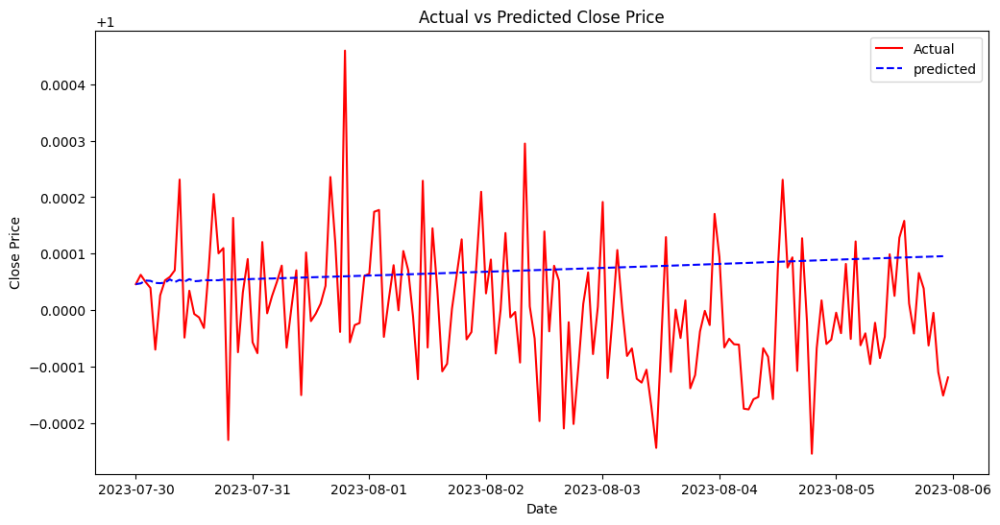

In [ ]:
evaluation_metrics(merged_df)
actual_predicted_plot(merged_df)

##LSTM

###7 Day prediction greed

Epoch 1/15
429/429 [==============================] - 13s 18ms/step - loss: 0.0090 - val_loss: 0.0016
Epoch 2/15
429/429 [==============================] - 12s 27ms/step - loss: 1.9455e-05 - val_loss: 0.0016
Epoch 3/15
429/429 [==============================] - 8s 19ms/step - loss: 1.9623e-05 - val_loss: 0.0016
Epoch 4/15
429/429 [==============================] - 9s 21ms/step - loss: 2.0603e-05 - val_loss: 0.0016
Epoch 5/15
429/429 [==============================] - 10s 24ms/step - loss: 2.0019e-05 - val_loss: 0.0016
Epoch 6/15
429/429 [==============================] - 7s 16ms/step - loss: 2.1251e-05 - val_loss: 0.0016
Epoch 7/15
429/429 [==============================] - 11s 25ms/step - loss: 2.3444e-05 - val_loss: 0.0016
Epoch 8/15
429/429 [==============================] - 9s 20ms/step - loss: 2.3392e-05 - val_loss: 0.0016
Epoch 9/15
429/429 [==============================] - 8s 19ms/step - loss: 2.7951e-05 - val_loss: 0.0016
Epoch 10/15
429/429 [==============================] - 

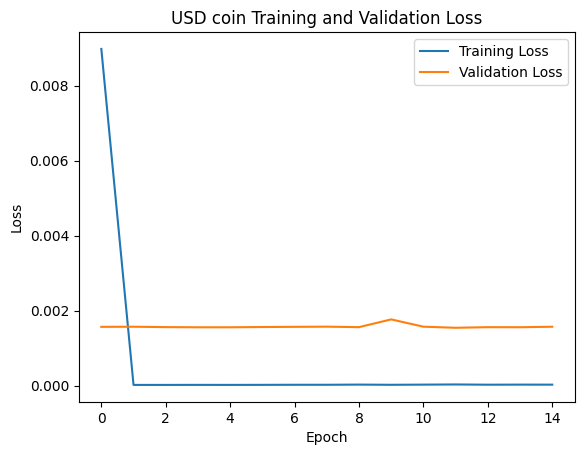

536/536 [==============================] - 4s 6ms/step
USD coin Training Set:
RMSE: 0.002803160971771663
MSE: 7.857711433663853e-06
MAE: 0.00038540187328862604
R2 score: -0.00850748997137285


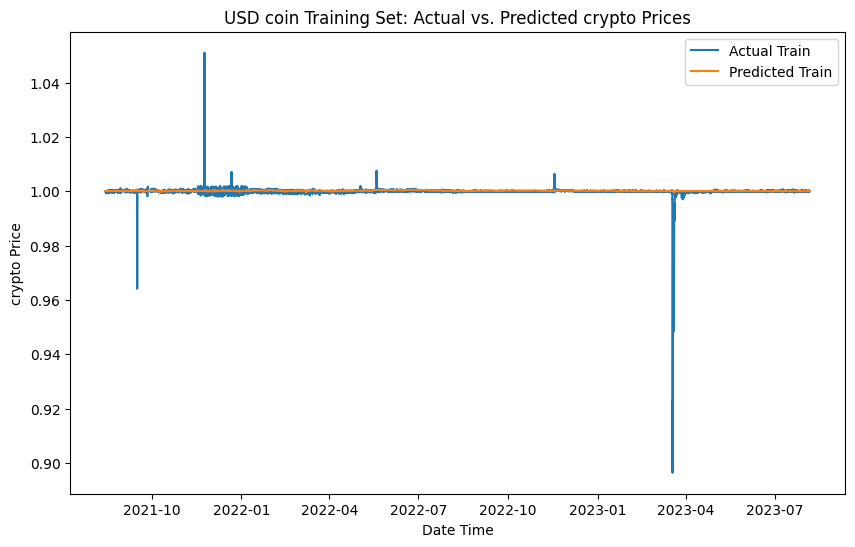

5/5 [==============================] - 0s 8ms/step
USD coin Test Set:
RMSE: 0.0001287117810742153
MSE: 1.656672258729673e-08
MAE: 0.0001059065136728555
test R2 score: -0.3513751272315271


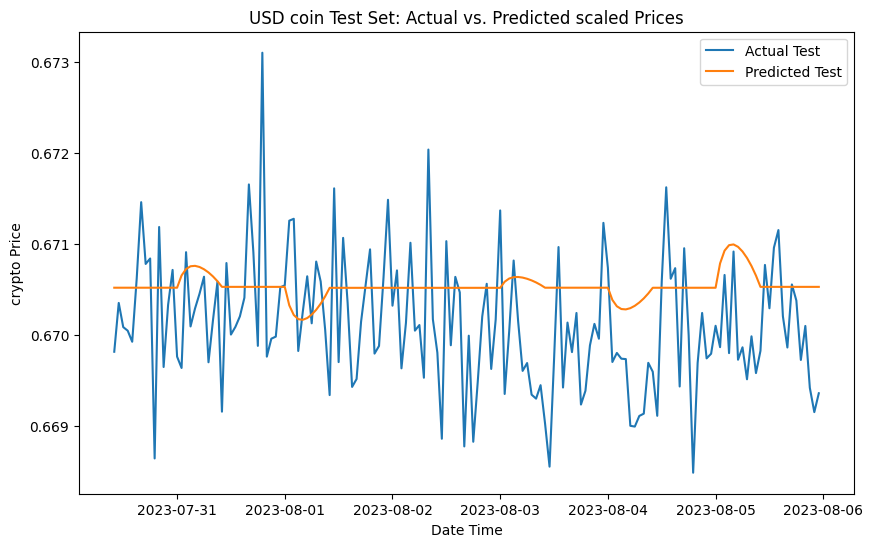

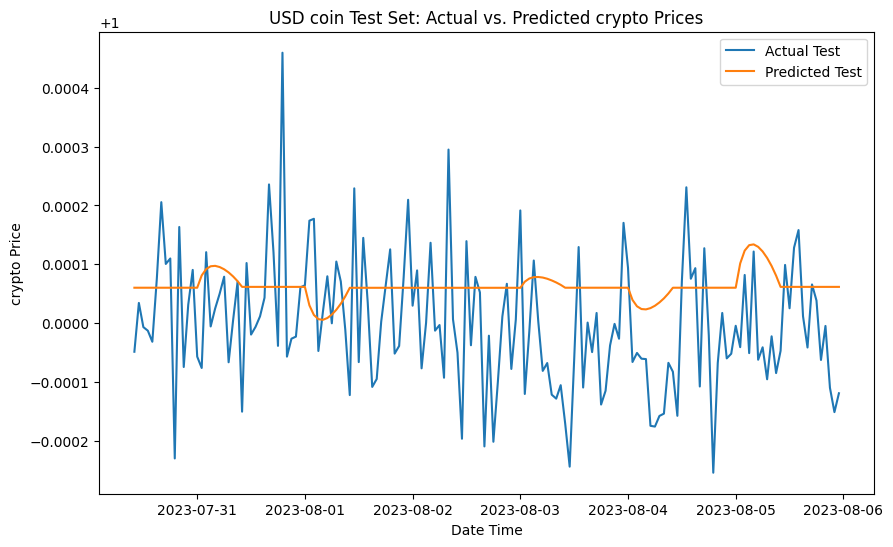

In [ ]:
def apply_lstm_sequences(data,company_name, features, target, test_size=0.2, random_state=False, num_epochs=50, batch_size=32, sequence_length=10):

    X = data[features].values
    y = data[target].values

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y.reshape(-1, 1))

    # Split data into training and testing sets
    #train_size = int((1 - test_size) * len(X_scaled))
    train_size = len(X_scaled)-test_size
    X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
    y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

    # Create sequences
    X_train_seq, y_train_seq = [], []
    X_test_seq, y_test_seq = [], []

    for i in range(len(X_train) - sequence_length):
        X_train_seq.append(X_train[i:i + sequence_length])
        y_train_seq.append(y_train[i + sequence_length])

    for i in range(len(X_test) - sequence_length):
        X_test_seq.append(X_test[i:i + sequence_length])
        y_test_seq.append(y_test[i + sequence_length])

    X_train_seq, y_train_seq = np.array(X_train_seq), np.array(y_train_seq)
    X_test_seq, y_test_seq = np.array(X_test_seq), np.array(y_test_seq)

    # Build and train LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])))
    model.add(LSTM(units=50))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    history = model.fit(X_train_seq, y_train_seq, epochs=num_epochs, batch_size=batch_size, validation_split=0.2, verbose=1)
    model.summary()
    # Plot validation loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{company_name} Training and Validation Loss')
    plt.legend()
    plt.show()

    # Evaluate the model on training data
    y_train_pred_scaled = model.predict(X_train_seq)
    y_train_pred = scaler_y.inverse_transform(y_train_pred_scaled)
    y_train_orig = scaler_y.inverse_transform(y_train_seq)

    # Calculate RMSE, MSE, and MAE for training set
    train_rmse = np.sqrt(mean_squared_error(y_train_orig, y_train_pred))
    train_mse = mean_squared_error(y_train_orig, y_train_pred)
    train_mae = mean_absolute_error(y_train_orig, y_train_pred)
    #R2score
    train_r2 = r2_score(y_train_orig, y_train_pred)

    print(f"{company_name} Training Set:")
    print(f"RMSE: {train_rmse:}")
    print(f"MSE: {train_mse:}")
    print(f"MAE: {train_mae:}")
    print(f"R2 score: {train_r2:}")

    # Plot actual vs. predicted values for training set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_train_orig):],y_train_orig, label='Actual Train')
    plt.plot(data.index[-len(y_train_orig):],y_train_pred, label='Predicted Train')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Training Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

    # Evaluate the model on test data
    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_test_orig = scaler_y.inverse_transform(y_test_seq)

    # Calculate RMSE, MSE, and MAE for test set
    rmse = np.sqrt(mean_squared_error(y_test_orig, y_pred))
    mse = mean_squared_error(y_test_orig, y_pred)
    mae = mean_absolute_error(y_test_orig, y_pred)
    test_r2 = r2_score(y_test_orig, y_pred)

    print(f"{company_name} Test Set:")
    print(f"RMSE: {rmse:}")
    print(f"MSE: {mse:}")
    print(f"MAE: {mae:}")
    print(f"test R2 score: {test_r2:}")
    #scaled results
    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_seq, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred_scaled, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted scaled Prices')
    plt.legend()
    plt.show()

    # Plot actual vs. predicted values for test set
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-len(y_test_orig):],y_test_orig, label='Actual Test')
    plt.plot(data.index[-len(y_test_orig):],y_pred, label='Predicted Test')
    plt.xlabel('Date Time')
    plt.ylabel('crypto Price')
    plt.title(f'{company_name} Test Set: Actual vs. Predicted crypto Prices')
    plt.legend()
    plt.show()

data = df_usdc
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'USD coin',features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

Epoch 1/15
429/429 [==============================] - 19s 26ms/step - loss: 0.0118 - val_loss: 0.0016
Epoch 2/15
429/429 [==============================] - 8s 19ms/step - loss: 1.9564e-05 - val_loss: 0.0016
Epoch 3/15
429/429 [==============================] - 12s 28ms/step - loss: 1.9137e-05 - val_loss: 0.0016
Epoch 4/15
429/429 [==============================] - 8s 18ms/step - loss: 1.9635e-05 - val_loss: 0.0016
Epoch 5/15
429/429 [==============================] - 10s 23ms/step - loss: 1.9846e-05 - val_loss: 0.0016
Epoch 6/15
429/429 [==============================] - 10s 23ms/step - loss: 2.1858e-05 - val_loss: 0.0016
Epoch 7/15
429/429 [==============================] - 7s 17ms/step - loss: 2.2707e-05 - val_loss: 0.0016
Epoch 8/15
429/429 [==============================] - 12s 28ms/step - loss: 2.5264e-05 - val_loss: 0.0016
Epoch 9/15
429/429 [==============================] - 8s 18ms/step - loss: 2.5570e-05 - val_loss: 0.0015
Epoch 10/15
429/429 [==============================] -

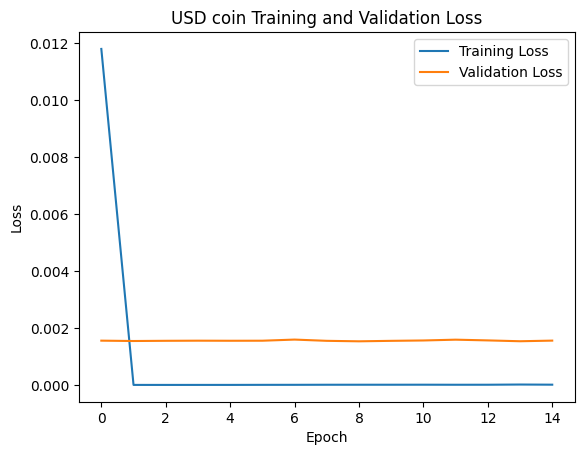

536/536 [==============================] - 5s 7ms/step
USD coin Training Set:
RMSE: 0.002803473656967579
MSE: 7.859464545311173e-06
MAE: 0.00039138362961091465
R2 score: -0.008732495208839675


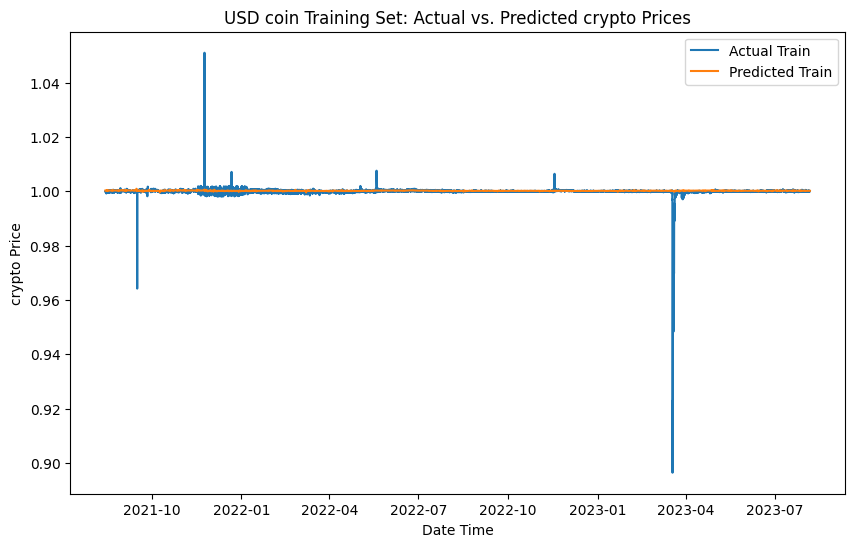

5/5 [==============================] - 0s 8ms/step
USD coin Test Set:
RMSE: 0.00020577211602409
MSE: 4.234216373303156e-08
MAE: 0.00018155612523043055
test R2 score: -2.453920749892907


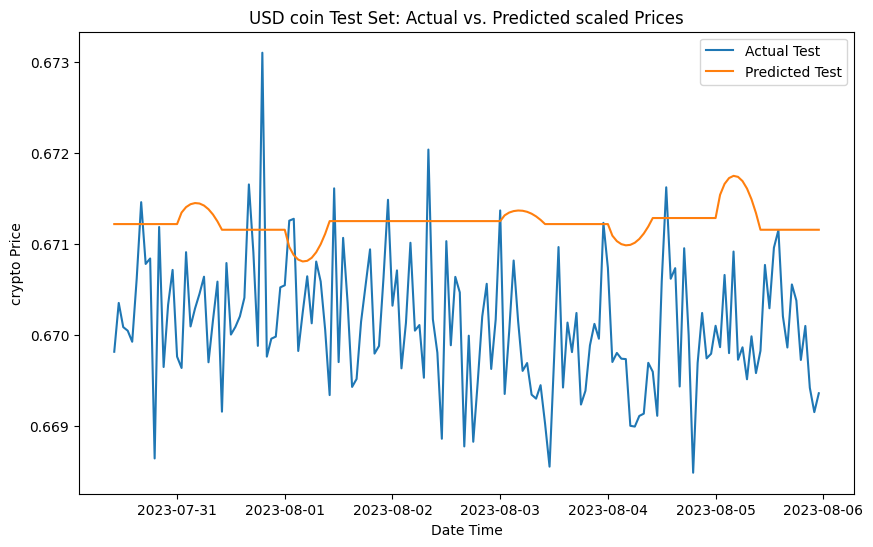

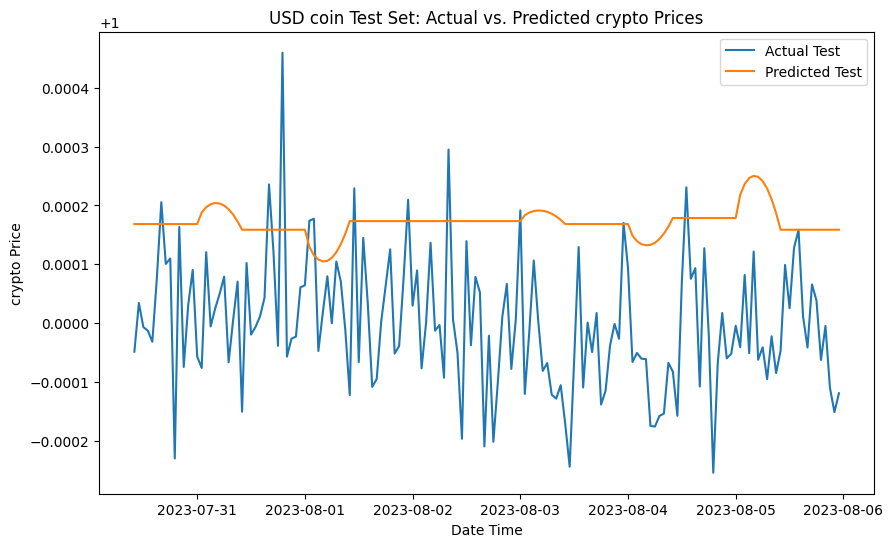

In [ ]:
data = df_usdc
features = ['value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'USD coin',features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

### Whale trasaction and fear and greed

Epoch 1/15
429/429 [==============================] - 15s 21ms/step - loss: 0.0089 - val_loss: 0.0014
Epoch 2/15
429/429 [==============================] - 9s 20ms/step - loss: 2.7441e-05 - val_loss: 0.0015
Epoch 3/15
429/429 [==============================] - 10s 24ms/step - loss: 2.2642e-05 - val_loss: 0.0015
Epoch 4/15
429/429 [==============================] - 7s 17ms/step - loss: 2.2424e-05 - val_loss: 0.0016
Epoch 5/15
429/429 [==============================] - 11s 25ms/step - loss: 2.1961e-05 - val_loss: 0.0016
Epoch 6/15
429/429 [==============================] - 9s 21ms/step - loss: 2.2156e-05 - val_loss: 0.0016
Epoch 7/15
429/429 [==============================] - 8s 18ms/step - loss: 2.3478e-05 - val_loss: 0.0016
Epoch 8/15
429/429 [==============================] - 12s 27ms/step - loss: 2.6264e-05 - val_loss: 0.0017
Epoch 9/15
429/429 [==============================] - 18s 41ms/step - loss: 2.5948e-05 - val_loss: 0.0016
Epoch 10/15
429/429 [==============================] -

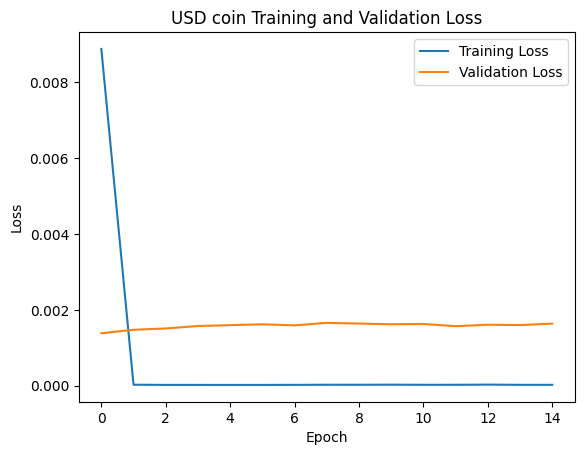

536/536 [==============================] - 6s 7ms/step
USD coin Training Set:
RMSE: 0.00285880394749169
MSE: 8.172760010194072e-06
MAE: 0.0003779665572958523
R2 score: -0.048942781063170404


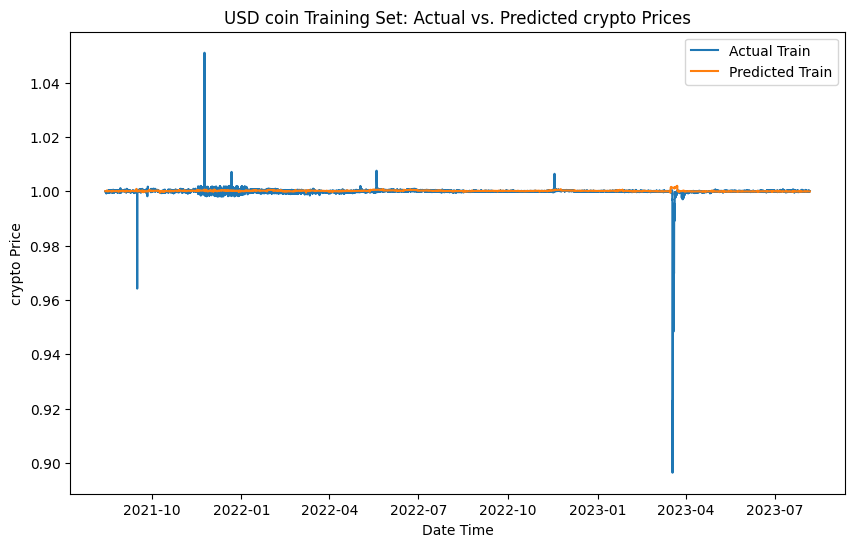

5/5 [==============================] - 0s 6ms/step
USD coin Test Set:
RMSE: 0.00012160327683369921
MSE: 1.4787356936693287e-08
MAE: 9.2440768133238e-05
test R2 score: -0.2062293103806152


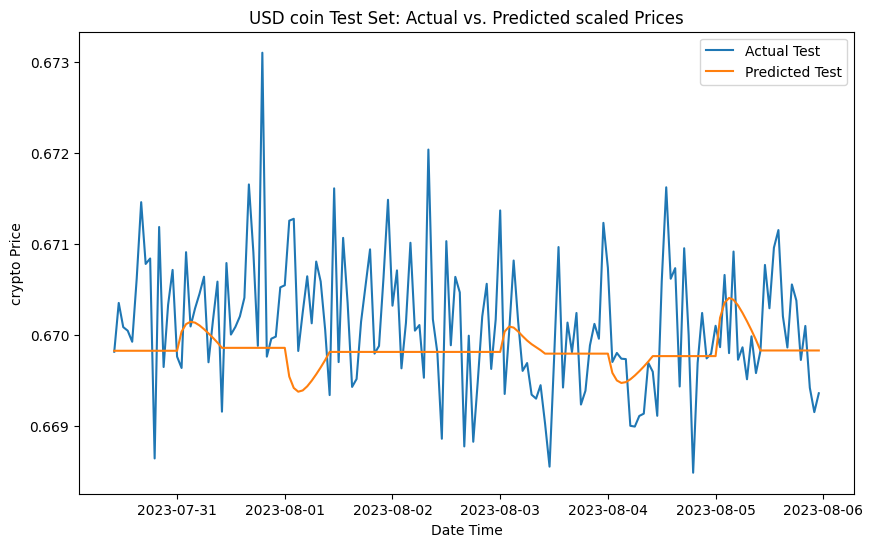

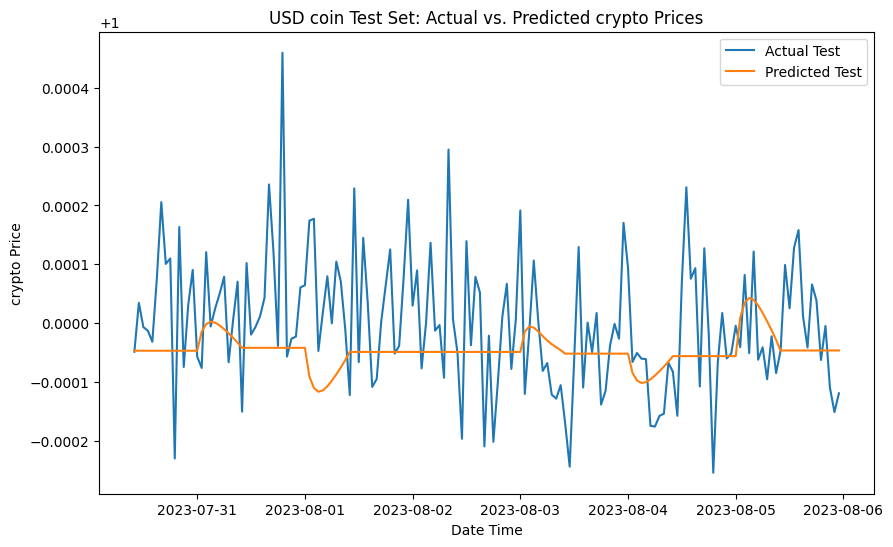

In [ ]:

data = df_usdc
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = False
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_lstm_sequences(data,'USD coin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

##Bi-LSTM

####7 Day Prediction using greed

Epoch 1/15
429/429 [==============================] - 29s 40ms/step - loss: 0.0078 - val_loss: 0.0016
Epoch 2/15
429/429 [==============================] - 18s 43ms/step - loss: 1.9818e-05 - val_loss: 0.0016
Epoch 3/15
429/429 [==============================] - 17s 40ms/step - loss: 2.0293e-05 - val_loss: 0.0016
Epoch 4/15
429/429 [==============================] - 14s 32ms/step - loss: 2.1092e-05 - val_loss: 0.0016
Epoch 5/15
429/429 [==============================] - 18s 43ms/step - loss: 2.2005e-05 - val_loss: 0.0016
Epoch 6/15
429/429 [==============================] - 20s 47ms/step - loss: 2.3016e-05 - val_loss: 0.0016
Epoch 7/15
429/429 [==============================] - 13s 31ms/step - loss: 2.3356e-05 - val_loss: 0.0016
Epoch 8/15
429/429 [==============================] - 17s 39ms/step - loss: 2.2977e-05 - val_loss: 0.0016
Epoch 9/15
429/429 [==============================] - 19s 45ms/step - loss: 2.7590e-05 - val_loss: 0.0016
Epoch 10/15
429/429 [=============================

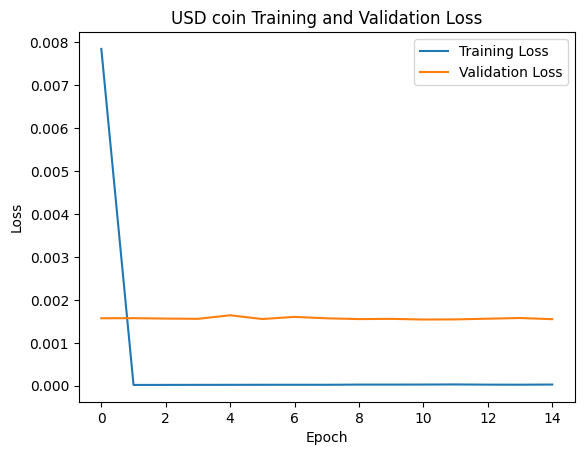

536/536 [==============================] - 9s 13ms/step
USD coin Training Set:
RMSE: 0.002852598416568291
MSE: 8.137317726207921e-06
MAE: 0.0008504550561894901
R2: -0.04439389820287687


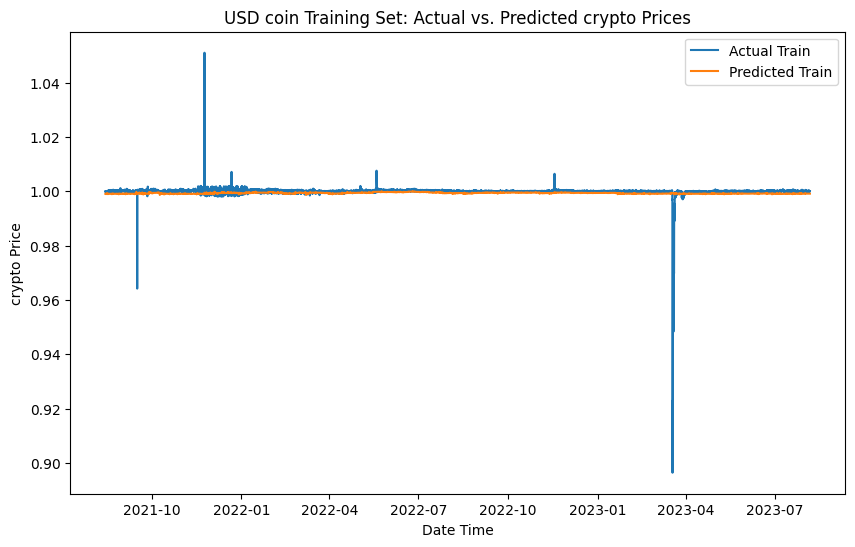

5/5 [==============================] - 0s 15ms/step
USD coin Test Set:
RMSE: 0.0008836033143624619
MSE: 7.807548171523278e-07
MAE: 0.0008765232713916627
R2: -62.68746955266177


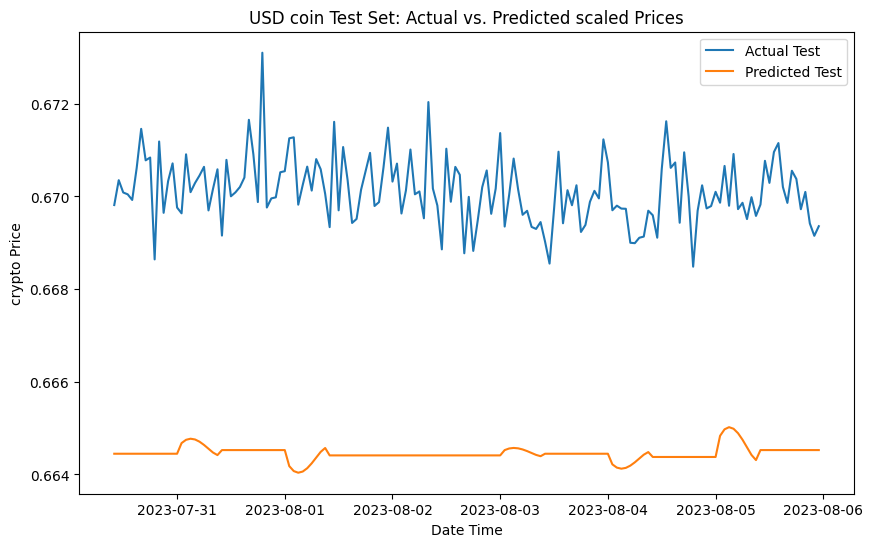

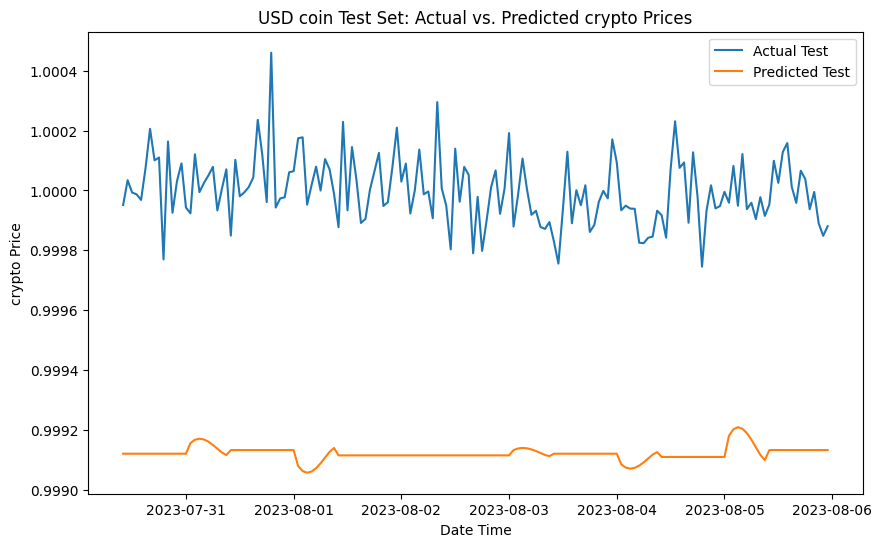

In [ ]:
data = df_usdc
features = ['value']
target = 'Close'
test_size = 168
random_state = 42
num_epochs = 15
batch_size = 32
sequence_length = 10

# Call the function
apply_bi_lstm_sequences(data,'USD coin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)

####Whale transaction and fear & greed

Epoch 1/15
429/429 [==============================] - 30s 49ms/step - loss: 0.0068 - val_loss: 0.0013
Epoch 2/15
429/429 [==============================] - 18s 42ms/step - loss: 2.3377e-05 - val_loss: 0.0014
Epoch 3/15
429/429 [==============================] - 13s 30ms/step - loss: 2.1638e-05 - val_loss: 0.0015
Epoch 4/15
429/429 [==============================] - 17s 40ms/step - loss: 2.0127e-05 - val_loss: 0.0015
Epoch 5/15
429/429 [==============================] - 19s 44ms/step - loss: 2.2641e-05 - val_loss: 0.0015
Epoch 6/15
429/429 [==============================] - 14s 32ms/step - loss: 2.3015e-05 - val_loss: 0.0016
Epoch 7/15
429/429 [==============================] - 17s 39ms/step - loss: 2.2987e-05 - val_loss: 0.0016
Epoch 8/15
429/429 [==============================] - 18s 43ms/step - loss: 2.4574e-05 - val_loss: 0.0016
Epoch 9/15
429/429 [==============================] - 13s 30ms/step - loss: 2.5778e-05 - val_loss: 0.0015
Epoch 10/15
429/429 [=============================

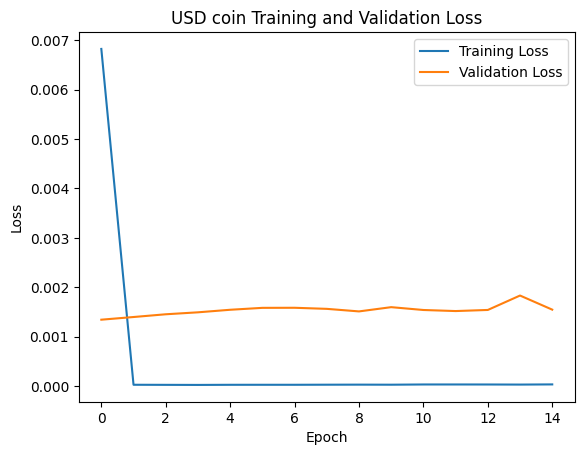

536/536 [==============================] - 7s 11ms/step
USD coin Training Set:
RMSE: 0.00278308327638691
MSE: 7.745552523304496e-06
MAE: 0.00041945610960106695
R2: 0.00588768120783878


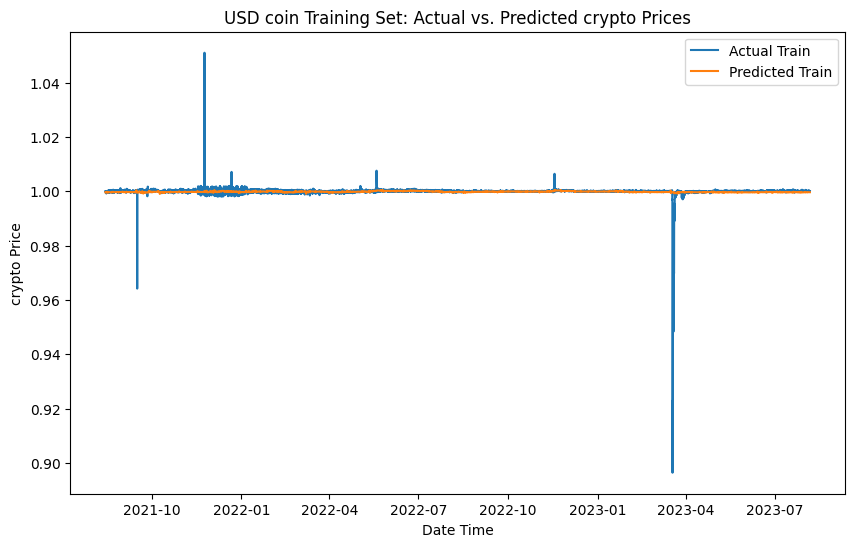

5/5 [==============================] - 0s 14ms/step
USD coin Test Set:
RMSE: 0.00037180958281807556
MSE: 1.382423658753514e-07
MAE: 0.00035476495948018837
R2: -10.276659809396506


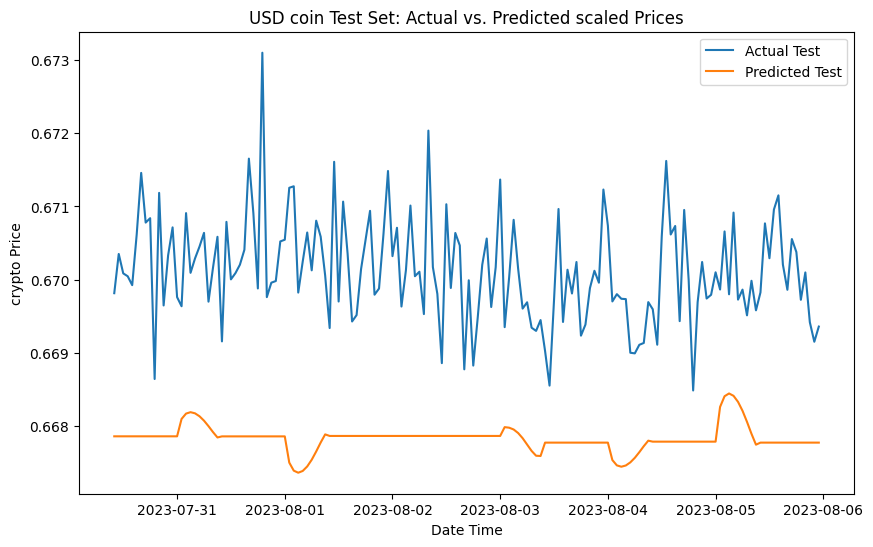

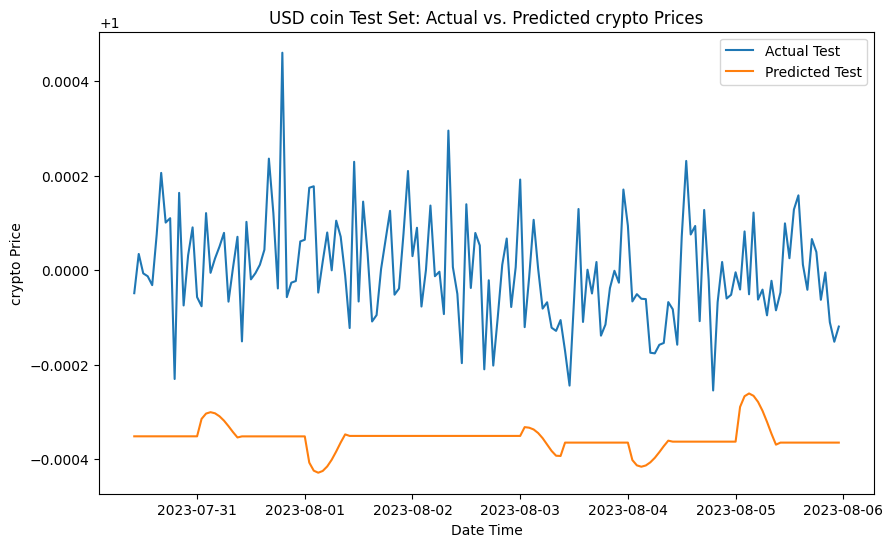

In [ ]:
# Replace with your actual data and parameters
data = df_usdc
features = ['Whale Transaction Count (>100k USD','Whale Transaction Count (>1m USD)','value']
target = 'Close'
test_size = 168
random_state = 42
num_epochs = 15
batch_size = 32
sequence_length = 10
apply_bi_lstm_sequences(data,'USD coin', features, target, test_size, random_state, num_epochs, batch_size, sequence_length)
